In [52]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import Adam
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms, models

import matplotlib.pyplot as plt

In [2]:
!wget https://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz

--2022-01-23 17:45:37--  https://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz
Resolving www.cs.toronto.edu (www.cs.toronto.edu)... 128.100.3.30
Connecting to www.cs.toronto.edu (www.cs.toronto.edu)|128.100.3.30|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 170498071 (163M) [application/x-gzip]
Saving to: ‘cifar-10-python.tar.gz.2’

cifar-10-python.tar 100%[===================>] 162.60M  20.2MB/s    in 6.9s    

2022-01-23 17:45:45 (23.5 MB/s) - ‘cifar-10-python.tar.gz.2’ saved [170498071/170498071]



In [3]:
!tar -xf cifar-10-python.tar.gz

The archive contains the files data_batch_1, data_batch_2, ..., data_batch_5, as well as test_batch. Each of these files is a Python "pickled" object produced with cPickle.

Loaded in this way, each of the batch files contains a dictionary with the following elements:
data -- a 10000x3072 numpy array of uint8s. Each row of the array stores a 32x32 colour image. The first 1024 entries contain the red channel values, the next 1024 the green, and the final 1024 the blue. The image is stored in row-major order, so that the first 32 entries of the array are the red channel values of the first row of the image.
labels -- a list of 10000 numbers in the range 0-9. The number at index i indicates the label of the ith image in the array data.

The dataset contains another file, called batches.meta. It too contains a Python dictionary object. It has the following entries:
label_names -- a 10-element list which gives meaningful names to the numeric labels in the labels array described above. For example, label_names[0] == "airplane", label_names[1] == "automobile", etc.

In [4]:
#training and testing split 80-20
# x=np.zeros((3,4,5))
# y=np.moveaxis(x, 0,-1)
# print(y)

#python 3 version 
def unpickle(file):
    import pickle
    with open(file, 'rb') as fo:
        dict = pickle.load(fo, encoding='bytes')
    return dict

In [7]:
data_batch_1 = unpickle("cifar-10-batches-py/data_batch_1")
data_batch_1 #{batch label, data labels, data, names}
type(data_batch_1)
len(data_batch_1) #4 dict values
data_batch_1.keys()
data_batch_1[b'data']
data_batch_1[b'data'].shape
print(data_batch_1[b'data'])

[[ 59  43  50 ... 140  84  72]
 [154 126 105 ... 139 142 144]
 [255 253 253 ...  83  83  84]
 ...
 [ 71  60  74 ...  68  69  68]
 [250 254 211 ... 215 255 254]
 [ 62  61  60 ... 130 130 131]]


In [10]:
#print the first image 

image_1 = data_batch_1[b'data'][0]
image_1 = image_1.reshape(3,32,32)
print(image_1)


[[[ 59  43  50 ... 158 152 148]
  [ 16   0  18 ... 123 119 122]
  [ 25  16  49 ... 118 120 109]
  ...
  [208 201 198 ... 160  56  53]
  [180 173 186 ... 184  97  83]
  [177 168 179 ... 216 151 123]]

 [[ 62  46  48 ... 132 125 124]
  [ 20   0   8 ...  88  83  87]
  [ 24   7  27 ...  84  84  73]
  ...
  [170 153 161 ... 133  31  34]
  [139 123 144 ... 148  62  53]
  [144 129 142 ... 184 118  92]]

 [[ 63  45  43 ... 108 102 103]
  [ 20   0   0 ...  55  50  57]
  [ 21   0   8 ...  50  50  42]
  ...
  [ 96  34  26 ...  70   7  20]
  [ 96  42  30 ...  94  34  34]
  [116  94  87 ... 140  84  72]]]


In [12]:
image = image_1.transpose(1,2,0)
print(image.shape)
image

(32, 32, 3)


array([[[ 59,  62,  63],
        [ 43,  46,  45],
        [ 50,  48,  43],
        ...,
        [158, 132, 108],
        [152, 125, 102],
        [148, 124, 103]],

       [[ 16,  20,  20],
        [  0,   0,   0],
        [ 18,   8,   0],
        ...,
        [123,  88,  55],
        [119,  83,  50],
        [122,  87,  57]],

       [[ 25,  24,  21],
        [ 16,   7,   0],
        [ 49,  27,   8],
        ...,
        [118,  84,  50],
        [120,  84,  50],
        [109,  73,  42]],

       ...,

       [[208, 170,  96],
        [201, 153,  34],
        [198, 161,  26],
        ...,
        [160, 133,  70],
        [ 56,  31,   7],
        [ 53,  34,  20]],

       [[180, 139,  96],
        [173, 123,  42],
        [186, 144,  30],
        ...,
        [184, 148,  94],
        [ 97,  62,  34],
        [ 83,  53,  34]],

       [[177, 144, 116],
        [168, 129,  94],
        [179, 142,  87],
        ...,
        [216, 184, 140],
        [151, 118,  84],
        [123,  92,  72]]

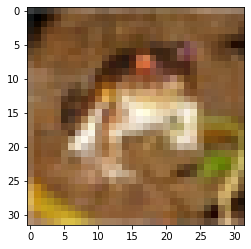

In [13]:
plt.imshow(image)

## Dataset Setup

In [15]:
training_folders = ['data_batch_1', 'data_batch_2', 'data_batch_3', 'data_batch_4', 'data_batch_5']
images = np.array([], dtype =np.uint8).reshape((0,3072))
labels = np.array([])

#get all the data 
for t in training_folders:
    data_dict = unpickle('cifar-10-batches-py/'+t)
    data = data_dict[b'data']
    images = np.append(images,data,axis=0)
    labels = np.append(labels,data_dict[b'labels'])
    
print(images.shape, labels.shape)

(50000, 3072) (50000,)


In [16]:
#Similarly for test images 
testimages = np.array([],dtype=np.uint8).reshape((0,3072))
testlabels = np.array([])

data_dict = unpickle('cifar-10-batches-py/test_batch')
data = data_dict[b'data']
testimages = np.append(testimages,data,axis=0)
testlabels = np.append(testlabels,data_dict[b'labels'])
print(testimages.shape, testlabels.shape)

(10000, 3072) (10000,)


In [26]:
images = images.reshape((-1,3,32,32))
testimages = testimages.reshape((-1,3,32,32))
images = images.astype(float)
testimages = testimages.astype(float)
print(images.shape, testimages.shape)

labels = labels.astype(int)
testlabels = testlabels.astype(int)
print(labels)

(50000, 3, 32, 32) (10000, 3, 32, 32)
[6 9 9 ... 9 1 1]


In [32]:
train_images = np.moveaxis(images,1,3) #trimages
test_images = np.moveaxis(testimages,1,3) #tsimages

#get the standard imshow shape
print(train_images.shape)
print(test_images.shape)

(50000, 32, 32, 3)
(10000, 32, 32, 3)


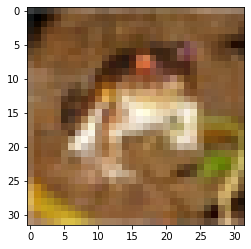

6


In [27]:
plt.imshow(train_images[0]/255.0)
plt.show()
print(labels[0])

In [102]:
#{0:'airplane',1:'automobile',2:'bird',3:'cat',4:'deer',5:'dog',6:'frog',7:'horse',8:'ship',9:'truck'}

In [33]:
class CustomDataset(Dataset):
    def __init__(self,phase,imgarr,s = 0.5):
        self.phase = phase
        self.imgarr = imgarr
        self.s = s #strength
        self.transforms = transforms.Compose([transforms.RandomHorizontalFlip(0.5),
                                              transforms.RandomResizedCrop(32,(0.8,1.0)),
                                              transforms.Compose([transforms.RandomApply(
                                                  [transforms.ColorJitter(0.8*self.s, 
                                                                          0.8*self.s, 
                                                                          0.8*self.s, 
                                                                          0.2*self.s)], p = 0.8),
                                                                  transforms.RandomGrayscale(p=0.2)
                                                                 ])])

    def __len__(self):
        return self.imgarr.shape[0]

    def __getitem__(self,idx):
        
        x = self.imgarr[idx] 
        #print(x.shape)
        x = x.astype(np.float32)/255.0

        x1 = self.augment(torch.from_numpy(x))
        x2 = self.augment(torch.from_numpy(x))
        
        x1 = self.preprocess(x1)
        x2 = self.preprocess(x2)
        
        return x1, x2

    #shuffles the dataset at the end of each epoch
    def on_epoch_end(self):
        self.imgarr = self.imgarr[random.sample(population = list(range(self.__len__())),k = self.__len__())]

    def preprocess(self,frame):
        frame = (frame-MEAN)/STD
        return frame
    
    #applies randomly selected augmentations to each clip (same for each frame in the clip)
    def augment(self, frame, transformations = None):
        
        if self.phase == 'train':
            frame = self.transforms(frame)
        else:
            return frame
        
        return frame

In [44]:
myDataset = CustomDataset("train", images)

data_loader_1 = DataLoader(myDataset, batch_size=16)

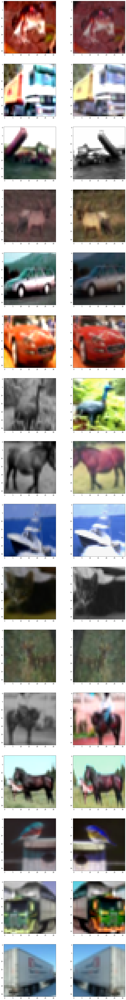

In [45]:
fig,axs = plt.subplots(16,2,figsize=(16,128))
row = 0
col = 0
for step,(x1,x2) in enumerate(data_loader_1):    
    for i in range(16):
        axs[i,0].imshow((x1[i]*STD + MEAN).squeeze().permute(1,2,0).numpy())
        axs[i,1].imshow((x2[i]*STD + MEAN).squeeze().permute(1,2,0).numpy())
    break

Ok it works...

## Model Setup
Resnet + Projection

In [46]:
#Overload 
class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()

    def forward(self, x):
        return x

class LinearLayer(nn.Module):
    def __init__(self,
                 in_features,
                 out_features,
                 use_bias = True,
                 use_bn = False):
        super(LinearLayer, self).__init__()

        self.in_features = in_features
        self.out_features = out_features
#         self.use_bias = use_bias
#         self.use_bn = use_bn
        
        self.linear = nn.Linear(self.in_features, 
                                self.out_features) 
#                                 bias = self.use_bias and not self.use_bn)
#         if self.use_bn:
#              self.bn = nn.BatchNorm1d(self.out_features)

    def forward(self,x):
        x = self.linear(x)
#         if self.use_bn:
#             x = self.bn(x)
        return x

class ProjectionHead(nn.Module):
    def __init__(self,
                 in_features,
                 hidden_features,
                 out_features,
                 head_type = 'nonlinear'):
        super(ProjectionHead,self).__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.hidden_features = hidden_features
        self.head_type = head_type

        if self.head_type == 'linear':
            self.layers = LinearLayer(self.in_features,self.out_features,False, True)
        elif self.head_type == 'nonlinear':
            self.layers = nn.Sequential(
                LinearLayer(self.in_features,self.hidden_features,True, True),
                nn.ReLU(),
                LinearLayer(self.hidden_features,self.out_features,False,True))
        
    def forward(self,x):
        x = self.layers(x)
        return x

class Resnet(nn.Module):
    def __init__(self):
        super().__init__()
        self.pretrained = models.resnet50(pretrained=True)
        
        self.pretrained.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, bias=False)
        self.pretrained.maxpool = Identity()
        
        self.pretrained.fc = Identity()
        
        for p in self.pretrained.parameters():
            p.requires_grad = True
        
        self.projector = ProjectionHead(2048, 2048, 128)
    

    def forward(self,x):
        out = self.pretrained(x)
        print(out.shape)
#         print(out)
        xp = self.projector(torch.squeeze(out))
        
        return xp

In [49]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = Resnet()
model = model.to(device)

In [50]:
print(model)

Resnet(
  (pretrained): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): Identity()
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          

In [53]:
optimizer = Adam(model.parameters() ,lr=0.001) 

In [63]:
# https://zablo.net/blog/post/understanding-implementing-simclr-guide-eli5-pytorch/
# https://github.com/sthalles/SimCLR/blob/master/simclr.py

#https://github.com/Spijkervet/SimCLR/blob/master/simclr/modules/nt_xent.py

class nt_xent(nn.Module):
    def __init__(self, batch_size, temperature):
        super(nt_xent, self).__init__()
        self.batch_size = batch_size
        self.temperature = temperature

        self.mask = self.mask_correlated_samples(batch_size)
        self.criterion = nn.CrossEntropyLoss(reduction="sum")
        self.similarity_f = nn.CosineSimilarity(dim=2)
        
        self.tot_neg = 0

    def mask_correlated_samples(self, batch_size):
        N = 2 * batch_size
        mask = torch.ones((N, N), dtype=bool)
        mask = mask.fill_diagonal_(0)
        
        for i in range(batch_size):
            mask[i, batch_size + i] = 0
            mask[batch_size + i, i] = 0
            
        return mask

    def forward(self, z_i, z_j):
        """
        We do not sample negative examples explicitly.
        Instead, given a positive pair, similar to (Chen et al., 2017), we treat the other 2(N − 1) augmented examples within a minibatch as negative examples.
        """
        N = 2 * self.batch_size #* self.world_size
        
        #z_i_ = z_i / torch.sqrt(torch.sum(torch.square(z_i),dim = 1, keepdim = True))
        #z_j_ = z_j / torch.sqrt(torch.sum(torch.square(z_j),dim = 1, keepdim = True))

        z = torch.cat((z_i, z_j), dim=0)

        sim = self.similarity_f(z.unsqueeze(1), z.unsqueeze(0)) / self.temperature
        
        #print(sim.shape)

        sim_i_j = torch.diag(sim, self.batch_size)
        sim_j_i = torch.diag(sim, -self.batch_size)
        
        
        # We have 2N samples, but with Distributed training every GPU gets N examples too, resulting in: 2xNxN
        positive_samples = torch.cat((sim_i_j, sim_j_i), dim=0).reshape(N, 1)
        negative_samples = sim[self.mask].reshape(N, -1)
        
        
        #SIMCLR
        labels = torch.from_numpy(np.array([0]*N)).reshape(-1).to(positive_samples.device).long() #.float()
        #labels was torch.zeros(N)
        logits = torch.cat((positive_samples, negative_samples), dim=1)
        loss = self.criterion(logits, labels)
        loss /= N
        
        return loss

In [64]:
# N = 10
# x = torch.from_numpy(np.array([0]*N)).reshape(-1)
# print(x)

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0])


In [71]:
criterion = nt_xent(128, 0.5) #batchsize & temp input

In [75]:
"""images -- labels
testimages -- testlabels"""
trimages = images[:40000]
trlabels = labels[:40000]
dg = CustomDataset('train',trimages) #train
dl = DataLoader(dg,batch_size = 128, drop_last =True)

epochs = 10
for i in range(epochs):
    for step, (x_i, x_j) in enumerate(dl):
        optimizer.zero_grad()
        x_i = x_i.squeeze().to(device).float()
        x_j = x_j.squeeze().to(device).float()

        # positive pair, with encoding
        z_i = model(x_i)
        z_j = model(x_j)

        loss = criterion(z_i, z_j)
        loss.backward()

        optimizer.step()

print("done")

torch.Size([128, 2048])
tensor([[0.0000e+00, 1.6949e-01, 2.6510e-01,  ..., 2.6367e-03, 2.1585e-01,
         6.6347e-01],
        [9.8853e-01, 2.0118e+00, 8.4386e-01,  ..., 4.5735e-02, 2.7966e-01,
         3.1223e-01],
        [1.4090e+00, 3.5353e-01, 8.6899e-03,  ..., 5.2073e-03, 2.7689e-02,
         1.6048e-02],
        ...,
        [6.1755e-01, 2.6036e-01, 3.5354e-01,  ..., 0.0000e+00, 7.8085e-03,
         0.0000e+00],
        [1.1882e+00, 6.1769e-01, 8.2836e-02,  ..., 5.9963e-03, 4.5861e-02,
         0.0000e+00],
        [3.3366e+00, 2.5837e+00, 4.8375e-01,  ..., 1.1099e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 1.5026e-01, 2.1712e-01,  ..., 1.4785e-02, 1.8475e-01,
         7.1830e-01],
        [1.0697e+00, 2.0378e+00, 4.6490e-01,  ..., 1.5562e-01, 5.3158e-02,
         5.8339e-01],
        [1.0868e+00, 2.9799e-01, 4.1299e-03,  ..., 6.7605e-03, 4.4590e-02,
         1.8111e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[2.3869e-02, 1.5731e+00, 7.3500e-02,  ..., 0.0000e+00, 1.5621e-02,
         6.4734e-01],
        [2.5360e-02, 1.2321e-01, 1.2878e+00,  ..., 3.9330e-02, 1.9805e+00,
         1.8782e-01],
        [4.2934e-01, 1.0229e+00, 2.2970e-01,  ..., 5.2234e-01, 2.3257e-01,
         5.8028e-04],
        ...,
        [0.0000e+00, 4.6729e-01, 1.7848e-01,  ..., 7.6869e-01, 1.1762e+00,
         3.0511e-01],
        [3.6802e-01, 2.5616e-01, 7.9570e-01,  ..., 4.2004e-03, 2.6464e-02,
         2.5188e-01],
        [6.1215e-02, 1.1512e+00, 4.2025e-03,  ..., 4.7202e-01, 2.2289e-02,
         8.8911e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.0063e-02, 1.9665e+00, 9.1197e-02,  ..., 0.0000e+00, 1.9072e-01,
         5.1771e-01],
        [9.1869e-03, 1.6930e-01, 1.3048e+00,  ..., 2.2521e-02, 1.8599e+00,
         2.0604e-01],
        [6.6228e-01, 1.4786e+00, 1.8342e-01,  ..., 4.9374e-01, 1.4180e-01,
         6.8599e-05],
        ...,
  

torch.Size([128, 2048])
tensor([[0.3403, 0.0855, 0.3612,  ..., 0.8176, 0.5106, 0.2051],
        [0.0854, 0.3838, 0.1206,  ..., 0.0022, 1.4602, 0.3900],
        [0.3188, 0.0000, 0.0239,  ..., 1.1308, 0.0672, 0.0146],
        ...,
        [0.1526, 0.4200, 0.9215,  ..., 0.4883, 0.5430, 0.7042],
        [0.1194, 0.3965, 0.2582,  ..., 0.7470, 0.4764, 0.3038],
        [0.0818, 0.1636, 0.3871,  ..., 1.0422, 0.1605, 0.7818]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5197, 0.1007, 0.5028,  ..., 0.7403, 0.4809, 0.3425],
        [0.1575, 0.4095, 0.1297,  ..., 0.0066, 1.3686, 0.5049],
        [0.2571, 0.0000, 0.0236,  ..., 1.1506, 0.0873, 0.0120],
        ...,
        [0.1662, 0.3669, 1.1424,  ..., 0.5850, 0.5796, 0.8046],
        [0.0378, 0.4019, 0.2978,  ..., 0.8423, 0.5840, 0.4167],
        [0.1159, 0.1255, 0.7188,  ..., 0.9588, 0.2414, 0.7329]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0

torch.Size([128, 2048])
tensor([[6.4679e-01, 2.3815e+00, 1.2231e-01,  ..., 4.1397e-01, 1.2917e-01,
         3.0096e-05],
        [7.3687e-01, 6.6785e-01, 8.3126e-01,  ..., 1.9045e-01, 9.9921e-01,
         3.0723e-01],
        [5.7618e-03, 2.4404e-01, 5.4268e-02,  ..., 0.0000e+00, 4.8107e-01,
         3.5041e-01],
        ...,
        [7.0374e-01, 6.7119e-01, 2.3527e-02,  ..., 0.0000e+00, 9.3963e-01,
         0.0000e+00],
        [2.4605e-01, 3.8544e-01, 7.0097e-01,  ..., 1.6998e-01, 5.3817e-01,
         4.3656e-01],
        [1.5085e+00, 1.5982e+00, 0.0000e+00,  ..., 3.3786e-02, 1.1127e-01,
         8.5464e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.3101e-01, 2.4632e+00, 2.3686e-01,  ..., 5.7989e-01, 2.8492e-01,
         7.5124e-02],
        [6.1823e-01, 5.4430e-01, 4.9145e-01,  ..., 1.8467e-01, 1.1260e+00,
         3.8117e-01],
        [2.3886e-03, 3.0716e-01, 3.1684e-03,  ..., 0.0000e+00, 5.3442e-01,
         3.4580e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[1.0233e-01, 9.1767e-01, 1.5606e-01,  ..., 2.1069e-01, 8.0120e-01,
         9.2106e-01],
        [3.7366e-01, 9.2439e-01, 1.6947e-01,  ..., 1.0738e-01, 8.5398e-01,
         0.0000e+00],
        [6.9702e-02, 1.0723e-01, 3.3602e-01,  ..., 9.9108e-02, 8.7146e-04,
         4.3225e-01],
        ...,
        [1.2915e+00, 3.0068e+00, 4.5255e-03,  ..., 0.0000e+00, 2.4145e-03,
         6.3769e-02],
        [2.5328e-01, 7.4628e-02, 1.8810e-01,  ..., 3.1245e-01, 7.4976e-02,
         3.3729e-01],
        [0.0000e+00, 1.5276e-01, 2.6870e-02,  ..., 3.5862e-02, 1.4812e-02,
         5.0046e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.8824e-02, 1.1886e+00, 2.1106e-01,  ..., 1.5555e-01, 3.8401e-01,
         1.2339e+00],
        [2.1996e-01, 1.0393e+00, 9.4913e-02,  ..., 7.1523e-02, 8.2104e-01,
         0.0000e+00],
        [4.8167e-02, 7.9466e-03, 3.6999e-01,  ..., 7.9659e-02, 5.4953e-03,
         4.7957e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[1.8417, 1.3129, 0.3430,  ..., 0.3168, 0.0022, 0.0000],
        [0.2060, 1.3024, 0.0889,  ..., 0.5676, 0.1711, 0.7727],
        [0.3970, 0.1956, 2.0463,  ..., 0.0711, 0.9126, 0.8487],
        ...,
        [0.1593, 0.5815, 0.0708,  ..., 0.4421, 0.0630, 0.1387],
        [0.0713, 0.0023, 0.4485,  ..., 0.6793, 0.6275, 0.7622],
        [0.3298, 0.1952, 0.8078,  ..., 0.0175, 1.1592, 0.0245]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6560e+00, 1.6746e+00, 1.2249e-01,  ..., 1.0262e-01, 7.6791e-02,
         0.0000e+00],
        [1.7770e-01, 1.3070e+00, 1.2261e-01,  ..., 5.8336e-01, 2.1825e-01,
         8.3286e-01],
        [3.4604e-01, 3.7455e-01, 1.9292e+00,  ..., 5.4023e-02, 9.4720e-01,
         8.8806e-01],
        ...,
        [1.6035e-01, 5.7931e-01, 3.6701e-02,  ..., 4.4719e-01, 1.2751e-01,
         2.0055e-01],
        [3.0491e-02, 3.2653e-02, 2.8952e-01,  ..., 6.6558e-01, 4.9095e-01,
         7.5131e-01],

torch.Size([128, 2048])
tensor([[0.5103, 0.6240, 0.1846,  ..., 0.4050, 0.0889, 0.3458],
        [0.0121, 0.0995, 0.7276,  ..., 0.0368, 0.7447, 0.1090],
        [0.1441, 0.8118, 0.1320,  ..., 0.0000, 0.2400, 1.0180],
        ...,
        [2.0753, 1.4401, 0.2719,  ..., 0.0874, 0.0023, 0.0000],
        [1.1244, 0.0414, 0.3887,  ..., 0.1169, 0.7607, 0.0957],
        [0.0088, 0.6380, 0.2554,  ..., 0.5866, 0.3831, 0.0665]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.9699e-01, 1.1960e+00, 5.1601e-01,  ..., 2.8936e-01, 3.3737e-01,
         2.4015e-01],
        [3.5103e-04, 8.1641e-02, 9.5570e-01,  ..., 1.1029e-01, 8.1666e-01,
         2.8079e-01],
        [4.4191e-02, 1.1158e+00, 9.4177e-02,  ..., 0.0000e+00, 2.9917e-01,
         8.2907e-01],
        ...,
        [2.0510e+00, 1.6192e+00, 1.2963e-01,  ..., 3.0902e-02, 0.0000e+00,
         0.0000e+00],
        [1.0019e+00, 9.9128e-03, 2.8025e-01,  ..., 1.2728e-01, 7.4058e-01,
         6.9355e-02],

torch.Size([128, 2048])
tensor([[1.3493, 1.7807, 0.1857,  ..., 0.7405, 0.0182, 0.0000],
        [0.0000, 0.0000, 0.0488,  ..., 0.0000, 0.0278, 0.2687],
        [2.7200, 2.4439, 0.1534,  ..., 0.2631, 0.1234, 0.0000],
        ...,
        [0.2145, 0.7335, 0.3513,  ..., 0.3449, 0.3864, 0.7456],
        [0.1843, 0.4663, 0.1387,  ..., 0.3130, 0.0000, 0.3178],
        [3.1160, 1.7436, 0.3138,  ..., 0.1791, 0.0139, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.9269e+00, 1.6941e+00, 1.7638e-01,  ..., 5.1303e-01, 8.3549e-03,
         0.0000e+00],
        [8.6084e-04, 1.4243e-03, 7.5880e-02,  ..., 0.0000e+00, 3.6078e-02,
         3.3897e-01],
        [2.8655e+00, 2.2627e+00, 2.2313e-01,  ..., 2.1380e-01, 9.9486e-02,
         0.0000e+00],
        ...,
        [2.2311e-01, 7.8671e-01, 3.6533e-01,  ..., 3.9609e-01, 3.9416e-01,
         7.5036e-01],
        [5.3720e-02, 6.2577e-01, 1.0118e-01,  ..., 2.8440e-01, 1.4429e-01,
         3.6265e-01],

torch.Size([128, 2048])
tensor([[0.0000e+00, 1.5264e-01, 1.9782e-02,  ..., 1.5678e+00, 3.5070e-01,
         3.7619e-01],
        [7.7567e-01, 4.1676e-01, 5.4087e-01,  ..., 6.0764e-03, 1.4722e-01,
         3.6054e-01],
        [0.0000e+00, 1.1930e-02, 1.8906e-01,  ..., 2.2487e-02, 3.5102e-01,
         5.7762e-02],
        ...,
        [3.6575e+00, 3.4895e+00, 7.3685e-02,  ..., 1.9066e-02, 2.2176e-02,
         5.4094e-03],
        [7.5011e-02, 9.2758e-01, 0.0000e+00,  ..., 9.0801e-02, 1.3545e+00,
         2.5763e-02],
        [1.2936e-02, 7.9110e-01, 2.8277e-01,  ..., 2.5156e-03, 1.0266e-02,
         4.7867e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.5882e-02, 1.6703e-01, 3.0661e-02,  ..., 1.4859e+00, 3.2775e-01,
         3.6874e-01],
        [7.1889e-01, 1.3262e-01, 4.6639e-01,  ..., 4.7498e-02, 8.8420e-02,
         3.4779e-01],
        [0.0000e+00, 1.0587e-02, 2.3933e-01,  ..., 2.9951e-02, 3.9134e-01,
         7.3595e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.8113, 0.0143, 1.1771,  ..., 0.1501, 0.2198, 0.5527],
        [0.2167, 0.1188, 0.2435,  ..., 0.1913, 0.3423, 0.0000],
        [0.4701, 0.0281, 0.1125,  ..., 0.1936, 0.3437, 0.6642],
        ...,
        [0.2183, 0.2904, 0.1825,  ..., 0.1801, 0.5162, 0.0000],
        [0.2360, 1.3535, 0.8074,  ..., 0.4460, 1.5355, 0.4288],
        [0.0406, 0.5521, 0.2596,  ..., 0.0000, 0.0129, 0.2566]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.8862, 0.0870, 1.3168,  ..., 0.1531, 0.2759, 0.4810],
        [0.0332, 0.0000, 0.0496,  ..., 0.3399, 0.1584, 0.0000],
        [0.6054, 0.0615, 0.1410,  ..., 0.1317, 0.3648, 0.6634],
        ...,
        [0.0682, 0.0598, 0.2175,  ..., 0.3326, 0.6321, 0.0366],
        [0.1804, 1.0791, 0.7857,  ..., 0.5462, 1.3751, 0.3359],
        [0.0090, 0.3668, 0.1937,  ..., 0.0000, 0.0000, 0.2267]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.2148e+0

torch.Size([128, 2048])
tensor([[0.2094, 1.2735, 0.2838,  ..., 0.1157, 1.2741, 0.0223],
        [0.0496, 0.0000, 0.0051,  ..., 0.0000, 1.8105, 0.0112],
        [0.4567, 0.6938, 0.0000,  ..., 0.0000, 1.2939, 0.1576],
        ...,
        [0.0000, 0.1418, 0.0228,  ..., 0.0000, 0.1803, 0.3011],
        [0.8286, 0.4992, 0.0075,  ..., 0.2069, 0.1236, 0.0000],
        [0.6658, 0.3259, 0.1222,  ..., 0.0000, 1.1554, 0.0438]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.2494e-01, 1.7141e+00, 4.0338e-01,  ..., 6.1831e-02, 1.1250e+00,
         2.0477e-02],
        [4.7561e-02, 0.0000e+00, 6.0563e-03,  ..., 0.0000e+00, 1.7857e+00,
         1.0278e-02],
        [4.5759e-01, 7.5351e-01, 0.0000e+00,  ..., 0.0000e+00, 1.0591e+00,
         3.0360e-01],
        ...,
        [0.0000e+00, 1.7690e-01, 1.5622e-03,  ..., 3.6965e-03, 1.0312e-01,
         4.7268e-01],
        [8.3342e-01, 6.4434e-01, 1.1864e-02,  ..., 1.8939e-01, 9.9133e-02,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[1.4643e+00, 6.4001e-02, 6.6247e-01,  ..., 1.5909e-01, 1.2362e-01,
         4.4209e-01],
        [9.6986e-01, 7.5481e-01, 2.0668e+00,  ..., 1.2621e-01, 4.7772e-02,
         1.1466e+00],
        [2.6289e+00, 2.2704e+00, 2.9676e-03,  ..., 1.7284e-01, 1.4937e-03,
         0.0000e+00],
        ...,
        [2.5724e-02, 1.1178e-01, 0.0000e+00,  ..., 2.3533e-01, 1.5704e-02,
         0.0000e+00],
        [0.0000e+00, 2.2760e-02, 7.3362e-02,  ..., 2.4981e-01, 4.0355e-01,
         0.0000e+00],
        [0.0000e+00, 2.3324e-01, 4.3692e-01,  ..., 8.3420e-01, 5.0125e-01,
         6.0795e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.5165e+00, 6.0790e-02, 6.1315e-01,  ..., 1.6675e-01, 1.0779e-01,
         4.4807e-01],
        [9.1708e-01, 6.0948e-01, 2.3121e+00,  ..., 1.9211e-01, 2.9808e-02,
         1.1380e+00],
        [2.2698e+00, 1.9380e+00, 2.5747e-02,  ..., 1.1783e-01, 1.1453e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[6.7559e-03, 0.0000e+00, 0.0000e+00,  ..., 5.2468e-02, 0.0000e+00,
         5.4440e-02],
        [6.2794e-02, 0.0000e+00, 9.9817e-01,  ..., 6.0213e-01, 1.1278e-01,
         4.2710e-01],
        [1.0838e+00, 2.6969e+00, 2.8065e-04,  ..., 0.0000e+00, 7.2953e-01,
         4.4862e-02],
        ...,
        [1.3712e-01, 1.7001e-02, 7.8493e-02,  ..., 8.9949e-02, 3.6963e-02,
         9.6035e-02],
        [9.0090e-02, 4.8873e-02, 5.2130e-01,  ..., 3.5457e-01, 8.3476e-01,
         6.3744e-01],
        [8.5952e-02, 2.7205e-01, 4.8766e-01,  ..., 2.3419e-01, 4.1841e-02,
         1.5555e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4960e-02, 0.0000e+00, 1.4255e-04,  ..., 4.4295e-02, 0.0000e+00,
         7.9609e-02],
        [5.1079e-02, 0.0000e+00, 5.3815e-01,  ..., 6.6830e-01, 5.3507e-02,
         2.3323e-01],
        [1.0763e+00, 2.6046e+00, 4.3476e-03,  ..., 0.0000e+00, 7.2595e-01,
         4.0844e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[5.1758e-01, 1.4916e-01, 7.6067e-01,  ..., 2.4863e-02, 6.2363e-02,
         6.6345e-03],
        [1.9889e+00, 2.7005e+00, 1.3939e-01,  ..., 2.1965e-01, 1.6841e-01,
         1.1943e-02],
        [2.3969e-01, 9.8267e-01, 1.2094e-01,  ..., 5.4950e-04, 1.2925e-02,
         4.1150e-01],
        ...,
        [5.9525e-01, 1.7843e-01, 1.8726e+00,  ..., 0.0000e+00, 4.9121e-01,
         0.0000e+00],
        [3.0298e-01, 2.3905e-01, 0.0000e+00,  ..., 1.0344e-02, 0.0000e+00,
         0.0000e+00],
        [4.2549e-02, 8.0602e-01, 2.8139e-01,  ..., 8.7541e-01, 1.5542e-01,
         2.9006e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.3862e-01, 2.2182e-01, 9.4050e-01,  ..., 1.6214e-02, 3.1703e-02,
         1.8595e-02],
        [1.9614e+00, 2.6052e+00, 1.7639e-01,  ..., 1.9664e-01, 2.0592e-01,
         1.3547e-02],
        [2.3017e-01, 1.0505e+00, 3.4009e-01,  ..., 9.6269e-08, 2.1333e-02,
         4.7922e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[2.2412e+00, 8.9357e-01, 1.0554e-01,  ..., 2.2128e-01, 9.4285e-02,
         0.0000e+00],
        [0.0000e+00, 1.9410e-01, 7.9707e-01,  ..., 1.0059e-02, 4.3199e-01,
         2.4247e-01],
        [0.0000e+00, 2.0682e+00, 0.0000e+00,  ..., 1.7563e-01, 4.7799e-02,
         3.1757e-01],
        ...,
        [1.3844e+00, 6.2182e-01, 3.0139e-01,  ..., 2.3116e-01, 2.3925e-01,
         8.2312e-01],
        [0.0000e+00, 1.7983e-01, 1.4135e-01,  ..., 1.6425e-03, 1.7605e-01,
         4.6982e-01],
        [1.3804e-01, 9.0809e-01, 4.3006e-01,  ..., 1.1461e-01, 1.0248e+00,
         1.3032e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.3398e+00, 1.0401e+00, 2.0530e-01,  ..., 2.0307e-01, 7.8465e-02,
         0.0000e+00],
        [4.1041e-03, 3.8708e-01, 6.4039e-01,  ..., 0.0000e+00, 4.2818e-01,
         4.2821e-02],
        [0.0000e+00, 2.2644e+00, 4.9749e-04,  ..., 9.3727e-02, 4.0635e-02,
         2.0113e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1363, 0.0000, 0.0000,  ..., 0.0000, 1.2695, 0.0000],
        [2.4287, 2.5415, 0.0418,  ..., 0.1876, 0.0000, 0.0158],
        [0.0682, 0.4266, 2.3270,  ..., 0.0323, 0.9597, 0.8195],
        ...,
        [0.0137, 0.8771, 0.1128,  ..., 0.0000, 0.0961, 0.0000],
        [0.2689, 0.1866, 1.2703,  ..., 0.1437, 0.6267, 0.0486],
        [0.0000, 0.7210, 0.0177,  ..., 0.0000, 0.0000, 2.0315]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0239e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 1.2019e+00,
         0.0000e+00],
        [2.0264e+00, 3.2484e+00, 4.6614e-02,  ..., 7.2154e-02, 2.5170e-03,
         6.3564e-03],
        [3.8396e-02, 3.8878e-01, 1.9139e+00,  ..., 1.2770e-02, 8.0468e-01,
         3.8731e-01],
        ...,
        [1.6626e-02, 8.4735e-01, 1.2024e-01,  ..., 0.0000e+00, 1.1999e-01,
         0.0000e+00],
        [4.0132e-01, 2.6120e-01, 1.4418e+00,  ..., 1.3362e-01, 6.5371e-01,
         7.4373e-02],

torch.Size([128, 2048])
tensor([[5.3966e-02, 2.5138e-01, 8.0523e-01,  ..., 1.0614e-02, 3.1015e-02,
         1.0795e+00],
        [9.1499e-02, 4.3936e-01, 6.2658e-01,  ..., 3.5548e-03, 8.1621e-02,
         3.0891e-01],
        [9.7953e-01, 3.8090e-01, 5.5586e-01,  ..., 4.3078e-01, 9.8711e-02,
         1.1688e-01],
        ...,
        [1.5290e-01, 6.8232e-01, 6.1993e-01,  ..., 1.0395e+00, 4.0253e-01,
         9.3436e-01],
        [9.7018e-04, 6.9633e-01, 4.5355e-02,  ..., 9.8435e-03, 0.0000e+00,
         1.2677e+00],
        [2.2474e-01, 7.3906e-01, 1.7037e+00,  ..., 3.7245e-01, 1.2786e+00,
         9.1218e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1300, 0.4521, 0.5681,  ..., 0.0423, 0.0298, 1.2492],
        [0.1806, 0.4970, 0.8458,  ..., 0.0121, 0.2450, 0.3591],
        [1.1364, 0.2771, 0.6460,  ..., 0.3636, 0.1689, 0.1158],
        ...,
        [0.1336, 0.4226, 0.6777,  ..., 1.1640, 0.4938, 0.8833],
        [0.0000, 0.7695, 0.0775,  ...

torch.Size([128, 2048])
tensor([[2.2073e-02, 5.3916e-01, 9.3454e-03,  ..., 2.7843e-02, 0.0000e+00,
         1.2652e+00],
        [3.1933e+00, 2.4525e+00, 6.1740e-01,  ..., 8.6524e-01, 2.6074e-03,
         8.9403e-03],
        [1.3508e-01, 0.0000e+00, 0.0000e+00,  ..., 1.0945e+00, 3.6571e-01,
         6.8397e-02],
        ...,
        [0.0000e+00, 4.8654e-01, 3.8527e-01,  ..., 2.0794e-02, 1.4500e+00,
         2.9308e-01],
        [6.6487e-01, 1.5466e-01, 0.0000e+00,  ..., 0.0000e+00, 4.9817e-01,
         0.0000e+00],
        [0.0000e+00, 5.2853e-03, 2.4011e-03,  ..., 1.5347e-01, 5.5310e-01,
         1.0342e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.3759e-02, 3.2989e-01, 1.4263e-02,  ..., 3.5917e-02, 0.0000e+00,
         1.4020e+00],
        [3.8099e+00, 2.8556e+00, 6.0166e-01,  ..., 7.2173e-01, 0.0000e+00,
         0.0000e+00],
        [1.9283e-01, 0.0000e+00, 2.4158e-02,  ..., 1.0996e+00, 3.1434e-01,
         6.4410e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[4.3436e-01, 3.5366e-01, 2.9770e-01,  ..., 4.2044e-04, 1.4532e+00,
         8.0101e-02],
        [0.0000e+00, 9.3166e-02, 4.5435e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.6638e-01],
        [0.0000e+00, 3.7581e-01, 2.7661e-01,  ..., 0.0000e+00, 9.1871e-02,
         1.3055e+00],
        ...,
        [2.6308e-01, 4.2554e-01, 0.0000e+00,  ..., 0.0000e+00, 9.9443e-01,
         0.0000e+00],
        [1.6770e+00, 4.9368e-01, 6.5537e-01,  ..., 6.6732e-01, 0.0000e+00,
         3.1035e-01],
        [2.9043e-04, 2.0132e-03, 4.1417e-02,  ..., 4.6498e-01, 2.6354e-02,
         4.4335e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6045, 0.4752, 0.5160,  ..., 0.0000, 1.6594, 0.0744],
        [0.0000, 0.1332, 0.0566,  ..., 0.0000, 0.0000, 0.1583],
        [0.0000, 0.5579, 0.3260,  ..., 0.0333, 0.0629, 1.4589],
        ...,
        [0.3362, 0.6024, 0.0000,  ..., 0.0267, 0.9469, 0.0000],
        [1.9454, 1.0259, 0.4576,  ...

torch.Size([128, 2048])
tensor([[0.0040, 2.0441, 0.0367,  ..., 0.0000, 0.0435, 0.5134],
        [1.2949, 0.6081, 0.2396,  ..., 0.2876, 0.0077, 0.0775],
        [0.0235, 0.0360, 0.0367,  ..., 0.0000, 0.0293, 0.0000],
        ...,
        [0.2718, 1.1161, 0.4707,  ..., 0.2800, 0.0353, 1.6546],
        [0.4416, 0.0285, 0.8321,  ..., 0.0913, 0.2778, 0.1472],
        [2.1685, 2.0247, 0.1718,  ..., 0.8394, 0.0000, 0.0842]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.7808e-03, 1.6867e+00, 9.8644e-02,  ..., 0.0000e+00, 1.6967e-01,
         4.4108e-01],
        [9.7469e-01, 6.4721e-01, 2.9727e-01,  ..., 2.9249e-01, 2.2871e-02,
         1.6468e-01],
        [8.3323e-03, 2.0207e-02, 2.2901e-02,  ..., 3.8793e-04, 2.6476e-02,
         3.3790e-02],
        ...,
        [1.4934e-01, 9.1096e-01, 4.9070e-01,  ..., 2.9109e-01, 3.9875e-02,
         1.9711e+00],
        [7.8271e-01, 2.9495e-02, 6.0060e-01,  ..., 2.0899e-02, 1.4010e-01,
         8.6896e-02],

torch.Size([128, 2048])
tensor([[0.5858, 1.4667, 1.1033,  ..., 0.8139, 0.1235, 0.4213],
        [0.5719, 0.8271, 0.2655,  ..., 0.8937, 0.0837, 0.2245],
        [0.3807, 1.1018, 0.3075,  ..., 1.1631, 0.2633, 0.1636],
        ...,
        [0.0000, 0.2120, 0.0185,  ..., 0.1665, 0.0639, 0.3096],
        [0.0000, 0.4177, 0.0000,  ..., 0.0024, 0.0036, 0.0000],
        [0.0197, 0.2127, 0.0133,  ..., 0.0000, 0.0000, 0.1702]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3477, 1.3139, 0.9659,  ..., 0.6599, 0.1600, 0.3626],
        [0.5412, 0.7704, 0.2909,  ..., 0.9144, 0.1579, 0.1713],
        [0.5315, 1.1246, 0.3432,  ..., 0.9833, 0.1881, 0.1282],
        ...,
        [0.0000, 0.1851, 0.0361,  ..., 0.1671, 0.0849, 0.2533],
        [0.0000, 0.3822, 0.0232,  ..., 0.0468, 0.0332, 0.0000],
        [0.0317, 0.2142, 0.0125,  ..., 0.0000, 0.0000, 0.2338]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0047, 0

torch.Size([128, 2048])
tensor([[1.2453e-01, 1.1259e-01, 5.5679e-01,  ..., 1.0075e-01, 2.5220e-01,
         5.4967e-01],
        [3.3542e-01, 0.0000e+00, 3.5343e-03,  ..., 7.3751e-01, 3.3643e-01,
         1.5041e-01],
        [0.0000e+00, 8.8722e-02, 1.2317e-01,  ..., 4.5312e-01, 6.8478e-01,
         3.4284e-01],
        ...,
        [2.1763e-03, 1.6808e-01, 1.6141e+00,  ..., 3.7459e-01, 8.1470e-01,
         4.6578e-01],
        [3.1427e+00, 3.0892e+00, 1.8155e-01,  ..., 3.7928e-02, 8.2085e-03,
         0.0000e+00],
        [4.3914e-02, 1.5665e-01, 5.7652e-01,  ..., 2.5207e-01, 1.7000e-01,
         6.8615e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.0423e-02, 1.3877e-01, 6.4183e-01,  ..., 7.9908e-02, 1.9977e-01,
         5.2264e-01],
        [2.7483e-01, 0.0000e+00, 5.2194e-02,  ..., 6.7099e-01, 3.3799e-01,
         1.4062e-01],
        [0.0000e+00, 1.4897e-01, 2.8563e-02,  ..., 3.1571e-01, 5.1191e-01,
         2.5450e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.7390, 0.3986, 2.1987,  ..., 0.1584, 0.5579, 0.3809],
        [1.2624, 0.8412, 0.8981,  ..., 0.1806, 0.4335, 0.0000],
        [0.0000, 0.0000, 0.7770,  ..., 0.1254, 0.0410, 1.0599],
        ...,
        [0.0374, 0.4538, 0.0959,  ..., 0.5479, 0.5001, 0.0000],
        [0.1699, 0.0000, 0.0426,  ..., 0.1700, 0.2638, 0.0024],
        [0.0343, 0.9210, 0.4535,  ..., 0.0288, 0.5579, 0.3481]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.6573e-01, 3.8417e-01, 1.8374e+00,  ..., 2.2378e-01, 4.3512e-01,
         3.3314e-01],
        [1.3041e+00, 9.9204e-01, 9.9096e-01,  ..., 2.1753e-01, 4.1474e-01,
         3.3474e-03],
        [0.0000e+00, 0.0000e+00, 6.9649e-01,  ..., 1.8698e-01, 1.1940e-01,
         9.5952e-01],
        ...,
        [4.9079e-02, 1.1704e-01, 2.9701e-02,  ..., 5.0441e-01, 4.9788e-01,
         0.0000e+00],
        [2.1601e-01, 0.0000e+00, 3.5817e-02,  ..., 1.4453e-01, 3.7078e-01,
         3.2854e-03],

torch.Size([128, 2048])
tensor([[0.0000, 1.3812, 0.0099,  ..., 0.0000, 0.1171, 0.9771],
        [0.0211, 0.0000, 0.7479,  ..., 0.0958, 0.0257, 0.1304],
        [0.0000, 0.1522, 0.2097,  ..., 0.4758, 0.0552, 1.1614],
        ...,
        [0.2043, 0.1652, 1.0217,  ..., 0.2203, 0.4336, 0.0537],
        [0.0768, 0.0000, 0.0050,  ..., 0.0224, 0.0000, 0.3764],
        [0.0232, 1.2601, 0.2019,  ..., 0.0000, 0.0272, 1.4906]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 1.0990, 0.0040,  ..., 0.0000, 0.1370, 1.0222],
        [0.0212, 0.0000, 0.3765,  ..., 0.1597, 0.0135, 0.1404],
        [0.0000, 0.1040, 0.1047,  ..., 0.6177, 0.0645, 0.7929],
        ...,
        [0.2342, 0.2356, 0.8330,  ..., 0.2297, 0.5440, 0.0490],
        [0.0828, 0.0000, 0.0095,  ..., 0.0173, 0.0000, 0.3399],
        [0.0019, 1.1629, 0.3456,  ..., 0.0000, 0.0865, 1.7220]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+0

torch.Size([128, 2048])
tensor([[0.0455, 1.9188, 0.0087,  ..., 0.3500, 0.0000, 0.0277],
        [0.0034, 0.3693, 0.4919,  ..., 0.0310, 0.0320, 0.8657],
        [0.0530, 2.4355, 0.0175,  ..., 0.9151, 0.8527, 0.1308],
        ...,
        [1.2976, 1.3373, 0.0000,  ..., 0.1083, 0.0232, 0.0326],
        [0.5679, 1.0091, 0.0103,  ..., 0.0173, 0.0692, 0.5933],
        [2.1803, 1.3406, 0.0000,  ..., 0.0000, 0.0052, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0880, 1.9815, 0.0113,  ..., 0.3403, 0.0040, 0.0206],
        [0.0286, 0.5235, 0.2245,  ..., 0.0190, 0.0422, 0.7368],
        [0.0000, 1.5641, 0.0100,  ..., 1.1333, 0.6588, 0.1130],
        ...,
        [1.3851, 0.9079, 0.0124,  ..., 0.2174, 0.0940, 0.0957],
        [0.6207, 0.8759, 0.0156,  ..., 0.0946, 0.1159, 0.6099],
        [2.1862, 1.5564, 0.0000,  ..., 0.0000, 0.0114, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.6930e-0

torch.Size([128, 2048])
tensor([[1.3610, 2.2122, 0.3662,  ..., 0.8069, 0.0559, 0.3058],
        [0.0000, 0.0000, 0.0000,  ..., 0.0660, 0.0371, 0.5209],
        [0.0152, 0.0000, 1.0555,  ..., 0.4579, 0.5973, 0.6708],
        ...,
        [0.1169, 0.8160, 0.0994,  ..., 0.0000, 0.0170, 0.9075],
        [0.0042, 0.2864, 0.1961,  ..., 0.4752, 1.6275, 0.1928],
        [0.0000, 1.2384, 0.0509,  ..., 0.0000, 0.3980, 0.9179]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4038e+00, 2.4403e+00, 3.2162e-01,  ..., 8.2660e-01, 6.2567e-02,
         2.3293e-01],
        [0.0000e+00, 0.0000e+00, 4.1191e-04,  ..., 2.3778e-02, 1.8220e-02,
         3.6280e-01],
        [1.2817e-03, 0.0000e+00, 1.0493e+00,  ..., 5.4544e-01, 4.4386e-01,
         6.7546e-01],
        ...,
        [1.7491e-01, 9.9816e-01, 9.1404e-02,  ..., 0.0000e+00, 2.4635e-02,
         7.6081e-01],
        [9.1226e-03, 3.2415e-01, 1.4801e-01,  ..., 3.9181e-01, 1.6981e+00,
         1.5342e-01],

tensor([[0.2332, 0.5946, 0.4378,  ..., 0.5957, 0.2180, 0.0230],
        [0.3977, 0.9863, 0.1741,  ..., 0.0000, 0.0263, 0.0000],
        [0.1056, 0.0000, 0.0016,  ..., 0.2690, 0.0000, 0.4685],
        ...,
        [0.0000, 0.0000, 1.0369,  ..., 0.1923, 0.4285, 0.5463],
        [0.0262, 0.0242, 0.7086,  ..., 0.0503, 0.1414, 0.9539],
        [0.0000, 0.2450, 0.1949,  ..., 0.2072, 0.2804, 0.4191]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1605, 0.1104, 0.5211,  ..., 0.7542, 0.1371, 0.6106],
        [0.2376, 0.0000, 0.1336,  ..., 0.0059, 0.2165, 0.0109],
        [0.0000, 0.2306, 0.0017,  ..., 0.0000, 0.0000, 0.8489],
        ...,
        [0.0000, 0.2680, 0.0000,  ..., 0.5522, 0.0973, 0.4903],
        [0.0000, 0.1519, 0.0000,  ..., 0.0260, 0.0000, 1.1808],
        [0.0057, 0.3015, 0.1956,  ..., 0.0000, 0.1559, 0.2023]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0516, 0.1796, 0.3886,  ..., 0.7

torch.Size([128, 2048])
tensor([[4.1110e-04, 1.1225e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         1.5404e-02],
        [2.2564e+00, 9.3704e-01, 4.0882e-01,  ..., 2.1297e-01, 4.6249e-03,
         2.3008e-03],
        [7.3371e-02, 7.9081e-01, 9.8715e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5621e-01],
        ...,
        [1.3845e+00, 2.7667e+00, 8.9969e-01,  ..., 5.3853e-01, 1.9580e-01,
         6.9757e-02],
        [0.0000e+00, 9.5770e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         9.2194e-02],
        [2.0827e-01, 3.7712e-01, 0.0000e+00,  ..., 2.4260e-01, 2.4659e-01,
         4.8205e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.9640e-03, 1.1965e+00, 4.9048e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.1231e-03],
        [2.2799e+00, 8.8912e-01, 4.3004e-01,  ..., 1.7313e-01, 4.5224e-03,
         1.4532e-03],
        [8.8769e-02, 8.4072e-01, 1.1822e-01,  ..., 0.0000e+00, 0.0000e+00,
         7.2252e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1101, 0.0000, 1.1975,  ..., 0.2462, 0.4319, 0.3470],
        [0.9249, 0.8213, 0.5377,  ..., 0.4476, 0.0859, 0.0176],
        [0.0000, 1.1617, 0.0315,  ..., 0.0000, 0.0038, 1.3933],
        ...,
        [0.0265, 0.3586, 0.2810,  ..., 0.0000, 0.3451, 0.2582],
        [0.0573, 0.8830, 1.0006,  ..., 0.1403, 2.0710, 0.5520],
        [0.0886, 0.6981, 0.0000,  ..., 0.0296, 0.2250, 0.4222]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2104, 0.0177, 1.6796,  ..., 0.2703, 0.5600, 0.3659],
        [1.0816, 0.9689, 0.4612,  ..., 0.4218, 0.0346, 0.0592],
        [0.0000, 1.3281, 0.0580,  ..., 0.0000, 0.0083, 1.4890],
        ...,
        [0.0294, 0.2870, 0.2756,  ..., 0.0000, 0.3254, 0.3731],
        [0.1237, 1.0486, 0.8460,  ..., 0.1222, 2.1073, 0.4994],
        [0.0625, 0.9377, 0.0000,  ..., 0.0302, 0.1653, 0.2825]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0083, 0

torch.Size([128, 2048])
tensor([[1.1341e+00, 7.8852e-01, 2.2880e-01,  ..., 9.9466e-02, 1.8270e-01,
         8.5083e-04],
        [0.0000e+00, 6.0713e-02, 0.0000e+00,  ..., 1.0411e-01, 0.0000e+00,
         9.1329e-01],
        [6.5837e-01, 1.5248e+00, 7.3081e-01,  ..., 1.0712e+00, 5.4043e-01,
         9.5726e-02],
        ...,
        [2.5317e-01, 3.7511e-02, 3.6529e-02,  ..., 1.9596e-06, 1.2403e+00,
         8.3185e-02],
        [1.6898e+00, 3.1268e-01, 5.4250e-01,  ..., 8.2222e-01, 4.8575e-02,
         0.0000e+00],
        [0.0000e+00, 2.3471e-01, 1.0726e-01,  ..., 6.2738e-04, 3.8970e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.9506, 0.5267, 0.2265,  ..., 0.0135, 0.3933, 0.0183],
        [0.0000, 0.0469, 0.0000,  ..., 0.0892, 0.0000, 0.8072],
        [0.7411, 1.4743, 1.0292,  ..., 1.0153, 0.7480, 0.1114],
        ...,
        [0.2638, 0.0859, 0.1273,  ..., 0.0082, 1.1852, 0.0786],
        [1.7251, 0.1977, 0.4803,  ...

tensor([[1.2057e+00, 8.0481e-01, 1.6847e+00,  ..., 4.4944e-01, 9.3149e-02,
         2.4707e-01],
        [1.6304e+00, 1.4134e+00, 8.3472e-01,  ..., 3.5719e-01, 1.4616e-01,
         1.7851e-02],
        [1.0452e+00, 4.5059e-01, 2.2874e-01,  ..., 2.4895e-02, 3.4586e-01,
         3.8621e-02],
        ...,
        [1.8831e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 2.2829e-01,
         2.4282e-03],
        [2.3605e-01, 1.6334e-03, 5.2540e-01,  ..., 4.6797e-01, 8.9158e-02,
         3.6124e-01],
        [5.5877e-01, 1.7574e-01, 8.4154e-01,  ..., 3.9184e-01, 6.0025e-01,
         4.7335e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0040, 0.4277, 0.3741,  ..., 1.2651, 0.3675, 0.2382],
        [1.0649, 1.5897, 0.2513,  ..., 0.4880, 0.1031, 0.0126],
        [0.2559, 0.3501, 0.4483,  ..., 0.2491, 0.5908, 0.0194],
        ...,
        [0.0812, 0.0508, 0.2639,  ..., 0.0529, 0.1183, 0.0137],
        [0.0225, 0.0910, 0.0000,  ..., 0.0354, 0.0000, 0.1816

torch.Size([128, 2048])
tensor([[0.1118, 0.1325, 0.4083,  ..., 0.1638, 0.7859, 0.2800],
        [0.0000, 0.2412, 0.3494,  ..., 0.0580, 0.0312, 1.0242],
        [1.0254, 0.7159, 0.0225,  ..., 0.2397, 0.0000, 0.0038],
        ...,
        [1.8588, 2.2178, 1.1212,  ..., 0.5990, 0.3727, 0.2897],
        [0.2395, 0.0108, 0.6427,  ..., 0.1150, 0.7101, 0.1521],
        [0.4930, 0.5962, 0.0196,  ..., 0.1833, 0.0000, 0.2262]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1380, 0.1915, 0.2627,  ..., 0.1941, 0.7853, 0.1947],
        [0.0000, 0.2522, 0.3220,  ..., 0.0857, 0.0562, 1.1188],
        [1.2017, 0.5358, 0.0241,  ..., 0.2463, 0.0000, 0.0090],
        ...,
        [2.3197, 2.3471, 1.0817,  ..., 0.5550, 0.1643, 0.0757],
        [0.2783, 0.0320, 0.6399,  ..., 0.0588, 0.8545, 0.0936],
        [0.1755, 0.2497, 0.0401,  ..., 0.4494, 0.0000, 0.2191]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0956, 0

torch.Size([128, 2048])
tensor([[6.1838e-01, 1.5763e-02, 0.0000e+00,  ..., 1.1763e-03, 3.2032e-02,
         4.4596e-01],
        [6.7952e-02, 6.3427e-01, 2.6628e-01,  ..., 3.1838e-01, 2.9126e-02,
         1.6036e+00],
        [0.0000e+00, 2.2784e-01, 4.0681e-02,  ..., 1.3161e-01, 6.1669e-01,
         4.3888e-02],
        ...,
        [6.8691e-02, 0.0000e+00, 8.3752e-01,  ..., 4.5132e-01, 1.3759e-01,
         6.5905e-01],
        [8.0795e-02, 1.6130e-01, 3.4503e-01,  ..., 1.4851e-01, 3.7037e-01,
         0.0000e+00],
        [5.2999e-01, 0.0000e+00, 3.6335e-01,  ..., 2.0179e-01, 2.8005e-01,
         5.8257e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.6180e-01, 3.3108e-03, 2.6393e-03,  ..., 6.9613e-04, 3.0536e-02,
         3.0129e-01],
        [4.0402e-02, 5.5487e-01, 1.5793e-01,  ..., 3.5154e-01, 1.3428e-02,
         1.4225e+00],
        [1.0851e-02, 1.0659e-01, 5.5158e-02,  ..., 1.3835e-01, 6.8527e-01,
         9.2417e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.6504, 0.0998, 0.0267,  ..., 0.0972, 0.3116, 0.0054],
        [0.3603, 0.2477, 0.1605,  ..., 0.6658, 0.3764, 0.0000],
        [0.0586, 2.6312, 0.8907,  ..., 0.4985, 2.9799, 0.7737],
        ...,
        [0.1166, 1.7710, 0.0419,  ..., 0.0000, 0.9028, 0.3697],
        [2.2657, 3.0068, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0053, 1.0065, 0.0064,  ..., 0.0000, 0.0000, 0.1144]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.7896, 0.0625, 0.0544,  ..., 0.0532, 0.3580, 0.0000],
        [0.2890, 0.1095, 0.1782,  ..., 0.8060, 0.3917, 0.0000],
        [0.0412, 2.5673, 0.7959,  ..., 0.4430, 2.8958, 0.6749],
        ...,
        [0.0750, 1.2688, 0.0222,  ..., 0.0000, 1.0015, 0.3898],
        [2.1893, 2.8935, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5995, 0.0034,  ..., 0.0000, 0.0000, 0.2294]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0645e+0

torch.Size([128, 2048])
tensor([[0.0395, 0.2210, 0.1107,  ..., 0.2130, 0.8379, 0.0000],
        [0.1452, 0.3462, 0.0782,  ..., 0.7055, 0.0937, 0.3727],
        [0.2408, 0.0508, 0.8312,  ..., 0.7270, 0.0162, 0.4403],
        ...,
        [0.0000, 0.0484, 0.1768,  ..., 0.0000, 0.0000, 0.5406],
        [1.1374, 0.9707, 0.5800,  ..., 0.2857, 0.8340, 0.0147],
        [0.0856, 0.1560, 0.8718,  ..., 0.1442, 0.3693, 1.2483]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.0197e-02, 1.6010e-01, 9.0196e-02,  ..., 2.2099e-01, 6.7327e-01,
         0.0000e+00],
        [2.4652e-01, 1.1028e-01, 1.0102e-01,  ..., 9.2423e-01, 9.2374e-02,
         3.9736e-01],
        [1.3132e-01, 3.3316e-02, 6.4441e-01,  ..., 7.0265e-01, 5.6561e-02,
         2.0544e-01],
        ...,
        [0.0000e+00, 1.1396e-03, 8.0246e-01,  ..., 6.6253e-03, 2.5605e-02,
         6.4453e-01],
        [1.2410e+00, 8.2105e-01, 8.5098e-01,  ..., 2.3708e-01, 8.6113e-01,
         1.5106e-02],

torch.Size([128, 2048])
tensor([[0.0000e+00, 9.7250e-01, 4.4746e-03,  ..., 7.1253e-03, 2.9821e-01,
         2.7960e-01],
        [1.5647e-02, 2.2160e-02, 1.2157e-01,  ..., 1.0084e-01, 7.2398e-02,
         8.3983e-01],
        [6.0754e-01, 5.8122e-02, 1.2307e+00,  ..., 2.4354e-01, 4.4492e-02,
         6.0013e-01],
        ...,
        [6.9934e-01, 7.5398e-02, 0.0000e+00,  ..., 0.0000e+00, 2.5745e-01,
         4.0317e-01],
        [1.6198e+00, 9.7415e-02, 1.5232e-03,  ..., 3.0669e-01, 0.0000e+00,
         0.0000e+00],
        [4.7215e-03, 5.7506e-01, 5.3902e-01,  ..., 1.4936e-02, 2.4812e-01,
         1.5188e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 1.1902e+00, 1.0693e-03,  ..., 1.4143e-02, 1.8816e-01,
         3.6610e-01],
        [3.3323e-03, 2.6326e-02, 7.3348e-02,  ..., 7.8333e-02, 7.1954e-02,
         7.8646e-01],
        [4.0595e-01, 8.3338e-02, 9.7580e-01,  ..., 2.3051e-01, 5.1843e-02,
         7.2743e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[3.7231e-01, 1.3262e+00, 2.2060e-02,  ..., 1.1238e-02, 6.4451e-03,
         0.0000e+00],
        [0.0000e+00, 4.0501e-01, 2.5201e-01,  ..., 4.3624e-01, 1.7838e+00,
         5.6975e-01],
        [5.1163e-02, 2.9072e-01, 2.5697e-01,  ..., 1.6539e-01, 6.8153e-01,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.6730e-01, 4.4577e-01,  ..., 1.4957e-01, 0.0000e+00,
         1.5840e+00],
        [7.3587e-03, 6.3021e-01, 3.8700e-01,  ..., 6.6257e-04, 8.5057e-01,
         1.3597e-01],
        [0.0000e+00, 7.1847e-04, 2.5177e-01,  ..., 5.8488e-01, 1.2391e-01,
         1.0476e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3566, 1.4660, 0.0473,  ..., 0.0478, 0.0114, 0.0000],
        [0.0041, 0.2755, 0.0630,  ..., 0.4277, 1.3947, 0.4765],
        [0.0370, 0.2730, 0.2145,  ..., 0.1918, 0.6872, 0.0000],
        ...,
        [0.0000, 0.9084, 0.6771,  ..., 0.0888, 0.0000, 1.5820],
        [0.0704, 0.5143, 0.7961,  ...

torch.Size([128, 2048])
tensor([[1.1911e+00, 6.8059e-01, 2.9116e-01,  ..., 1.5288e-01, 1.6750e-01,
         1.7882e-01],
        [1.9773e+00, 2.2064e+00, 2.9957e-01,  ..., 0.0000e+00, 6.3134e-01,
         1.7005e-02],
        [2.2615e+00, 1.8862e+00, 1.0749e-01,  ..., 7.7339e-02, 3.4835e-03,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 2.6735e-01,  ..., 2.8575e-01, 7.6990e-02,
         2.9267e-01],
        [2.8499e-01, 0.0000e+00, 1.8830e-03,  ..., 2.2875e-01, 0.0000e+00,
         1.1268e+00],
        [3.7078e-01, 2.7797e+00, 1.6810e-02,  ..., 4.5923e-01, 1.0367e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3634e+00, 8.5533e-01, 4.0325e-01,  ..., 2.1684e-01, 1.3892e-01,
         2.5449e-01],
        [2.5537e+00, 2.8863e+00, 2.1510e-01,  ..., 0.0000e+00, 4.8804e-01,
         2.1786e-02],
        [2.2343e+00, 1.5645e+00, 1.1601e-01,  ..., 8.3328e-02, 1.7140e-03,
         2.7430e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[5.2037e-01, 1.2734e-01, 2.1358e-01,  ..., 8.2641e-02, 7.7925e-01,
         2.7049e-04],
        [1.7160e-01, 0.0000e+00, 7.1898e-01,  ..., 1.1110e-01, 1.1134e-01,
         9.0370e-01],
        [0.0000e+00, 1.5562e+00, 0.0000e+00,  ..., 0.0000e+00, 1.1932e-01,
         3.0031e-01],
        ...,
        [0.0000e+00, 1.7971e-01, 5.9839e-02,  ..., 1.7962e-02, 1.3963e-01,
         0.0000e+00],
        [2.1002e-01, 1.7508e+00, 2.1767e-01,  ..., 5.3918e-02, 2.8477e-02,
         5.4341e-01],
        [1.7541e-01, 8.3194e-01, 5.3363e-01,  ..., 9.2926e-02, 2.1820e+00,
         1.5606e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.8125e-01, 1.9655e-01, 1.7032e-01,  ..., 5.5994e-02, 5.1167e-01,
         2.5397e-03],
        [2.0426e-01, 6.8999e-02, 6.6362e-01,  ..., 1.5682e-01, 1.3395e-01,
         8.5769e-01],
        [0.0000e+00, 8.8878e-01, 3.1776e-03,  ..., 4.8724e-03, 1.8472e-02,
         6.0105e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0364, 1.3101, 0.3505,  ..., 0.0154, 0.1430, 0.7036],
        [0.0298, 0.0068, 0.1901,  ..., 0.0639, 0.7439, 0.0460],
        [0.6940, 0.0084, 0.0206,  ..., 0.0000, 0.0375, 0.0000],
        ...,
        [0.0813, 0.4614, 0.4483,  ..., 0.0122, 1.3970, 0.4394],
        [0.0000, 0.9574, 0.0000,  ..., 0.0304, 0.0573, 0.3706],
        [0.7922, 1.1894, 0.0000,  ..., 0.0414, 0.3283, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0403, 1.0555, 0.6168,  ..., 0.0567, 0.3646, 0.7447],
        [0.0303, 0.0071, 0.1642,  ..., 0.1134, 0.7581, 0.0598],
        [0.8106, 0.0638, 0.0636,  ..., 0.0017, 0.0691, 0.0000],
        ...,
        [0.0534, 0.4964, 0.4559,  ..., 0.0000, 1.3300, 0.4543],
        [0.0000, 0.7941, 0.0000,  ..., 0.0409, 0.0055, 0.4758],
        [0.2824, 0.7515, 0.0000,  ..., 0.0653, 0.2766, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2091, 0

torch.Size([128, 2048])
tensor([[1.5248e-03, 2.6900e-02, 4.8743e-01,  ..., 4.9328e-02, 1.5042e-01,
         9.4843e-01],
        [1.0794e+00, 2.5728e+00, 2.8464e-01,  ..., 3.1646e-01, 1.8147e-01,
         1.6457e-01],
        [1.2825e+00, 7.5218e-01, 2.0703e-03,  ..., 1.9157e-02, 1.0734e-01,
         1.3011e-02],
        ...,
        [9.5686e-01, 4.6188e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3007e+00, 1.7794e+00, 1.5067e-02,  ..., 3.3273e-02, 3.8746e-02,
         0.0000e+00],
        [1.9864e+00, 2.1249e+00, 2.5103e-01,  ..., 1.7952e-01, 4.7821e-03,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.6219,  ..., 0.0511, 0.2623, 0.7446],
        [1.2354, 2.5743, 0.2650,  ..., 0.1957, 0.2003, 0.1228],
        [1.4985, 0.8440, 0.0069,  ..., 0.0392, 0.0561, 0.0043],
        ...,
        [0.9976, 0.4500, 0.0000,  ..., 0.0000, 0.0062, 0.0000],
        [1.2858, 2.3804, 0.0080,  ...

torch.Size([128, 2048])
tensor([[3.7686e-02, 4.7189e-01, 5.3245e-01,  ..., 5.9473e-02, 6.1922e-02,
         1.0891e+00],
        [9.6427e-02, 1.0803e-02, 1.2706e+00,  ..., 7.3269e-03, 1.2646e+00,
         4.6934e-02],
        [6.0565e-01, 1.0824e+00, 3.0932e-01,  ..., 5.1975e-01, 2.7712e-01,
         2.0291e-04],
        ...,
        [1.3748e-02, 4.7337e-01, 2.4292e-01,  ..., 1.2960e+00, 1.0675e+00,
         3.6860e-01],
        [4.9876e-01, 2.4432e-01, 6.4660e-01,  ..., 0.0000e+00, 1.6931e-03,
         2.3212e-01],
        [3.7924e-01, 2.0583e+00, 3.7425e-02,  ..., 3.2920e-01, 9.8123e-04,
         6.9961e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0197, 0.3808, 0.4648,  ..., 0.0483, 0.0125, 1.0748],
        [0.0223, 0.0249, 1.2968,  ..., 0.0087, 1.7879, 0.1381],
        [0.3527, 0.6407, 0.2049,  ..., 0.4902, 0.2616, 0.0000],
        ...,
        [0.0050, 0.4339, 0.0951,  ..., 1.2654, 0.8686, 0.2233],
        [0.3250, 0.2748, 0.1537,  ...

torch.Size([128, 2048])
tensor([[0.0000, 1.1498, 0.0629,  ..., 0.0299, 0.4297, 0.2667],
        [0.1622, 0.0499, 0.4442,  ..., 0.2160, 0.2883, 1.0810],
        [0.0298, 0.2671, 0.0174,  ..., 0.0000, 0.0000, 0.0131],
        ...,
        [0.3585, 1.9065, 0.1378,  ..., 0.3471, 0.2068, 0.0000],
        [0.6251, 0.0553, 0.4138,  ..., 0.2045, 0.0255, 0.6783],
        [0.1313, 0.0118, 0.5557,  ..., 0.7036, 0.7273, 0.1802]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1309e-03, 8.1712e-01, 9.3007e-02,  ..., 0.0000e+00, 4.2126e-01,
         3.6508e-01],
        [1.2859e-01, 1.0258e-03, 4.4174e-01,  ..., 2.6186e-01, 1.3689e-01,
         1.2198e+00],
        [1.4554e-02, 1.1092e-01, 7.5776e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.9968e-02],
        ...,
        [5.2528e-01, 2.3977e+00, 1.4708e-01,  ..., 2.4370e-01, 1.5417e-01,
         0.0000e+00],
        [5.5747e-01, 0.0000e+00, 3.6421e-01,  ..., 2.5769e-01, 1.7894e-02,
         4.0879e-01],

torch.Size([128, 2048])
tensor([[1.0768e+00, 2.5976e+00, 3.9113e-01,  ..., 2.7385e-01, 2.7039e-01,
         1.4154e-02],
        [6.3636e-01, 5.6402e-01, 3.6938e-01,  ..., 1.8926e-01, 6.4419e-01,
         1.4452e-01],
        [1.1872e-02, 3.1447e-01, 7.7802e-02,  ..., 0.0000e+00, 4.1088e-01,
         4.5485e-01],
        ...,
        [2.4503e-01, 4.9348e-04, 8.9642e-02,  ..., 5.2247e-04, 9.6583e-01,
         0.0000e+00],
        [8.6501e-02, 2.9175e-01, 1.4729e+00,  ..., 2.9090e-01, 5.1370e-01,
         5.0957e-01],
        [1.1456e+00, 1.8801e+00, 0.0000e+00,  ..., 0.0000e+00, 2.7677e-01,
         3.5915e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6780, 2.3428, 0.3411,  ..., 0.3290, 0.4279, 0.0035],
        [0.9001, 0.8073, 0.4030,  ..., 0.1883, 0.6676, 0.1275],
        [0.0000, 0.3978, 0.0774,  ..., 0.0000, 0.1887, 0.4180],
        ...,
        [0.2474, 0.0673, 0.0514,  ..., 0.0000, 0.9103, 0.0000],
        [0.1724, 0.3161, 1.2082,  ...

torch.Size([128, 2048])
tensor([[8.8472e-01, 2.0094e-01, 1.3625e-02,  ..., 1.2046e-03, 9.4609e-01,
         0.0000e+00],
        [1.5012e-01, 8.2896e-02, 1.0909e+00,  ..., 2.2989e-01, 6.6524e-01,
         7.9194e-01],
        [1.1414e-01, 1.8952e-01, 4.5277e-01,  ..., 6.7627e-02, 0.0000e+00,
         9.3092e-01],
        ...,
        [9.0310e-01, 2.4777e-02, 2.9115e-01,  ..., 3.4416e-01, 2.8751e-01,
         3.0984e-01],
        [1.0512e+00, 1.7606e+00, 3.3797e-02,  ..., 1.1613e-02, 2.8691e-01,
         0.0000e+00],
        [1.7289e+00, 1.4262e+00, 5.4123e-01,  ..., 1.0233e+00, 4.2216e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.4672e-01, 1.2534e-01, 7.8178e-03,  ..., 1.1016e-03, 7.3011e-01,
         0.0000e+00],
        [2.5475e-01, 8.0154e-02, 9.5430e-01,  ..., 2.2906e-01, 6.2161e-01,
         6.8558e-01],
        [5.5847e-02, 1.9675e-01, 6.1029e-01,  ..., 3.6719e-02, 0.0000e+00,
         7.1912e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.2279, 0.0000, 0.2176,  ..., 0.0393, 0.0392, 1.0440],
        [0.4066, 0.3688, 0.8847,  ..., 0.6422, 0.2240, 0.8018],
        [0.0785, 1.5574, 0.0117,  ..., 0.0000, 0.0000, 0.2163],
        ...,
        [0.2085, 0.1574, 0.5555,  ..., 0.4914, 0.6798, 0.1495],
        [0.0000, 0.5704, 0.0000,  ..., 0.1284, 0.0906, 0.0953],
        [0.0462, 0.2747, 0.2736,  ..., 0.9863, 0.4207, 0.4422]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2150, 0.0000, 0.1526,  ..., 0.0589, 0.0389, 1.1975],
        [0.3479, 0.5379, 1.1923,  ..., 0.8186, 0.2073, 1.0190],
        [0.0376, 1.2792, 0.0076,  ..., 0.0000, 0.0000, 0.2370],
        ...,
        [0.1158, 0.2662, 0.5928,  ..., 0.4377, 0.8424, 0.1876],
        [0.0000, 0.7437, 0.0000,  ..., 0.1756, 0.1091, 0.1190],
        [0.0785, 0.2848, 0.3137,  ..., 1.1573, 0.5345, 0.4454]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.2113e-0

torch.Size([128, 2048])
tensor([[2.1422e-01, 5.8623e-02, 0.0000e+00,  ..., 4.8826e-01, 1.4930e-01,
         0.0000e+00],
        [4.8003e-02, 2.8286e+00, 2.0653e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.3092e-01],
        [8.9291e-02, 1.7760e+00, 0.0000e+00,  ..., 1.6125e-02, 0.0000e+00,
         1.9678e-01],
        ...,
        [3.2557e-01, 1.2106e-01, 6.7696e-02,  ..., 1.1008e+00, 3.0939e-01,
         7.3257e-03],
        [8.6119e-02, 0.0000e+00, 5.3203e-01,  ..., 9.8861e-01, 1.0688e+00,
         2.2930e-01],
        [2.9519e-01, 1.6415e-01, 4.5041e-02,  ..., 2.4834e-02, 0.0000e+00,
         1.0544e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.7904e-01, 4.8301e-02, 0.0000e+00,  ..., 4.8154e-01, 1.5022e-01,
         0.0000e+00],
        [4.2740e-02, 2.8097e+00, 1.2328e-02,  ..., 0.0000e+00, 2.3072e-03,
         2.1416e-01],
        [6.9051e-02, 1.5376e+00, 2.2489e-03,  ..., 6.2435e-03, 0.0000e+00,
         1.5154e-01],
        ...,
  

tensor([[1.4497e+00, 3.5552e+00, 3.3953e-02,  ..., 5.5967e-02, 4.0420e-01,
         0.0000e+00],
        [1.1456e-02, 2.3188e-02, 4.1451e-01,  ..., 5.6388e-02, 1.8178e-02,
         1.5917e+00],
        [1.0001e-02, 1.8132e-01, 9.6171e-02,  ..., 2.2416e-01, 3.4509e-01,
         9.5509e-02],
        ...,
        [0.0000e+00, 3.3611e-01, 5.8914e-01,  ..., 6.4334e-02, 4.6722e-01,
         1.8491e-01],
        [4.6316e-01, 8.5502e-01, 1.1226e+00,  ..., 4.1232e-01, 1.6425e+00,
         4.5601e-01],
        [4.8617e-02, 1.9602e+00, 9.3635e-04,  ..., 2.1609e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.5756e+00, 2.4672e+00, 4.8876e-02,  ..., 7.3201e-02, 4.5997e-04,
         0.0000e+00],
        [9.8553e-02, 5.3150e-03, 4.2044e-02,  ..., 2.4938e-02, 0.0000e+00,
         6.2625e-01],
        [1.9717e+00, 1.6894e+00, 1.3752e-01,  ..., 1.5536e-01, 6.1606e-03,
         0.0000e+00],
        ...,
        [1.3913e-01, 7.985

torch.Size([128, 2048])
tensor([[1.9892e-01, 3.7432e-01, 3.9029e-02,  ..., 1.7172e+00, 5.9202e-01,
         9.6199e-02],
        [4.4084e-01, 7.7904e-02, 3.7731e-01,  ..., 1.6796e-02, 1.6781e-01,
         3.3011e-01],
        [1.4182e-03, 6.3781e-02, 1.0174e-01,  ..., 1.6905e-02, 2.2673e-01,
         6.0664e-03],
        ...,
        [3.5103e+00, 3.8163e+00, 3.9204e-02,  ..., 1.9398e-02, 5.0005e-02,
         4.2811e-02],
        [4.7881e-02, 3.7823e-01, 6.4902e-03,  ..., 1.7426e-01, 1.2487e+00,
         0.0000e+00],
        [6.5904e-02, 5.3269e-01, 1.5384e-01,  ..., 6.3804e-03, 9.1189e-03,
         7.7570e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1132, 0.1097, 0.0207,  ..., 1.5564, 0.5974, 0.0354],
        [0.4668, 0.1979, 0.2235,  ..., 0.0000, 0.2657, 0.3503],
        [0.0052, 0.0252, 0.1632,  ..., 0.0445, 0.2028, 0.0053],
        ...,
        [3.4503, 4.0265, 0.0200,  ..., 0.0000, 0.0413, 0.0000],
        [0.0399, 0.4149, 0.0171,  ...

torch.Size([128, 2048])
tensor([[0.3200, 0.0000, 1.0485,  ..., 0.0365, 0.0866, 0.4235],
        [0.0873, 0.1557, 0.0149,  ..., 0.5611, 0.3237, 0.0000],
        [0.1684, 0.0267, 0.2498,  ..., 0.0663, 0.4411, 0.5872],
        ...,
        [0.2116, 0.1797, 0.0854,  ..., 0.5339, 0.2982, 0.0025],
        [0.2644, 1.5676, 0.4910,  ..., 0.1511, 1.8866, 0.1771],
        [0.1553, 1.6533, 0.0076,  ..., 0.0000, 0.0000, 0.2575]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4185, 0.0000, 1.3668,  ..., 0.0267, 0.2357, 0.3819],
        [0.1740, 0.2694, 0.0719,  ..., 0.4494, 0.4022, 0.0000],
        [0.2214, 0.0023, 0.2821,  ..., 0.1295, 0.3379, 0.6871],
        ...,
        [0.1214, 0.1188, 0.2287,  ..., 0.9406, 0.7344, 0.0092],
        [0.1391, 1.4872, 0.4143,  ..., 0.1897, 1.7008, 0.1428],
        [0.1325, 1.4290, 0.0237,  ..., 0.0000, 0.0000, 0.3130]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.7410e+0

torch.Size([128, 2048])
tensor([[0.1339, 1.3634, 0.1204,  ..., 0.0848, 1.0974, 0.0325],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.3608, 0.0000],
        [0.0802, 0.2914, 0.0000,  ..., 0.0000, 0.9484, 0.0946],
        ...,
        [0.0000, 0.3114, 0.0322,  ..., 0.0033, 0.0000, 0.6954],
        [0.9228, 0.0309, 0.0968,  ..., 0.5877, 0.1837, 0.0000],
        [0.2079, 0.0768, 0.1315,  ..., 0.0000, 0.6641, 0.1339]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1481e-01, 1.4043e+00, 1.8720e-01,  ..., 8.8399e-02, 1.0683e+00,
         5.1067e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 1.3777e+00,
         0.0000e+00],
        [1.0751e-01, 4.8844e-01, 0.0000e+00,  ..., 0.0000e+00, 8.9004e-01,
         9.2116e-02],
        ...,
        [0.0000e+00, 5.0589e-01, 1.9624e-02,  ..., 2.9649e-03, 3.4516e-03,
         6.0697e-01],
        [8.7774e-01, 0.0000e+00, 2.2546e-02,  ..., 5.7568e-01, 1.9252e-01,
         2.6543e-04],

torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.7204e-03, 1.7476e+00,
         2.3694e-02],
        [1.0697e-01, 4.1901e-02, 1.1492e-01,  ..., 9.4684e-02, 6.3641e-03,
         6.3948e-03],
        [2.2384e+00, 3.9067e+00, 4.5765e-02,  ..., 1.0815e-03, 4.0261e-02,
         0.0000e+00],
        ...,
        [1.6819e+00, 3.0773e+00, 1.1118e-01,  ..., 1.7299e-01, 4.0657e-01,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 2.2410e-03,  ..., 1.0024e+00, 9.5865e-02,
         0.0000e+00],
        [6.0825e-03, 0.0000e+00, 2.8052e-01,  ..., 5.2074e-01, 1.4643e-01,
         1.3069e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.2361e-04, 0.0000e+00, 2.7829e-03,  ..., 0.0000e+00, 1.7785e+00,
         1.6235e-02],
        [2.3467e-01, 1.0334e-01, 6.0604e-02,  ..., 8.8413e-02, 0.0000e+00,
         1.9674e-03],
        [1.9983e+00, 3.8957e+00, 0.0000e+00,  ..., 2.4477e-04, 4.0293e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0842, 0.0114, 0.6327,  ..., 0.1924, 0.1603, 0.2679],
        [0.1422, 0.0565, 0.0140,  ..., 0.0805, 0.0000, 0.5877],
        [0.0949, 0.2775, 0.0403,  ..., 0.0000, 0.0000, 0.5943],
        ...,
        [0.0000, 0.0072, 0.6515,  ..., 0.1599, 0.0000, 0.6079],
        [0.2758, 0.3159, 0.0629,  ..., 0.8505, 0.5132, 0.1663],
        [2.2148, 1.9900, 1.1191,  ..., 0.1623, 0.3052, 0.0426]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0125, 0.6734,  ..., 0.2158, 0.1575, 0.5006],
        [0.1694, 0.0037, 0.0120,  ..., 0.0024, 0.0000, 0.4289],
        [0.1360, 0.1637, 0.0593,  ..., 0.0000, 0.0000, 0.5429],
        ...,
        [0.0330, 0.0000, 0.8098,  ..., 0.1746, 0.0000, 0.4906],
        [0.2916, 0.1363, 0.0533,  ..., 0.7446, 0.4279, 0.1455],
        [2.2234, 2.0524, 0.8827,  ..., 0.1909, 0.1632, 0.0245]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.2097e-0

tensor([[8.7203e-01, 2.4564e-01, 6.5295e-01,  ..., 4.0088e-03, 3.3299e-02,
         0.0000e+00],
        [2.0194e+00, 3.0990e+00, 9.2763e-02,  ..., 1.9857e-01, 1.7452e-01,
         2.1905e-02],
        [2.7058e-01, 8.8437e-01, 6.3722e-02,  ..., 3.7177e-03, 0.0000e+00,
         2.4949e-01],
        ...,
        [4.9269e-01, 2.5335e-02, 1.5925e+00,  ..., 1.4198e-03, 6.7977e-01,
         1.1436e-02],
        [9.4728e-02, 3.8988e-01, 0.0000e+00,  ..., 8.1417e-03, 0.0000e+00,
         0.0000e+00],
        [9.3848e-02, 1.4354e-01, 1.4774e-01,  ..., 3.4366e-01, 4.8755e-01,
         1.8935e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2548, 1.2231, 0.4028,  ..., 0.2408, 0.0194, 0.0000],
        [0.0187, 0.7107, 0.4437,  ..., 0.0067, 0.5277, 0.0000],
        [0.1662, 0.1833, 0.0178,  ..., 0.1214, 0.0246, 1.0241],
        ...,
        [0.0398, 0.0078, 0.0039,  ..., 0.1642, 0.7516, 0.0000],
        [0.5058, 0.9664, 0.0000,  ..., 0.7829, 0.5004, 0.0921

torch.Size([128, 2048])
tensor([[0.1210, 1.7008, 0.0000,  ..., 0.0647, 0.0675, 0.0000],
        [0.3248, 0.9062, 0.0247,  ..., 1.1730, 0.3197, 0.0704],
        [0.1891, 0.1778, 0.6114,  ..., 0.3037, 0.3509, 0.0969],
        ...,
        [2.5626, 2.0014, 0.7156,  ..., 0.5727, 0.0106, 0.0240],
        [0.0000, 0.0053, 0.7221,  ..., 0.5746, 0.3747, 0.3316],
        [0.3493, 1.8976, 0.1137,  ..., 0.2125, 0.5057, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3323, 2.1996, 0.0000,  ..., 0.1056, 0.1080, 0.0000],
        [0.3335, 0.5357, 0.0801,  ..., 1.1768, 0.3324, 0.0543],
        [0.1903, 0.3529, 0.4756,  ..., 0.2561, 0.5536, 0.0914],
        ...,
        [2.4641, 1.8433, 0.6235,  ..., 0.5032, 0.0000, 0.0225],
        [0.0000, 0.0230, 0.6196,  ..., 0.5732, 0.4260, 0.3823],
        [0.4996, 2.2975, 0.1284,  ..., 0.2307, 0.5502, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.0551e-0

torch.Size([128, 2048])
tensor([[0.8864, 0.2065, 0.8427,  ..., 0.1100, 0.8715, 0.0473],
        [0.3613, 0.2769, 0.1902,  ..., 0.2532, 0.1920, 0.0000],
        [0.1896, 0.2182, 0.7073,  ..., 0.3010, 0.0489, 0.6460],
        ...,
        [0.3822, 1.5071, 0.5986,  ..., 0.1703, 0.3049, 0.2941],
        [0.1324, 0.3958, 0.2674,  ..., 0.0033, 0.6075, 0.2059],
        [0.0589, 0.8880, 0.0000,  ..., 0.3455, 0.3418, 0.3928]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.8664, 0.1655, 1.0209,  ..., 0.1702, 1.0130, 0.0543],
        [0.2952, 0.2807, 0.1831,  ..., 0.4397, 0.2172, 0.0000],
        [0.0527, 0.1732, 0.6503,  ..., 0.2487, 0.0277, 0.7726],
        ...,
        [0.4360, 1.8115, 0.4024,  ..., 0.0335, 0.2278, 0.4607],
        [0.0481, 0.8170, 0.1417,  ..., 0.0185, 0.1959, 0.5274],
        [0.1003, 0.6658, 0.0092,  ..., 0.3657, 0.3235, 0.6015]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.8353e-0

tensor([[0.0000e+00, 2.0325e-01, 1.4585e-01,  ..., 8.1190e-01, 1.3589e+00,
         2.3874e-01],
        [9.1358e-01, 9.0922e-01, 3.8660e-01,  ..., 1.8928e-01, 3.0573e-01,
         0.0000e+00],
        [3.2468e-04, 0.0000e+00, 1.8136e+00,  ..., 1.2942e+00, 4.5789e-01,
         4.3873e-01],
        ...,
        [5.5501e-02, 7.6638e-01, 0.0000e+00,  ..., 4.3188e-02, 3.0829e-02,
         0.0000e+00],
        [5.3191e-02, 5.7012e-01, 3.5803e-01,  ..., 2.6512e-01, 9.3638e-01,
         1.4718e-01],
        [2.9334e-01, 0.0000e+00, 1.7205e-01,  ..., 0.0000e+00, 1.3106e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.7985e-02, 5.8595e-01, 4.0999e-01,  ..., 2.0925e-01, 1.3757e-01,
         3.0949e-01],
        [5.7508e-02, 5.0516e-01, 5.5080e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.6802e-01],
        [3.2179e-03, 3.1858e-01, 4.7441e-02,  ..., 1.0323e-01, 4.0148e-01,
         3.8020e-01],
        ...,
        [2.2461e-01, 2.616

torch.Size([128, 2048])
tensor([[1.8552e-01, 1.5944e-01, 5.8648e-01,  ..., 1.4292e-01, 4.8746e-01,
         2.0547e-01],
        [8.8648e-03, 1.1044e+00, 0.0000e+00,  ..., 2.8750e-02, 6.1478e-02,
         1.0466e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.0418e-01, 3.5903e-03,
         3.0840e-01],
        ...,
        [1.1369e+00, 2.3459e+00, 2.9181e-01,  ..., 7.4297e-04, 5.1971e-01,
         3.6667e-02],
        [8.8055e-01, 1.4006e+00, 1.8673e+00,  ..., 4.5777e-01, 1.3229e+00,
         5.3265e-01],
        [6.2703e-02, 1.9070e-02, 8.6509e-03,  ..., 3.1733e-01, 0.0000e+00,
         6.5916e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.9041e-01, 4.7263e-01, 3.9120e-01,  ..., 7.4679e-02, 3.7601e-01,
         2.3391e-01],
        [6.4166e-03, 1.1474e+00, 0.0000e+00,  ..., 3.0687e-02, 5.0147e-02,
         2.1720e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 4.7145e-02, 6.4311e-04,
         3.1725e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[2.1302e+00, 1.2128e+00, 3.5882e-01,  ..., 1.6221e-01, 4.7551e-03,
         0.0000e+00],
        [7.1749e-02, 0.0000e+00, 7.0368e-01,  ..., 3.1499e-03, 4.2946e-01,
         1.3720e-01],
        [2.7455e-02, 7.6304e-01, 8.4176e-02,  ..., 5.6261e-03, 2.1218e-03,
         1.9544e-01],
        ...,
        [0.0000e+00, 1.5629e-01, 6.0284e-02,  ..., 4.1368e-03, 0.0000e+00,
         5.0726e-01],
        [3.2605e-01, 1.6122e-01, 1.6157e+00,  ..., 2.0865e-03, 1.0362e+00,
         0.0000e+00],
        [8.4083e-01, 0.0000e+00, 4.9404e-01,  ..., 1.5898e-01, 1.2903e-02,
         1.6772e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.0877e+00, 1.2871e+00, 5.0331e-01,  ..., 2.2470e-01, 0.0000e+00,
         0.0000e+00],
        [3.6236e-02, 0.0000e+00, 8.9107e-01,  ..., 2.9308e-02, 6.8072e-01,
         2.4528e-01],
        [6.7681e-02, 9.3169e-01, 8.7886e-02,  ..., 9.8616e-03, 0.0000e+00,
         2.3402e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[1.5348e+00, 2.2153e+00, 7.3561e-01,  ..., 2.6568e-02, 6.7058e-01,
         5.6117e-02],
        [2.1867e+00, 2.1121e+00, 1.9239e-01,  ..., 6.3684e-03, 1.3080e-02,
         0.0000e+00],
        [3.3779e-01, 1.1603e-01, 1.7988e-01,  ..., 1.4474e+00, 5.9077e-01,
         1.7187e-01],
        ...,
        [8.5830e-02, 2.9761e-01, 8.1879e-01,  ..., 2.0402e-01, 1.1079e+00,
         1.6786e-01],
        [8.7792e-01, 6.9259e-01, 2.3362e+00,  ..., 0.0000e+00, 2.4803e+00,
         3.1861e-01],
        [2.0544e+00, 1.3796e+00, 2.9155e-01,  ..., 1.6629e-05, 1.0981e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6615, 2.2907, 0.5363,  ..., 0.0333, 0.4430, 0.0172],
        [2.8119, 2.5039, 0.2285,  ..., 0.0253, 0.0286, 0.0000],
        [0.3292, 0.1256, 0.1576,  ..., 1.3830, 0.5440, 0.1618],
        ...,
        [0.0796, 0.3853, 0.7086,  ..., 0.0792, 1.2894, 0.1624],
        [1.0947, 0.8066, 2.7657,  ...

torch.Size([128, 2048])
tensor([[2.4696e-02, 2.0867e+00, 3.1020e-02,  ..., 7.3269e-03, 1.5110e-01,
         6.7928e-01],
        [6.8719e-02, 0.0000e+00, 1.0134e-03,  ..., 3.6819e-01, 6.3292e-02,
         2.5716e-01],
        [2.4735e-01, 2.0582e-02, 7.6115e-01,  ..., 9.4110e-03, 6.2934e-01,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 8.4904e-02,  ..., 7.9757e-01, 5.0742e-02,
         1.6167e-02],
        [2.0253e+00, 2.7338e+00, 3.7246e-01,  ..., 3.4486e-01, 4.2634e-01,
         0.0000e+00],
        [9.2374e-01, 3.7601e-01, 5.2220e-01,  ..., 2.2138e-01, 9.2017e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.5422e-01, 1.9587e+00, 5.0330e-02,  ..., 2.4386e-04, 2.5322e-01,
         2.9888e-01],
        [9.7623e-02, 0.0000e+00, 2.4629e-03,  ..., 3.2598e-01, 1.2669e-01,
         3.3049e-01],
        [2.9395e-01, 4.7679e-02, 7.6507e-01,  ..., 2.8425e-03, 5.6762e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[9.0163e-02, 1.1123e-01, 1.7159e-01,  ..., 1.8998e-01, 2.2928e-01,
         3.7818e-01],
        [3.8164e-01, 0.0000e+00, 7.1536e-02,  ..., 5.2466e-01, 6.7849e-02,
         8.4988e-02],
        [0.0000e+00, 1.1958e-01, 3.3177e-02,  ..., 8.6439e-01, 4.5646e-01,
         3.4936e-01],
        ...,
        [3.0296e-02, 1.4085e-01, 2.0355e+00,  ..., 2.0597e-01, 1.0691e+00,
         3.8808e-01],
        [3.2960e+00, 3.9156e+00, 3.8010e-03,  ..., 0.0000e+00, 3.2685e-02,
         0.0000e+00],
        [7.9782e-02, 4.4745e-02, 3.3461e-01,  ..., 3.3119e-01, 2.9600e-01,
         2.4312e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.2464e-02, 9.0507e-02, 1.5545e-01,  ..., 9.2969e-02, 1.1997e-01,
         2.6503e-01],
        [2.5280e-02, 0.0000e+00, 1.1275e-01,  ..., 2.1926e-01, 1.7217e-01,
         3.2181e-01],
        [0.0000e+00, 8.8336e-02, 3.3352e-02,  ..., 8.3804e-01, 3.8412e-01,
         3.6255e-01],
        ...,
  

tensor([[6.9913e-02, 0.0000e+00, 4.6468e-01,  ..., 1.4662e-01, 3.3156e-01,
         2.6766e-01],
        [2.2469e-02, 0.0000e+00, 4.1373e-01,  ..., 2.0233e-01, 0.0000e+00,
         8.3442e-01],
        [7.0020e-01, 2.2301e+00, 1.2928e-01,  ..., 1.0831e-04, 2.4584e-01,
         1.2282e-03],
        ...,
        [2.1517e-02, 2.8493e-01, 4.9554e-03,  ..., 2.5206e-01, 8.4854e-03,
         5.0924e-02],
        [8.6394e-02, 0.0000e+00, 7.8420e-02,  ..., 0.0000e+00, 9.9753e-02,
         6.2971e-02],
        [3.9746e-01, 5.4580e-01, 5.3749e-01,  ..., 2.1311e-01, 1.6948e+00,
         9.4033e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.2062e-01, 1.6890e-01, 2.0941e+00,  ..., 1.7839e-02, 8.7410e-01,
         3.9467e-01],
        [1.3064e+00, 8.7755e-01, 7.9189e-01,  ..., 8.8610e-02, 6.4880e-01,
         0.0000e+00],
        [0.0000e+00, 2.8526e-02, 4.7805e-01,  ..., 9.9284e-02, 0.0000e+00,
         7.6828e-01],
        ...,
        [1.4060e-01, 1.025

torch.Size([128, 2048])
tensor([[0.0000e+00, 1.6921e+00, 5.5136e-02,  ..., 8.0989e-05, 2.5610e-02,
         1.2155e+00],
        [1.6012e-02, 0.0000e+00, 5.2376e-01,  ..., 2.0358e-01, 9.2381e-03,
         6.4610e-02],
        [1.2791e-02, 2.5967e-02, 1.4326e-01,  ..., 5.5301e-01, 0.0000e+00,
         7.0104e-01],
        ...,
        [2.8966e-01, 5.5859e-02, 8.5461e-01,  ..., 7.8583e-02, 2.8935e-01,
         1.2453e-01],
        [2.9372e-02, 1.3608e-02, 7.8674e-02,  ..., 8.3480e-02, 0.0000e+00,
         4.6013e-01],
        [1.7108e-02, 1.9946e+00, 3.1777e-02,  ..., 0.0000e+00, 1.1125e-02,
         1.2396e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 1.1847e+00, 7.4191e-02,  ..., 3.3038e-02, 5.6041e-02,
         1.0325e+00],
        [9.6046e-03, 0.0000e+00, 3.9809e-01,  ..., 3.5726e-01, 0.0000e+00,
         1.3605e-01],
        [1.2491e-02, 2.8201e-02, 2.6149e-01,  ..., 3.8020e-01, 2.0211e-02,
         9.3667e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1202, 0.0000, 0.0825,  ..., 0.4539, 0.6299, 0.0000],
        [1.4032, 1.0631, 0.1672,  ..., 0.3688, 0.0518, 0.0000],
        [0.0000, 1.3513, 0.0000,  ..., 0.0852, 0.0000, 1.7919],
        ...,
        [1.7374, 1.4332, 0.0188,  ..., 0.0000, 0.0469, 0.0000],
        [1.0449, 0.0346, 0.0595,  ..., 0.1940, 0.1059, 0.4876],
        [0.0000, 0.0690, 0.1460,  ..., 0.1220, 0.0304, 1.3716]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.2701e-01, 0.0000e+00, 7.7881e-02,  ..., 3.2485e-01, 4.9624e-01,
         0.0000e+00],
        [1.7145e+00, 1.4258e+00, 1.8093e-01,  ..., 3.6887e-01, 5.5367e-02,
         0.0000e+00],
        [3.5613e-03, 1.6248e+00, 6.4914e-04,  ..., 4.8255e-02, 0.0000e+00,
         1.7444e+00],
        ...,
        [1.5558e+00, 1.2830e+00, 2.0215e-02,  ..., 2.0926e-03, 5.0334e-02,
         0.0000e+00],
        [9.5635e-01, 1.1231e-01, 4.8549e-02,  ..., 9.4070e-02, 9.7138e-02,
         4.9071e-01],

torch.Size([128, 2048])
tensor([[0.1057, 0.0000, 0.8250,  ..., 0.0033, 0.0291, 0.0000],
        [0.4581, 1.7006, 0.0000,  ..., 1.4717, 0.0157, 0.1033],
        [1.0407, 1.0850, 0.0708,  ..., 0.0000, 1.4234, 0.0000],
        ...,
        [0.5090, 0.1976, 0.0469,  ..., 0.6666, 0.3897, 0.0000],
        [0.1669, 0.0352, 0.7970,  ..., 0.0091, 0.0440, 0.6252],
        [0.1277, 3.1132, 0.3683,  ..., 0.0000, 1.0977, 0.6389]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.0724e-02, 0.0000e+00, 7.9180e-01,  ..., 2.5393e-04, 1.9687e-03,
         0.0000e+00],
        [5.2166e-01, 1.3960e+00, 0.0000e+00,  ..., 1.4655e+00, 1.5393e-02,
         7.4010e-02],
        [8.2652e-01, 6.7509e-01, 8.7282e-02,  ..., 0.0000e+00, 1.5465e+00,
         0.0000e+00],
        ...,
        [4.5413e-01, 1.5815e-01, 2.8487e-02,  ..., 8.3656e-01, 2.8309e-01,
         0.0000e+00],
        [1.6144e-01, 6.1280e-02, 8.2106e-01,  ..., 3.2191e-03, 2.5832e-02,
         7.3916e-01],

torch.Size([128, 2048])
tensor([[2.4918e-01, 6.5782e-01, 2.5537e-02,  ..., 9.8321e-01, 1.3341e-01,
         2.2804e-02],
        [1.0606e+00, 8.0627e-01, 4.2981e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.6846e-03, 9.8814e-03, 1.5431e-01,  ..., 6.6149e-02, 0.0000e+00,
         8.8464e-01],
        ...,
        [5.1382e-02, 5.3572e-02, 2.1737e+00,  ..., 4.6294e-02, 8.1094e-01,
         6.6272e-01],
        [1.9865e-01, 2.0867e-01, 9.7906e-01,  ..., 4.5392e-05, 6.7751e-03,
         7.7965e-01],
        [2.5426e-02, 6.2344e-01, 4.1078e-01,  ..., 1.2752e-01, 4.5472e-01,
         1.2342e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2237, 0.3186, 0.0117,  ..., 0.9398, 0.2835, 0.0000],
        [1.0898, 0.8199, 0.0277,  ..., 0.0000, 0.0000, 0.0000],
        [0.0054, 0.0035, 0.1813,  ..., 0.1797, 0.0000, 0.9471],
        ...,
        [0.0424, 0.0113, 1.6378,  ..., 0.0240, 0.5762, 0.7090],
        [0.1471, 0.1106, 1.1794,  ...

torch.Size([128, 2048])
tensor([[2.9949e+00, 2.0546e+00, 5.7048e-01,  ..., 6.8821e-02, 0.0000e+00,
         8.8019e-04],
        [1.8278e+00, 1.4313e+00, 3.9326e-03,  ..., 7.3416e-02, 0.0000e+00,
         0.0000e+00],
        [6.3434e-02, 1.6116e-01, 5.7756e-01,  ..., 2.3774e-01, 1.0316e+00,
         1.9005e-02],
        ...,
        [1.1919e+00, 8.5976e-01, 1.4408e-03,  ..., 1.2752e-01, 0.0000e+00,
         2.2367e-02],
        [1.0706e-01, 5.2570e-01, 1.6250e-02,  ..., 8.9851e-01, 1.8336e-03,
         4.6698e-01],
        [1.0307e-02, 7.4691e-01, 0.0000e+00,  ..., 8.0465e-01, 1.2399e-02,
         1.6125e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.7005e+00, 1.6665e+00, 4.6752e-01,  ..., 9.2335e-02, 1.2045e-03,
         0.0000e+00],
        [1.5051e+00, 1.2220e+00, 5.8032e-03,  ..., 1.1154e-01, 0.0000e+00,
         0.0000e+00],
        [5.2909e-02, 1.5528e-01, 4.0233e-01,  ..., 2.7574e-01, 9.9424e-01,
         1.4713e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[3.1377e-02, 1.5209e-01, 2.7148e+00,  ..., 1.9011e-01, 1.3845e+00,
         5.2007e-01],
        [7.5300e-01, 2.6972e-02, 4.9077e-01,  ..., 7.7907e-02, 9.0014e-01,
         1.3647e-02],
        [4.3261e-01, 0.0000e+00, 5.3926e-02,  ..., 5.1319e-01, 0.0000e+00,
         2.0303e-01],
        ...,
        [8.4379e-02, 4.2207e-03, 1.1477e-01,  ..., 4.8698e-01, 9.4341e-04,
         1.3702e+00],
        [5.0605e-01, 1.7750e+00, 3.2654e-04,  ..., 4.1245e-03, 2.4704e-01,
         0.0000e+00],
        [1.4453e-01, 4.1704e-03, 1.0624e+00,  ..., 1.1173e+00, 4.1169e-01,
         1.3467e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0476, 0.0957, 2.5723,  ..., 0.1821, 1.1578, 0.6203],
        [0.9067, 0.0392, 0.6688,  ..., 0.0789, 1.0466, 0.0192],
        [0.4734, 0.0000, 0.0188,  ..., 0.4225, 0.0000, 0.1560],
        ...,
        [0.0442, 0.0000, 0.1987,  ..., 0.5100, 0.1214, 1.6345],
        [0.3825, 2.1710, 0.0000,  ...

torch.Size([128, 2048])
tensor([[0.2947, 0.7702, 0.0769,  ..., 0.0000, 0.0000, 0.0000],
        [0.6660, 0.0183, 0.0000,  ..., 0.0000, 0.0503, 0.0000],
        [1.3477, 0.5733, 0.2088,  ..., 0.9038, 0.0656, 0.1787],
        ...,
        [0.1212, 0.5069, 0.0000,  ..., 0.0104, 0.0000, 0.3159],
        [1.0686, 2.3834, 0.0000,  ..., 0.0000, 0.0234, 0.0000],
        [0.4188, 0.3137, 2.9042,  ..., 0.0078, 1.2316, 0.5573]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3721, 0.4783, 0.0853,  ..., 0.0000, 0.0030, 0.0397],
        [0.6384, 0.0199, 0.0000,  ..., 0.0000, 0.0704, 0.0000],
        [1.1489, 0.8140, 0.2272,  ..., 0.7253, 0.1349, 0.1663],
        ...,
        [0.1344, 0.6895, 0.0000,  ..., 0.0085, 0.0000, 0.1785],
        [1.3747, 2.4344, 0.0000,  ..., 0.0112, 0.0270, 0.0000],
        [0.4296, 0.2448, 2.9958,  ..., 0.0058, 1.1821, 0.6714]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1426e-0

torch.Size([128, 2048])
tensor([[0.1750, 1.2807, 0.0401,  ..., 0.0000, 0.0000, 0.2337],
        [0.2674, 1.7376, 0.0361,  ..., 0.0934, 0.0416, 0.4751],
        [0.0221, 0.0121, 0.0000,  ..., 0.0264, 0.0000, 0.3546],
        ...,
        [0.2815, 0.0000, 0.3711,  ..., 0.2996, 0.0000, 0.3721],
        [2.8547, 2.0089, 0.6120,  ..., 0.2178, 0.2169, 0.0039],
        [0.1750, 0.4114, 0.7927,  ..., 0.0000, 1.0646, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1396e-01, 1.3490e+00, 2.9213e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.3375e-01],
        [2.7147e-01, 1.6267e+00, 2.2519e-02,  ..., 6.8713e-02, 3.7812e-02,
         6.4468e-01],
        [3.0856e-02, 3.2352e-02, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         4.1391e-01],
        ...,
        [3.1249e-01, 0.0000e+00, 5.1405e-01,  ..., 3.3081e-01, 0.0000e+00,
         4.2064e-01],
        [2.4145e+00, 1.8829e+00, 8.7952e-01,  ..., 2.3457e-01, 4.5143e-01,
         7.8500e-02],

tensor([[3.3995e-02, 6.3904e-01, 1.7280e+00,  ..., 1.6107e-02, 2.3336e+00,
         2.7104e-01],
        [3.9387e-02, 4.6132e-01, 1.6063e-01,  ..., 2.1330e-03, 5.4045e-01,
         0.0000e+00],
        [0.0000e+00, 5.2680e-01, 0.0000e+00,  ..., 2.2479e-03, 8.4703e-02,
         5.3067e-01],
        ...,
        [4.7236e-01, 1.1460e+00, 3.0875e-01,  ..., 2.8943e-01, 4.2377e-01,
         9.5237e-02],
        [0.0000e+00, 1.2070e+00, 2.9781e-01,  ..., 8.5277e-02, 6.0851e-01,
         1.1156e+00],
        [1.1075e-02, 2.0156e-01, 2.6360e-01,  ..., 4.8384e-03, 0.0000e+00,
         1.0000e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.1139e-02, 1.0275e-01, 2.1658e-01,  ..., 1.5900e-01, 1.6054e-01,
         1.7843e+00],
        [2.1862e-02, 0.0000e+00, 1.6613e-01,  ..., 4.1433e-01, 0.0000e+00,
         1.3241e+00],
        [1.5099e-01, 2.0737e+00, 2.6301e-02,  ..., 5.1190e-02, 2.2499e-02,
         2.4048e-01],
        ...,
        [1.1590e-01, 0.000

tensor([[0.1248, 0.0159, 0.0000,  ..., 0.0584, 1.0933, 0.0000],
        [0.0000, 0.0131, 0.0000,  ..., 0.4880, 0.0000, 0.1823],
        [1.7598, 0.5172, 0.4518,  ..., 0.2812, 0.0143, 0.0000],
        ...,
        [1.5184, 1.7691, 0.0035,  ..., 0.0699, 0.0162, 0.0000],
        [0.0078, 0.0000, 0.4495,  ..., 0.6765, 0.0865, 0.4775],
        [0.0716, 0.0923, 0.4420,  ..., 0.4798, 0.6478, 0.4465]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.6314e-01, 1.8808e-01, 2.4569e-01,  ..., 1.2259e-02, 1.3869e-02,
         5.8419e-01],
        [3.2295e-01, 0.0000e+00, 1.0617e-03,  ..., 0.0000e+00, 4.4769e-01,
         7.1002e-03],
        [2.7255e+00, 2.0443e+00, 3.0522e-01,  ..., 2.9214e-01, 0.0000e+00,
         1.1236e-02],
        ...,
        [0.0000e+00, 3.2117e-01, 1.8988e+00,  ..., 1.6941e-02, 3.1457e-01,
         2.1950e+00],
        [6.9702e-02, 6.9737e-01, 1.4857e-01,  ..., 2.8744e-01, 8.0325e-02,
         5.1733e-03],
        [2.6520e-01, 0.

torch.Size([128, 2048])
tensor([[3.3174e-01, 7.2505e-01, 2.2946e-04,  ..., 1.2904e-03, 1.6657e-01,
         0.0000e+00],
        [2.6259e-01, 6.2067e-01, 8.2293e-01,  ..., 3.7704e-02, 1.5643e-01,
         2.1830e-01],
        [3.5126e-01, 2.4189e+00, 1.6953e-01,  ..., 0.0000e+00, 9.1729e-02,
         9.0864e-01],
        ...,
        [0.0000e+00, 4.5117e-01, 9.7562e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0225e+00, 1.6204e+00, 2.5999e-01,  ..., 1.1449e+00, 1.8263e-01,
         7.0773e-01],
        [1.0429e-01, 8.6124e-02, 1.4458e+00,  ..., 8.7785e-02, 1.5255e+00,
         4.4333e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.9049e-01, 5.0642e-01, 1.5352e-04,  ..., 1.7551e-03, 1.8144e-01,
         0.0000e+00],
        [1.8226e-01, 3.7722e-01, 1.0433e+00,  ..., 3.9505e-02, 2.1090e-01,
         2.2250e-01],
        [1.5659e-01, 1.9810e+00, 2.8104e-01,  ..., 0.0000e+00, 1.7569e-01,
         8.3286e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.2094, 0.0000, 0.0224,  ..., 0.5267, 0.0434, 0.0000],
        [0.0225, 0.5379, 0.6127,  ..., 0.0518, 0.5506, 0.1559],
        [0.6273, 0.8399, 0.0270,  ..., 0.0327, 0.0217, 0.0000],
        ...,
        [0.0088, 0.0000, 0.0000,  ..., 0.2857, 0.0042, 0.0746],
        [0.0655, 0.0755, 0.5411,  ..., 0.1516, 0.6252, 0.0000],
        [0.2207, 0.0000, 0.0683,  ..., 0.3308, 0.7699, 0.2453]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1061, 0.0000, 0.0171,  ..., 0.6588, 0.2442, 0.0000],
        [0.0126, 0.4775, 0.7358,  ..., 0.0700, 0.6294, 0.0953],
        [1.2079, 1.1495, 0.0802,  ..., 0.0485, 0.0095, 0.0000],
        ...,
        [0.0167, 0.0000, 0.0000,  ..., 0.2030, 0.0000, 0.0658],
        [0.0735, 0.0923, 0.4515,  ..., 0.2159, 0.5985, 0.0000],
        [0.2675, 0.0158, 0.0871,  ..., 0.2971, 0.8694, 0.2075]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.6530e-0

torch.Size([128, 2048])
tensor([[0.0000e+00, 2.8664e-01, 4.2018e-02,  ..., 1.3459e-03, 4.3774e-02,
         7.3647e-01],
        [1.2325e-01, 4.5285e-01, 4.8826e-01,  ..., 1.7701e-01, 1.6576e+00,
         2.5524e-01],
        [9.4912e-02, 2.8713e-02, 9.6402e-01,  ..., 2.0000e-01, 4.0737e-01,
         3.7904e-01],
        ...,
        [4.6680e-02, 9.0356e-01, 4.7857e-01,  ..., 1.2700e+00, 4.0077e-01,
         8.1635e-01],
        [5.9343e-02, 0.0000e+00, 1.4192e-02,  ..., 8.4842e-02, 0.0000e+00,
         6.4554e-03],
        [5.5166e-03, 0.0000e+00, 6.7585e-01,  ..., 1.1004e-01, 1.3741e-01,
         1.7529e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 3.1286e-01, 2.9182e-02,  ..., 5.1835e-04, 7.0896e-02,
         9.1619e-01],
        [1.5636e-01, 5.2344e-01, 4.9070e-01,  ..., 1.1153e-01, 1.7952e+00,
         2.2294e-01],
        [2.6543e-02, 6.0788e-02, 1.0577e+00,  ..., 2.1041e-01, 4.5072e-01,
         3.9205e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[5.0005e-02, 2.4419e-01, 2.5868e-01,  ..., 7.5087e-02, 3.0394e-01,
         1.4278e-01],
        [1.0835e+00, 5.5124e-01, 0.0000e+00,  ..., 1.4113e-01, 1.9049e-02,
         4.1503e-02],
        [2.0381e-04, 5.9969e-01, 0.0000e+00,  ..., 1.1662e-02, 6.2008e-01,
         0.0000e+00],
        ...,
        [4.1923e-02, 4.5849e-01, 3.8768e-01,  ..., 4.8868e-01, 3.5396e-01,
         2.9119e-01],
        [1.7918e-02, 0.0000e+00, 5.9262e-01,  ..., 1.3312e+00, 6.0677e-01,
         5.9210e-01],
        [2.1064e-01, 9.3079e-01, 2.3062e-01,  ..., 6.5219e-01, 1.6658e-01,
         4.9560e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0319, 0.1464, 0.2879,  ..., 0.0190, 0.3289, 0.0438],
        [1.1013, 0.8917, 0.0000,  ..., 0.0184, 0.0643, 0.0803],
        [0.0267, 0.5235, 0.0000,  ..., 0.0045, 0.7184, 0.0000],
        ...,
        [0.0617, 0.1802, 0.3306,  ..., 0.7072, 0.2597, 0.1433],
        [0.0000, 0.0000, 0.6146,  ...

torch.Size([128, 2048])
tensor([[1.1350e-01, 4.2342e-01, 1.4795e-01,  ..., 6.0518e-01, 3.7839e-01,
         4.3037e-01],
        [1.4489e-01, 9.2352e-01, 0.0000e+00,  ..., 6.7537e-01, 8.7932e-02,
         8.6436e-02],
        [9.9773e-02, 8.0861e-01, 7.6792e-01,  ..., 1.5154e-01, 2.2948e+00,
         3.5938e-01],
        ...,
        [5.7196e-02, 6.1575e-01, 9.7123e-03,  ..., 2.3323e-02, 1.1185e-01,
         1.2201e-01],
        [3.3808e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3280e-02, 4.4178e-04,
         8.4606e-02],
        [4.7419e-01, 8.7158e-01, 1.8479e-02,  ..., 0.0000e+00, 6.1579e-03,
         8.1024e-04]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1375, 0.5744, 0.0760,  ..., 0.6644, 0.3521, 0.5124],
        [0.1395, 0.7759, 0.0553,  ..., 0.6770, 0.1551, 0.4367],
        [0.0604, 0.7190, 0.8203,  ..., 0.2604, 2.0310, 0.3572],
        ...,
        [0.1883, 0.6856, 0.0495,  ..., 0.0344, 0.0472, 0.1987],
        [0.0000, 0.0000, 0.0000,  ...

torch.Size([128, 2048])
tensor([[0.0000, 0.2008, 0.0210,  ..., 0.2133, 0.2395, 0.6756],
        [0.4106, 0.0934, 0.0950,  ..., 0.0454, 0.2997, 0.6757],
        [0.1302, 0.0859, 0.0668,  ..., 0.5777, 0.3290, 0.9117],
        ...,
        [2.1865, 2.7979, 0.0283,  ..., 0.3664, 0.0000, 0.0000],
        [0.4330, 2.3746, 0.0000,  ..., 0.0254, 0.0092, 0.0000],
        [0.0075, 0.0000, 0.0156,  ..., 0.0277, 0.4109, 0.4631]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.9480e-03, 1.5678e-01, 2.5538e-02,  ..., 1.1702e-01, 2.1826e-01,
         4.9710e-01],
        [2.9720e-01, 0.0000e+00, 1.9535e-01,  ..., 7.8589e-03, 2.0027e-01,
         7.9595e-01],
        [2.0287e-01, 6.3677e-03, 4.3875e-02,  ..., 6.7402e-01, 3.4552e-01,
         9.0623e-01],
        ...,
        [2.0703e+00, 2.6927e+00, 1.0064e-01,  ..., 3.4517e-01, 0.0000e+00,
         5.6593e-02],
        [4.5675e-01, 2.2446e+00, 0.0000e+00,  ..., 9.7882e-03, 6.2367e-03,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.0057, 0.0910, 0.3413,  ..., 0.0850, 0.0000, 1.4895],
        [0.0434, 0.0366, 0.6730,  ..., 0.2647, 0.4826, 0.5692],
        [0.0000, 0.0485, 0.8991,  ..., 0.0000, 0.0429, 1.8642],
        ...,
        [0.7112, 0.7578, 0.7281,  ..., 0.1232, 0.0959, 0.0824],
        [0.4625, 0.0000, 0.3908,  ..., 0.8099, 0.0870, 0.0581],
        [0.3522, 0.1031, 0.3615,  ..., 0.2268, 0.7077, 0.0448]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0092, 0.0857, 0.4427,  ..., 0.2029, 0.0101, 1.3406],
        [0.0292, 0.0049, 0.8633,  ..., 0.2674, 0.6817, 0.6584],
        [0.0000, 0.0088, 0.7038,  ..., 0.0000, 0.0229, 1.6139],
        ...,
        [0.5582, 0.8010, 0.3682,  ..., 0.1269, 0.1436, 0.0000],
        [0.4192, 0.0000, 0.4301,  ..., 0.8396, 0.0961, 0.0907],
        [0.2923, 0.0176, 0.3561,  ..., 0.1611, 0.5622, 0.1394]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+0

torch.Size([128, 2048])
tensor([[6.3422e-04, 4.5807e-01, 5.8017e-01,  ..., 1.2390e+00, 1.4059e+00,
         1.2680e+00],
        [0.0000e+00, 0.0000e+00, 5.6372e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.2478e-01],
        [6.3961e-03, 1.3136e-01, 5.8358e-01,  ..., 4.3300e-01, 1.0634e+00,
         4.4232e-01],
        ...,
        [0.0000e+00, 1.6852e-01, 2.2809e-01,  ..., 3.8606e-02, 6.8521e-01,
         3.6637e-01],
        [2.7167e-01, 1.2210e-01, 6.4540e-01,  ..., 3.1686e-01, 3.8711e-01,
         6.0610e-01],
        [0.0000e+00, 1.4136e+00, 4.9691e-01,  ..., 0.0000e+00, 2.2730e-02,
         5.5352e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.6005, 0.6274,  ..., 0.8583, 1.2672, 1.0421],
        [0.0049, 0.0000, 0.0108,  ..., 0.0000, 0.0000, 0.2996],
        [0.0000, 0.1041, 0.5575,  ..., 0.4162, 1.0120, 0.4264],
        ...,
        [0.0135, 0.2824, 0.0344,  ..., 0.0948, 0.3146, 0.3211],
        [0.2198, 0.1278, 0.6572,  ...

torch.Size([128, 2048])
tensor([[0.2417, 0.0618, 1.5267,  ..., 0.2377, 0.9217, 0.2300],
        [0.1550, 0.0816, 0.7211,  ..., 0.0811, 1.3693, 0.0000],
        [0.0889, 0.1983, 0.1708,  ..., 0.0000, 0.0539, 0.2475],
        ...,
        [0.7153, 0.7365, 0.7753,  ..., 0.1500, 1.1172, 0.1862],
        [0.1698, 0.5477, 0.4117,  ..., 0.0860, 0.7347, 0.0631],
        [0.0994, 1.0151, 0.1977,  ..., 0.6078, 0.0628, 0.1779]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2115, 0.0579, 1.6101,  ..., 0.2999, 0.9352, 0.3169],
        [0.1032, 0.0325, 0.3613,  ..., 0.1587, 1.0155, 0.0000],
        [0.0316, 0.4661, 0.1405,  ..., 0.0000, 0.0972, 0.1746],
        ...,
        [0.9297, 0.7474, 0.7876,  ..., 0.0590, 0.9198, 0.1604],
        [0.2327, 0.5685, 0.2757,  ..., 0.0663, 0.7177, 0.0190],
        [0.2025, 0.7130, 0.2607,  ..., 0.7330, 0.0441, 0.3668]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5504, 0

torch.Size([128, 2048])
tensor([[0.0044, 2.2390, 0.0000,  ..., 0.0000, 0.5471, 1.6470],
        [0.0000, 0.0000, 0.7576,  ..., 1.3361, 0.5223, 1.3128],
        [0.0122, 0.3441, 0.0124,  ..., 0.0253, 0.0130, 0.4018],
        ...,
        [2.1746, 3.7729, 0.3898,  ..., 0.0165, 0.0000, 0.0000],
        [0.1528, 0.0567, 0.0195,  ..., 0.0128, 0.0506, 0.0000],
        [1.4464, 0.2738, 1.3318,  ..., 0.9598, 0.0000, 0.5879]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0133, 2.0973, 0.0000,  ..., 0.0000, 0.4023, 1.6299],
        [0.0215, 0.0000, 0.7181,  ..., 1.5012, 0.6023, 1.3612],
        [0.0000, 0.3196, 0.0040,  ..., 0.0466, 0.0185, 0.2945],
        ...,
        [2.1722, 3.5402, 0.3662,  ..., 0.0129, 0.0064, 0.0000],
        [0.1660, 0.0743, 0.0082,  ..., 0.0188, 0.1368, 0.0000],
        [1.4043, 0.2979, 1.2325,  ..., 0.8648, 0.0000, 0.6997]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0127, 0

torch.Size([128, 2048])
tensor([[7.4030e-01, 2.9304e-01, 1.4091e-03,  ..., 2.6749e-03, 2.2664e-01,
         0.0000e+00],
        [1.8058e-01, 6.8518e-01, 1.5784e-01,  ..., 0.0000e+00, 1.1603e+00,
         8.4042e-02],
        [1.1510e-02, 5.5626e-03, 4.8291e-02,  ..., 1.0369e+00, 6.4342e-01,
         5.1457e-01],
        ...,
        [1.0419e-01, 7.0668e-01, 1.2867e+00,  ..., 1.7179e-01, 1.8812e+00,
         1.9291e-01],
        [3.3428e+00, 1.9002e+00, 3.2787e-01,  ..., 0.0000e+00, 4.1098e-03,
         3.6736e-02],
        [7.5191e-01, 3.9388e-01, 1.3128e-01,  ..., 1.5480e+00, 2.8077e-01,
         9.8246e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4213, 0.1322, 0.0269,  ..., 0.0069, 0.3745, 0.0000],
        [0.2750, 0.7514, 0.1533,  ..., 0.0000, 1.1073, 0.0522],
        [0.0000, 0.1318, 0.1095,  ..., 0.9311, 0.6604, 0.6137],
        ...,
        [0.1399, 0.6930, 1.1711,  ..., 0.1722, 1.8855, 0.1437],
        [3.4233, 2.2345, 0.3797,  ...

torch.Size([128, 2048])
tensor([[1.1845e+00, 2.5403e+00, 1.5365e-01,  ..., 5.8288e-02, 4.6069e-02,
         1.2809e-01],
        [4.6990e-01, 4.2705e-01, 1.0308e-01,  ..., 1.2437e-01, 5.0592e-01,
         1.2384e-01],
        [0.0000e+00, 1.5995e-01, 9.0225e-02,  ..., 1.6400e-03, 2.1458e-01,
         2.1771e-01],
        ...,
        [5.1048e-01, 3.2398e-01, 9.5140e-02,  ..., 1.7924e-02, 7.1300e-01,
         0.0000e+00],
        [1.1930e-01, 4.4834e-01, 1.3776e+00,  ..., 1.8362e-01, 5.9805e-01,
         6.4990e-01],
        [1.3076e+00, 1.3941e+00, 0.0000e+00,  ..., 1.8247e-03, 3.8236e-02,
         2.0494e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6123, 2.3491, 0.3489,  ..., 0.3111, 0.0709, 0.0075],
        [0.5355, 0.5138, 0.4398,  ..., 0.2311, 0.7430, 0.1141],
        [0.0000, 0.1469, 0.0425,  ..., 0.0000, 0.1440, 0.1373],
        ...,
        [0.5205, 0.2688, 0.0714,  ..., 0.0030, 0.5795, 0.0000],
        [0.1377, 0.2993, 1.3686,  ...

tensor([[2.8378e-03, 1.5733e+00, 8.6775e-02,  ..., 1.2991e-02, 4.6568e-01,
         1.0828e+00],
        [3.7769e-01, 1.1628e+00, 1.6193e-01,  ..., 1.5306e-01, 1.9237e-01,
         0.0000e+00],
        [3.8222e-02, 2.0602e-01, 2.9933e-01,  ..., 3.1038e-03, 0.0000e+00,
         1.3108e-01],
        ...,
        [8.8469e-01, 2.8846e+00, 4.2738e-02,  ..., 0.0000e+00, 8.0571e-03,
         3.0315e-02],
        [1.4071e-03, 9.0488e-02, 4.4221e-03,  ..., 1.9904e-01, 0.0000e+00,
         2.2388e-01],
        [1.8086e-02, 3.2821e-01, 1.0103e-03,  ..., 1.5093e-02, 4.1024e-02,
         6.1332e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0632, 0.0491, 0.0165,  ..., 0.0219, 0.7766, 0.0000],
        [0.0987, 0.0422, 0.1107,  ..., 0.3336, 0.1081, 1.0337],
        [0.1205, 0.0527, 0.7478,  ..., 0.0348, 0.0194, 0.5970],
        ...,
        [0.8981, 0.0000, 0.2293,  ..., 0.4869, 0.1023, 0.3166],
        [0.8388, 1.6463, 0.0050,  ..., 0.0172, 0.0220, 0.0000

tensor([[2.1102, 1.3233, 0.6597,  ..., 0.5278, 0.0601, 0.0112],
        [0.1147, 1.1601, 0.0865,  ..., 0.9486, 0.4066, 0.6636],
        [0.0413, 0.0587, 2.6236,  ..., 0.0352, 1.1107, 0.8068],
        ...,
        [0.3157, 0.4925, 0.0212,  ..., 0.1553, 0.0045, 0.4035],
        [0.0060, 0.0000, 0.0149,  ..., 0.6916, 0.1687, 0.6546],
        [0.1102, 0.3725, 1.5101,  ..., 0.0354, 1.3517, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2089, 0.0000, 0.4020,  ..., 0.0346, 0.0521, 1.4623],
        [1.3128, 1.4099, 1.2147,  ..., 0.5471, 0.3628, 0.4336],
        [0.0000, 0.9085, 0.0216,  ..., 0.0000, 0.0000, 0.2208],
        ...,
        [0.0295, 0.0509, 0.3316,  ..., 0.3051, 0.4297, 0.0870],
        [0.0000, 0.7592, 0.0000,  ..., 0.0663, 0.0315, 0.0176],
        [0.0533, 1.1080, 0.2277,  ..., 0.6534, 0.6421, 0.2583]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5243, 0.0000, 0.5302,  ..., 0.0

torch.Size([128, 2048])
tensor([[0.2097, 0.0273, 0.0000,  ..., 0.6768, 0.0670, 0.0000],
        [0.0000, 2.0932, 0.0000,  ..., 0.0000, 0.0200, 0.0327],
        [0.0529, 2.1857, 0.0074,  ..., 0.0036, 0.0000, 0.3334],
        ...,
        [0.4500, 0.3558, 0.0987,  ..., 1.1051, 0.0942, 0.0912],
        [0.1796, 0.0642, 0.1886,  ..., 0.9026, 1.1393, 0.1279],
        [0.0305, 0.0459, 0.0000,  ..., 0.0255, 0.0000, 0.6339]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1494, 0.0028, 0.0000,  ..., 0.7215, 0.0459, 0.0000],
        [0.0000, 2.2319, 0.0000,  ..., 0.0000, 0.0343, 0.0429],
        [0.0234, 1.8318, 0.0205,  ..., 0.0069, 0.0000, 0.3188],
        ...,
        [0.5760, 0.7445, 0.0761,  ..., 0.6965, 0.0454, 0.0285],
        [0.2291, 0.0669, 0.1253,  ..., 0.8068, 0.8294, 0.0313],
        [0.1371, 0.0312, 0.0688,  ..., 0.0895, 0.0000, 0.8310]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6405e-0

torch.Size([128, 2048])
tensor([[8.1488e-01, 2.8596e+00, 0.0000e+00,  ..., 5.4316e-02, 3.2350e-02,
         2.0712e-02],
        [2.7401e-02, 4.9667e-02, 2.8531e-02,  ..., 7.5730e-01, 2.1282e-03,
         2.2765e-01],
        [2.0204e+00, 2.0114e+00, 2.0073e-01,  ..., 1.7978e-01, 1.5640e-02,
         0.0000e+00],
        ...,
        [9.9775e-03, 1.1224e+00, 6.5795e-01,  ..., 2.9780e-02, 7.9758e-01,
         1.0798e+00],
        [5.3237e-01, 0.0000e+00, 1.8149e-02,  ..., 0.0000e+00, 3.5652e-01,
         9.5896e-02],
        [5.5721e-01, 1.3377e+00, 1.5898e+00,  ..., 3.8300e-01, 1.2960e+00,
         5.6519e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6452, 2.6642, 0.0110,  ..., 0.1789, 0.1413, 0.0061],
        [0.0484, 0.0345, 0.0493,  ..., 0.8221, 0.0000, 0.2171],
        [2.1374, 2.3103, 0.2349,  ..., 0.0946, 0.1119, 0.0000],
        ...,
        [0.0052, 1.1301, 0.7695,  ..., 0.0671, 0.8894, 0.8848],
        [0.5031, 0.0000, 0.0031,  ...

torch.Size([128, 2048])
tensor([[0.0000e+00, 2.7208e-01, 9.3707e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.9448e-01],
        [5.4162e-02, 9.4911e-01, 1.7851e-01,  ..., 4.0575e-03, 1.4229e-02,
         2.9388e-01],
        [1.7853e-02, 1.4024e+00, 3.1061e-03,  ..., 8.6240e-04, 0.0000e+00,
         6.7899e-01],
        ...,
        [1.4831e+00, 7.3762e-01, 4.6954e-01,  ..., 4.2165e-01, 0.0000e+00,
         7.4013e-01],
        [2.8597e+00, 1.8476e+00, 1.1134e+00,  ..., 1.7810e-01, 7.0953e-02,
         1.3991e-02],
        [2.6699e-01, 3.1288e-02, 1.7268e+00,  ..., 5.6738e-01, 3.2346e-01,
         2.9642e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 2.4572e-01, 9.1592e-04,  ..., 0.0000e+00, 0.0000e+00,
         2.5992e-01],
        [5.1515e-02, 1.0907e+00, 1.1301e-01,  ..., 2.3858e-02, 1.1675e-01,
         4.8396e-01],
        [6.9748e-03, 1.4473e+00, 9.7968e-03,  ..., 3.2334e-03, 0.0000e+00,
         5.6454e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[2.7939e-01, 6.6833e-01, 1.0705e-02,  ..., 3.1238e-01, 2.3387e-02,
         0.0000e+00],
        [6.9481e-02, 3.9556e-02, 2.2650e-01,  ..., 5.3169e-01, 3.9184e-02,
         2.7012e-01],
        [3.2066e+00, 2.8313e+00, 2.6421e-01,  ..., 4.9600e-02, 1.1276e-01,
         0.0000e+00],
        ...,
        [9.4114e-02, 3.2839e-02, 4.2282e-01,  ..., 2.8148e-03, 1.4214e+00,
         2.6959e-01],
        [1.2136e-01, 6.1204e-01, 3.5066e-01,  ..., 9.7890e-03, 1.5503e-02,
         3.5777e-02],
        [0.0000e+00, 9.8944e-02, 1.0219e+00,  ..., 4.0873e-01, 9.3892e-01,
         3.2778e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3620, 0.7552, 0.0185,  ..., 0.1925, 0.0685, 0.0000],
        [0.0905, 0.0000, 0.1546,  ..., 0.4686, 0.0683, 0.1364],
        [3.1981, 2.8317, 0.2089,  ..., 0.0384, 0.1240, 0.0000],
        ...,
        [0.0615, 0.0063, 0.3696,  ..., 0.0000, 1.1384, 0.2018],
        [0.1397, 0.5653, 0.3367,  ...

torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 7.3474e-02,  ..., 4.2902e-01, 1.0654e-01,
         1.3566e+00],
        [1.6818e-02, 9.0719e-01, 9.2364e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.0317e-01],
        [3.2454e-02, 1.7533e+00, 5.9632e-01,  ..., 4.7196e-01, 3.4093e+00,
         5.6049e-01],
        ...,
        [1.8619e-01, 4.9324e-01, 1.4924e+00,  ..., 1.8887e-01, 3.3508e-01,
         2.8492e-01],
        [3.5184e-02, 1.1206e+00, 2.3886e-03,  ..., 3.8184e-03, 0.0000e+00,
         1.4744e-01],
        [3.2702e-02, 0.0000e+00, 2.6713e-02,  ..., 5.1504e-01, 3.2844e-02,
         1.2794e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.1430,  ..., 0.4039, 0.1048, 1.2108],
        [0.0212, 0.9657, 0.0997,  ..., 0.0000, 0.0000, 1.0508],
        [0.0247, 1.7942, 0.7491,  ..., 0.6212, 3.4680, 0.6856],
        ...,
        [0.1567, 0.5374, 1.3504,  ..., 0.0771, 0.4079, 0.1723],
        [0.0403, 1.0729, 0.0118,  ...

torch.Size([128, 2048])
tensor([[3.6334e-02, 0.0000e+00, 0.0000e+00,  ..., 1.1588e+00, 1.2677e-01,
         8.8767e-01],
        [5.9374e-02, 1.2860e-01, 1.3846e-02,  ..., 1.0629e-01, 2.9210e-01,
         1.8032e-01],
        [5.7322e-02, 3.1849e-01, 2.2603e-01,  ..., 4.4476e-01, 9.5709e-01,
         1.7492e-01],
        ...,
        [0.0000e+00, 6.7666e-01, 0.0000e+00,  ..., 4.5559e-01, 1.2417e-02,
         8.6335e-02],
        [1.9311e-01, 0.0000e+00, 1.2421e+00,  ..., 4.0134e-01, 3.8666e-01,
         1.2329e+00],
        [1.3590e+00, 3.7597e+00, 3.6815e-03,  ..., 2.2181e-02, 3.3145e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1558e-01, 2.8271e-02, 0.0000e+00,  ..., 1.1040e+00, 8.0897e-02,
         1.0092e+00],
        [2.6411e-02, 1.0523e-01, 3.3914e-03,  ..., 4.0616e-02, 2.2632e-01,
         2.7107e-01],
        [1.2496e-02, 3.0347e-01, 2.1054e-01,  ..., 3.5505e-01, 8.7626e-01,
         1.3824e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[1.9362e-03, 1.5414e-01, 6.0317e-01,  ..., 6.6788e-02, 1.4215e-01,
         3.5702e-01],
        [4.6914e-02, 4.8779e-01, 0.0000e+00,  ..., 2.2514e-02, 0.0000e+00,
         6.5827e-01],
        [5.0959e-02, 2.4151e-01, 4.0966e-02,  ..., 0.0000e+00, 0.0000e+00,
         6.6519e-01],
        ...,
        [0.0000e+00, 0.0000e+00, 5.1706e-01,  ..., 4.7665e-01, 1.2517e-02,
         1.1871e-01],
        [4.8912e-01, 9.1201e-02, 3.4379e-02,  ..., 1.0637e+00, 4.0707e-01,
         7.6432e-02],
        [2.5767e+00, 1.7329e+00, 1.1744e+00,  ..., 8.3464e-02, 1.4357e-01,
         1.2580e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 9.7047e-02, 5.4897e-01,  ..., 9.4499e-02, 1.4776e-01,
         2.5874e-01],
        [3.4350e-02, 1.2438e-01, 1.2861e-03,  ..., 8.6896e-03, 0.0000e+00,
         4.8854e-01],
        [3.8418e-02, 2.3959e-01, 4.1958e-02,  ..., 1.4013e-03, 0.0000e+00,
         5.5491e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[2.2549, 0.5905, 0.5964,  ..., 0.2788, 0.0973, 0.0497],
        [0.0357, 0.5054, 0.7095,  ..., 0.0422, 1.0611, 0.0127],
        [0.2874, 0.3620, 0.0302,  ..., 0.0681, 0.1212, 0.8176],
        ...,
        [0.1836, 0.3059, 0.0389,  ..., 0.0991, 0.5759, 0.0000],
        [0.4228, 1.5297, 0.0506,  ..., 0.6065, 1.0473, 0.3429],
        [0.4932, 0.9635, 2.1373,  ..., 0.0722, 1.9844, 0.8103]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.3366e+00, 6.2267e-01, 5.6578e-01,  ..., 2.6292e-01, 1.2052e-01,
         5.5113e-03],
        [0.0000e+00, 6.9841e-01, 5.7890e-01,  ..., 6.9951e-02, 9.3195e-01,
         6.5134e-02],
        [2.4230e-01, 2.7920e-01, 1.2372e-03,  ..., 5.4292e-02, 9.4235e-02,
         8.1279e-01],
        ...,
        [1.7363e-01, 2.1435e-01, 3.2051e-02,  ..., 9.8997e-02, 6.5506e-01,
         0.0000e+00],
        [3.0151e-01, 1.3782e+00, 1.8280e-01,  ..., 5.8177e-01, 1.2169e+00,
         3.8813e-01],

torch.Size([128, 2048])
tensor([[6.0342e-01, 2.7514e+00, 0.0000e+00,  ..., 1.1556e-02, 6.7878e-02,
         0.0000e+00],
        [2.3254e-01, 1.4928e+00, 2.5829e-01,  ..., 9.3166e-01, 7.0841e-01,
         3.6766e-01],
        [8.2059e-02, 2.7733e-01, 6.0154e-01,  ..., 1.6589e-01, 6.2324e-01,
         1.4147e-01],
        ...,
        [2.6995e+00, 1.5806e+00, 3.7039e-01,  ..., 1.0556e-01, 0.0000e+00,
         2.9475e-02],
        [6.7350e-03, 1.4941e-03, 3.8137e-01,  ..., 5.8601e-01, 2.8085e-01,
         1.6836e-01],
        [7.5021e-01, 1.8062e+00, 1.5173e-01,  ..., 5.1496e-02, 3.2488e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4206, 2.4397, 0.0000,  ..., 0.0497, 0.0306, 0.0000],
        [0.3554, 1.7585, 0.1189,  ..., 0.8119, 0.6145, 0.3091],
        [0.1590, 0.2907, 0.5695,  ..., 0.2461, 0.4207, 0.1518],
        ...,
        [2.7190, 1.6764, 0.3226,  ..., 0.0590, 0.0000, 0.0000],
        [0.0106, 0.0000, 0.3933,  ...

torch.Size([128, 2048])
tensor([[0.0053, 0.1964, 1.4992,  ..., 0.2989, 1.0180, 0.4060],
        [0.0619, 0.2677, 1.5657,  ..., 0.0521, 0.3551, 0.4265],
        [0.0000, 0.1747, 0.0190,  ..., 0.0951, 0.0628, 0.8838],
        ...,
        [0.2974, 0.0255, 0.1275,  ..., 0.3344, 0.0594, 0.9388],
        [0.0724, 0.3211, 0.0237,  ..., 0.0170, 1.2919, 0.0000],
        [0.0758, 0.5831, 2.0943,  ..., 0.0213, 1.6192, 0.2672]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 4.8314e-02, 1.4971e+00,  ..., 4.7498e-01, 7.4786e-01,
         5.0916e-01],
        [5.8021e-02, 1.9648e-01, 1.7000e+00,  ..., 5.6536e-02, 3.2600e-01,
         6.3577e-01],
        [1.0101e-04, 8.9810e-02, 7.6043e-03,  ..., 9.1748e-02, 6.4236e-02,
         8.0387e-01],
        ...,
        [3.1674e-01, 4.3997e-03, 8.8102e-02,  ..., 3.6291e-01, 3.8200e-02,
         9.0004e-01],
        [1.0884e-01, 1.8352e-01, 2.6252e-02,  ..., 0.0000e+00, 1.4753e+00,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.0472, 0.2884, 0.4062,  ..., 0.3241, 1.0802, 0.5320],
        [1.1503, 0.6626, 0.7471,  ..., 0.1809, 0.4777, 0.0000],
        [0.0000, 0.0000, 1.4613,  ..., 1.3950, 0.4877, 0.5402],
        ...,
        [0.0730, 0.4318, 0.0063,  ..., 0.0029, 0.0340, 0.0000],
        [0.0157, 0.2999, 0.7969,  ..., 0.0861, 1.4657, 0.3043],
        [0.8031, 0.1142, 0.3231,  ..., 0.0185, 0.6911, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.2044e-02, 2.1118e-01, 3.4218e-01,  ..., 3.1522e-01, 9.9340e-01,
         4.2877e-01],
        [1.3166e+00, 4.9894e-01, 7.8519e-01,  ..., 1.3938e-01, 4.7046e-01,
         0.0000e+00],
        [0.0000e+00, 8.2409e-04, 1.3382e+00,  ..., 1.5745e+00, 6.1840e-01,
         6.8382e-01],
        ...,
        [6.9503e-02, 6.0363e-01, 2.6851e-03,  ..., 6.2001e-03, 1.5456e-02,
         0.0000e+00],
        [1.1027e-02, 3.0775e-01, 7.5253e-01,  ..., 4.2807e-02, 1.0885e+00,
         3.0181e-01],

torch.Size([128, 2048])
tensor([[0.0041, 0.0000, 0.0000,  ..., 0.6642, 0.0000, 0.1788],
        [0.0171, 0.0862, 0.6586,  ..., 0.0616, 1.6840, 0.3432],
        [0.0061, 0.0409, 0.0000,  ..., 0.2902, 0.0115, 0.0000],
        ...,
        [2.3481, 3.8245, 0.0934,  ..., 0.1920, 0.0000, 0.1123],
        [0.0470, 0.7591, 0.2290,  ..., 0.1319, 0.1268, 0.0796],
        [0.2626, 0.4849, 1.0869,  ..., 0.2705, 0.4417, 0.8154]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0807, 0.0000, 0.0000,  ..., 0.5658, 0.0000, 0.1413],
        [0.0317, 0.1838, 0.7018,  ..., 0.0896, 1.6679, 0.3938],
        [0.0090, 0.0158, 0.0000,  ..., 0.3026, 0.0108, 0.0000],
        ...,
        [2.3123, 4.0191, 0.0929,  ..., 0.0906, 0.0118, 0.0684],
        [0.0279, 0.9262, 0.1002,  ..., 0.1780, 0.1456, 0.1152],
        [0.2416, 0.3152, 0.8642,  ..., 0.3181, 0.4032, 0.5875]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4678e-0

torch.Size([128, 2048])
tensor([[0.2413, 0.1370, 0.0611,  ..., 0.1587, 0.0102, 0.0000],
        [0.0000, 1.0665, 0.0992,  ..., 0.0720, 0.4495, 0.2541],
        [0.2911, 0.9248, 0.1696,  ..., 0.3628, 0.6103, 0.0000],
        ...,
        [0.4960, 0.1984, 0.2293,  ..., 0.0096, 0.7372, 0.0174],
        [0.0000, 0.0000, 0.5343,  ..., 0.4532, 0.1129, 0.6782],
        [0.1361, 0.0000, 0.0763,  ..., 0.0000, 1.3666, 0.0014]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2395, 0.1451, 0.0085,  ..., 0.0963, 0.0131, 0.0000],
        [0.0000, 1.1475, 0.1356,  ..., 0.0472, 0.3832, 0.2273],
        [0.4283, 1.1747, 0.1640,  ..., 0.3665, 0.4956, 0.0040],
        ...,
        [0.5841, 0.5380, 0.2640,  ..., 0.0484, 0.5346, 0.0063],
        [0.0000, 0.0169, 0.5312,  ..., 0.2418, 0.2276, 0.7151],
        [0.1743, 0.0000, 0.0717,  ..., 0.0023, 1.3274, 0.0115]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1637, 0

torch.Size([128, 2048])
tensor([[5.2282e-03, 1.9840e-01, 3.0719e-01,  ..., 1.8875e-02, 2.4036e-02,
         7.3153e-01],
        [1.1873e-02, 5.7840e-04, 0.0000e+00,  ..., 1.0161e-01, 0.0000e+00,
         3.9111e-02],
        [4.8642e-01, 0.0000e+00, 5.8677e-01,  ..., 6.9631e-01, 1.7167e-01,
         1.3686e-01],
        ...,
        [3.3136e-03, 7.9713e-03, 0.0000e+00,  ..., 2.8151e-01, 3.5917e-02,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.4813e-01, 3.4590e-02,
         6.4147e-01],
        [0.0000e+00, 2.8788e-02, 7.0828e-01,  ..., 4.6699e-01, 1.3776e-01,
         1.2796e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.4068e-02, 5.4649e-01, 4.2278e-01,  ..., 1.0201e-02, 3.8314e-02,
         8.4944e-01],
        [7.2648e-03, 0.0000e+00, 4.7659e-03,  ..., 1.3652e-01, 0.0000e+00,
         3.0884e-03],
        [6.4014e-01, 1.3418e-02, 8.2004e-01,  ..., 7.1130e-01, 2.6854e-01,
         2.3028e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[1.3743e+00, 1.4432e+00, 5.6404e-01,  ..., 8.6467e-01, 2.0954e-01,
         1.9786e-01],
        [5.5624e-01, 3.9871e-01, 7.5213e-02,  ..., 6.0045e-01, 1.0366e-01,
         0.0000e+00],
        [9.2838e-01, 9.8460e-01, 4.0895e-04,  ..., 7.9666e-01, 6.4747e-02,
         0.0000e+00],
        ...,
        [5.6920e-03, 5.6779e-01, 0.0000e+00,  ..., 3.7482e-01, 5.3744e-01,
         6.0590e-01],
        [0.0000e+00, 1.1484e-01, 0.0000e+00,  ..., 1.0145e-02, 1.5909e-03,
         0.0000e+00],
        [6.9268e-02, 1.1384e+00, 1.1066e-03,  ..., 8.3377e-03, 0.0000e+00,
         8.3011e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4092e+00, 1.2291e+00, 5.7049e-01,  ..., 7.6231e-01, 1.6384e-01,
         1.6034e-01],
        [6.0361e-01, 3.7276e-01, 5.8190e-02,  ..., 6.1280e-01, 6.9138e-02,
         0.0000e+00],
        [1.2583e+00, 1.1020e+00, 1.3507e-02,  ..., 1.0570e+00, 2.0251e-03,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[7.2957e-02, 3.1392e-01, 0.0000e+00,  ..., 1.8413e-01, 1.6411e-03,
         8.7854e-01],
        [1.0351e+00, 1.5155e-01, 6.6389e-01,  ..., 3.0021e-01, 9.2569e-03,
         0.0000e+00],
        [1.7090e-01, 4.9293e-01, 2.8761e-03,  ..., 3.2568e-01, 6.3614e-02,
         6.7916e-02],
        ...,
        [2.5163e-01, 8.8609e-01, 2.4172e+00,  ..., 1.0246e-01, 8.4064e-01,
         8.4300e-01],
        [0.0000e+00, 3.6954e-02, 2.5105e-02,  ..., 1.7419e-02, 6.7402e-02,
         1.1369e+00],
        [8.9540e-03, 5.5354e-01, 6.0327e-01,  ..., 6.8424e-03, 6.9003e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0264, 0.1826, 0.0000,  ..., 0.1413, 0.0000, 0.9356],
        [1.0280, 0.1340, 0.5698,  ..., 0.3552, 0.0072, 0.0000],
        [0.1903, 0.6499, 0.0113,  ..., 0.3907, 0.0625, 0.0641],
        ...,
        [0.2895, 0.7393, 2.2233,  ..., 0.1416, 0.7077, 0.8044],
        [0.0000, 0.0125, 0.0290,  ...

torch.Size([128, 2048])
tensor([[0.1607, 0.0167, 0.1192,  ..., 0.3448, 0.2736, 0.1936],
        [0.0097, 0.0519, 0.3901,  ..., 0.3909, 0.0000, 0.8190],
        [0.8428, 1.5026, 0.1765,  ..., 0.0000, 0.2338, 0.0000],
        ...,
        [0.0000, 0.5533, 0.0000,  ..., 0.5957, 0.1047, 0.1719],
        [0.0000, 0.0282, 0.0000,  ..., 0.0000, 0.0755, 0.0000],
        [0.7949, 1.4883, 1.2266,  ..., 0.0484, 1.6045, 0.1900]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0908, 0.0254, 0.0150,  ..., 0.1964, 0.2302, 0.1844],
        [0.0207, 0.0715, 0.4235,  ..., 0.3048, 0.0000, 0.8464],
        [0.6876, 1.9860, 0.0783,  ..., 0.0000, 0.1828, 0.0000],
        ...,
        [0.0000, 0.8373, 0.0000,  ..., 0.5478, 0.1179, 0.1263],
        [0.0000, 0.0755, 0.0000,  ..., 0.0000, 0.0334, 0.0000],
        [0.8120, 1.4071, 1.2242,  ..., 0.0472, 1.4467, 0.1314]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4780, 0

torch.Size([128, 2048])
tensor([[1.5203e-02, 1.1725e+00, 0.0000e+00,  ..., 9.6312e-03, 4.2821e-02,
         1.1149e+00],
        [3.9925e-02, 0.0000e+00, 7.4567e-01,  ..., 2.2052e-01, 1.0147e-01,
         3.0969e-01],
        [0.0000e+00, 9.7750e-02, 1.4804e-01,  ..., 3.7677e-01, 0.0000e+00,
         9.8265e-01],
        ...,
        [1.7872e-01, 3.0820e-01, 9.4561e-01,  ..., 4.3071e-02, 5.2540e-01,
         1.6781e-01],
        [2.5396e-03, 0.0000e+00, 0.0000e+00,  ..., 5.3681e-02, 0.0000e+00,
         2.4375e-01],
        [4.1501e-03, 1.1112e+00, 4.1073e-01,  ..., 1.0314e-04, 1.2655e-02,
         1.3072e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.3651e-02, 6.9891e-01, 1.5418e-02,  ..., 4.7053e-04, 2.8052e-01,
         6.3751e-01],
        [2.0713e-02, 0.0000e+00, 8.8535e-01,  ..., 1.9490e-01, 1.3782e-01,
         1.2882e-01],
        [2.0322e-02, 2.1461e-01, 5.2836e-02,  ..., 3.5517e-01, 0.0000e+00,
         8.8637e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[9.0853e-02, 0.0000e+00, 1.5335e-02,  ..., 6.2332e-01, 0.0000e+00,
         0.0000e+00],
        [1.1942e+00, 1.1305e+00, 2.9860e-01,  ..., 1.2541e-01, 6.6641e-02,
         0.0000e+00],
        [2.7554e-02, 1.9123e+00, 0.0000e+00,  ..., 2.5103e-03, 3.8895e-04,
         1.7192e+00],
        ...,
        [1.5345e+00, 1.3945e+00, 1.8934e-02,  ..., 3.1568e-03, 9.8092e-02,
         0.0000e+00],
        [7.6713e-01, 2.0600e-02, 1.0695e-01,  ..., 3.1094e-01, 1.7835e-01,
         5.4841e-01],
        [0.0000e+00, 2.0544e-01, 6.8299e-03,  ..., 7.9765e-03, 1.4167e-02,
         1.1986e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1050, 0.0000, 0.0102,  ..., 0.6180, 0.0043, 0.0000],
        [1.1492, 1.0697, 0.3490,  ..., 0.0780, 0.0885, 0.0000],
        [0.0105, 1.6659, 0.0000,  ..., 0.0191, 0.0105, 1.7432],
        ...,
        [1.5507, 1.1187, 0.0141,  ..., 0.0266, 0.1188, 0.0000],
        [0.6315, 0.0000, 0.1091,  ...

torch.Size([128, 2048])
tensor([[0.0252, 0.0000, 0.3057,  ..., 0.0112, 0.0000, 0.0000],
        [0.5507, 2.1971, 0.0000,  ..., 1.1980, 0.0439, 0.1189],
        [0.7548, 0.3124, 0.0434,  ..., 0.0066, 1.0919, 0.0000],
        ...,
        [0.3846, 0.1246, 0.0000,  ..., 0.6364, 0.0000, 0.0000],
        [0.0779, 0.0000, 0.4695,  ..., 0.0382, 0.0000, 0.1510],
        [0.1840, 2.2694, 0.1616,  ..., 0.0000, 0.9754, 0.3887]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 5.6626e-01,  ..., 2.7087e-03, 7.0099e-02,
         3.5761e-03],
        [4.9868e-01, 2.1941e+00, 0.0000e+00,  ..., 1.0915e+00, 3.3959e-03,
         1.0597e-01],
        [4.6146e-01, 1.7560e-01, 8.7847e-02,  ..., 1.5054e-03, 1.2517e+00,
         0.0000e+00],
        ...,
        [2.4258e-01, 1.7942e-01, 0.0000e+00,  ..., 5.6189e-01, 0.0000e+00,
         0.0000e+00],
        [9.6902e-02, 0.0000e+00, 6.3292e-01,  ..., 3.8375e-02, 4.9225e-03,
         6.9942e-02],

torch.Size([128, 2048])
tensor([[0.5183, 0.9590, 0.0000,  ..., 0.0304, 0.1111, 0.0000],
        [0.9106, 1.0315, 0.0578,  ..., 0.0000, 0.0217, 0.0254],
        [0.0000, 0.0000, 0.1074,  ..., 0.2607, 0.0000, 1.1357],
        ...,
        [0.0115, 0.0227, 0.9365,  ..., 0.0922, 0.7603, 0.4087],
        [0.0166, 0.0193, 0.7879,  ..., 0.0407, 0.0938, 0.6211],
        [0.0000, 0.5496, 0.1966,  ..., 0.1169, 0.2235, 0.9796]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5333, 0.7441, 0.0000,  ..., 0.0739, 0.0905, 0.0000],
        [0.8620, 0.7858, 0.0969,  ..., 0.0000, 0.0184, 0.0355],
        [0.0000, 0.0000, 0.1065,  ..., 0.2723, 0.0000, 0.9648],
        ...,
        [0.0607, 0.0099, 1.4651,  ..., 0.0864, 0.9975, 0.3857],
        [0.0507, 0.0711, 0.8947,  ..., 0.0270, 0.0639, 0.5845],
        [0.0000, 0.4774, 0.1193,  ..., 0.1466, 0.3423, 0.4062]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0145, 0

torch.Size([128, 2048])
tensor([[2.8403e+00, 8.3450e-01, 1.0074e+00,  ..., 9.5224e-02, 4.8617e-02,
         0.0000e+00],
        [1.4385e+00, 8.6677e-01, 0.0000e+00,  ..., 2.6115e-02, 0.0000e+00,
         0.0000e+00],
        [4.8475e-04, 4.0823e-01, 1.5610e-01,  ..., 8.8515e-02, 7.8782e-01,
         2.4238e-02],
        ...,
        [1.6153e+00, 4.0410e-01, 7.1017e-02,  ..., 6.9532e-02, 0.0000e+00,
         8.2249e-03],
        [1.7227e-01, 5.7307e-01, 5.0304e-02,  ..., 9.5414e-01, 7.2771e-02,
         4.7293e-01],
        [2.6262e-03, 3.2202e-01, 0.0000e+00,  ..., 4.8265e-01, 0.0000e+00,
         6.9038e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.9012e+00, 9.0629e-01, 7.7097e-01,  ..., 6.7896e-02, 3.4155e-02,
         0.0000e+00],
        [1.6020e+00, 6.3946e-01, 3.6842e-02,  ..., 5.0634e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.5334e-01, 2.1443e-01,  ..., 1.5304e-01, 9.2489e-01,
         9.1233e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.3197, 0.0000, 1.0253,  ..., 0.4035, 0.2926, 0.1650],
        [1.4857, 0.9408, 0.2071,  ..., 0.0212, 0.0358, 0.0000],
        [0.3194, 2.2519, 0.2123,  ..., 0.0000, 0.1097, 1.5706],
        ...,
        [0.0279, 0.0406, 0.1164,  ..., 0.0635, 0.1839, 0.0000],
        [0.6705, 1.0575, 2.2959,  ..., 0.0295, 2.1521, 0.5852],
        [0.3804, 1.6119, 0.0000,  ..., 0.0465, 0.4288, 0.7029]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4975e-01, 0.0000e+00, 1.0009e+00,  ..., 2.1273e-01, 3.9217e-01,
         1.2843e-01],
        [1.1005e+00, 6.5010e-01, 9.7753e-02,  ..., 3.7498e-02, 1.0329e-03,
         0.0000e+00],
        [3.5062e-01, 2.1310e+00, 3.0953e-01,  ..., 0.0000e+00, 1.4068e-01,
         1.2794e+00],
        ...,
        [5.6920e-02, 2.3245e-02, 1.9056e-01,  ..., 1.0757e-01, 1.5267e-01,
         3.0369e-02],
        [7.4656e-01, 1.0372e+00, 2.4861e+00,  ..., 2.3038e-02, 2.3039e+00,
         6.9398e-01],

torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.5319, 0.0000, 0.0042],
        [1.2372, 1.6641, 2.3034,  ..., 0.0097, 2.1282, 0.7436],
        [0.0000, 0.1848, 0.0000,  ..., 0.0529, 0.0000, 0.1733],
        ...,
        [0.0753, 0.8867, 0.0000,  ..., 0.0387, 0.0000, 1.0394],
        [0.3573, 0.6915, 0.0000,  ..., 0.3681, 0.2866, 0.0000],
        [0.0000, 0.0000, 0.0199,  ..., 0.2419, 0.0358, 0.0543]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.9169e-01, 0.0000e+00,
         0.0000e+00],
        [1.3205e+00, 1.6426e+00, 2.1762e+00,  ..., 1.7993e-02, 2.0483e+00,
         6.8228e-01],
        [0.0000e+00, 8.0857e-02, 0.0000e+00,  ..., 3.7094e-02, 0.0000e+00,
         1.8207e-01],
        ...,
        [3.5730e-02, 1.1773e+00, 5.8896e-04,  ..., 2.9206e-02, 0.0000e+00,
         1.0279e+00],
        [4.8718e-01, 6.5157e-01, 4.6119e-03,  ..., 3.8213e-01, 2.8128e-01,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[1.1769e-01, 7.3799e-01, 1.5933e-01,  ..., 1.9722e-03, 0.0000e+00,
         2.9172e-01],
        [3.6322e-01, 1.3328e+00, 7.2278e-02,  ..., 4.1421e-02, 9.1945e-02,
         5.3470e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 7.5697e-02, 0.0000e+00,
         1.2662e-01],
        ...,
        [1.9898e-01, 0.0000e+00, 4.7131e-01,  ..., 3.4072e-01, 0.0000e+00,
         3.5442e-01],
        [2.6452e+00, 1.7803e+00, 3.2093e-01,  ..., 1.7287e-01, 1.9060e-01,
         8.9594e-03],
        [0.0000e+00, 2.2540e-01, 7.0758e-01,  ..., 8.4797e-03, 6.2882e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0309, 0.8106, 0.1748,  ..., 0.0000, 0.0000, 0.1635],
        [0.4607, 1.4403, 0.0552,  ..., 0.0271, 0.0982, 0.5463],
        [0.0000, 0.0000, 0.0000,  ..., 0.0417, 0.0000, 0.1303],
        ...,
        [0.2016, 0.0000, 0.3388,  ..., 0.3363, 0.0000, 0.1544],
        [2.9658, 1.8925, 0.4374,  ...

torch.Size([128, 2048])
tensor([[5.1703e-02, 1.1012e+00, 2.0979e+00,  ..., 1.0620e-02, 2.2166e+00,
         5.2875e-01],
        [8.3250e-03, 3.2826e-01, 0.0000e+00,  ..., 0.0000e+00, 9.1615e-02,
         0.0000e+00],
        [6.7223e-02, 3.2480e-01, 4.1496e-04,  ..., 3.2563e-02, 1.7381e-02,
         1.8765e-01],
        ...,
        [8.1044e-01, 1.7679e+00, 2.0185e-01,  ..., 9.0142e-02, 5.4498e-01,
         0.0000e+00],
        [0.0000e+00, 1.3427e+00, 0.0000e+00,  ..., 1.1491e-01, 5.3108e-01,
         1.0080e+00],
        [0.0000e+00, 1.8142e-01, 8.3377e-01,  ..., 4.2807e-02, 0.0000e+00,
         3.4747e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.6976e-02, 1.2962e+00, 2.4335e+00,  ..., 3.5247e-04, 2.4487e+00,
         6.7508e-01],
        [2.3362e-02, 5.2248e-01, 3.2818e-02,  ..., 0.0000e+00, 1.7510e-01,
         0.0000e+00],
        [5.6822e-02, 5.1675e-01, 0.0000e+00,  ..., 1.1299e-02, 4.5722e-02,
         2.0886e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.2756, 0.3062, 0.0000,  ..., 0.1402, 0.4222, 0.0000],
        [0.0117, 0.0256, 0.0000,  ..., 0.1073, 0.0000, 0.0087],
        [2.5562, 0.9628, 0.6900,  ..., 0.0806, 0.1178, 0.0000],
        ...,
        [1.7551, 1.8403, 0.0382,  ..., 0.0231, 0.1216, 0.0000],
        [0.0000, 0.0000, 0.5176,  ..., 0.4570, 0.0687, 0.3098],
        [0.0709, 0.0967, 0.4172,  ..., 0.3847, 0.8297, 0.3223]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2047, 0.0878, 0.0000,  ..., 0.1333, 0.3275, 0.0000],
        [0.0059, 0.0846, 0.0000,  ..., 0.0814, 0.0000, 0.0000],
        [2.3807, 0.8899, 0.5710,  ..., 0.1110, 0.0934, 0.0000],
        ...,
        [1.8676, 1.9187, 0.0380,  ..., 0.0430, 0.0715, 0.0000],
        [0.0000, 0.0000, 0.4728,  ..., 0.3939, 0.0445, 0.2575],
        [0.0454, 0.1069, 0.4294,  ..., 0.3727, 0.7868, 0.3361]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.2674e-0

torch.Size([128, 2048])
tensor([[0.9906, 1.7230, 0.0079,  ..., 0.0000, 0.1263, 0.0000],
        [0.3296, 0.3306, 1.0099,  ..., 0.0386, 0.0703, 0.2307],
        [0.0635, 1.2298, 0.2936,  ..., 0.0371, 0.1458, 1.4427],
        ...,
        [0.0000, 0.5582, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.5648, 1.1578, 0.2367,  ..., 1.4825, 0.9466, 0.7562],
        [0.0700, 0.0179, 1.8563,  ..., 0.1601, 1.6630, 0.6664]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.4154e-01, 1.7643e+00, 3.6403e-03,  ..., 0.0000e+00, 5.4899e-02,
         0.0000e+00],
        [2.5611e-01, 3.1444e-01, 9.1027e-01,  ..., 3.2865e-02, 3.9760e-02,
         2.1859e-01],
        [1.6885e-01, 1.4708e+00, 3.8437e-01,  ..., 1.6776e-05, 1.1404e-01,
         1.2442e+00],
        ...,
        [0.0000e+00, 5.6816e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.1179e-01, 1.1557e+00, 2.7189e-01,  ..., 1.6285e+00, 1.1175e+00,
         6.6949e-01],

torch.Size([128, 2048])
tensor([[0.0161, 1.5635, 0.0212,  ..., 0.0000, 0.0000, 0.1187],
        [0.5269, 0.4169, 0.0233,  ..., 0.0000, 0.0280, 0.0000],
        [0.9669, 1.2544, 0.4548,  ..., 0.2504, 0.0766, 0.5667],
        ...,
        [0.1667, 0.6283, 0.0606,  ..., 0.0481, 0.2453, 0.0000],
        [0.0038, 0.0000, 0.2204,  ..., 0.0596, 0.8713, 0.2741],
        [0.1372, 0.4708, 0.0858,  ..., 0.0000, 0.0078, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 1.4808e+00, 1.8174e-02,  ..., 0.0000e+00, 1.5359e-04,
         3.6364e-01],
        [5.8132e-01, 4.3181e-01, 6.4284e-02,  ..., 0.0000e+00, 2.8574e-02,
         0.0000e+00],
        [7.5706e-01, 8.5098e-01, 1.9671e-01,  ..., 1.1513e-01, 0.0000e+00,
         3.2882e-01],
        ...,
        [1.5165e-01, 6.4686e-01, 5.2197e-02,  ..., 3.7250e-02, 1.7860e-01,
         0.0000e+00],
        [4.8032e-02, 0.0000e+00, 5.0386e-01,  ..., 4.9550e-02, 8.8205e-01,
         3.1092e-01],

torch.Size([128, 2048])
tensor([[0.0000e+00, 9.3449e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         6.1545e-04],
        [5.4295e-03, 0.0000e+00, 5.6372e-01,  ..., 3.4881e-01, 6.9857e-01,
         5.4930e-01],
        [1.9568e-02, 3.6724e-02, 0.0000e+00,  ..., 7.7771e-02, 2.8448e-01,
         0.0000e+00],
        ...,
        [1.5674e+00, 2.9704e+00, 1.2736e-01,  ..., 5.1309e-03, 2.1871e-01,
         0.0000e+00],
        [2.8812e-01, 0.0000e+00, 1.5385e-01,  ..., 1.1114e-03, 9.1576e-01,
         0.0000e+00],
        [0.0000e+00, 1.5159e+00, 2.2919e-02,  ..., 8.5877e-02, 4.9415e-01,
         1.1477e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 8.4565e-01, 1.7585e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.7031e-04],
        [2.3693e-03, 9.2653e-03, 9.5594e-01,  ..., 3.9836e-01, 1.1116e+00,
         8.3529e-01],
        [4.1374e-02, 1.3424e-02, 0.0000e+00,  ..., 1.1660e-01, 2.9557e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[1.2748, 1.4103, 0.5596,  ..., 0.0807, 0.5489, 0.0881],
        [0.0135, 0.0000, 0.5239,  ..., 0.3730, 0.0941, 0.2268],
        [0.0000, 0.1853, 0.0000,  ..., 0.0103, 0.0000, 0.0128],
        ...,
        [0.7557, 0.1612, 0.1622,  ..., 0.0126, 0.0851, 0.0000],
        [0.0027, 0.0919, 0.0021,  ..., 0.0946, 0.0209, 0.4256],
        [0.0000, 0.0103, 0.0000,  ..., 1.3599, 0.2514, 1.2212]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6372, 2.1961, 0.5106,  ..., 0.0477, 0.3926, 0.0289],
        [0.0627, 0.0230, 0.3245,  ..., 0.2292, 0.1046, 0.0710],
        [0.0000, 0.1045, 0.0000,  ..., 0.0324, 0.0000, 0.0259],
        ...,
        [0.7114, 0.2179, 0.1998,  ..., 0.0174, 0.0995, 0.0000],
        [0.0000, 0.1884, 0.0121,  ..., 0.0682, 0.0000, 0.4426],
        [0.0000, 0.0259, 0.0096,  ..., 1.0265, 0.1605, 1.5946]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.0267e-0

torch.Size([128, 2048])
tensor([[9.6318e-03, 2.0255e-02, 1.9770e-01,  ..., 3.4630e-01, 2.7509e-01,
         6.3458e-02],
        [1.9769e-02, 0.0000e+00, 4.3780e-01,  ..., 6.2104e-01, 4.0154e-02,
         3.3953e-01],
        [1.5977e-01, 2.4199e-01, 0.0000e+00,  ..., 3.7740e-01, 3.0520e-01,
         0.0000e+00],
        ...,
        [1.2039e+00, 9.1552e-01, 1.1903e+00,  ..., 9.8550e-02, 1.2718e+00,
         1.2559e-01],
        [3.0455e-01, 0.0000e+00, 1.8487e-01,  ..., 7.0540e-02, 8.0928e-01,
         2.4216e-02],
        [0.0000e+00, 7.2969e-01, 1.1318e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 4.8701e-02, 1.6141e-01,  ..., 1.8006e-01, 2.1724e-01,
         4.1549e-02],
        [2.7271e-02, 7.6121e-03, 5.0707e-01,  ..., 6.3797e-01, 4.6312e-02,
         5.3496e-01],
        [8.4468e-02, 2.2419e-01, 0.0000e+00,  ..., 2.9892e-01, 3.3434e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[2.3145, 1.4520, 0.4260,  ..., 0.1957, 0.0593, 0.0000],
        [0.0000, 0.0971, 0.0000,  ..., 0.2547, 0.1888, 0.0000],
        [0.0212, 0.0238, 0.6609,  ..., 0.1466, 0.5045, 0.8722],
        ...,
        [0.0152, 0.0000, 0.2997,  ..., 0.3002, 0.0000, 0.3318],
        [0.0887, 0.5618, 1.2819,  ..., 0.0299, 2.0494, 0.5382],
        [0.0522, 0.4975, 0.0996,  ..., 0.0160, 0.0405, 0.6661]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4010, 1.5708, 0.5028,  ..., 0.3158, 0.0564, 0.0000],
        [0.0240, 0.1088, 0.0000,  ..., 0.2532, 0.1392, 0.0000],
        [0.0708, 0.0879, 0.6918,  ..., 0.1759, 0.5441, 0.7899],
        ...,
        [0.0416, 0.0109, 0.2937,  ..., 0.2579, 0.0000, 0.2722],
        [0.0944, 0.4987, 1.2210,  ..., 0.0566, 1.8738, 0.5445],
        [0.0314, 0.4999, 0.1596,  ..., 0.0077, 0.1003, 0.8030]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.2960e-0

torch.Size([128, 2048])
tensor([[1.0733, 0.0000, 0.0934,  ..., 0.8776, 0.0000, 0.1213],
        [0.1773, 0.2334, 0.0000,  ..., 0.2184, 0.0689, 0.7017],
        [2.3325, 2.9430, 0.0000,  ..., 0.0293, 0.0581, 0.0000],
        ...,
        [0.5312, 2.0290, 0.3214,  ..., 0.0000, 0.1708, 0.0659],
        [0.0000, 0.0614, 0.2820,  ..., 0.0957, 0.0565, 0.3241],
        [0.3562, 0.1173, 0.0039,  ..., 0.0423, 0.0398, 0.5080]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0214e+00, 0.0000e+00, 7.6112e-02,  ..., 7.9215e-01, 0.0000e+00,
         1.1853e-01],
        [1.3100e-01, 1.2409e-01, 0.0000e+00,  ..., 1.9625e-01, 7.9981e-02,
         6.3813e-01],
        [2.4310e+00, 2.5525e+00, 0.0000e+00,  ..., 3.6638e-02, 4.2135e-02,
         0.0000e+00],
        ...,
        [4.1405e-01, 1.8397e+00, 4.6224e-01,  ..., 1.7084e-03, 1.8261e-01,
         3.9823e-02],
        [0.0000e+00, 7.1592e-02, 1.5643e-01,  ..., 1.6659e-01, 2.1953e-01,
         4.8716e-01],

torch.Size([128, 2048])
tensor([[0.2519, 0.0168, 0.0841,  ..., 0.6464, 0.2782, 0.0066],
        [0.1090, 0.6072, 0.4337,  ..., 0.0803, 1.3038, 0.2781],
        [0.0131, 0.1779, 0.0000,  ..., 0.3351, 1.1513, 0.0605],
        ...,
        [1.0529, 1.5510, 0.0258,  ..., 0.3727, 0.3296, 0.0000],
        [0.0140, 0.0000, 0.1516,  ..., 0.0588, 0.8322, 0.3190],
        [0.2054, 0.4109, 0.0314,  ..., 1.5239, 0.1883, 1.2311]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1481, 0.0018, 0.0811,  ..., 0.8889, 0.2627, 0.0562],
        [0.1038, 0.5776, 0.5993,  ..., 0.0916, 1.4364, 0.2123],
        [0.0066, 0.1449, 0.0000,  ..., 0.4003, 1.0093, 0.0593],
        ...,
        [0.8907, 1.4721, 0.0368,  ..., 0.3100, 0.2491, 0.0000],
        [0.0000, 0.0000, 0.2701,  ..., 0.0909, 0.8313, 0.3229],
        [0.2031, 0.4726, 0.0059,  ..., 1.1516, 0.1179, 1.3428]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.7176, 0

torch.Size([128, 2048])
tensor([[1.7710e+00, 2.1505e+00, 1.8018e-01,  ..., 2.7452e-02, 1.0505e-01,
         1.2791e-02],
        [0.0000e+00, 3.2866e-04, 8.4588e-02,  ..., 2.3807e-02, 1.2625e-01,
         3.4511e-01],
        [3.4141e-01, 2.9039e-01, 1.1567e+00,  ..., 1.1701e-01, 3.3740e-01,
         7.5942e-03],
        ...,
        [4.6600e-03, 0.0000e+00, 1.9371e-01,  ..., 1.5065e-01, 1.7952e-01,
         2.9768e-01],
        [3.5086e-01, 7.2373e-01, 2.9593e-01,  ..., 3.9728e-02, 1.0687e-01,
         5.1204e-01],
        [4.5520e-02, 2.9864e+00, 4.1369e-01,  ..., 1.5402e-03, 2.8453e-01,
         1.2064e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.5431e+00, 2.0296e+00, 1.6316e-01,  ..., 2.2623e-02, 9.4439e-02,
         4.4732e-02],
        [0.0000e+00, 0.0000e+00, 9.3354e-02,  ..., 2.1637e-02, 3.1695e-01,
         3.6895e-01],
        [3.5780e-01, 3.2468e-01, 1.1692e+00,  ..., 7.6168e-02, 4.1887e-01,
         5.2280e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1223, 0.1348, 1.3237,  ..., 0.0172, 0.4862, 0.0000],
        [0.0000, 0.0352, 0.6896,  ..., 0.0301, 0.2388, 0.0626],
        [0.2677, 0.7240, 0.1396,  ..., 0.4433, 0.8763, 0.0180],
        ...,
        [0.3224, 1.3565, 0.0032,  ..., 0.0205, 0.1187, 0.9352],
        [0.0341, 0.5392, 1.1255,  ..., 0.0034, 0.1045, 1.1386],
        [0.0467, 0.0522, 1.4063,  ..., 0.0599, 2.3934, 0.1240]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1258, 0.1568, 1.3789,  ..., 0.0287, 0.3959, 0.0000],
        [0.0000, 0.1232, 0.5362,  ..., 0.0422, 0.3020, 0.0057],
        [0.2358, 0.6866, 0.2187,  ..., 0.3271, 0.8746, 0.0000],
        ...,
        [0.3303, 1.8076, 0.0052,  ..., 0.0165, 0.1563, 0.9022],
        [0.0486, 0.8196, 1.6403,  ..., 0.0000, 0.4806, 0.6922],
        [0.0870, 0.1025, 1.5893,  ..., 0.0414, 2.5960, 0.2080]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0417, 0

torch.Size([128, 2048])
tensor([[0.2398, 1.2208, 1.4119,  ..., 0.1618, 2.1013, 1.1890],
        [0.1977, 0.0099, 0.3489,  ..., 0.3929, 0.3907, 0.9662],
        [0.6816, 0.2210, 0.3047,  ..., 0.1343, 0.1956, 0.5884],
        ...,
        [0.0430, 0.0000, 1.8666,  ..., 0.7392, 0.5626, 1.2278],
        [0.1776, 1.1486, 0.4764,  ..., 0.0067, 0.7055, 0.4956],
        [0.0041, 0.0562, 0.0603,  ..., 0.6026, 0.9334, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2607, 0.8639, 1.4488,  ..., 0.2251, 1.7326, 0.9439],
        [0.2104, 0.0000, 0.3864,  ..., 0.3924, 0.4421, 1.2415],
        [0.7330, 0.2372, 0.5489,  ..., 0.2999, 0.2405, 0.5724],
        ...,
        [0.0842, 0.0230, 1.7153,  ..., 0.8055, 0.6719, 1.4299],
        [0.1624, 1.2455, 0.5578,  ..., 0.0000, 0.7188, 0.6654],
        [0.0176, 0.0000, 0.0497,  ..., 0.5827, 0.7952, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.8566e-0

torch.Size([128, 2048])
tensor([[0.2174, 1.0286, 0.0547,  ..., 0.2102, 0.1647, 0.0000],
        [0.0085, 0.0000, 0.7317,  ..., 0.2248, 0.1682, 0.3887],
        [0.0000, 0.1343, 0.3370,  ..., 0.0337, 1.5974, 0.1744],
        ...,
        [0.0170, 0.1400, 0.3321,  ..., 0.0102, 0.2217, 1.3637],
        [0.0035, 0.5539, 0.0000,  ..., 0.0236, 0.0000, 0.0000],
        [0.1944, 0.2382, 2.0980,  ..., 0.0846, 1.0405, 0.0764]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1895, 1.4060, 0.0466,  ..., 0.1486, 0.1308, 0.0000],
        [0.0000, 0.0000, 0.7376,  ..., 0.2916, 0.1800, 0.3445],
        [0.0000, 0.0803, 0.3705,  ..., 0.0338, 1.5336, 0.1912],
        ...,
        [0.1205, 0.1988, 0.3742,  ..., 0.0094, 0.2787, 1.5028],
        [0.0136, 0.4185, 0.0079,  ..., 0.0293, 0.0000, 0.0065],
        [0.1283, 0.3447, 1.7084,  ..., 0.1293, 0.9824, 0.2307]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0238, 0

torch.Size([128, 2048])
tensor([[4.0163e-02, 1.3269e+00, 0.0000e+00,  ..., 8.9707e-02, 1.1375e-01,
         3.3275e-01],
        [1.1034e-01, 3.6737e-02, 4.3303e-02,  ..., 2.9592e-01, 1.3636e-02,
         7.6628e-02],
        [1.3832e-01, 1.6390e+00, 2.2591e-02,  ..., 1.3071e-02, 0.0000e+00,
         1.5627e+00],
        ...,
        [0.0000e+00, 1.6140e-02, 1.6131e+00,  ..., 1.0275e-01, 1.5835e-01,
         9.3168e-01],
        [2.5475e-01, 1.4256e+00, 2.0584e-01,  ..., 1.9441e-03, 0.0000e+00,
         4.1499e-01],
        [3.3455e+00, 1.9198e+00, 1.7928e-01,  ..., 5.6624e-01, 3.3652e-03,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.0007e-02, 8.9281e-01, 0.0000e+00,  ..., 5.4440e-02, 7.5439e-02,
         3.3228e-01],
        [6.2745e-02, 1.4802e-01, 7.9470e-02,  ..., 2.2017e-01, 5.8389e-02,
         8.3315e-02],
        [1.5902e-01, 2.0148e+00, 4.1017e-02,  ..., 2.6561e-02, 0.0000e+00,
         1.6355e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0086, 0.0000, 0.9933,  ..., 0.0334, 0.0000, 1.7644],
        [0.0293, 0.0136, 0.6788,  ..., 0.1069, 0.2144, 0.0000],
        [0.2659, 0.0000, 0.0290,  ..., 0.1477, 0.3155, 0.3522],
        ...,
        [0.1747, 0.0112, 0.2166,  ..., 0.9165, 0.1779, 0.1890],
        [0.5263, 1.2431, 0.0115,  ..., 0.0177, 0.4592, 0.0000],
        [0.0088, 0.6142, 1.2378,  ..., 0.0896, 1.1356, 0.4942]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0117, 0.0000, 0.6822,  ..., 0.0000, 0.0000, 1.6392],
        [0.0228, 0.0071, 1.0481,  ..., 0.0691, 0.2234, 0.0101],
        [0.2359, 0.0000, 0.0000,  ..., 0.2040, 0.1770, 0.3394],
        ...,
        [0.1188, 0.0624, 0.2902,  ..., 0.7531, 0.1777, 0.2295],
        [0.4354, 1.3105, 0.0480,  ..., 0.0107, 0.3014, 0.0000],
        [0.0177, 0.5109, 1.2179,  ..., 0.1257, 1.2821, 0.3803]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4091, 1

torch.Size([128, 2048])
tensor([[0.0959, 1.5162, 0.9441,  ..., 0.3068, 1.2904, 1.0925],
        [0.0954, 0.4345, 0.0000,  ..., 0.0398, 0.0042, 1.5653],
        [0.0582, 0.1916, 0.0000,  ..., 0.0236, 0.0000, 0.8417],
        ...,
        [0.3569, 0.9524, 1.6249,  ..., 0.3158, 1.8921, 0.7963],
        [0.0000, 0.1506, 0.1002,  ..., 0.6320, 0.8003, 0.1135],
        [0.2783, 1.5593, 0.5118,  ..., 1.2256, 1.2608, 1.2961]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0699, 1.4331, 1.1024,  ..., 0.3341, 1.5618, 0.9892],
        [0.0571, 0.1971, 0.0000,  ..., 0.0826, 0.0136, 1.0168],
        [0.0446, 0.1572, 0.0000,  ..., 0.0396, 0.0000, 0.7667],
        ...,
        [0.1701, 1.2197, 2.3179,  ..., 0.3353, 2.2519, 0.9049],
        [0.0000, 0.2546, 0.0475,  ..., 0.6190, 0.7814, 0.1440],
        [0.5276, 1.9228, 0.5025,  ..., 1.2833, 1.2208, 1.2816]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4462e-0

torch.Size([128, 2048])
tensor([[2.4715e-01, 1.1840e-01, 7.4598e-01,  ..., 4.9485e-01, 4.8097e-01,
         2.6094e-01],
        [3.5273e-03, 1.2885e-01, 0.0000e+00,  ..., 2.7804e-02, 0.0000e+00,
         8.3378e-01],
        [3.7336e-01, 3.0739e-01, 1.1665e+00,  ..., 1.6790e-01, 2.6484e-01,
         8.9584e-02],
        ...,
        [3.3232e-01, 8.7891e-01, 1.6034e-01,  ..., 5.6812e-03, 5.8153e-01,
         2.2534e+00],
        [1.2852e+00, 2.4224e+00, 3.1135e-01,  ..., 5.1418e-02, 2.5373e-01,
         5.4514e-03],
        [4.8274e-04, 1.5095e-01, 6.2632e-01,  ..., 1.4350e-01, 2.1638e-02,
         4.0400e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1504, 0.1608, 0.7175,  ..., 0.4965, 0.7144, 0.2875],
        [0.0000, 0.4434, 0.0056,  ..., 0.0304, 0.0140, 1.0220],
        [0.4624, 0.6151, 1.3696,  ..., 0.1011, 0.4066, 0.0450],
        ...,
        [0.2165, 1.1480, 0.1383,  ..., 0.0057, 0.6040, 2.3917],
        [1.0886, 2.3558, 0.3404,  ...

torch.Size([128, 2048])
tensor([[0.8814, 2.2096, 0.0215,  ..., 0.2073, 0.5209, 0.0000],
        [1.8769, 1.0102, 0.2822,  ..., 0.2423, 0.0258, 0.0000],
        [0.1087, 0.3471, 0.0814,  ..., 1.7922, 0.3586, 0.3153],
        ...,
        [0.2288, 1.3874, 0.0284,  ..., 0.7606, 0.0645, 0.0376],
        [0.5299, 0.1785, 0.9601,  ..., 0.5561, 0.4741, 0.0000],
        [2.1727, 1.9206, 0.5215,  ..., 0.0479, 0.0359, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5597, 1.3316, 0.0334,  ..., 0.1639, 0.4472, 0.0000],
        [1.8285, 0.7330, 0.2318,  ..., 0.4083, 0.0042, 0.0000],
        [0.0797, 0.3443, 0.0714,  ..., 1.9007, 0.4934, 0.5106],
        ...,
        [0.3083, 1.7904, 0.0336,  ..., 0.7671, 0.1289, 0.0815],
        [0.6587, 0.2545, 1.1723,  ..., 0.4194, 0.6633, 0.0000],
        [1.8030, 1.8659, 0.7871,  ..., 0.0915, 0.0512, 0.0372]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0701, 0

torch.Size([128, 2048])
tensor([[1.4509e-02, 2.3834e-01, 1.2519e+00,  ..., 6.5622e-02, 3.3858e-01,
         9.2372e-02],
        [2.3180e-01, 2.3176e-01, 1.0193e+00,  ..., 9.4296e-01, 6.9924e-01,
         8.0644e-01],
        [0.0000e+00, 9.0080e-02, 0.0000e+00,  ..., 7.5440e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 1.6758e-01,  ..., 1.3242e-01, 9.2707e-01,
         4.5755e-01],
        [1.9815e+00, 7.8196e-01, 5.3219e-01,  ..., 7.5755e-01, 3.4962e-02,
         6.7586e-02],
        [1.1862e+00, 1.9968e+00, 1.7985e-01,  ..., 7.3354e-04, 2.3698e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.1152e-02, 1.3021e-01, 1.0380e+00,  ..., 7.3101e-02, 1.3042e-01,
         7.8761e-02],
        [3.2412e-01, 3.0461e-01, 1.3330e+00,  ..., 9.4742e-01, 8.1660e-01,
         8.3564e-01],
        [1.0298e-02, 9.4119e-02, 0.0000e+00,  ..., 9.9078e-01, 0.0000e+00,
         8.0923e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[0.8605, 2.9997, 0.3759,  ..., 0.0795, 1.0452, 1.1782],
        [0.0000, 0.9200, 0.0000,  ..., 0.0206, 0.0000, 0.0000],
        [1.5739, 2.6264, 0.0069,  ..., 0.0619, 0.0000, 0.0000],
        ...,
        [0.1045, 1.0083, 0.1692,  ..., 0.2288, 0.9216, 0.2441],
        [0.5075, 0.0531, 0.2237,  ..., 0.0744, 0.0526, 0.0255],
        [0.4611, 1.1400, 0.0776,  ..., 0.0255, 0.2842, 0.0294]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.2840e-01, 2.7606e+00, 3.7701e-01,  ..., 5.8610e-02, 8.8054e-01,
         1.0920e+00],
        [7.1500e-03, 4.3975e-01, 0.0000e+00,  ..., 4.4064e-02, 0.0000e+00,
         0.0000e+00],
        [1.7898e+00, 2.5885e+00, 1.5408e-03,  ..., 1.3806e-02, 1.3787e-03,
         0.0000e+00],
        ...,
        [2.6585e-02, 7.4731e-01, 1.1357e-01,  ..., 2.4179e-01, 1.1403e+00,
         3.0869e-01],
        [8.5387e-01, 3.0486e-01, 2.5661e-01,  ..., 1.0284e-01, 4.0055e-02,
         3.8463e-02],

torch.Size([128, 2048])
tensor([[0.0000, 0.1572, 0.0000,  ..., 0.6355, 0.0229, 0.6281],
        [1.0038, 0.8370, 1.4248,  ..., 0.0612, 0.8675, 0.0293],
        [0.0631, 1.6037, 0.0613,  ..., 0.0000, 0.0000, 0.3215],
        ...,
        [1.3167, 2.4477, 0.0046,  ..., 0.3661, 0.0000, 0.0000],
        [0.4608, 0.1381, 1.3831,  ..., 0.0376, 0.4488, 0.3372],
        [0.0308, 1.8201, 0.6754,  ..., 0.0000, 0.5730, 0.7877]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.3936e-03, 3.2275e-01, 0.0000e+00,  ..., 5.8602e-01, 3.5841e-02,
         5.8728e-01],
        [1.3053e+00, 1.0140e+00, 1.5539e+00,  ..., 5.0420e-02, 1.0312e+00,
         8.1342e-02],
        [3.7246e-02, 1.5754e+00, 9.1309e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.8363e-01],
        ...,
        [1.1681e+00, 2.3603e+00, 3.3222e-02,  ..., 4.1959e-01, 0.0000e+00,
         0.0000e+00],
        [1.5847e-01, 2.5272e-04, 1.4021e+00,  ..., 4.5663e-02, 3.8872e-01,
         2.4920e-01],

torch.Size([128, 2048])
tensor([[5.5899e-02, 5.1572e-01, 2.4742e-01,  ..., 1.2510e-02, 0.0000e+00,
         2.4937e-02],
        [1.1976e-01, 2.9095e-02, 6.9523e-01,  ..., 9.5466e-01, 5.5217e-01,
         6.7831e-01],
        [1.0140e+00, 1.9762e+00, 0.0000e+00,  ..., 1.0919e-02, 4.1654e-02,
         0.0000e+00],
        ...,
        [3.0724e+00, 6.0938e-01, 8.5767e-01,  ..., 2.6767e-01, 1.3809e-01,
         1.5111e-02],
        [1.2945e-03, 0.0000e+00, 0.0000e+00,  ..., 2.8470e-02, 4.6495e-01,
         4.7848e-03],
        [0.0000e+00, 2.3686e-01, 0.0000e+00,  ..., 1.2649e-01, 9.2990e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.8591e-02, 6.2502e-01, 2.4628e-01,  ..., 8.6103e-03, 0.0000e+00,
         3.7327e-02],
        [1.9434e-01, 2.3672e-01, 7.1172e-01,  ..., 7.4428e-01, 5.5351e-01,
         6.7263e-01],
        [1.0351e+00, 2.5929e+00, 0.0000e+00,  ..., 2.4108e-02, 3.8750e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0048, 0.0000, 0.0884,  ..., 0.1709, 0.6703, 0.3645],
        [0.0000, 0.0000, 0.3470,  ..., 0.5249, 0.2080, 0.6468],
        [0.2531, 0.2526, 1.1804,  ..., 0.1267, 0.6233, 1.3958],
        ...,
        [0.0000, 0.0000, 0.9156,  ..., 0.0415, 0.1205, 0.3303],
        [0.0112, 0.5818, 0.2190,  ..., 0.0000, 0.0000, 0.0819],
        [0.3692, 0.0433, 1.2815,  ..., 0.0196, 0.5618, 0.7501]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0039, 0.0051, 0.1875,  ..., 0.1503, 0.6197, 0.5821],
        [0.0107, 0.0263, 0.1892,  ..., 0.3834, 0.1176, 0.4344],
        [0.2181, 0.3647, 1.1782,  ..., 0.1692, 0.6118, 1.5666],
        ...,
        [0.0000, 0.0170, 0.5499,  ..., 0.0465, 0.0547, 0.2732],
        [0.0058, 0.5655, 0.2101,  ..., 0.0000, 0.0000, 0.0697],
        [0.2562, 0.0000, 0.9858,  ..., 0.0259, 0.5632, 0.5434]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0060, 0

torch.Size([128, 2048])
tensor([[0.3732, 1.8801, 0.0692,  ..., 0.1830, 0.0368, 0.1280],
        [0.0299, 0.0000, 0.5734,  ..., 0.1769, 0.1068, 1.0127],
        [0.4344, 0.0044, 0.6768,  ..., 0.3134, 0.1097, 0.4365],
        ...,
        [0.0052, 0.2194, 0.1086,  ..., 0.4197, 0.2555, 0.0524],
        [0.2619, 1.0331, 0.0223,  ..., 0.0000, 0.0468, 0.0000],
        [0.0978, 0.0375, 0.0000,  ..., 0.0081, 0.0769, 0.1346]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.1732e-01, 2.0031e+00, 4.7927e-02,  ..., 1.3673e-01, 1.4658e-03,
         1.2706e-01],
        [6.1221e-02, 0.0000e+00, 7.2184e-01,  ..., 2.8450e-01, 1.9508e-01,
         9.4668e-01],
        [2.9607e-01, 0.0000e+00, 6.5843e-01,  ..., 2.3134e-01, 1.6090e-01,
         5.2919e-01],
        ...,
        [7.7554e-03, 1.6595e-01, 1.4524e-01,  ..., 3.7329e-01, 3.9035e-01,
         1.4109e-01],
        [3.3027e-01, 9.6566e-01, 9.9118e-03,  ..., 0.0000e+00, 2.4944e-02,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.2071,  ..., 0.2512, 0.0549, 0.8380],
        [0.0040, 0.0000, 0.4368,  ..., 0.3874, 0.2282, 0.3219],
        [0.1973, 0.1103, 0.2877,  ..., 0.0387, 0.2644, 2.0042],
        ...,
        [0.0000, 0.0619, 0.3891,  ..., 0.7056, 0.8404, 0.5792],
        [0.3163, 1.9097, 0.0085,  ..., 0.8871, 0.0034, 0.1599],
        [0.0334, 0.2001, 0.3473,  ..., 0.0780, 1.0077, 0.0400]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.0238e-04, 2.3775e-03, 3.3536e-01,  ..., 3.3179e-01, 1.1544e-01,
         7.7067e-01],
        [0.0000e+00, 0.0000e+00, 1.5892e-01,  ..., 3.1436e-01, 1.8458e-01,
         3.7561e-01],
        [6.7226e-02, 1.0921e-01, 2.3782e-01,  ..., 3.7742e-02, 2.5596e-01,
         1.8985e+00],
        ...,
        [4.5438e-03, 3.2039e-01, 1.9616e-01,  ..., 5.1559e-01, 5.0839e-01,
         6.0303e-01],
        [3.3878e-01, 1.9246e+00, 6.5628e-03,  ..., 9.0219e-01, 3.3173e-02,
         2.4840e-01],

torch.Size([128, 2048])
tensor([[4.5780e-02, 0.0000e+00, 1.2384e-01,  ..., 4.4557e-01, 4.7120e-02,
         4.1434e-01],
        [2.7301e+00, 1.7608e+00, 3.9763e-02,  ..., 1.3832e-02, 1.1963e-02,
         0.0000e+00],
        [4.8970e-02, 2.8992e-02, 1.8195e-01,  ..., 4.5615e-02, 3.4068e-02,
         1.7549e-01],
        ...,
        [2.8314e-01, 1.7171e+00, 1.5189e-04,  ..., 2.4588e-03, 1.1407e-01,
         1.7559e-02],
        [6.4848e-02, 0.0000e+00, 1.8204e+00,  ..., 3.5212e-02, 3.4873e-01,
         2.1695e-01],
        [1.1322e-01, 2.4025e+00, 0.0000e+00,  ..., 2.9115e-01, 2.7794e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0590, 0.0455, 0.2746,  ..., 0.4637, 0.1938, 0.5370],
        [2.4527, 1.6179, 0.0681,  ..., 0.0399, 0.0114, 0.0000],
        [0.0293, 0.0359, 0.2051,  ..., 0.0703, 0.0398, 0.2269],
        ...,
        [0.2374, 1.9616, 0.0000,  ..., 0.0046, 0.0803, 0.0064],
        [0.0511, 0.0087, 1.7997,  ...

tensor([[4.4527e-01, 3.2175e-01, 4.8172e-01,  ..., 1.2785e+00, 9.2976e-01,
         1.6152e-01],
        [8.2504e-01, 2.5063e+00, 4.0736e-02,  ..., 1.8822e-02, 6.5058e-01,
         6.5836e-02],
        [0.0000e+00, 0.0000e+00, 8.7689e-02,  ..., 6.0452e-01, 1.5183e-02,
         6.2785e-02],
        ...,
        [8.8603e-02, 0.0000e+00, 0.0000e+00,  ..., 2.3250e-01, 7.8369e-03,
         8.0624e-02],
        [2.0010e+00, 1.6884e+00, 3.7161e-01,  ..., 1.8217e-01, 1.9471e-01,
         1.2871e-03],
        [2.6891e-02, 7.7403e-03, 8.0858e-01,  ..., 3.5982e-02, 8.1296e-02,
         2.1051e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.3669e-01, 1.0624e+00, 1.9208e+00,  ..., 1.4295e-01, 2.2448e+00,
         8.6032e-01],
        [0.0000e+00, 1.1675e+00, 5.1509e-02,  ..., 3.3798e-01, 6.0485e-01,
         2.1532e-01],
        [3.2151e-01, 8.7752e-02, 1.3155e-01,  ..., 2.2353e-03, 2.5091e-02,
         1.2189e-01],
        ...,
        [1.3210e+00, 1.512

torch.Size([128, 2048])
tensor([[0.0849, 0.1933, 0.8336,  ..., 0.0786, 0.3577, 0.1969],
        [0.0000, 0.4672, 0.0153,  ..., 0.3216, 0.1557, 0.2968],
        [0.2972, 0.2003, 0.0214,  ..., 0.0032, 0.8869, 0.1748],
        ...,
        [0.7215, 0.3871, 0.0098,  ..., 0.1953, 0.0000, 0.0328],
        [2.2594, 1.6781, 0.4392,  ..., 0.3608, 0.0705, 0.0050],
        [0.0734, 0.0134, 0.7076,  ..., 0.5650, 0.7446, 0.4429]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0864, 0.4065, 0.8617,  ..., 0.0831, 0.4140, 0.2065],
        [0.0000, 0.4590, 0.0072,  ..., 0.3290, 0.1245, 0.2810],
        [0.3887, 0.2256, 0.0221,  ..., 0.0040, 0.7977, 0.1548],
        ...,
        [0.6434, 0.3783, 0.0570,  ..., 0.2813, 0.0000, 0.1111],
        [2.2588, 1.6077, 0.4184,  ..., 0.3929, 0.0567, 0.0000],
        [0.1319, 0.0429, 0.7515,  ..., 0.6845, 0.7025, 0.5491]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.8941e-0

torch.Size([128, 2048])
tensor([[0.8223, 0.5428, 1.7099,  ..., 0.0082, 0.4745, 0.0739],
        [0.0147, 0.0799, 0.0537,  ..., 0.1667, 0.0000, 1.1457],
        [0.4427, 0.0703, 0.0123,  ..., 0.5887, 0.1157, 0.0000],
        ...,
        [0.3788, 1.9592, 0.8537,  ..., 0.0021, 1.7643, 0.7913],
        [0.1480, 0.1777, 1.7808,  ..., 0.1753, 0.9805, 0.5600],
        [0.5966, 0.0000, 0.0817,  ..., 0.0086, 0.0372, 0.3173]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.2288e-01, 5.1372e-01, 1.6177e+00,  ..., 2.2206e-03, 4.2202e-01,
         1.7583e-02],
        [1.7142e-02, 8.5615e-02, 4.2673e-02,  ..., 7.2268e-02, 1.0553e-03,
         1.2230e+00],
        [4.0937e-01, 1.0480e-01, 1.1973e-02,  ..., 6.6969e-01, 1.7227e-01,
         0.0000e+00],
        ...,
        [3.9907e-01, 1.7784e+00, 9.5222e-01,  ..., 4.0577e-03, 1.5374e+00,
         6.5573e-01],
        [2.9465e-01, 3.2653e-01, 1.6964e+00,  ..., 1.0123e-01, 9.4362e-01,
         5.0884e-01],

tensor([[7.5479e-02, 2.0626e+00, 1.0414e-01,  ..., 0.0000e+00, 3.9814e-01,
         2.3068e-01],
        [7.0897e-02, 0.0000e+00, 0.0000e+00,  ..., 4.8019e-01, 0.0000e+00,
         5.4592e-02],
        [5.5377e-02, 1.3797e-01, 4.0314e-01,  ..., 1.1882e-03, 5.9049e-02,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.5067e-03, 2.5800e-02,  ..., 5.2319e-01, 0.0000e+00,
         0.0000e+00],
        [1.8148e+00, 2.4479e+00, 1.2703e-01,  ..., 2.0555e-01, 5.5712e-01,
         0.0000e+00],
        [6.9802e-01, 8.7132e-01, 6.8252e-01,  ..., 0.0000e+00, 1.0181e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1094, 1.7111, 0.5691,  ..., 0.3050, 0.8085, 0.2877],
        [0.0835, 0.4827, 0.0927,  ..., 0.0000, 0.0000, 0.0000],
        [0.2795, 0.2654, 0.7203,  ..., 0.2807, 0.6570, 0.3395],
        ...,
        [1.1529, 0.9293, 0.2047,  ..., 0.0163, 0.1580, 0.0677],
        [0.0499, 0.0074, 0.0381,  ..., 0.4993, 0.0104, 0.0716

torch.Size([128, 2048])
tensor([[3.1203e-01, 8.2871e-01, 4.6877e-01,  ..., 1.5965e+00, 1.4464e+00,
         1.4917e+00],
        [1.2486e-01, 1.2879e-02, 1.9202e-01,  ..., 1.3223e+00, 4.1215e-01,
         4.9070e-02],
        [2.4798e-02, 3.9807e-03, 4.4643e-01,  ..., 1.1446e-01, 4.4756e-01,
         1.7023e-01],
        ...,
        [1.6331e+00, 1.7467e-01, 1.3852e-01,  ..., 4.3150e-01, 6.9144e-02,
         0.0000e+00],
        [3.0326e-01, 4.2397e-01, 1.2794e-02,  ..., 5.8544e-04, 5.9053e-01,
         1.5155e-02],
        [0.0000e+00, 2.4962e-01, 1.9550e-02,  ..., 0.0000e+00, 9.8151e-03,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.8996e-01, 8.7970e-01, 5.8677e-01,  ..., 1.6388e+00, 1.6720e+00,
         1.6347e+00],
        [8.5186e-02, 1.4227e-02, 1.8726e-01,  ..., 1.2653e+00, 3.9000e-01,
         5.6207e-02],
        [2.4238e-02, 6.1658e-03, 6.9824e-01,  ..., 5.9886e-02, 6.0647e-01,
         1.4137e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 1.5188e-01,  ..., 2.9975e-01, 3.4383e-01,
         1.6994e-02],
        [8.5567e-01, 1.5361e+00, 6.2612e-02,  ..., 4.8362e-01, 3.5309e-01,
         8.6013e-02],
        [0.0000e+00, 6.0137e-04, 1.2151e-01,  ..., 4.6842e-01, 6.7240e-02,
         5.7138e-01],
        ...,
        [2.0395e+00, 1.1198e+00, 9.4296e-02,  ..., 9.5256e-02, 9.0751e-02,
         2.0189e-02],
        [6.1712e-01, 1.5043e-01, 1.7775e-01,  ..., 2.7953e-01, 5.7819e-01,
         1.3940e-01],
        [5.0233e-01, 3.9018e+00, 0.0000e+00,  ..., 0.0000e+00, 2.0065e-02,
         7.3810e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.0763,  ..., 0.6034, 0.2847, 0.1612],
        [0.4809, 1.5244, 0.0636,  ..., 0.4691, 0.3863, 0.1698],
        [0.0000, 0.0000, 0.0000,  ..., 0.6433, 0.0000, 0.1131],
        ...,
        [2.0589, 1.1386, 0.1019,  ..., 0.0678, 0.0706, 0.0382],
        [0.4112, 0.0547, 0.1469,  ...

torch.Size([128, 2048])
tensor([[4.1928e-01, 1.3460e-01, 5.5785e-01,  ..., 6.5158e-03, 7.2206e-03,
         0.0000e+00],
        [2.4154e+00, 1.8482e+00, 9.2874e-02,  ..., 3.4828e-02, 2.5414e-01,
         2.3898e-02],
        [2.9422e-02, 4.6776e-02, 0.0000e+00,  ..., 5.5968e-01, 7.9775e-02,
         5.8417e-01],
        ...,
        [7.4842e-03, 0.0000e+00, 1.5841e-02,  ..., 6.7970e-01, 0.0000e+00,
         1.1953e-02],
        [2.6957e-01, 0.0000e+00, 9.7407e-02,  ..., 2.5315e-01, 0.0000e+00,
         8.9951e-03],
        [1.8240e-03, 1.1696e-01, 4.9132e-01,  ..., 1.3041e-01, 8.0446e-02,
         3.3156e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5239, 0.1203, 0.6219,  ..., 0.0223, 0.0000, 0.0000],
        [2.4665, 2.3651, 0.1233,  ..., 0.0441, 0.4113, 0.0231],
        [0.0125, 0.0341, 0.0159,  ..., 0.6047, 0.0985, 0.5744],
        ...,
        [0.0000, 0.0000, 0.1100,  ..., 0.6196, 0.0000, 0.0356],
        [0.1197, 0.0000, 0.0000,  ...

torch.Size([128, 2048])
tensor([[0.0852, 0.0449, 0.1108,  ..., 0.0464, 0.3181, 0.8277],
        [0.3175, 0.3530, 2.4526,  ..., 0.1985, 1.4107, 1.2125],
        [0.3091, 1.4649, 0.1038,  ..., 0.0409, 0.2048, 0.1708],
        ...,
        [0.0285, 0.4455, 0.6810,  ..., 0.0399, 0.4454, 0.2328],
        [0.0057, 0.1940, 0.5131,  ..., 0.2772, 0.2008, 0.2213],
        [0.3856, 0.0813, 0.0821,  ..., 0.0000, 0.7552, 0.0204]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0874, 0.1295, 0.4946,  ..., 0.0000, 0.4283, 1.1995],
        [0.3162, 0.2358, 2.2038,  ..., 0.1287, 1.2786, 1.0847],
        [0.5102, 1.6120, 0.1255,  ..., 0.0032, 0.2098, 0.0988],
        ...,
        [0.0610, 0.6439, 0.9425,  ..., 0.0244, 0.6315, 0.5249],
        [0.0099, 0.2130, 0.6685,  ..., 0.1763, 0.2519, 0.4160],
        [0.3851, 0.1112, 0.1129,  ..., 0.0000, 0.7195, 0.0318]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6486e+0

torch.Size([128, 2048])
tensor([[1.2618e-01, 3.9672e-01, 7.0198e-02,  ..., 1.4178e+00, 1.0555e+00,
         3.5045e-01],
        [2.8190e-02, 0.0000e+00, 1.1306e-01,  ..., 3.4493e-01, 2.7518e-01,
         3.1665e-01],
        [1.6448e-01, 9.2524e-01, 2.6054e-01,  ..., 1.9526e-02, 4.7581e-01,
         2.6461e-01],
        ...,
        [1.2628e-02, 9.6975e-02, 2.0606e-05,  ..., 4.6305e-01, 7.7174e-02,
         1.4248e-02],
        [2.2364e-01, 1.4354e-01, 1.1502e-02,  ..., 4.3920e-01, 5.8244e-02,
         1.7611e-01],
        [4.3578e-01, 9.5750e-01, 2.3638e+00,  ..., 2.2045e-03, 2.1986e+00,
         8.6624e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1656, 0.5020, 0.2990,  ..., 1.3932, 1.1886, 0.5603],
        [0.0076, 0.0228, 0.0947,  ..., 0.5151, 0.4206, 0.5496],
        [0.2103, 1.0068, 0.2888,  ..., 0.0239, 0.5289, 0.2162],
        ...,
        [0.0025, 0.0846, 0.0000,  ..., 0.4735, 0.1134, 0.0290],
        [0.2484, 0.4849, 0.2882,  ...

torch.Size([128, 2048])
tensor([[2.9577e-01, 3.2488e-01, 2.6300e-03,  ..., 0.0000e+00, 1.6415e-03,
         9.1051e-02],
        [1.3317e+00, 1.4393e+00, 1.2125e-01,  ..., 3.4977e-02, 1.2559e-01,
         0.0000e+00],
        [0.0000e+00, 1.9925e-02, 1.4928e-02,  ..., 3.4771e-01, 6.4748e-01,
         9.9130e-02],
        ...,
        [1.7304e-01, 1.1354e-01, 2.2225e+00,  ..., 1.7509e-01, 8.4533e-01,
         3.3328e-01],
        [8.9916e-02, 2.8339e-01, 1.0916e-02,  ..., 1.1387e-01, 2.4370e-01,
         1.3687e-01],
        [0.0000e+00, 1.1360e+00, 0.0000e+00,  ..., 2.3636e-03, 5.0262e-03,
         4.6563e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.3448e-01, 2.4613e-01, 1.0218e-02,  ..., 0.0000e+00, 8.0291e-02,
         1.0044e-01],
        [1.5067e+00, 1.8848e+00, 7.9835e-02,  ..., 1.0327e-02, 4.3909e-02,
         0.0000e+00],
        [0.0000e+00, 8.5758e-02, 1.9020e-01,  ..., 3.4400e-01, 5.7581e-01,
         1.5964e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0000e+00, 5.6471e-01, 4.5546e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.3230e+00, 6.9550e-01, 1.5576e-01,  ..., 1.7766e-03, 3.7156e-02,
         1.4248e-02],
        [8.4510e-02, 7.1121e-01, 1.2242e-01,  ..., 0.0000e+00, 0.0000e+00,
         5.5986e-03],
        ...,
        [1.7738e+00, 3.2286e+00, 3.3657e-01,  ..., 2.7155e-01, 4.3657e-01,
         0.0000e+00],
        [0.0000e+00, 1.9169e-01, 0.0000e+00,  ..., 9.1913e-03, 0.0000e+00,
         2.1430e-01],
        [1.2623e-01, 2.7605e-02, 0.0000e+00,  ..., 5.5079e-01, 1.6063e-02,
         4.0751e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.3229e-03, 3.8027e-01, 1.8965e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.5870e+00, 8.3779e-01, 1.3594e-01,  ..., 1.9088e-03, 4.7062e-02,
         1.5265e-02],
        [4.5597e-02, 4.4591e-01, 5.5736e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[9.8451e-02, 1.3679e-01, 1.3009e-01,  ..., 0.0000e+00, 0.0000e+00,
         2.0012e-01],
        [4.0012e-01, 4.1811e-02, 1.1554e-01,  ..., 1.7340e-03, 7.1738e-01,
         1.2216e-02],
        [4.8395e-02, 0.0000e+00, 4.0546e-01,  ..., 1.4268e-01, 4.6594e-02,
         1.8294e-01],
        ...,
        [7.6331e-01, 1.0126e+00, 4.4711e-02,  ..., 3.8131e-02, 7.9943e-02,
         0.0000e+00],
        [5.2908e-01, 2.3675e-01, 0.0000e+00,  ..., 2.2942e-02, 1.7536e-02,
         2.0524e-01],
        [1.9721e+00, 2.5456e+00, 7.1568e-02,  ..., 2.4886e-02, 1.6778e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0525, 0.2278, 0.0604,  ..., 0.0000, 0.0000, 0.1495],
        [0.4699, 0.2031, 0.1536,  ..., 0.0000, 0.8101, 0.0221],
        [0.0498, 0.0084, 0.4287,  ..., 0.1439, 0.0578, 0.4732],
        ...,
        [0.7148, 0.9449, 0.0640,  ..., 0.0570, 0.0384, 0.0186],
        [0.4061, 0.2947, 0.0000,  ...

torch.Size([128, 2048])
tensor([[0.6574, 0.3162, 0.0052,  ..., 0.0146, 0.0000, 0.0000],
        [0.0281, 0.0000, 0.0000,  ..., 0.6478, 0.0000, 0.2248],
        [0.1945, 1.1248, 0.0059,  ..., 0.7766, 0.0350, 0.0000],
        ...,
        [0.1181, 0.0000, 0.0878,  ..., 0.1445, 0.5526, 0.0168],
        [1.8146, 0.1603, 0.1428,  ..., 0.6263, 0.0000, 0.0000],
        [0.0000, 0.5004, 0.0043,  ..., 0.0043, 0.0171, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.8936e-01, 1.5547e-01, 1.6607e-02,  ..., 5.8411e-02, 0.0000e+00,
         5.9976e-04],
        [2.5354e-02, 0.0000e+00, 0.0000e+00,  ..., 5.0364e-01, 0.0000e+00,
         3.2049e-01],
        [1.8017e-01, 1.2585e+00, 1.0559e-03,  ..., 5.2547e-01, 7.8435e-02,
         0.0000e+00],
        ...,
        [1.3559e-01, 0.0000e+00, 1.0034e-01,  ..., 2.1191e-01, 4.5147e-01,
         1.2297e-02],
        [1.7720e+00, 2.4472e-01, 7.5758e-02,  ..., 5.2212e-01, 0.0000e+00,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.0182, 0.8355, 0.0173,  ..., 1.5476, 0.4969, 0.3512],
        [0.6506, 1.0360, 0.1048,  ..., 0.7772, 0.1810, 0.0396],
        [0.3937, 0.7428, 0.0058,  ..., 0.0232, 0.1292, 0.0000],
        ...,
        [0.1188, 0.0314, 0.2450,  ..., 0.0193, 0.1501, 0.0000],
        [0.0031, 0.1575, 0.0000,  ..., 0.1067, 0.0565, 0.2263],
        [0.0980, 1.0211, 0.7895,  ..., 0.0778, 1.6235, 0.4829]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.5848, 0.0200,  ..., 1.4206, 0.4684, 0.3532],
        [0.4007, 0.6340, 0.1413,  ..., 0.8729, 0.1727, 0.0133],
        [0.3583, 0.9464, 0.0084,  ..., 0.0166, 0.1348, 0.0000],
        ...,
        [0.0851, 0.1158, 0.1542,  ..., 0.0000, 0.1266, 0.0022],
        [0.0120, 0.1935, 0.0000,  ..., 0.0710, 0.1009, 0.2994],
        [0.1851, 1.0635, 0.8180,  ..., 0.1108, 1.5498, 0.4455]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.5904e+0

torch.Size([128, 2048])
tensor([[0.0195, 0.4020, 0.1391,  ..., 0.0000, 0.0000, 0.0000],
        [0.0474, 0.3411, 0.2641,  ..., 0.2357, 0.2571, 0.0730],
        [0.0878, 2.3314, 0.0000,  ..., 0.2184, 0.5905, 2.2226],
        ...,
        [0.0924, 0.2791, 0.0000,  ..., 0.7703, 0.5401, 0.1878],
        [0.4479, 1.2191, 0.3454,  ..., 0.9871, 0.3653, 0.1561],
        [0.3942, 0.4826, 0.7082,  ..., 0.0000, 0.8367, 0.2680]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0199, 0.2061, 0.0381,  ..., 0.0000, 0.0000, 0.0000],
        [0.0540, 0.4696, 0.1695,  ..., 0.1954, 0.1358, 0.0405],
        [0.0516, 1.9703, 0.0000,  ..., 0.2042, 0.6741, 2.3139],
        ...,
        [0.1319, 0.3447, 0.0000,  ..., 0.7236, 0.5490, 0.1414],
        [0.5337, 1.0953, 0.2742,  ..., 1.1216, 0.2559, 0.0801],
        [0.3873, 0.6208, 0.8878,  ..., 0.0000, 0.8999, 0.2164]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.8722e-0

torch.Size([128, 2048])
tensor([[1.3933e-01, 2.7553e-01, 1.1674e+00,  ..., 3.7033e-01, 2.4020e-01,
         3.4776e-01],
        [0.0000e+00, 2.2289e-01, 6.8048e-01,  ..., 0.0000e+00, 2.9262e-01,
         4.3295e-01],
        [1.1359e-01, 4.8720e-01, 6.6269e-04,  ..., 0.0000e+00, 1.7214e-02,
         1.3825e-02],
        ...,
        [2.7117e-02, 1.9222e-01, 1.2458e+00,  ..., 0.0000e+00, 1.1356e-01,
         2.9345e-02],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.7471e-03, 1.8391e-04,
         6.4731e-03],
        [0.0000e+00, 1.7569e-01, 2.6486e-02,  ..., 0.0000e+00, 7.2127e-03,
         1.1650e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1662e-01, 2.4433e-01, 1.3254e+00,  ..., 9.5492e-02, 1.4413e-01,
         5.0541e-01],
        [0.0000e+00, 3.0695e-01, 4.0382e-01,  ..., 0.0000e+00, 1.9056e-01,
         1.3366e-02],
        [1.3700e-01, 6.4330e-01, 0.0000e+00,  ..., 0.0000e+00, 4.3329e-02,
         1.4564e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[9.4756e-01, 3.9157e-01, 1.4157e-01,  ..., 6.0535e-02, 2.7050e-01,
         4.0602e-04],
        [2.6053e-01, 1.2655e-01, 2.9600e-02,  ..., 8.2154e-02, 9.3488e-02,
         0.0000e+00],
        [1.2002e-01, 1.9175e+00, 1.7612e+00,  ..., 2.4078e-02, 3.2386e+00,
         1.1043e+00],
        ...,
        [1.8802e-01, 1.0324e+00, 7.0013e-02,  ..., 0.0000e+00, 6.9870e-01,
         7.2631e-02],
        [3.0241e+00, 3.9752e+00, 0.0000e+00,  ..., 0.0000e+00, 2.4749e-01,
         0.0000e+00],
        [0.0000e+00, 2.2169e-01, 1.1420e-02,  ..., 0.0000e+00, 2.6622e-04,
         1.3960e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.2296e+00, 4.8574e-01, 1.4357e-01,  ..., 1.2564e-01, 2.8088e-01,
         3.6582e-02],
        [8.1865e-02, 2.3571e-02, 0.0000e+00,  ..., 1.1563e-01, 3.1385e-02,
         0.0000e+00],
        [1.3761e-01, 1.8478e+00, 1.7656e+00,  ..., 6.7967e-02, 3.1286e+00,
         1.0279e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[1.3513e-01, 0.0000e+00, 8.0868e-02,  ..., 2.3220e-02, 8.7904e-02,
         1.4611e-01],
        [1.3861e-02, 3.6981e-02, 1.3210e-01,  ..., 7.8225e-03, 7.0993e-02,
         6.9719e-01],
        [2.3679e+00, 2.2468e+00, 1.7774e-01,  ..., 9.7894e-04, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 1.2315e-01,  ..., 3.2967e-01, 0.0000e+00,
         3.6462e-01],
        [8.9414e-02, 8.0561e-01, 2.4105e-02,  ..., 0.0000e+00, 5.0071e-02,
         2.9222e-01],
        [0.0000e+00, 1.0657e-01, 1.2430e-02,  ..., 1.3042e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.6658e-02, 0.0000e+00, 1.3029e-01,  ..., 1.1828e-02, 2.5940e-01,
         2.4358e-01],
        [0.0000e+00, 0.0000e+00, 2.6823e-01,  ..., 9.5515e-02, 6.9249e-02,
         7.7847e-01],
        [2.2213e+00, 1.8740e+00, 1.5753e-01,  ..., 6.4735e-04, 0.0000e+00,
         0.0000e+00],
        ...,
  

tensor([[0.6263, 0.2141, 0.6851,  ..., 0.0161, 1.0017, 0.1567],
        [0.0532, 0.0000, 0.5651,  ..., 0.0607, 0.2571, 0.9882],
        [0.1260, 0.3619, 0.1485,  ..., 0.0822, 0.0872, 0.0000],
        ...,
        [0.3082, 0.2340, 0.0763,  ..., 0.7099, 0.1059, 0.0812],
        [0.9330, 0.3153, 0.0000,  ..., 0.0000, 0.0000, 0.0539],
        [0.0109, 1.3403, 0.0063,  ..., 0.3721, 0.0024, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.1853e-02, 4.9305e-01, 4.6355e-03,  ..., 7.6314e-03, 1.5767e-03,
         2.9443e-03],
        [4.9695e-03, 2.2216e-02, 0.0000e+00,  ..., 2.8918e-02, 0.0000e+00,
         1.4129e-01],
        [1.5258e-01, 3.7452e-01, 9.7935e-01,  ..., 0.0000e+00, 7.2475e-01,
         3.8668e-01],
        ...,
        [1.2158e-02, 6.9356e-01, 2.6604e-01,  ..., 2.1935e-01, 5.2525e-01,
         1.6760e+00],
        [2.4131e-02, 3.4562e-02, 9.9159e-01,  ..., 1.0776e-01, 6.1166e-03,
         2.5096e-01],
        [4.8797e-01, 2.

torch.Size([128, 2048])
tensor([[0.1356, 0.3848, 0.0245,  ..., 0.6557, 0.0000, 0.0000],
        [0.0117, 0.3139, 0.0093,  ..., 0.3725, 0.1105, 0.4248],
        [0.2223, 0.5366, 0.0501,  ..., 0.0682, 0.0871, 0.1949],
        ...,
        [1.2050, 0.3557, 0.1401,  ..., 0.4728, 0.0000, 0.0104],
        [0.0000, 1.1488, 0.0269,  ..., 0.1774, 0.1620, 0.0738],
        [0.0000, 0.0999, 0.0000,  ..., 0.0000, 0.0302, 0.0846]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1412, 0.3366, 0.0060,  ..., 0.6536, 0.0100, 0.0000],
        [0.0357, 0.2668, 0.2292,  ..., 0.5559, 0.2299, 0.7375],
        [0.2258, 0.5460, 0.0438,  ..., 0.0733, 0.1480, 0.1917],
        ...,
        [1.5543, 0.6474, 0.0901,  ..., 0.3487, 0.0000, 0.0223],
        [0.0061, 1.2436, 0.0912,  ..., 0.1183, 0.3035, 0.0960],
        [0.0225, 0.1157, 0.0028,  ..., 0.0000, 0.0255, 0.0966]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4094, 1

torch.Size([128, 2048])
tensor([[1.9139e+00, 1.2557e+00, 7.8196e-01,  ..., 7.2069e-02, 9.5344e-01,
         8.3836e-02],
        [2.7222e+00, 2.4973e+00, 4.4476e-01,  ..., 2.5018e-02, 9.3447e-01,
         9.5381e-04],
        [2.9114e+00, 9.6476e-01, 3.3779e-01,  ..., 1.9956e-01, 3.9751e-01,
         7.8453e-02],
        ...,
        [7.9128e-04, 0.0000e+00, 5.4416e-01,  ..., 5.1903e-02, 7.3935e-02,
         2.0085e-01],
        [5.5771e-02, 4.1092e-02, 0.0000e+00,  ..., 2.1481e-01, 1.7841e-01,
         1.1360e+00],
        [6.6179e-01, 3.1432e+00, 2.7593e-02,  ..., 1.8027e-02, 2.4221e-01,
         2.5720e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3506e+00, 7.9421e-01, 6.4684e-01,  ..., 1.2441e-01, 7.5899e-01,
         1.1879e-01],
        [2.6155e+00, 2.6924e+00, 3.1059e-01,  ..., 0.0000e+00, 7.7269e-01,
         0.0000e+00],
        [2.6390e+00, 8.5330e-01, 3.5955e-01,  ..., 2.1688e-01, 3.3366e-01,
         4.3131e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0537, 0.0982, 1.0627,  ..., 0.0247, 0.6651, 0.1066],
        [0.1647, 0.4826, 0.0000,  ..., 0.0000, 0.0789, 0.8397],
        [2.4037, 0.2037, 0.5356,  ..., 0.2240, 0.0564, 0.0000],
        ...,
        [0.3710, 0.8820, 0.8338,  ..., 0.0483, 0.4057, 1.4312],
        [0.4863, 0.2244, 0.6313,  ..., 0.0442, 0.0117, 0.1806],
        [0.0149, 0.1898, 0.8252,  ..., 0.0920, 0.1175, 1.3427]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0387, 0.0288, 0.9106,  ..., 0.0355, 0.5554, 0.1104],
        [0.1008, 0.3062, 0.0000,  ..., 0.0000, 0.0870, 0.8933],
        [2.2902, 0.1813, 0.3545,  ..., 0.1520, 0.0051, 0.0000],
        ...,
        [0.2932, 0.6481, 0.8960,  ..., 0.0623, 0.4482, 1.3329],
        [0.8163, 0.1367, 0.4931,  ..., 0.0123, 0.0241, 0.0877],
        [0.0508, 0.1891, 0.5651,  ..., 0.1896, 0.2553, 1.4689]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.4637e-0

torch.Size([128, 2048])
tensor([[0.0041, 0.0392, 0.0177,  ..., 0.0331, 0.2067, 0.0000],
        [0.3181, 0.4166, 0.3084,  ..., 1.1448, 0.2448, 0.0880],
        [0.3434, 0.0730, 0.0000,  ..., 0.0264, 0.0000, 0.0046],
        ...,
        [0.3877, 0.4568, 0.0194,  ..., 0.6337, 0.7493, 0.1266],
        [0.4710, 0.6619, 0.0897,  ..., 0.0142, 0.2278, 0.1579],
        [0.2513, 0.8667, 0.0000,  ..., 0.3063, 0.0000, 0.1657]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0093, 0.0116, 0.0063,  ..., 0.0649, 0.1502, 0.0000],
        [0.1879, 0.2158, 0.3470,  ..., 1.3194, 0.4506, 0.1867],
        [0.3463, 0.0688, 0.0000,  ..., 0.0558, 0.0000, 0.0305],
        ...,
        [0.3129, 0.4811, 0.0660,  ..., 0.5176, 0.8598, 0.1300],
        [0.8995, 0.8874, 0.2973,  ..., 0.0569, 0.1615, 0.1676],
        [0.1735, 1.0150, 0.0000,  ..., 0.2425, 0.0000, 0.1820]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0455, 0

torch.Size([128, 2048])
tensor([[5.5560e-02, 2.7727e-01, 1.0621e-03,  ..., 1.4444e-03, 2.0783e-01,
         1.1872e+00],
        [0.0000e+00, 5.5174e-01, 1.0625e+00,  ..., 1.8120e-02, 1.0462e+00,
         1.7305e-01],
        [2.6300e-01, 6.3533e-01, 1.8054e+00,  ..., 1.8275e-02, 1.2350e+00,
         3.0978e-01],
        ...,
        [3.1813e-01, 1.7267e-01, 4.2390e-02,  ..., 1.9913e+00, 7.6753e-02,
         1.9147e-02],
        [5.6505e-01, 6.3659e-01, 3.0691e-01,  ..., 2.8615e-01, 2.0029e-02,
         4.9350e-02],
        [1.4619e-01, 5.5924e-01, 5.1061e-02,  ..., 4.3245e-02, 3.4106e-01,
         5.0313e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0210, 0.1486, 0.0196,  ..., 0.0049, 0.1526, 0.7503],
        [0.0000, 0.4318, 1.0842,  ..., 0.0604, 1.2343, 0.2237],
        [0.3512, 0.6632, 1.5839,  ..., 0.0044, 1.2580, 0.2491],
        ...,
        [0.3050, 0.1863, 0.0121,  ..., 1.6765, 0.0620, 0.0000],
        [0.4700, 0.5203, 0.3107,  ...

torch.Size([128, 2048])
tensor([[0.0109, 0.1934, 0.0588,  ..., 0.0136, 0.0233, 0.1575],
        [1.1155, 0.4116, 0.5405,  ..., 0.1216, 0.1299, 0.0777],
        [0.2381, 0.5847, 0.9743,  ..., 0.1820, 0.7731, 0.4316],
        ...,
        [0.1475, 0.0698, 0.1085,  ..., 0.7714, 0.4776, 0.3976],
        [0.2142, 0.8162, 1.0497,  ..., 0.0000, 0.4657, 0.0097],
        [0.0421, 0.0000, 0.3687,  ..., 0.1313, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0691, 0.4941, 0.0000,  ..., 0.0059, 0.0000, 0.0000],
        [0.9822, 0.5703, 0.5398,  ..., 0.0628, 0.1940, 0.1062],
        [0.1666, 0.5527, 0.9172,  ..., 0.2754, 0.8563, 0.5161],
        ...,
        [0.2006, 0.1998, 0.1188,  ..., 0.6318, 0.4714, 0.4254],
        [0.3013, 0.7895, 1.2234,  ..., 0.0000, 0.5357, 0.0000],
        [0.0702, 0.0000, 0.2384,  ..., 0.1635, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1076, 0

torch.Size([128, 2048])
tensor([[0.4351, 0.6312, 0.4897,  ..., 0.7027, 0.3731, 0.1526],
        [0.1576, 0.4364, 0.3794,  ..., 0.0000, 0.5688, 0.2528],
        [0.0066, 0.0000, 0.0650,  ..., 0.9909, 0.1091, 0.0000],
        ...,
        [0.0695, 0.0753, 0.9639,  ..., 0.2010, 0.2698, 0.4531],
        [0.0113, 0.3711, 0.1828,  ..., 0.3085, 0.5576, 0.3811],
        [0.0705, 0.8371, 0.3521,  ..., 0.4001, 0.3841, 0.2470]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3074, 0.7150, 0.4843,  ..., 0.8694, 0.3779, 0.3002],
        [0.1427, 0.3935, 0.2446,  ..., 0.0000, 0.6421, 0.2343],
        [0.0031, 0.0000, 0.0716,  ..., 0.9049, 0.0277, 0.0081],
        ...,
        [0.0344, 0.0036, 0.7487,  ..., 0.0888, 0.1568, 0.7025],
        [0.0000, 0.3284, 0.2869,  ..., 0.3294, 0.8515, 0.8173],
        [0.2498, 0.4032, 0.8677,  ..., 0.4493, 0.4776, 0.5224]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.8358e-0

torch.Size([128, 2048])
tensor([[0.0000, 0.0092, 0.5767,  ..., 0.0000, 0.0000, 0.3136],
        [0.0000, 0.7966, 0.3126,  ..., 0.2898, 0.5657, 0.5330],
        [0.0473, 0.4006, 0.0000,  ..., 0.0000, 0.0000, 0.0670],
        ...,
        [0.0218, 0.0000, 1.2016,  ..., 0.2165, 0.1531, 0.0447],
        [0.3057, 0.0000, 0.1464,  ..., 0.0147, 0.2472, 0.0000],
        [0.0162, 0.0000, 0.0090,  ..., 0.3757, 0.0000, 0.1873]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 1.0960,  ..., 0.0796, 0.0772, 0.2040],
        [0.2351, 1.5402, 0.1267,  ..., 0.1028, 0.2962, 0.4154],
        [0.0585, 0.5584, 0.0000,  ..., 0.0029, 0.0000, 0.0894],
        ...,
        [0.0421, 0.0000, 1.0665,  ..., 0.1283, 0.1209, 0.0156],
        [0.3973, 0.0000, 0.1759,  ..., 0.0395, 0.2438, 0.0000],
        [0.0114, 0.0000, 0.0359,  ..., 0.3618, 0.0000, 0.1913]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4086, 2

torch.Size([128, 2048])
tensor([[2.7085e-03, 1.8351e+00, 1.4567e-01,  ..., 4.8255e-03, 7.5344e-01,
         1.6182e+00],
        [6.3327e-02, 5.3759e-01, 2.7250e-02,  ..., 9.0083e-02, 2.2993e-01,
         0.0000e+00],
        [4.8806e-03, 8.3900e-02, 5.7111e-01,  ..., 1.9361e-03, 1.6600e-04,
         4.9266e-01],
        ...,
        [8.7395e-01, 3.7500e+00, 1.8135e-02,  ..., 0.0000e+00, 1.2554e-02,
         1.2775e-02],
        [5.0356e-02, 6.6603e-01, 0.0000e+00,  ..., 6.3967e-02, 2.1532e-02,
         3.9807e-01],
        [3.8135e-03, 9.6962e-02, 0.0000e+00,  ..., 2.9320e-02, 4.3948e-02,
         5.0621e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3234e-02, 1.7308e+00, 1.8657e-01,  ..., 3.4632e-03, 8.3550e-01,
         1.5656e+00],
        [2.6910e-02, 4.6435e-01, 2.9909e-02,  ..., 1.0318e-01, 2.8043e-01,
         0.0000e+00],
        [2.2594e-02, 2.5325e-01, 5.1869e-01,  ..., 0.0000e+00, 0.0000e+00,
         4.4136e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[2.1923, 1.0522, 0.5068,  ..., 0.3946, 0.1804, 0.0178],
        [0.1560, 1.1229, 0.1322,  ..., 1.3852, 0.3328, 0.3070],
        [0.1662, 0.2904, 2.4968,  ..., 0.0622, 0.5742, 0.7012],
        ...,
        [0.0236, 0.4237, 0.0623,  ..., 0.2743, 0.6290, 1.2172],
        [0.0000, 0.0000, 0.0458,  ..., 0.6133, 0.0696, 0.4133],
        [0.0944, 0.5434, 2.4302,  ..., 0.0000, 1.4824, 0.3703]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1705e+00, 1.5757e+00, 3.6490e-01,  ..., 2.5548e-01, 1.6456e-01,
         1.2231e-02],
        [1.0830e-01, 9.2951e-01, 8.2063e-02,  ..., 1.4120e+00, 3.6242e-01,
         4.7214e-01],
        [1.9177e-01, 2.9135e-01, 2.5052e+00,  ..., 1.3611e-02, 4.5448e-01,
         7.0152e-01],
        ...,
        [2.5014e-01, 4.1116e-01, 1.1451e-01,  ..., 3.0100e-01, 6.7243e-01,
         1.3152e+00],
        [1.5982e-02, 2.4247e-02, 1.8221e-03,  ..., 5.4925e-01, 6.0400e-02,
         4.9405e-01],

torch.Size([128, 2048])
tensor([[8.3633e-01, 1.6693e-01, 1.0775e-01,  ..., 3.8174e-01, 9.6198e-02,
         1.8247e-01],
        [1.6948e-01, 9.7777e-02, 1.1186e+00,  ..., 2.8530e-02, 5.8670e-01,
         6.7149e-02],
        [2.0830e-02, 8.8578e-02, 9.9923e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.6225e-01],
        ...,
        [8.1040e-01, 6.8400e-01, 3.0500e-01,  ..., 7.9698e-02, 3.4160e-01,
         0.0000e+00],
        [1.5942e+00, 2.1100e-01, 4.8823e-01,  ..., 1.4566e-01, 1.9840e-01,
         2.7917e-02],
        [1.5309e-03, 1.2098e-01, 5.8564e-02,  ..., 3.8295e-01, 0.0000e+00,
         1.6229e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.6226e-01, 2.1971e-01, 1.6574e-01,  ..., 4.6494e-01, 1.1217e-01,
         3.4273e-02],
        [1.8235e-01, 4.2852e-02, 8.1709e-01,  ..., 5.9001e-02, 4.6912e-01,
         2.9649e-02],
        [1.5887e-01, 5.8102e-01, 8.7846e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.3469e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[1.9556e+00, 2.2553e+00, 5.4121e-02,  ..., 3.6110e-01, 0.0000e+00,
         0.0000e+00],
        [1.0263e-02, 0.0000e+00, 3.0798e-04,  ..., 1.5223e-02, 7.0457e-02,
         4.9760e-01],
        [2.4655e+00, 2.7207e+00, 2.7240e-01,  ..., 2.4747e-01, 5.6921e-01,
         5.2791e-02],
        ...,
        [1.0726e-01, 1.1249e+00, 3.4025e-01,  ..., 2.5206e-02, 7.0753e-01,
         7.8938e-01],
        [1.0110e-02, 7.5648e-01, 1.1008e-01,  ..., 9.9348e-02, 3.7480e-01,
         4.8074e-01],
        [3.4259e+00, 3.5862e+00, 5.0967e-01,  ..., 3.4504e-02, 3.0186e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6619, 2.2529, 0.0775,  ..., 0.4002, 0.0000, 0.0000],
        [0.0000, 0.0097, 0.0166,  ..., 0.0371, 0.0391, 0.4110],
        [2.6238, 2.4850, 0.3171,  ..., 0.2335, 0.4510, 0.0253],
        ...,
        [0.0856, 0.9275, 0.3366,  ..., 0.0454, 0.8021, 1.1913],
        [0.0119, 1.1898, 0.2030,  ...

torch.Size([128, 2048])
tensor([[0.1869, 0.0451, 0.1035,  ..., 1.6884, 0.3899, 0.0226],
        [0.0857, 0.0066, 0.0943,  ..., 0.0696, 0.0000, 0.1158],
        [0.0264, 0.0000, 0.0459,  ..., 0.1046, 0.1510, 0.0227],
        ...,
        [4.2150, 3.7274, 0.9465,  ..., 0.0216, 0.9467, 0.0000],
        [0.2884, 0.7868, 0.0000,  ..., 0.0574, 0.5889, 0.0000],
        [0.0000, 0.1177, 0.0907,  ..., 0.0000, 0.0000, 0.5746]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1634e-01, 5.1887e-03, 1.8587e-01,  ..., 1.3935e+00, 4.2155e-01,
         1.9172e-01],
        [1.2297e-01, 1.0725e-01, 1.4567e-01,  ..., 7.5446e-02, 0.0000e+00,
         1.1749e-01],
        [2.0133e-02, 0.0000e+00, 3.6628e-02,  ..., 1.1297e-01, 1.6393e-01,
         2.1117e-02],
        ...,
        [4.2524e+00, 3.8138e+00, 8.4609e-01,  ..., 3.2635e-02, 8.6590e-01,
         0.0000e+00],
        [2.5248e-01, 8.1922e-01, 0.0000e+00,  ..., 3.7806e-02, 4.7100e-01,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.0475, 0.0282, 0.0938,  ..., 0.0327, 0.0056, 0.0105],
        [0.5182, 0.5916, 0.1032,  ..., 0.4719, 0.0298, 0.0397],
        [0.5203, 0.5573, 0.1424,  ..., 0.4365, 0.0641, 0.3231],
        ...,
        [0.0370, 0.3040, 0.3107,  ..., 0.0102, 0.0101, 0.1932],
        [0.0000, 0.0000, 0.3211,  ..., 0.2521, 0.2302, 0.0209],
        [0.1291, 0.2512, 0.0538,  ..., 0.0000, 0.2042, 0.0328]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0303, 0.0148, 0.0988,  ..., 0.0335, 0.0000, 0.0390],
        [0.3250, 0.8135, 0.1065,  ..., 0.5161, 0.0515, 0.1363],
        [0.7228, 1.0736, 0.2952,  ..., 0.4325, 0.1974, 0.3329],
        ...,
        [0.0334, 0.4125, 0.1983,  ..., 0.0059, 0.0000, 0.1466],
        [0.0259, 0.0000, 0.1623,  ..., 0.1920, 0.1050, 0.0081],
        [0.1439, 0.2913, 0.0816,  ..., 0.0093, 0.2337, 0.0373]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3359, 0

torch.Size([128, 2048])
tensor([[3.3692e-02, 1.1452e-02, 2.9371e-01,  ..., 4.5531e-01, 1.0700e-01,
         9.2109e-01],
        [2.5809e-01, 1.1678e-01, 3.8551e-02,  ..., 8.9023e-01, 2.3314e-01,
         4.5606e-02],
        [1.0369e-02, 0.0000e+00, 0.0000e+00,  ..., 1.8733e-01, 1.1193e-01,
         0.0000e+00],
        ...,
        [1.0504e+00, 1.1788e+00, 2.1935e+00,  ..., 1.9235e-01, 1.2278e+00,
         3.2861e-01],
        [4.6611e-01, 1.1107e+00, 3.5106e-02,  ..., 3.2764e-02, 3.4255e-02,
         0.0000e+00],
        [1.1093e+00, 4.6514e-03, 1.6277e-01,  ..., 4.6307e-01, 7.8022e-04,
         2.6304e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0080, 0.0000, 0.3608,  ..., 0.4768, 0.0848, 0.7484],
        [0.2446, 0.0374, 0.0342,  ..., 1.0487, 0.2133, 0.0140],
        [0.0061, 0.0000, 0.0077,  ..., 0.2107, 0.1343, 0.0317],
        ...,
        [0.7748, 1.2080, 1.9961,  ..., 0.1112, 1.3447, 0.4379],
        [0.1914, 0.8951, 0.0151,  ...

torch.Size([128, 2048])
tensor([[0.4434, 0.3958, 0.5108,  ..., 0.0122, 0.8038, 0.1022],
        [0.3414, 0.0000, 0.0578,  ..., 0.2969, 0.0000, 0.2534],
        [0.0093, 0.3040, 0.8219,  ..., 0.0061, 1.1346, 0.0929],
        ...,
        [0.7088, 2.1938, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        [0.2433, 0.8332, 0.5294,  ..., 0.0000, 0.1431, 0.3779],
        [1.1741, 1.6938, 0.1331,  ..., 0.0028, 0.0000, 0.0226]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2463e-01, 4.5728e-01, 3.9126e-01,  ..., 4.4664e-03, 8.2991e-01,
         7.8601e-02],
        [2.4925e-01, 0.0000e+00, 1.2572e-01,  ..., 2.0956e-01, 1.0709e-02,
         2.5025e-01],
        [1.2640e-03, 2.6878e-01, 9.2629e-01,  ..., 2.1271e-02, 1.0202e+00,
         1.8014e-01],
        ...,
        [7.3143e-01, 2.6595e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         4.6095e-02],
        [2.3237e-01, 6.6178e-01, 6.3215e-01,  ..., 0.0000e+00, 2.8922e-01,
         3.8386e-01],

torch.Size([128, 2048])
tensor([[0.0000e+00, 2.9665e-01, 1.9003e+00,  ..., 1.4053e-01, 2.0437e+00,
         5.0762e-01],
        [1.2906e-01, 2.3729e-01, 2.4765e-01,  ..., 8.1506e-01, 6.2503e-01,
         4.9179e-01],
        [5.9974e-03, 5.4627e-04, 0.0000e+00,  ..., 0.0000e+00, 1.2498e-01,
         0.0000e+00],
        ...,
        [2.3417e-01, 1.4074e+00, 1.6859e-01,  ..., 3.4414e-02, 6.7371e-02,
         5.0511e-02],
        [2.7627e+00, 2.2625e+00, 4.2242e-01,  ..., 7.0540e-03, 4.7474e-01,
         4.1998e-04],
        [1.4891e-01, 1.6500e-02, 1.1705e-01,  ..., 1.6458e-01, 2.0792e-01,
         1.4329e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0063, 0.5396, 2.0003,  ..., 0.0812, 2.3794, 0.5846],
        [0.1457, 0.3085, 0.1583,  ..., 0.7694, 0.6048, 0.4379],
        [0.0056, 0.0000, 0.0000,  ..., 0.0000, 0.2717, 0.0000],
        ...,
        [0.2891, 1.4549, 0.2409,  ..., 0.0407, 0.0982, 0.0425],
        [2.3289, 2.1143, 0.2387,  ...

torch.Size([128, 2048])
tensor([[5.9853e-01, 0.0000e+00, 9.6945e-02,  ..., 9.0320e-02, 0.0000e+00,
         3.7811e-03],
        [2.5322e-01, 1.9779e-02, 3.2562e-01,  ..., 1.3272e+00, 4.7606e-01,
         5.9647e-01],
        [3.9556e-04, 8.7592e-02, 5.3927e-01,  ..., 1.3215e-02, 6.7090e-02,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.6207e-03, 0.0000e+00,  ..., 1.5150e-01, 9.9449e-02,
         0.0000e+00],
        [2.1250e+00, 2.0747e-01, 6.0728e-01,  ..., 2.6323e-01, 8.5298e-02,
         1.2767e-03],
        [0.0000e+00, 4.1448e-02, 2.1548e-01,  ..., 5.7112e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4297, 0.0000, 0.0861,  ..., 0.0885, 0.0000, 0.0255],
        [0.2475, 0.0000, 0.2512,  ..., 1.3029, 0.4676, 0.6372],
        [0.0038, 0.0711, 0.0845,  ..., 0.0000, 0.0546, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.1617, 0.0470, 0.0000],
        [1.8158, 0.2192, 0.5238,  ...

torch.Size([128, 2048])
tensor([[2.5687e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0329e+00, 4.2016e-01,
         6.6866e-01],
        [4.7344e-02, 2.9768e-01, 4.7010e-03,  ..., 1.2165e+00, 4.4873e-01,
         5.8272e-01],
        [4.6793e-01, 3.0843e-01, 3.9718e-01,  ..., 2.5941e-01, 8.0036e-03,
         3.8839e-01],
        ...,
        [1.8129e+00, 1.4969e+00, 1.9330e-01,  ..., 6.2684e-03, 6.5161e-01,
         1.4216e-01],
        [1.0430e-01, 4.5285e-01, 1.1834e-01,  ..., 1.6004e-01, 3.8638e-02,
         0.0000e+00],
        [1.6221e-01, 6.6566e-01, 5.5874e-04,  ..., 1.1205e-01, 1.5389e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0224, 0.0045,  ..., 1.0691, 0.4281, 0.7330],
        [0.1135, 0.5493, 0.0000,  ..., 1.1645, 0.3772, 0.5041],
        [0.3832, 0.1153, 0.3512,  ..., 0.3509, 0.0103, 0.5722],
        ...,
        [2.1142, 1.6032, 0.1138,  ..., 0.0028, 0.6176, 0.1039],
        [0.1936, 0.5212, 0.1637,  ...

torch.Size([128, 2048])
tensor([[9.1265e-01, 1.9197e+00, 8.8350e-02,  ..., 1.7127e-02, 1.4719e-01,
         1.3321e-03],
        [3.5781e-01, 3.7822e-01, 4.4123e-02,  ..., 1.0487e+00, 1.5565e-01,
         2.5935e-02],
        [2.6067e-01, 1.0967e+00, 6.0056e-01,  ..., 5.4520e-01, 5.8414e-01,
         3.2154e-01],
        ...,
        [2.9587e+00, 1.6061e+00, 2.0153e-01,  ..., 0.0000e+00, 1.2018e-03,
         0.0000e+00],
        [1.2521e+00, 1.1322e+00, 1.2386e-03,  ..., 0.0000e+00, 5.4581e-04,
         0.0000e+00],
        [1.5445e-02, 4.6487e-02, 1.0702e-01,  ..., 5.0420e-01, 7.7338e-01,
         5.8381e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.5696e-01, 1.4582e+00, 2.1574e-01,  ..., 2.5586e-02, 2.0148e-01,
         1.5584e-02],
        [3.4029e-01, 3.0701e-01, 2.6819e-02,  ..., 9.4435e-01, 4.7266e-02,
         4.6276e-03],
        [3.0059e-01, 1.5586e+00, 3.8717e-01,  ..., 5.5723e-01, 6.6240e-01,
         3.6712e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[2.1217e+00, 1.1802e+00, 9.4305e-01,  ..., 2.5197e-01, 3.7912e-01,
         0.0000e+00],
        [2.5300e-01, 2.4877e-01, 0.0000e+00,  ..., 3.1693e-01, 2.7653e-02,
         0.0000e+00],
        [2.4069e-03, 6.7626e-01, 4.7791e-04,  ..., 3.7217e-01, 3.7592e-01,
         3.9442e-01],
        ...,
        [2.7158e-02, 1.6354e-01, 1.7550e+00,  ..., 1.0278e-02, 6.9174e-01,
         1.1701e+00],
        [3.8489e-01, 2.1976e-01, 5.2308e-02,  ..., 1.2197e+00, 9.7196e-02,
         3.7823e-02],
        [6.2558e-03, 3.4001e-01, 3.5392e-03,  ..., 8.9595e-01, 5.7164e-01,
         4.7122e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3424e+00, 8.2119e-01, 8.7174e-01,  ..., 3.3109e-01, 3.7800e-01,
         0.0000e+00],
        [2.0536e-01, 2.1282e-01, 0.0000e+00,  ..., 2.8672e-01, 1.6002e-02,
         0.0000e+00],
        [1.5757e-02, 5.8165e-01, 2.5557e-02,  ..., 6.5867e-01, 4.1205e-01,
         5.4673e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[5.0036e-01, 5.1886e-01, 7.6311e-02,  ..., 9.7961e-03, 4.3894e-02,
         0.0000e+00],
        [1.0541e-03, 9.1328e-01, 0.0000e+00,  ..., 0.0000e+00, 5.1000e-02,
         1.1843e-01],
        [0.0000e+00, 0.0000e+00, 3.6919e-02,  ..., 5.7257e-01, 1.4302e-01,
         5.8761e-02],
        ...,
        [2.2212e-01, 0.0000e+00, 1.0951e-01,  ..., 4.8954e-01, 0.0000e+00,
         1.8215e-01],
        [2.4205e+00, 3.0959e+00, 1.8114e-02,  ..., 3.8855e-02, 1.4312e-02,
         1.9781e-03],
        [1.0164e-01, 1.9654e-01, 3.6787e-03,  ..., 1.3743e-02, 0.0000e+00,
         2.4114e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.6480e-01, 5.9062e-01, 1.4220e-01,  ..., 1.7612e-02, 4.4651e-02,
         0.0000e+00],
        [0.0000e+00, 8.1823e-01, 0.0000e+00,  ..., 2.6705e-03, 2.0714e-02,
         1.2080e-01],
        [0.0000e+00, 0.0000e+00, 8.7501e-02,  ..., 6.7916e-01, 2.3265e-01,
         1.0602e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0369, 0.9184, 1.9552,  ..., 0.0855, 2.1861, 0.9044],
        [0.0148, 1.0777, 0.0093,  ..., 0.3152, 0.8908, 0.4787],
        [0.5432, 0.3793, 0.2206,  ..., 0.0144, 0.0042, 0.5613],
        ...,
        [0.5275, 0.7240, 0.3340,  ..., 0.4699, 0.5499, 0.0000],
        [0.0255, 0.0000, 0.1511,  ..., 0.1060, 0.1534, 0.0000],
        [1.1513, 2.3601, 0.2880,  ..., 0.3090, 0.2762, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.5775e-02, 9.3218e-01, 1.6729e+00,  ..., 7.6643e-02, 1.9506e+00,
         7.5473e-01],
        [1.4232e-02, 7.5925e-01, 9.4555e-03,  ..., 3.1085e-01, 7.3826e-01,
         3.7491e-01],
        [5.7812e-01, 5.4285e-01, 5.5979e-02,  ..., 1.4133e-03, 1.0611e-02,
         4.7947e-01],
        ...,
        [6.4069e-01, 8.3004e-01, 4.0189e-01,  ..., 3.7035e-01, 6.2481e-01,
         4.0328e-03],
        [2.4312e-02, 2.6819e-02, 2.1646e-01,  ..., 1.0041e-01, 1.3445e-01,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.0655, 0.0000, 0.0000,  ..., 0.5358, 0.0000, 0.0884],
        [0.0000, 0.0000, 0.8347,  ..., 0.2716, 0.4032, 0.2975],
        [0.0304, 0.1521, 0.1498,  ..., 0.0503, 0.0163, 0.2810],
        ...,
        [2.1537, 1.1822, 0.4040,  ..., 0.1857, 0.0000, 0.0000],
        [0.4948, 0.6583, 0.0121,  ..., 0.0025, 0.1026, 0.0340],
        [0.0036, 0.0000, 0.0000,  ..., 0.0900, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.4599e-02, 0.0000e+00, 0.0000e+00,  ..., 3.5437e-01, 0.0000e+00,
         5.4357e-02],
        [1.0640e-05, 4.0405e-02, 7.3888e-01,  ..., 2.8427e-01, 4.3054e-01,
         3.6256e-01],
        [4.2976e-02, 2.6580e-01, 2.2405e-01,  ..., 2.6920e-02, 0.0000e+00,
         1.3925e-01],
        ...,
        [2.0673e+00, 9.0925e-01, 3.7084e-01,  ..., 3.4240e-01, 1.7638e-03,
         0.0000e+00],
        [5.3741e-01, 6.7027e-01, 5.7872e-03,  ..., 0.0000e+00, 7.9551e-02,
         5.5820e-02],

torch.Size([128, 2048])
tensor([[0.0000e+00, 4.1767e-02, 0.0000e+00,  ..., 8.2795e-03, 0.0000e+00,
         4.1270e-01],
        [1.9684e-01, 9.9351e-01, 3.7322e-01,  ..., 7.1702e-01, 2.1814e-01,
         2.5775e-01],
        [5.7052e-02, 5.8518e-01, 8.4447e-01,  ..., 7.6766e-02, 1.3480e+00,
         6.2652e-01],
        ...,
        [1.9025e-02, 7.6637e-01, 3.1546e-02,  ..., 8.0829e-01, 4.3273e-01,
         3.2575e-01],
        [1.2545e+00, 0.0000e+00, 2.3883e-01,  ..., 1.8031e-01, 2.5833e-04,
         2.3320e-01],
        [1.3372e-02, 1.4130e-02, 2.3879e+00,  ..., 6.2196e-02, 8.0668e-01,
         1.2000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 3.4945e-02, 0.0000e+00,  ..., 1.2408e-02, 0.0000e+00,
         5.4529e-01],
        [5.0353e-01, 1.1246e+00, 1.1893e-01,  ..., 5.5733e-01, 1.0778e-01,
         1.2277e-01],
        [3.1851e-02, 5.8189e-01, 8.2474e-01,  ..., 4.9890e-02, 1.4016e+00,
         8.6092e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[3.5305e-01, 2.0754e+00, 0.0000e+00,  ..., 3.4152e-03, 3.9715e-02,
         0.0000e+00],
        [6.7989e-01, 3.9482e-01, 1.0285e-01,  ..., 5.7413e-01, 1.2896e-01,
         3.7867e-05],
        [1.4261e+00, 2.9071e+00, 4.3692e-01,  ..., 1.4600e-01, 6.3623e-01,
         2.8726e-01],
        ...,
        [1.0809e-01, 3.9766e-01, 5.9596e-01,  ..., 3.7517e-02, 0.0000e+00,
         1.6374e-01],
        [4.0819e-02, 1.4941e-01, 3.1103e-01,  ..., 1.1895e-01, 0.0000e+00,
         3.2555e-01],
        [2.5010e-01, 1.9855e+00, 0.0000e+00,  ..., 1.1652e-02, 2.9801e-02,
         9.8383e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.2506e-01, 1.8838e+00, 0.0000e+00,  ..., 0.0000e+00, 1.9298e-02,
         0.0000e+00],
        [6.1526e-01, 4.0687e-01, 8.9921e-02,  ..., 6.3022e-01, 1.0467e-01,
         0.0000e+00],
        [1.5939e+00, 3.6248e+00, 3.6543e-01,  ..., 9.7880e-02, 5.9514e-01,
         1.6316e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[3.9793e-01, 4.2049e-01, 0.0000e+00,  ..., 4.6743e-03, 2.4569e-01,
         0.0000e+00],
        [5.9903e-01, 1.9488e-01, 2.3709e-02,  ..., 7.1335e-02, 0.0000e+00,
         0.0000e+00],
        [1.0511e-01, 1.0446e+00, 4.8580e-02,  ..., 0.0000e+00, 1.8379e-03,
         4.0301e-01],
        ...,
        [2.8964e-01, 3.0423e-01, 2.4875e-01,  ..., 1.4836e-02, 0.0000e+00,
         3.0648e-01],
        [1.0291e+00, 7.4987e-02, 2.4043e-01,  ..., 4.5631e-02, 4.0407e-02,
         2.9082e-02],
        [7.3190e-02, 2.2312e+00, 1.0767e-02,  ..., 3.7126e-01, 2.0184e-01,
         7.6805e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2979, 0.2926, 0.0000,  ..., 0.0042, 0.2296, 0.0000],
        [0.8217, 0.2845, 0.0305,  ..., 0.0534, 0.0000, 0.0000],
        [0.1762, 0.9718, 0.1263,  ..., 0.0000, 0.0160, 0.3713],
        ...,
        [0.3294, 0.3770, 0.2295,  ..., 0.0157, 0.0000, 0.3684],
        [1.1777, 0.1254, 0.1341,  ...

torch.Size([128, 2048])
tensor([[0.4780, 0.0000, 0.0028,  ..., 0.4885, 0.0101, 0.1153],
        [0.7506, 0.0382, 0.2523,  ..., 0.1544, 0.1355, 0.5361],
        [0.3246, 1.1775, 0.1732,  ..., 0.0000, 0.3209, 0.0262],
        ...,
        [0.1450, 0.2268, 0.0694,  ..., 0.3240, 0.1604, 0.2103],
        [0.0661, 0.5602, 1.6787,  ..., 0.0727, 1.9890, 0.4979],
        [0.0129, 0.0238, 0.1078,  ..., 0.3700, 0.2268, 0.1337]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.4507e-01, 0.0000e+00, 0.0000e+00,  ..., 5.0864e-01, 1.0343e-02,
         1.2754e-01],
        [5.7349e-01, 1.6208e-02, 2.4794e-01,  ..., 1.1504e-01, 9.8997e-02,
         5.3049e-01],
        [3.0796e-01, 8.7856e-01, 3.0394e-01,  ..., 7.5423e-04, 3.0984e-01,
         2.7069e-02],
        ...,
        [1.4789e-01, 2.4924e-01, 8.7946e-02,  ..., 3.6703e-01, 2.4029e-01,
         2.1375e-01],
        [8.0551e-02, 7.0737e-01, 1.6422e+00,  ..., 6.7767e-02, 2.0203e+00,
         5.9655e-01],

torch.Size([128, 2048])
tensor([[2.2497e-01, 1.1842e+00, 2.0618e-01,  ..., 1.0972e+00, 1.6293e+00,
         1.7719e+00],
        [3.4916e-01, 0.0000e+00, 0.0000e+00,  ..., 4.2212e-02, 3.2558e-01,
         1.1077e-01],
        [1.3079e-01, 1.6567e-01, 4.7743e-01,  ..., 1.0640e-01, 1.3638e+00,
         3.3282e-01],
        ...,
        [1.8093e-04, 5.0552e-01, 6.3513e-02,  ..., 3.9095e-02, 2.2537e-01,
         4.1846e-01],
        [1.7172e+00, 3.5195e+00, 6.2313e-02,  ..., 1.2626e-02, 2.7214e-01,
         2.3416e-02],
        [1.3777e+00, 5.3693e-01, 1.6098e-01,  ..., 1.5424e-01, 8.2269e-02,
         3.1263e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2346, 1.1150, 0.2214,  ..., 1.0306, 1.5508, 1.7674],
        [0.4282, 0.0000, 0.0056,  ..., 0.0524, 0.4574, 0.0730],
        [0.1715, 0.2589, 0.7415,  ..., 0.0448, 1.4765, 0.4263],
        ...,
        [0.0655, 0.8461, 0.0893,  ..., 0.0000, 0.0690, 0.5593],
        [1.6364, 3.7121, 0.0773,  ...

torch.Size([128, 2048])
tensor([[1.0066, 1.0380, 2.0859,  ..., 0.1121, 0.4770, 0.2659],
        [0.1189, 0.6840, 0.0000,  ..., 0.1069, 0.1219, 0.5116],
        [0.1366, 0.0000, 0.0611,  ..., 0.0295, 0.0000, 0.0000],
        ...,
        [0.1607, 0.3215, 0.0000,  ..., 0.4035, 0.2806, 0.0139],
        [1.2138, 0.5815, 0.3907,  ..., 0.2087, 0.3209, 0.0000],
        [0.3171, 0.0363, 0.3725,  ..., 0.0330, 0.9186, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.5500, 1.2000, 1.7381,  ..., 0.1720, 0.4093, 0.2409],
        [0.0732, 0.5663, 0.0158,  ..., 0.0409, 0.1932, 0.5052],
        [0.1859, 0.0169, 0.1188,  ..., 0.0226, 0.0000, 0.0000],
        ...,
        [0.1255, 0.4390, 0.0000,  ..., 0.3553, 0.4486, 0.0089],
        [1.1772, 0.6058, 0.3965,  ..., 0.3750, 0.3270, 0.0000],
        [0.4335, 0.0982, 0.5212,  ..., 0.0192, 1.0631, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0669e-0

torch.Size([128, 2048])
tensor([[1.5315e-01, 8.4924e-01, 3.7551e-02,  ..., 7.6061e-01, 9.1227e-01,
         1.9791e-01],
        [0.0000e+00, 1.6042e-02, 4.7677e-02,  ..., 4.7692e-01, 4.2215e-01,
         5.7937e-01],
        [1.1316e-01, 3.9117e-01, 2.8099e-01,  ..., 6.3984e-02, 3.0060e-01,
         1.7680e-01],
        ...,
        [1.7851e-04, 5.1089e-02, 0.0000e+00,  ..., 4.2072e-01, 1.8872e-01,
         7.5230e-02],
        [2.1016e-01, 4.1219e-01, 9.9264e-02,  ..., 3.6017e-01, 1.9906e-01,
         6.8817e-01],
        [2.9638e-01, 8.2939e-01, 2.1951e+00,  ..., 1.2253e-02, 2.2565e+00,
         4.8030e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0519, 0.9205, 0.1691,  ..., 0.9800, 1.1070, 0.5268],
        [0.0000, 0.0184, 0.0644,  ..., 0.3890, 0.4434, 0.6338],
        [0.0273, 0.2877, 0.3382,  ..., 0.0437, 0.3161, 0.0141],
        ...,
        [0.0037, 0.0261, 0.0000,  ..., 0.3880, 0.1196, 0.0537],
        [0.1808, 0.5930, 0.1554,  ...

torch.Size([128, 2048])
tensor([[0.1207, 0.6867, 0.0000,  ..., 0.0390, 0.0163, 0.0956],
        [0.5340, 0.1578, 0.2202,  ..., 0.2475, 0.2549, 0.0561],
        [0.4243, 0.0231, 0.3054,  ..., 0.3641, 0.2300, 0.0000],
        ...,
        [0.1626, 0.4554, 0.2279,  ..., 0.0000, 0.2141, 0.0000],
        [0.0000, 0.0000, 0.0059,  ..., 0.0388, 0.0000, 0.0025],
        [0.1180, 1.3612, 0.1178,  ..., 0.0090, 0.2164, 0.4891]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0677, 0.3350, 0.0000,  ..., 0.0288, 0.0369, 0.0100],
        [0.4448, 0.0115, 0.1483,  ..., 0.3407, 0.1734, 0.0120],
        [0.1706, 0.0136, 0.3939,  ..., 0.3984, 0.2619, 0.0100],
        ...,
        [0.2006, 0.4260, 0.3896,  ..., 0.0000, 0.2999, 0.0000],
        [0.0000, 0.0000, 0.0061,  ..., 0.0443, 0.0000, 0.0159],
        [0.1154, 1.1972, 0.1426,  ..., 0.0129, 0.1512, 0.3405]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.8404e-0

torch.Size([128, 2048])
tensor([[1.5840e-02, 0.0000e+00, 3.5169e-01,  ..., 3.2885e-01, 1.2291e-03,
         8.0262e-01],
        [9.7592e-02, 0.0000e+00, 3.4932e-01,  ..., 2.5732e-01, 4.1273e-01,
         3.7896e-02],
        [2.5819e-02, 2.1808e-01, 8.9693e-01,  ..., 1.4109e-04, 1.1131e-01,
         0.0000e+00],
        ...,
        [1.8081e-01, 0.0000e+00, 0.0000e+00,  ..., 4.8492e-02, 4.2139e-02,
         6.6476e-02],
        [0.0000e+00, 2.6936e-01, 0.0000e+00,  ..., 4.8883e-01, 4.5613e-01,
         9.5006e-01],
        [6.4784e-02, 5.1850e-04, 9.2506e-01,  ..., 8.1317e-02, 2.9475e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2561e-02, 0.0000e+00, 3.5083e-01,  ..., 3.4881e-01, 1.1289e-02,
         9.0223e-01],
        [1.3357e-01, 0.0000e+00, 3.5881e-01,  ..., 2.6275e-01, 2.4280e-01,
         5.1885e-02],
        [3.3282e-02, 2.0041e-01, 8.3153e-01,  ..., 5.4598e-05, 1.4276e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[1.4779e-01, 6.5308e-01, 1.4119e+00,  ..., 2.5863e-01, 2.4073e+00,
         4.1286e-01],
        [9.1515e-03, 0.0000e+00, 9.6791e-02,  ..., 3.1323e-01, 5.7228e-02,
         1.5481e-01],
        [1.3488e+00, 1.6780e+00, 3.2511e-01,  ..., 1.8274e-02, 9.8740e-04,
         0.0000e+00],
        ...,
        [1.1352e+00, 1.0471e+00, 5.4000e-01,  ..., 3.7968e-01, 3.5911e-02,
         9.5530e-02],
        [5.3321e-03, 0.0000e+00, 8.9804e-01,  ..., 2.2041e-01, 0.0000e+00,
         4.0177e-01],
        [1.0339e-02, 1.2336e-02, 0.0000e+00,  ..., 4.3900e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2212, 0.5646, 1.4918,  ..., 0.1931, 2.5708, 0.4076],
        [0.0000, 0.0000, 0.3013,  ..., 0.3428, 0.0874, 0.3385],
        [1.4852, 2.0015, 0.3530,  ..., 0.0197, 0.0064, 0.0000],
        ...,
        [1.0092, 0.9440, 0.5081,  ..., 0.4167, 0.0660, 0.1375],
        [0.0210, 0.0081, 0.7402,  ...

tensor([[0.1947, 1.8259, 0.0000,  ..., 0.0027, 0.0066, 0.1815],
        [0.0074, 0.0000, 0.0000,  ..., 0.1395, 0.1645, 0.0172],
        [0.1687, 0.0000, 0.4428,  ..., 0.3160, 0.0657, 1.0340],
        ...,
        [0.0072, 0.5911, 0.0042,  ..., 0.1081, 0.8218, 0.6484],
        [1.0829, 2.6369, 0.2359,  ..., 0.0642, 0.4474, 0.0446],
        [0.0145, 1.6332, 0.0312,  ..., 0.0036, 0.8388, 0.7000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3446e-02, 5.4202e-01, 2.0620e-01,  ..., 3.5232e-03, 1.1479e+00,
         1.5598e-02],
        [6.8776e-01, 6.7585e-01, 2.5242e+00,  ..., 1.9593e-02, 1.4136e+00,
         3.6172e-01],
        [1.1559e-01, 0.0000e+00, 4.1318e-01,  ..., 7.9140e-01, 0.0000e+00,
         9.8738e-02],
        ...,
        [8.9688e-02, 2.0479e-01, 0.0000e+00,  ..., 4.1510e-01, 0.0000e+00,
         0.0000e+00],
        [1.8797e-03, 1.2479e+00, 2.5915e-01,  ..., 1.6013e-02, 2.5500e-01,
         8.7114e-01],
        [3.6995e-01, 4.

torch.Size([128, 2048])
tensor([[1.4075, 1.6830, 0.1926,  ..., 0.3484, 0.4180, 0.0085],
        [0.0734, 0.1819, 0.0284,  ..., 0.1470, 0.0000, 0.0633],
        [0.0646, 0.3119, 2.6418,  ..., 0.4598, 1.8644, 1.1339],
        ...,
        [0.0000, 0.0000, 0.0923,  ..., 0.0113, 0.6415, 0.3895],
        [0.1674, 1.0554, 0.1641,  ..., 0.0385, 0.3412, 0.5853],
        [0.0048, 0.0031, 0.2461,  ..., 0.1924, 0.0000, 0.0264]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.5586e+00, 1.7443e+00, 1.6509e-01,  ..., 2.8034e-01, 3.1904e-01,
         2.2753e-03],
        [1.0558e-01, 2.3634e-01, 2.0517e-02,  ..., 1.4861e-01, 0.0000e+00,
         5.4937e-02],
        [1.0947e-01, 2.1594e-01, 2.6861e+00,  ..., 4.5687e-01, 1.6833e+00,
         9.9984e-01],
        ...,
        [0.0000e+00, 2.2570e-02, 1.7990e-01,  ..., 5.1477e-02, 4.9179e-01,
         3.3241e-01],
        [1.7877e-01, 1.3600e+00, 1.1056e-01,  ..., 6.4095e-02, 4.6819e-01,
         7.0227e-01],

torch.Size([128, 2048])
tensor([[3.9887e-01, 1.9769e+00, 2.7517e-01,  ..., 3.5066e-03, 7.5297e-01,
         1.2213e-02],
        [2.2279e-02, 2.0222e+00, 0.0000e+00,  ..., 4.9930e-02, 0.0000e+00,
         4.7258e-02],
        [2.4234e+00, 2.8093e+00, 5.8169e-01,  ..., 3.2665e-01, 5.0993e-01,
         1.8553e-02],
        ...,
        [1.6778e-01, 5.5145e-04, 3.0667e-02,  ..., 9.6646e-01, 4.9288e-01,
         2.7951e-01],
        [9.2054e-02, 0.0000e+00, 0.0000e+00,  ..., 5.7169e-01, 0.0000e+00,
         1.8291e-01],
        [6.2108e-02, 8.1784e-02, 6.9171e-01,  ..., 2.3934e-02, 1.3638e+00,
         3.8065e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5606, 2.2625, 0.2031,  ..., 0.0144, 0.7115, 0.0032],
        [0.0107, 2.0774, 0.0000,  ..., 0.0106, 0.0000, 0.0040],
        [2.8692, 2.6699, 0.6084,  ..., 0.6272, 0.5774, 0.0051],
        ...,
        [0.0973, 0.0000, 0.0413,  ..., 1.1347, 0.2300, 0.2013],
        [0.1149, 0.0057, 0.0144,  ...

torch.Size([128, 2048])
tensor([[0.0000, 0.0212, 1.3395,  ..., 0.1963, 0.5816, 0.0504],
        [0.1514, 0.4360, 0.0672,  ..., 0.5130, 0.2047, 0.4351],
        [0.0376, 0.0028, 1.1714,  ..., 0.0136, 0.4670, 1.3245],
        ...,
        [0.0285, 0.1349, 0.0211,  ..., 0.2931, 0.7262, 0.0433],
        [0.3175, 0.8572, 0.1624,  ..., 0.9644, 0.2527, 0.0000],
        [0.2052, 0.0397, 0.4510,  ..., 0.0776, 0.0000, 0.0684]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0057, 0.0090, 1.7067,  ..., 0.1453, 0.4341, 0.0379],
        [0.0219, 0.3619, 0.0143,  ..., 0.4368, 0.2053, 0.5263],
        [0.1502, 0.1812, 1.4138,  ..., 0.0225, 0.5608, 1.3019],
        ...,
        [0.0621, 0.1843, 0.0878,  ..., 0.2356, 0.6830, 0.0612],
        [0.2688, 0.6709, 0.1145,  ..., 0.8361, 0.2435, 0.0000],
        [0.4161, 0.0138, 0.2439,  ..., 0.1880, 0.0000, 0.0771]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.0108e-0

tensor([[0.4630, 0.6829, 0.6659,  ..., 0.6831, 0.3731, 0.5349],
        [2.5740, 2.0130, 0.5735,  ..., 0.3476, 0.6770, 0.1079],
        [0.0328, 1.2002, 0.0241,  ..., 0.1145, 0.2013, 1.2932],
        ...,
        [0.9667, 0.8763, 0.0185,  ..., 0.0061, 0.2406, 0.3143],
        [0.4415, 0.9586, 0.0000,  ..., 0.0148, 0.0000, 0.0000],
        [0.0093, 1.0354, 0.4000,  ..., 0.0246, 3.2490, 0.7595]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.1068e-02, 6.5232e-02, 2.0480e-01,  ..., 2.0606e-01, 1.0395e+00,
         0.0000e+00],
        [5.1051e-01, 0.0000e+00, 8.6775e-02,  ..., 5.6216e-04, 7.0980e-01,
         0.0000e+00],
        [1.8736e-01, 1.6427e+00, 1.7414e-02,  ..., 0.0000e+00, 1.0013e-01,
         7.7921e-01],
        ...,
        [5.8314e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2089e-01, 0.0000e+00,
         3.4670e-02],
        [2.4150e-01, 1.1772e+00, 1.4687e-02,  ..., 1.0976e-01, 0.0000e+00,
         0.0000e+00],
        [2.0512e-02, 0.

torch.Size([128, 2048])
tensor([[0.0294, 0.0162, 2.4040,  ..., 0.1781, 1.2286, 0.5955],
        [1.8061, 0.5882, 1.7372,  ..., 0.1936, 0.4207, 0.3108],
        [0.0000, 0.0694, 1.2069,  ..., 0.0098, 0.0779, 1.1428],
        ...,
        [0.9225, 0.0097, 0.1186,  ..., 0.0042, 1.0407, 0.0354],
        [0.0107, 0.0194, 0.8095,  ..., 0.2735, 1.7174, 0.1846],
        [0.9154, 3.2126, 0.0000,  ..., 0.0148, 0.0661, 0.0436]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.1579e-02, 1.0638e-03, 2.5268e+00,  ..., 1.2732e-01, 1.2469e+00,
         5.1492e-01],
        [1.5529e+00, 3.6414e-01, 1.5486e+00,  ..., 3.2148e-01, 2.0926e-01,
         4.3879e-01],
        [7.4222e-03, 8.3028e-02, 9.8435e-01,  ..., 9.0066e-03, 9.2369e-02,
         1.5378e+00],
        ...,
        [8.7348e-01, 1.0483e-02, 1.1513e-01,  ..., 3.8010e-03, 9.7053e-01,
         4.9692e-02],
        [5.7019e-03, 0.0000e+00, 7.2050e-01,  ..., 2.3186e-01, 1.4639e+00,
         7.5477e-02],

torch.Size([128, 2048])
tensor([[4.7527e-02, 4.1437e-01, 1.9008e-01,  ..., 1.5027e-01, 2.2685e+00,
         1.7952e-01],
        [2.5068e+00, 8.4620e-01, 9.3016e-01,  ..., 2.3226e-01, 5.7512e-02,
         1.6079e-02],
        [1.0690e+00, 5.4018e-01, 3.7748e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.3953e-03],
        ...,
        [1.6721e+00, 1.0885e+00, 7.5115e-01,  ..., 3.6187e-01, 1.0488e-01,
         1.0943e-01],
        [2.4510e-02, 1.0239e-01, 1.8079e+00,  ..., 6.6870e-02, 5.4130e-01,
         5.7917e-01],
        [9.5697e-01, 5.7047e-01, 1.6645e-02,  ..., 0.0000e+00, 6.7326e-01,
         1.0318e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1259e-01, 5.7341e-01, 5.0107e-01,  ..., 2.6024e-01, 2.5373e+00,
         3.4889e-01],
        [2.8451e+00, 1.2815e+00, 9.6677e-01,  ..., 1.3181e-01, 1.0023e-01,
         0.0000e+00],
        [1.0040e+00, 6.5358e-01, 1.2956e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.6133e-04],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0817, 0.2812, 0.4761,  ..., 0.3722, 0.5272, 0.3846],
        [0.0571, 0.8246, 0.0045,  ..., 0.1649, 0.0543, 0.0964],
        [0.1126, 0.8003, 1.8612,  ..., 0.1261, 2.2671, 0.7506],
        ...,
        [0.1001, 0.7820, 0.0435,  ..., 0.0029, 0.0622, 0.2257],
        [0.0000, 0.0000, 0.1025,  ..., 0.0992, 0.0000, 0.6172],
        [2.6432, 2.3621, 0.1695,  ..., 0.0000, 0.3105, 0.0057]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.2046e-02, 2.6420e-01, 3.1462e-01,  ..., 4.0811e-01, 5.0315e-01,
         4.1303e-01],
        [5.8058e-02, 8.8166e-01, 4.9310e-04,  ..., 9.2421e-02, 2.6089e-03,
         1.7348e-02],
        [1.3259e-01, 7.5992e-01, 1.5751e+00,  ..., 1.3270e-01, 2.0667e+00,
         7.0823e-01],
        ...,
        [2.2848e-01, 7.5854e-01, 5.5540e-02,  ..., 4.9605e-03, 4.5024e-02,
         1.7707e-01],
        [0.0000e+00, 0.0000e+00, 4.9547e-03,  ..., 6.6679e-02, 0.0000e+00,
         3.9755e-01],

torch.Size([128, 2048])
tensor([[2.7065e-01, 2.2223e-01, 6.3892e-03,  ..., 1.2511e-01, 5.8037e-02,
         4.2824e-02],
        [3.3423e-01, 7.8363e-04, 3.0170e-01,  ..., 3.5172e-02, 2.0019e-01,
         7.3724e-01],
        [2.7134e-01, 1.3378e-01, 6.6894e-03,  ..., 7.7400e-01, 7.7417e-01,
         1.0531e+00],
        ...,
        [1.8518e+00, 3.7116e+00, 7.8930e-02,  ..., 4.3082e-03, 2.2871e-02,
         0.0000e+00],
        [5.4126e-01, 2.6475e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1930e-02, 0.0000e+00, 2.7895e-02,  ..., 1.3304e-01, 6.6708e-02,
         3.9334e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.7605e-01, 2.5980e-01, 6.8671e-03,  ..., 8.7221e-02, 4.1253e-02,
         4.3121e-02],
        [2.9255e-01, 9.7852e-03, 2.6347e-01,  ..., 1.1508e-02, 1.8235e-01,
         7.6016e-01],
        [2.6894e-01, 3.9312e-01, 3.9666e-03,  ..., 8.0551e-01, 8.9484e-01,
         1.0852e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0000, 0.0748, 0.8096,  ..., 0.1571, 0.0378, 1.5834],
        [0.0735, 0.0217, 1.2356,  ..., 0.1368, 0.4221, 0.7243],
        [0.0076, 0.0000, 0.9257,  ..., 0.0000, 0.0664, 1.5733],
        ...,
        [0.2938, 0.7157, 0.5004,  ..., 0.0551, 0.1367, 0.0191],
        [0.0957, 0.0000, 0.3431,  ..., 0.6291, 0.1155, 0.3821],
        [0.7993, 0.0000, 0.0454,  ..., 0.3279, 0.0399, 0.0220]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.1033, 0.7564,  ..., 0.1206, 0.1175, 1.5027],
        [0.0137, 0.0000, 0.9013,  ..., 0.1397, 0.4174, 0.8930],
        [0.0000, 0.0000, 1.0154,  ..., 0.0000, 0.1111, 1.5568],
        ...,
        [0.2112, 0.6592, 0.4971,  ..., 0.0802, 0.0902, 0.0487],
        [0.2583, 0.0000, 0.5295,  ..., 0.7326, 0.1210, 0.3439],
        [1.0935, 0.0748, 0.0335,  ..., 0.3329, 0.0155, 0.0230]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2684e-0

torch.Size([128, 2048])
tensor([[0.0000e+00, 9.8603e-01, 1.2595e-01,  ..., 1.1515e+00, 1.4521e+00,
         1.3499e+00],
        [9.8389e-03, 4.6440e-03, 0.0000e+00,  ..., 1.3420e-03, 0.0000e+00,
         8.4689e-02],
        [2.3586e-02, 7.0902e-02, 7.6158e-01,  ..., 1.5818e-01, 9.7186e-01,
         6.3245e-01],
        ...,
        [2.2509e-02, 8.9093e-01, 6.5570e-01,  ..., 1.3291e-02, 9.8159e-01,
         1.2743e+00],
        [2.2558e-01, 1.0790e-01, 1.4423e+00,  ..., 2.1753e-01, 3.4761e-01,
         7.1302e-01],
        [4.4479e-02, 1.2574e+00, 9.2689e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 9.6609e-01, 1.2666e-01,  ..., 1.1057e+00, 1.3776e+00,
         1.4661e+00],
        [3.7383e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6274e-02, 1.2401e-03,
         2.9198e-02],
        [4.1109e-02, 5.6312e-02, 7.2724e-01,  ..., 1.3669e-01, 1.0182e+00,
         5.9376e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0457, 0.0000, 1.6203,  ..., 0.1965, 0.3389, 0.3165],
        [0.3978, 0.0241, 0.2520,  ..., 0.0614, 0.6074, 0.0000],
        [0.0383, 0.1633, 0.0252,  ..., 0.0000, 0.0776, 0.1178],
        ...,
        [0.4016, 0.0933, 0.8271,  ..., 0.1124, 0.7272, 0.2375],
        [0.0190, 0.0979, 0.2701,  ..., 0.0738, 0.7916, 0.1646],
        [0.1615, 1.0589, 0.2053,  ..., 0.5106, 0.3067, 0.0589]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0222, 0.0000, 1.5716,  ..., 0.1837, 0.3160, 0.2834],
        [0.3349, 0.0673, 0.3365,  ..., 0.0273, 0.4997, 0.0000],
        [0.0780, 0.3309, 0.1454,  ..., 0.0000, 0.0776, 0.1835],
        ...,
        [0.2838, 0.0404, 0.9491,  ..., 0.0760, 0.7936, 0.3035],
        [0.0028, 0.1088, 0.1836,  ..., 0.0567, 0.7778, 0.1131],
        [0.1074, 1.6334, 0.2456,  ..., 0.4463, 0.2986, 0.1423]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6732e-0

torch.Size([128, 2048])
tensor([[1.8059e-02, 4.8778e-01, 2.2113e-01,  ..., 8.4963e-03, 1.5039e-02,
         6.3873e-01],
        [2.9392e-04, 0.0000e+00, 2.0824e+00,  ..., 2.9024e-03, 1.3245e+00,
         1.4455e-01],
        [3.8436e-01, 1.9248e+00, 1.6715e-01,  ..., 1.0172e-01, 4.6626e-02,
         0.0000e+00],
        ...,
        [9.1888e-02, 9.3794e-01, 9.7212e-02,  ..., 1.5829e+00, 1.1443e+00,
         1.0447e+00],
        [7.0230e-04, 0.0000e+00, 2.0895e-01,  ..., 1.6729e-02, 0.0000e+00,
         1.8525e-01],
        [3.7810e-01, 2.9512e+00, 0.0000e+00,  ..., 1.9326e-02, 0.0000e+00,
         3.4414e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.7559e-02, 1.4090e+00, 1.3531e-01,  ..., 0.0000e+00, 2.3177e-02,
         4.8327e-01],
        [2.9236e-04, 0.0000e+00, 1.9273e+00,  ..., 5.8207e-03, 1.1617e+00,
         1.5586e-01],
        [2.7300e-01, 2.1007e+00, 8.6217e-02,  ..., 1.3420e-01, 5.5920e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[2.2768e-01, 1.2908e+00, 2.5951e-03,  ..., 1.4435e-01, 9.4281e-03,
         1.3769e-01],
        [1.3687e-01, 1.5128e-01, 4.2326e-01,  ..., 8.3921e-02, 3.0540e-01,
         8.1387e-01],
        [3.3482e-04, 2.0075e-02, 0.0000e+00,  ..., 2.5330e-02, 0.0000e+00,
         7.9667e-03],
        ...,
        [8.0496e-01, 2.3994e+00, 2.6281e-01,  ..., 0.0000e+00, 3.4360e-01,
         0.0000e+00],
        [6.0526e-02, 0.0000e+00, 8.0286e-01,  ..., 3.8299e-01, 3.9557e-02,
         1.5467e+00],
        [9.4240e-02, 6.4529e-02, 6.4405e-01,  ..., 4.8519e-01, 6.5795e-01,
         1.0194e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6723e-01, 1.0473e+00, 1.0311e-03,  ..., 2.3830e-01, 2.5230e-02,
         1.2067e-01],
        [1.6147e-01, 4.4882e-02, 3.7992e-01,  ..., 1.2696e-01, 2.7040e-01,
         8.5885e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.2810e-02, 0.0000e+00,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[4.9906e-01, 2.2637e+00, 1.2109e-01,  ..., 2.0741e-01, 4.0665e-01,
         2.9552e-01],
        [3.7903e-01, 2.9746e-01, 1.7301e-01,  ..., 2.7182e-01, 2.9487e-01,
         0.0000e+00],
        [0.0000e+00, 3.3078e-02, 3.0962e-02,  ..., 4.6997e-03, 3.6243e-02,
         6.0248e-02],
        ...,
        [1.1885e+00, 2.0569e-01, 4.3583e-02,  ..., 8.2670e-03, 7.0004e-01,
         2.3219e-01],
        [3.5746e-02, 8.9380e-02, 1.2492e+00,  ..., 7.9556e-02, 2.4653e-01,
         2.3245e-01],
        [2.3431e+00, 1.2800e+00, 8.3113e-02,  ..., 1.3929e-03, 4.1106e-01,
         5.1194e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6990, 2.3277, 0.1123,  ..., 0.1398, 0.4130, 0.3056],
        [0.4004, 0.3629, 0.2072,  ..., 0.2693, 0.3751, 0.0062],
        [0.0081, 0.0126, 0.0000,  ..., 0.0068, 0.0149, 0.0292],
        ...,
        [1.1287, 0.1646, 0.0320,  ..., 0.0052, 0.7048, 0.2299],
        [0.0464, 0.1175, 1.3882,  ...

torch.Size([128, 2048])
tensor([[2.1682, 0.2162, 0.0447,  ..., 0.0073, 0.6967, 0.2486],
        [0.1280, 0.0086, 0.2768,  ..., 0.2029, 0.0000, 0.5507],
        [0.0777, 0.3594, 0.3668,  ..., 0.1038, 0.0870, 0.8030],
        ...,
        [0.1873, 0.0000, 0.2272,  ..., 0.5235, 0.0101, 1.0107],
        [1.1425, 2.4076, 0.0000,  ..., 0.0143, 0.0556, 0.0570],
        [1.2791, 2.4053, 0.2663,  ..., 0.3519, 0.0812, 0.0850]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2433, 0.2427, 0.0461,  ..., 0.0092, 0.7825, 0.2046],
        [0.2403, 0.0251, 0.1392,  ..., 0.2930, 0.0000, 0.1517],
        [0.0610, 0.3041, 0.4145,  ..., 0.0127, 0.0049, 0.4560],
        ...,
        [0.3624, 0.0000, 0.1763,  ..., 0.6334, 0.0000, 0.7278],
        [1.3676, 2.3310, 0.0000,  ..., 0.0067, 0.0412, 0.0602],
        [1.5056, 2.1719, 0.3729,  ..., 0.4426, 0.0685, 0.1119]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.1591e-0

torch.Size([128, 2048])
tensor([[2.3865, 2.1118, 0.2075,  ..., 0.0811, 0.2169, 0.0424],
        [0.0541, 0.3738, 0.0461,  ..., 1.2136, 0.2063, 0.5163],
        [0.1576, 0.1077, 2.2998,  ..., 0.0461, 0.3978, 0.5167],
        ...,
        [0.3179, 0.9655, 0.2167,  ..., 0.2217, 0.7744, 1.4100],
        [0.0034, 0.0000, 0.1438,  ..., 0.7606, 0.0417, 0.5770],
        [0.1454, 0.2059, 2.4214,  ..., 0.0217, 1.1115, 0.1165]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1928, 2.4465, 0.1506,  ..., 0.0475, 0.2765, 0.0840],
        [0.1654, 0.4797, 0.0000,  ..., 1.1658, 0.0954, 0.3991],
        [0.0881, 0.1122, 2.2073,  ..., 0.0630, 0.3209, 0.3675],
        ...,
        [0.2074, 0.8661, 0.2310,  ..., 0.2177, 0.6549, 1.1110],
        [0.0047, 0.0000, 0.0823,  ..., 0.5217, 0.0930, 0.5539],
        [0.1734, 0.2119, 2.3412,  ..., 0.0277, 0.9891, 0.1843]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0519, 0

tensor([[9.6199e-01, 8.2980e-03, 0.0000e+00,  ..., 1.3332e-01, 1.8693e-01,
         3.9569e-02],
        [6.6396e-02, 1.3703e-01, 0.0000e+00,  ..., 3.6520e-02, 0.0000e+00,
         0.0000e+00],
        [5.4871e-01, 1.5875e+00, 1.1949e+00,  ..., 9.4349e-02, 1.1475e+00,
         9.5853e-01],
        ...,
        [4.4510e-01, 7.7605e-03, 7.7340e-03,  ..., 8.8951e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.8722e-02, 1.8955e-01,  ..., 4.9243e-03, 0.0000e+00,
         0.0000e+00],
        [1.4412e+00, 4.0007e-01, 1.3413e+00,  ..., 6.8471e-02, 6.5056e-01,
         9.5558e-05]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6025, 0.1147, 0.3454,  ..., 0.0728, 0.0091, 0.5005],
        [0.0079, 0.0330, 1.0116,  ..., 0.0433, 0.1656, 0.0234],
        [0.0436, 0.2332, 0.0226,  ..., 0.0000, 0.0000, 0.0595],
        ...,
        [0.6024, 0.5527, 0.3001,  ..., 0.0984, 0.3689, 0.0000],
        [1.7469, 0.6805, 0.4393,  ..., 0.1053, 0.2541, 0.0039

torch.Size([128, 2048])
tensor([[1.9739e+00, 1.7304e+00, 2.1326e-02,  ..., 2.1446e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.4939e-02, 0.0000e+00,  ..., 8.7563e-03, 1.3761e-01,
         3.6093e-01],
        [2.2523e+00, 2.7080e+00, 1.3880e-01,  ..., 5.7274e-02, 2.3896e-01,
         7.8155e-02],
        ...,
        [3.3634e-01, 1.4195e+00, 2.2972e-01,  ..., 1.3819e-02, 5.9854e-01,
         7.2273e-01],
        [5.9404e-04, 1.2872e+00, 6.7410e-02,  ..., 4.5041e-02, 2.1000e-01,
         4.0623e-01],
        [3.2621e+00, 3.4382e+00, 8.3864e-02,  ..., 1.0391e-02, 1.5826e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.7234e+00, 1.5925e+00, 0.0000e+00,  ..., 3.3622e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.8476e-02, 0.0000e+00,  ..., 2.6932e-02, 8.0869e-02,
         3.2498e-01],
        [2.2996e+00, 2.5361e+00, 4.8083e-02,  ..., 3.2202e-02, 2.0669e-01,
         4.3216e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[0.4032, 1.1043, 2.0841,  ..., 0.0099, 2.2872, 0.9551],
        [0.0451, 1.0205, 0.0139,  ..., 0.0000, 0.0000, 0.0886],
        [0.0000, 0.0000, 0.0581,  ..., 0.2435, 0.1306, 0.0583],
        ...,
        [2.9085, 3.7509, 0.2370,  ..., 0.0310, 0.1943, 0.0000],
        [0.0160, 0.0174, 0.0478,  ..., 0.6957, 0.0000, 0.0851],
        [1.2922, 2.2730, 0.1664,  ..., 0.2111, 0.0000, 0.0066]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.3917e-01, 1.1082e+00, 2.0311e+00,  ..., 1.3293e-02, 2.2195e+00,
         8.9169e-01],
        [1.9780e-01, 9.1958e-01, 4.8270e-02,  ..., 7.0123e-03, 2.5498e-03,
         8.5687e-02],
        [0.0000e+00, 0.0000e+00, 8.1263e-02,  ..., 2.8073e-01, 1.8283e-01,
         6.8959e-02],
        ...,
        [2.6081e+00, 3.3657e+00, 1.9399e-01,  ..., 3.5083e-02, 1.1650e-01,
         0.0000e+00],
        [0.0000e+00, 5.4708e-02, 4.4586e-02,  ..., 4.4881e-01, 0.0000e+00,
         4.1854e-02],

torch.Size([128, 2048])
tensor([[3.0108e+00, 2.7132e+00, 3.3185e-03,  ..., 3.7620e-03, 2.6655e-03,
         3.1775e-03],
        [1.1082e-01, 1.7541e-01, 2.1829e+00,  ..., 2.0057e-02, 1.5391e+00,
         3.6158e-01],
        [1.2515e-01, 3.4600e-01, 4.4690e-02,  ..., 4.7222e-03, 0.0000e+00,
         1.2574e-01],
        ...,
        [5.6341e-01, 3.6439e-01, 4.2102e-01,  ..., 3.6808e-01, 2.5848e-01,
         8.5938e-01],
        [2.5752e-01, 6.5100e-01, 1.0847e+00,  ..., 2.0860e-01, 2.2095e+00,
         4.7129e-01],
        [1.7540e-02, 1.1166e-01, 3.3056e-01,  ..., 6.1120e-02, 0.0000e+00,
         2.5676e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.0033, 2.9611, 0.0000,  ..., 0.0054, 0.0149, 0.0132],
        [0.1774, 0.2416, 2.2596,  ..., 0.0102, 1.6144, 0.4064],
        [0.0544, 0.2485, 0.1998,  ..., 0.0182, 0.0000, 0.0461],
        ...,
        [0.3706, 0.0514, 0.3995,  ..., 0.3290, 0.1938, 1.0435],
        [0.1718, 0.6289, 1.0338,  ...

torch.Size([128, 2048])
tensor([[6.0660e-01, 9.5861e-01, 2.1746e-02,  ..., 4.2566e-02, 6.0065e-01,
         0.0000e+00],
        [1.2299e-01, 0.0000e+00, 5.9844e-03,  ..., 6.5840e-02, 6.5805e-01,
         0.0000e+00],
        [1.9060e-01, 1.8604e-01, 0.0000e+00,  ..., 3.7468e-03, 3.9763e-01,
         1.1248e-01],
        ...,
        [1.8230e-03, 5.4383e-02, 0.0000e+00,  ..., 1.0321e-01, 1.7401e-02,
         7.1840e-02],
        [1.4244e+00, 5.8451e-02, 7.4203e-02,  ..., 1.3567e-02, 6.0091e-02,
         0.0000e+00],
        [1.2998e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5683e-02, 0.0000e+00,
         1.8200e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6198, 0.9523, 0.0116,  ..., 0.0440, 0.4682, 0.0000],
        [0.2446, 0.0000, 0.0244,  ..., 0.0665, 0.7754, 0.0000],
        [0.0992, 0.0350, 0.0000,  ..., 0.0067, 0.1608, 0.1228],
        ...,
        [0.0000, 0.1208, 0.0000,  ..., 0.0700, 0.0085, 0.0702],
        [1.5253, 0.0447, 0.1055,  ...

torch.Size([128, 2048])
tensor([[6.6559e-01, 0.0000e+00, 1.0450e+00,  ..., 6.5745e-02, 1.9590e-01,
         4.4497e-01],
        [4.1294e-02, 0.0000e+00, 2.5822e+00,  ..., 4.4149e-02, 4.9617e-01,
         7.3607e-01],
        [2.5933e+00, 1.3787e+00, 1.1563e-02,  ..., 2.1254e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.4033e-02, 9.6915e-02, 0.0000e+00,  ..., 5.5910e-01, 0.0000e+00,
         0.0000e+00],
        [5.8533e-02, 4.5378e-02, 3.0482e-04,  ..., 5.0931e-01, 2.0538e-01,
         0.0000e+00],
        [1.1454e-02, 2.7491e-01, 1.3937e-01,  ..., 3.8514e-01, 7.0600e-02,
         2.1338e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6739, 0.0000, 1.0619,  ..., 0.0581, 0.2106, 0.5696],
        [0.1243, 0.0000, 2.1080,  ..., 0.0366, 0.2873, 0.6242],
        [2.4816, 1.4961, 0.0370,  ..., 0.0858, 0.0056, 0.0000],
        ...,
        [0.0149, 0.0567, 0.0000,  ..., 0.6169, 0.0000, 0.0000],
        [0.0547, 0.0465, 0.0000,  ...

torch.Size([128, 2048])
tensor([[0.0000e+00, 3.1398e-02, 0.0000e+00,  ..., 6.7498e-02, 4.1585e-02,
         1.8782e-01],
        [1.8949e-02, 0.0000e+00, 5.3037e-01,  ..., 2.3149e-01, 2.0482e-02,
         4.6201e-01],
        [1.1741e+00, 2.3231e+00, 1.1879e-03,  ..., 1.1313e-02, 1.8768e-02,
         6.0824e-04],
        ...,
        [0.0000e+00, 1.0905e-01, 8.3304e-03,  ..., 1.0690e-01, 0.0000e+00,
         6.8318e-02],
        [1.1524e-01, 2.2976e-02, 2.8976e-02,  ..., 3.7547e-01, 1.9609e-02,
         2.6199e-02],
        [1.3334e-02, 3.5527e-01, 3.3035e-01,  ..., 1.3579e-02, 4.4436e-02,
         1.1502e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 1.3828e-01, 3.3453e-02,  ..., 1.7209e-02, 1.5187e-01,
         2.8089e-01],
        [8.9956e-03, 0.0000e+00, 5.7014e-01,  ..., 2.2018e-01, 2.1888e-02,
         4.2710e-01],
        [1.3566e+00, 2.9703e+00, 0.0000e+00,  ..., 9.2189e-04, 8.2067e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[1.7121e+00, 1.1674e-01, 9.2196e-02,  ..., 1.5473e-01, 6.3155e-02,
         1.4780e-02],
        [5.8071e-02, 1.4343e-02, 5.2847e-04,  ..., 6.1212e-01, 0.0000e+00,
         0.0000e+00],
        [1.2891e-01, 0.0000e+00, 0.0000e+00,  ..., 1.3106e-01, 2.2485e-03,
         0.0000e+00],
        ...,
        [6.3041e-02, 7.6601e-01, 1.0531e+00,  ..., 3.0577e-02, 1.4446e+00,
         2.2752e+00],
        [0.0000e+00, 1.4418e-01, 1.0846e-02,  ..., 2.7147e-01, 1.9596e-01,
         0.0000e+00],
        [2.6493e-02, 0.0000e+00, 0.0000e+00,  ..., 1.5581e-01, 0.0000e+00,
         8.5381e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.9056e+00, 1.1975e-01, 1.9841e-01,  ..., 1.3145e-01, 6.0143e-02,
         4.4915e-02],
        [6.2578e-02, 8.6512e-03, 0.0000e+00,  ..., 6.8718e-01, 5.3533e-03,
         6.5127e-03],
        [1.2860e-01, 0.0000e+00, 1.1403e-02,  ..., 9.5159e-02, 0.0000e+00,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.2109, 0.5578, 2.2339,  ..., 0.0047, 2.1224, 1.1293],
        [0.1585, 1.3585, 0.0362,  ..., 0.6391, 0.0000, 0.1691],
        [0.0758, 0.2198, 0.1928,  ..., 0.0509, 0.0305, 1.5142],
        ...,
        [0.1312, 0.7071, 0.1473,  ..., 0.7566, 0.1519, 0.2669],
        [0.0000, 0.0000, 0.5811,  ..., 0.0583, 0.0244, 0.5570],
        [0.2804, 0.5960, 0.0188,  ..., 0.1236, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3075, 0.6273, 2.2125,  ..., 0.0057, 2.1999, 0.9923],
        [0.1537, 1.1733, 0.0736,  ..., 0.7476, 0.0000, 0.2028],
        [0.0605, 0.1912, 0.0953,  ..., 0.0246, 0.0094, 1.3968],
        ...,
        [0.1401, 0.8560, 0.0541,  ..., 0.8631, 0.2406, 0.3832],
        [0.0000, 0.0000, 0.7112,  ..., 0.1732, 0.0138, 0.4400],
        [0.0901, 0.4033, 0.0047,  ..., 0.3016, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4552e-0

torch.Size([128, 2048])
tensor([[0.0599, 0.0027, 0.0693,  ..., 0.1644, 0.2407, 1.1403],
        [0.0000, 0.2174, 0.1026,  ..., 0.3447, 0.6869, 0.6563],
        [0.3561, 0.1214, 0.1142,  ..., 0.4363, 0.2240, 0.0475],
        ...,
        [0.0640, 0.4141, 0.0091,  ..., 0.1010, 0.1224, 1.4442],
        [0.1197, 0.7996, 0.0263,  ..., 0.0045, 0.0000, 0.0000],
        [0.1372, 2.0320, 0.0489,  ..., 0.1064, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0617, 0.0000, 0.2759,  ..., 0.1343, 0.4448, 1.5634],
        [0.0019, 0.2224, 0.1104,  ..., 0.4091, 0.8024, 0.8347],
        [0.3907, 0.3017, 0.0441,  ..., 0.6721, 0.3121, 0.0550],
        ...,
        [0.0410, 0.1771, 0.0071,  ..., 0.0788, 0.0901, 1.3408],
        [0.0242, 1.0919, 0.0115,  ..., 0.0075, 0.0000, 0.0000],
        [0.1743, 1.7058, 0.0650,  ..., 0.1425, 0.0110, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0773e-0

torch.Size([128, 2048])
tensor([[8.3563e-03, 0.0000e+00, 6.3381e-04,  ..., 1.0055e-02, 5.8630e-02,
         7.1627e-01],
        [2.6333e-01, 4.9819e-03, 1.3191e-02,  ..., 1.0663e-01, 3.0439e-02,
         0.0000e+00],
        [4.0390e-02, 1.8650e-01, 3.1779e-02,  ..., 2.3306e-01, 1.8394e-01,
         0.0000e+00],
        ...,
        [4.4053e-03, 2.0922e-02, 9.8120e-01,  ..., 3.1019e-01, 1.3194e+00,
         3.3974e-01],
        [5.7828e-01, 0.0000e+00, 0.0000e+00,  ..., 2.5790e-01, 3.1923e-01,
         0.0000e+00],
        [1.4198e-03, 0.0000e+00, 0.0000e+00,  ..., 8.1761e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1847e-03, 2.5127e-02, 0.0000e+00,  ..., 9.7425e-03, 8.6304e-02,
         8.5532e-01],
        [3.5491e-01, 0.0000e+00, 2.4497e-02,  ..., 1.2763e-01, 3.4959e-04,
         0.0000e+00],
        [4.5422e-02, 1.0311e-01, 4.1404e-02,  ..., 2.5767e-01, 1.4413e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0195, 0.0875, 0.1292,  ..., 0.2992, 0.1586, 0.0516],
        [1.5746, 0.9135, 0.3634,  ..., 0.3648, 0.3279, 0.0193],
        [0.5960, 1.2766, 0.1135,  ..., 0.1791, 0.5357, 0.0265],
        ...,
        [0.8615, 0.9653, 0.0190,  ..., 0.7122, 0.0000, 0.0043],
        [1.2285, 0.9846, 0.1651,  ..., 0.2717, 0.1684, 0.0648],
        [0.0228, 0.0108, 0.2590,  ..., 0.2624, 0.7357, 2.1495]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0172, 0.0993, 0.1040,  ..., 0.2740, 0.1733, 0.0336],
        [1.4196, 1.0749, 0.3095,  ..., 0.3357, 0.3099, 0.0323],
        [0.6838, 1.2190, 0.0713,  ..., 0.0742, 0.4477, 0.0000],
        ...,
        [0.8361, 1.2669, 0.0000,  ..., 0.7911, 0.0000, 0.0100],
        [1.3593, 1.1701, 0.1574,  ..., 0.2592, 0.0896, 0.0477],
        [0.0000, 0.0056, 0.1297,  ..., 0.2346, 0.7848, 2.4498]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.5968e-0

torch.Size([128, 2048])
tensor([[0.0000, 0.0433, 0.0000,  ..., 0.0126, 0.0000, 0.2577],
        [0.2337, 0.3699, 0.7357,  ..., 0.3635, 0.5096, 0.4566],
        [0.0000, 0.0127, 0.6102,  ..., 0.0281, 0.0684, 1.8181],
        ...,
        [0.0304, 0.0000, 0.9430,  ..., 0.0909, 0.0000, 0.2043],
        [1.8525, 1.2540, 0.0000,  ..., 0.4887, 0.0464, 0.0172],
        [0.0764, 0.1048, 0.0000,  ..., 0.1559, 0.0000, 0.2120]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0209, 0.0000,  ..., 0.0181, 0.0072, 0.3214],
        [0.1969, 0.1720, 0.6370,  ..., 0.2950, 0.3305, 0.3434],
        [0.0089, 0.0092, 0.7410,  ..., 0.0174, 0.0651, 1.6936],
        ...,
        [0.0118, 0.0000, 1.3448,  ..., 0.0504, 0.0066, 0.2354],
        [1.8018, 1.3976, 0.0290,  ..., 0.3962, 0.0548, 0.0000],
        [0.0760, 0.0298, 0.0000,  ..., 0.1083, 0.0155, 0.3032]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1069, 0

torch.Size([128, 2048])
tensor([[0.1065, 0.5781, 0.1073,  ..., 0.0789, 0.0595, 0.1597],
        [0.4521, 0.4573, 0.0610,  ..., 0.0091, 0.0174, 0.0304],
        [1.1899, 0.0928, 0.0000,  ..., 0.5685, 0.0072, 0.0098],
        ...,
        [0.0404, 0.0421, 1.1246,  ..., 0.0088, 0.0000, 0.0767],
        [0.0330, 0.6705, 0.0125,  ..., 0.6818, 1.4173, 1.7006],
        [0.3326, 0.8070, 0.2850,  ..., 0.0165, 0.6691, 0.2189]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0992, 0.7716, 0.0517,  ..., 0.0974, 0.0606, 0.2006],
        [0.5535, 0.3038, 0.0943,  ..., 0.0071, 0.0018, 0.0316],
        [0.9593, 0.0858, 0.0000,  ..., 0.6640, 0.0478, 0.0603],
        ...,
        [0.0408, 0.0718, 1.2127,  ..., 0.0166, 0.0941, 0.1483],
        [0.0087, 0.8024, 0.0057,  ..., 0.7130, 1.2578, 1.5347],
        [0.2948, 0.8499, 0.2765,  ..., 0.0196, 0.6545, 0.1065]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.2558e-0

torch.Size([128, 2048])
tensor([[0.0000e+00, 2.5464e-01, 0.0000e+00,  ..., 7.0381e-04, 0.0000e+00,
         4.9181e-01],
        [5.9624e-01, 9.3141e-01, 2.5677e-01,  ..., 5.3566e-01, 1.2473e-01,
         1.7892e-01],
        [1.3270e-02, 6.8295e-01, 1.0556e+00,  ..., 5.7082e-03, 1.4036e+00,
         9.2855e-01],
        ...,
        [3.8183e-01, 1.1594e+00, 1.6780e-01,  ..., 3.0551e-01, 1.8736e-01,
         1.8357e-01],
        [2.9639e-01, 0.0000e+00, 6.7145e-03,  ..., 3.0687e-01, 0.0000e+00,
         2.1291e-01],
        [0.0000e+00, 0.0000e+00, 1.7062e+00,  ..., 1.8469e-02, 5.2302e-01,
         1.0932e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.2303, 0.0000,  ..., 0.0311, 0.0000, 0.2972],
        [0.6929, 0.9763, 0.2697,  ..., 0.5449, 0.1251, 0.1580],
        [0.0685, 0.6502, 1.1514,  ..., 0.0189, 1.3360, 1.1021],
        ...,
        [0.4154, 0.8763, 0.3148,  ..., 0.4387, 0.3541, 0.3293],
        [0.2987, 0.0000, 0.0699,  ...

torch.Size([128, 2048])
tensor([[0.1369, 0.2545, 0.0000,  ..., 0.1580, 0.0000, 0.0000],
        [1.4346, 1.7117, 0.1695,  ..., 0.0238, 0.5324, 0.1617],
        [0.1990, 0.6750, 0.6821,  ..., 0.3251, 0.4728, 1.2711],
        ...,
        [0.0000, 0.0714, 0.0121,  ..., 1.1311, 0.2705, 0.4924],
        [0.2038, 0.0187, 0.3527,  ..., 0.1529, 0.2369, 0.3302],
        [1.0851, 2.8055, 0.5108,  ..., 0.1221, 1.4412, 0.9854]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0595, 0.2124, 0.0000,  ..., 0.0818, 0.0000, 0.0000],
        [1.3607, 1.2557, 0.1903,  ..., 0.0629, 0.4466, 0.1795],
        [0.2195, 0.5089, 0.5174,  ..., 0.1888, 0.0946, 0.6978],
        ...,
        [0.0000, 0.0000, 0.0182,  ..., 0.9729, 0.1760, 0.3478],
        [0.1741, 0.0000, 0.3199,  ..., 0.1143, 0.2266, 0.2643],
        [0.8598, 2.2693, 0.6038,  ..., 0.2059, 1.4094, 0.9271]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+0

torch.Size([128, 2048])
tensor([[0.2964, 0.0000, 0.7761,  ..., 0.0756, 0.7265, 0.0000],
        [0.0195, 0.1356, 0.0471,  ..., 0.2508, 0.0661, 0.4738],
        [1.2840, 3.4073, 0.0617,  ..., 0.0415, 0.2919, 0.2397],
        ...,
        [0.0000, 0.3466, 0.0098,  ..., 1.2150, 1.1197, 1.0914],
        [0.0933, 0.2137, 0.1496,  ..., 0.0776, 0.2327, 0.8259],
        [1.6473, 2.2505, 0.1436,  ..., 0.0493, 0.2794, 0.0304]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6233, 0.0000, 0.6668,  ..., 0.0758, 0.5487, 0.0000],
        [0.0065, 0.1900, 0.2704,  ..., 0.3207, 0.0328, 0.5176],
        [1.3187, 3.9644, 0.0599,  ..., 0.0505, 0.3301, 0.2006],
        ...,
        [0.0118, 0.1560, 0.0311,  ..., 1.2292, 0.8862, 0.7718],
        [0.1272, 0.2442, 0.0879,  ..., 0.0954, 0.1849, 0.7454],
        [1.3733, 1.8062, 0.2233,  ..., 0.1173, 0.4076, 0.0869]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4433, 2

torch.Size([128, 2048])
tensor([[0.1730, 0.7221, 0.0000,  ..., 0.1242, 0.0000, 0.0886],
        [0.1479, 1.3740, 0.0724,  ..., 0.0000, 0.1862, 0.0363],
        [0.1050, 1.8942, 0.0680,  ..., 0.0322, 0.1720, 0.0862],
        ...,
        [0.0263, 0.0000, 0.5531,  ..., 0.4344, 0.4035, 0.1878],
        [0.0678, 1.3842, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.3269, 3.0095, 0.5575,  ..., 0.1097, 1.7526, 1.3228]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1335, 0.9912, 0.0000,  ..., 0.0863, 0.0000, 0.0950],
        [0.2059, 1.3627, 0.1486,  ..., 0.0000, 0.3149, 0.0370],
        [0.1030, 1.9179, 0.0615,  ..., 0.0440, 0.0942, 0.0822],
        ...,
        [0.0560, 0.0000, 0.6013,  ..., 0.3853, 0.1309, 0.3056],
        [0.0506, 1.5645, 0.0317,  ..., 0.0000, 0.0000, 0.0000],
        [0.5262, 3.2682, 0.5951,  ..., 0.1052, 1.7233, 1.3119]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.3861e+0

torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.1492,  ..., 0.3904, 0.0000, 0.5625],
        [0.0620, 0.0573, 1.1759,  ..., 0.0502, 0.3877, 0.0654],
        [0.4383, 0.2295, 0.3889,  ..., 0.2999, 0.4610, 0.0219],
        ...,
        [0.4155, 0.0000, 0.0872,  ..., 0.5726, 0.0539, 0.1617],
        [0.0074, 0.3939, 0.0680,  ..., 0.0248, 0.0693, 0.4391],
        [0.8810, 0.4987, 0.1579,  ..., 0.2325, 0.0447, 0.4590]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3934e-03, 0.0000e+00, 2.1111e-01,  ..., 4.3271e-01, 3.4114e-03,
         4.7303e-01],
        [7.4260e-02, 4.8539e-02, 1.3335e+00,  ..., 6.8859e-02, 4.1911e-01,
         1.6795e-01],
        [2.8306e-01, 1.6093e-01, 4.2265e-01,  ..., 3.3426e-01, 4.1558e-01,
         1.3267e-03],
        ...,
        [3.6383e-01, 5.2972e-03, 1.3181e-01,  ..., 5.1306e-01, 1.0561e-01,
         1.9438e-01],
        [1.1776e-02, 4.4387e-01, 8.5520e-02,  ..., 2.5498e-03, 3.5100e-02,
         3.1891e-01],

torch.Size([128, 2048])
tensor([[5.8168e-03, 0.0000e+00, 1.7685e+00,  ..., 1.0719e-01, 5.9116e-01,
         4.8724e-01],
        [0.0000e+00, 1.2217e+00, 5.4823e-03,  ..., 9.4214e-03, 6.9895e-02,
         3.8626e-01],
        [9.1048e-01, 1.5792e+00, 8.1373e-02,  ..., 2.6316e-04, 2.6945e-01,
         1.8018e-02],
        ...,
        [0.0000e+00, 9.3033e-01, 5.1064e-04,  ..., 0.0000e+00, 1.5859e-01,
         3.6183e-02],
        [4.3456e-02, 1.3567e+00, 5.8844e-01,  ..., 0.0000e+00, 1.3285e-01,
         4.1366e-01],
        [0.0000e+00, 1.4053e-02, 8.8503e-01,  ..., 4.8427e-01, 4.1080e-01,
         2.2154e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 1.1650e+00,  ..., 1.3077e-01, 5.4799e-02,
         4.7406e-01],
        [0.0000e+00, 1.1862e+00, 2.1360e-03,  ..., 1.0699e-02, 4.7302e-02,
         2.8752e-01],
        [9.7165e-01, 1.6125e+00, 9.1098e-02,  ..., 5.6813e-04, 2.9268e-01,
         7.3220e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[0.7207, 0.3956, 0.2076,  ..., 0.0882, 0.2916, 0.0000],
        [0.1225, 0.0000, 0.0210,  ..., 0.4069, 0.0286, 0.5865],
        [0.2258, 0.1788, 0.3609,  ..., 0.0692, 0.2623, 0.1491],
        ...,
        [0.0426, 0.0609, 0.2251,  ..., 0.7817, 0.1817, 0.0593],
        [0.0090, 0.0000, 1.3980,  ..., 0.2831, 0.0562, 0.1702],
        [0.0000, 0.0000, 0.0000,  ..., 0.5273, 0.0000, 0.2775]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.7246, 0.6013, 0.2005,  ..., 0.0693, 0.2774, 0.0000],
        [0.1294, 0.0000, 0.1587,  ..., 0.4253, 0.0450, 0.6222],
        [0.2074, 0.1428, 0.4524,  ..., 0.0506, 0.3105, 0.3553],
        ...,
        [0.0261, 0.0527, 0.2638,  ..., 0.7702, 0.1879, 0.1042],
        [0.0161, 0.0000, 1.2830,  ..., 0.3151, 0.0297, 0.0409],
        [0.0000, 0.0000, 0.0000,  ..., 0.5820, 0.0000, 0.1648]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.0527e-0

torch.Size([128, 2048])
tensor([[0.4203, 0.0229, 0.3267,  ..., 0.4602, 0.0000, 0.2210],
        [0.3118, 0.1082, 2.5489,  ..., 0.0287, 0.6145, 0.2923],
        [0.0187, 0.0156, 0.8429,  ..., 0.1273, 0.0000, 0.0000],
        ...,
        [0.2958, 0.7140, 1.0000,  ..., 0.0590, 1.6018, 0.1978],
        [0.1822, 0.0171, 0.6564,  ..., 0.0115, 0.9523, 0.2978],
        [0.0028, 1.4590, 0.4736,  ..., 0.1119, 0.0692, 1.6558]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.6630e-01, 5.9684e-02, 3.8024e-01,  ..., 4.0932e-01, 0.0000e+00,
         2.0945e-01],
        [5.2748e-01, 2.9085e-01, 2.4163e+00,  ..., 4.2761e-02, 5.6010e-01,
         3.3671e-01],
        [1.3022e-02, 1.3505e-02, 5.7734e-01,  ..., 1.8752e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.6980e-01, 6.9157e-01, 9.9304e-01,  ..., 3.1607e-02, 1.4400e+00,
         1.0173e-01],
        [1.5486e-01, 1.4976e-02, 7.8775e-01,  ..., 1.2612e-03, 9.8044e-01,
         2.5507e-01],

torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 1.2278,  ..., 0.0124, 0.0000, 0.1211],
        [0.0808, 0.1945, 0.0704,  ..., 0.3964, 0.8668, 0.3166],
        [0.0816, 1.9119, 0.0068,  ..., 0.0251, 0.1129, 0.0000],
        ...,
        [0.0432, 0.0788, 0.0000,  ..., 0.0650, 0.3095, 0.1767],
        [0.2605, 0.0000, 0.0000,  ..., 0.4066, 0.1880, 0.1288],
        [0.1013, 0.5222, 0.0000,  ..., 0.3242, 0.3318, 0.3059]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 1.4797,  ..., 0.0146, 0.0358, 0.1203],
        [0.1399, 0.2311, 0.1279,  ..., 0.3865, 1.0394, 0.3616],
        [0.3694, 2.3177, 0.0000,  ..., 0.0299, 0.0220, 0.0000],
        ...,
        [0.0449, 0.1213, 0.0000,  ..., 0.0300, 0.3458, 0.0582],
        [0.3313, 0.0000, 0.0478,  ..., 0.4447, 0.2010, 0.1893],
        [0.1023, 0.6442, 0.0000,  ..., 0.4124, 0.2810, 0.3107]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.4332e-0

torch.Size([128, 2048])
tensor([[0.8555, 0.6510, 0.2530,  ..., 0.2968, 0.0263, 0.0384],
        [0.0061, 0.3204, 0.0000,  ..., 0.1040, 0.0194, 0.7279],
        [0.4764, 0.8282, 0.2103,  ..., 0.0284, 0.4919, 0.1043],
        ...,
        [0.0035, 0.0000, 0.2575,  ..., 0.0302, 0.0000, 1.0427],
        [0.2230, 0.6808, 1.3269,  ..., 0.6401, 1.8038, 1.0595],
        [1.5831, 3.0601, 0.0271,  ..., 0.0000, 0.5307, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.0147e-01, 7.2874e-01, 2.3575e-01,  ..., 2.3399e-01, 8.8929e-02,
         3.0987e-02],
        [6.3338e-03, 4.6167e-01, 0.0000e+00,  ..., 9.5351e-02, 2.5035e-02,
         7.9986e-01],
        [7.8755e-01, 1.1374e+00, 2.8320e-01,  ..., 2.3273e-02, 6.0629e-01,
         9.0740e-02],
        ...,
        [1.1396e-03, 8.2151e-03, 2.1282e-01,  ..., 4.3335e-02, 0.0000e+00,
         6.1587e-01],
        [2.0180e-01, 6.9250e-01, 1.7042e+00,  ..., 5.1392e-01, 1.8455e+00,
         1.0869e+00],

torch.Size([128, 2048])
tensor([[1.7142e-02, 1.8556e-01, 0.0000e+00,  ..., 3.9983e-01, 5.2880e-01,
         7.2548e-01],
        [1.5102e-02, 7.5934e-02, 8.4041e-02,  ..., 4.3273e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.1013e-01, 1.3531e-03,  ..., 6.3417e-01, 0.0000e+00,
         2.1761e-02],
        ...,
        [9.5123e-02, 0.0000e+00, 0.0000e+00,  ..., 6.3149e-01, 8.4027e-01,
         2.0448e-01],
        [3.7658e-01, 1.8675e+00, 1.0655e-01,  ..., 2.4836e-02, 2.0098e-01,
         1.1834e-03],
        [4.0770e-01, 7.7673e-02, 7.2439e-02,  ..., 0.0000e+00, 4.0571e-01,
         9.2306e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.9981e-02, 2.3505e-01, 0.0000e+00,  ..., 1.2492e-01, 4.0230e-01,
         1.1504e+00],
        [9.3785e-02, 3.4477e-01, 3.7404e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.1231e-02],
        [1.3131e-02, 1.9205e-02, 0.0000e+00,  ..., 7.3083e-01, 1.0271e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.4260, 1.3031, 2.3950,  ..., 0.0043, 1.5393, 1.1299],
        [0.0656, 0.2177, 0.2627,  ..., 0.0000, 0.2106, 0.0000],
        [0.1078, 0.7291, 0.0000,  ..., 0.0051, 0.0060, 0.0000],
        ...,
        [0.2184, 0.8158, 0.0415,  ..., 0.1031, 0.1704, 0.0000],
        [0.0368, 1.9131, 0.0000,  ..., 0.0453, 0.6272, 0.8591],
        [0.0000, 0.0811, 0.5638,  ..., 0.0095, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.4715e-01, 1.1581e+00, 2.3986e+00,  ..., 2.2698e-02, 1.5573e+00,
         1.0388e+00],
        [1.0884e-01, 2.0580e-01, 3.2453e-01,  ..., 0.0000e+00, 2.2507e-01,
         0.0000e+00],
        [1.2086e-01, 7.3213e-01, 2.6040e-04,  ..., 2.1279e-02, 0.0000e+00,
         1.9209e-02],
        ...,
        [3.0906e-01, 9.5694e-01, 7.1432e-02,  ..., 6.5578e-02, 1.3370e-01,
         1.2847e-03],
        [2.7522e-02, 1.7400e+00, 1.8638e-02,  ..., 1.1463e-01, 5.5477e-01,
         7.7552e-01],

torch.Size([128, 2048])
tensor([[0.0094, 0.0825, 0.1448,  ..., 0.1357, 0.0000, 0.3754],
        [0.6232, 0.0000, 0.1993,  ..., 0.0000, 0.1842, 0.1494],
        [2.9966, 1.5456, 0.5496,  ..., 0.1417, 0.6211, 0.0000],
        ...,
        [0.0330, 0.9126, 0.6416,  ..., 0.0000, 0.1015, 1.7309],
        [0.0038, 1.8175, 0.1787,  ..., 0.0577, 0.5815, 0.0260],
        [0.1441, 0.0063, 0.0423,  ..., 0.2956, 0.0000, 0.0258]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0114, 0.0970, 0.1363,  ..., 0.1755, 0.0000, 0.3098],
        [0.5782, 0.0000, 0.1830,  ..., 0.0000, 0.1553, 0.1657],
        [2.9089, 1.9457, 0.4930,  ..., 0.0691, 0.7180, 0.0000],
        ...,
        [0.0429, 1.0955, 0.7282,  ..., 0.0000, 0.1884, 2.0775],
        [0.2698, 1.6182, 0.0525,  ..., 0.0181, 0.4012, 0.0937],
        [0.2017, 0.0131, 0.0184,  ..., 0.2738, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0982, 0

torch.Size([128, 2048])
tensor([[0.6637, 1.6741, 1.8929,  ..., 0.1350, 2.0747, 1.2394],
        [0.4331, 0.2636, 1.3304,  ..., 0.0237, 0.3145, 0.3019],
        [0.0098, 0.3016, 0.3219,  ..., 0.0211, 0.0000, 0.1629],
        ...,
        [0.5822, 0.6162, 0.1896,  ..., 0.0455, 0.5293, 0.0000],
        [2.3997, 0.5020, 0.4214,  ..., 0.1784, 0.0333, 0.0160],
        [0.0000, 0.9741, 0.0000,  ..., 0.0854, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.9929e-01, 1.6099e+00, 1.7077e+00,  ..., 1.6872e-01, 2.3188e+00,
         1.2322e+00],
        [5.3689e-01, 3.3369e-01, 9.2782e-01,  ..., 2.8853e-02, 2.1187e-01,
         3.5700e-01],
        [1.5837e-02, 1.2669e-01, 1.7308e-01,  ..., 4.8558e-02, 0.0000e+00,
         1.8586e-01],
        ...,
        [6.0204e-01, 6.2913e-01, 2.1221e-01,  ..., 2.1854e-02, 5.0918e-01,
         1.6582e-03],
        [3.2376e+00, 7.4215e-01, 2.6668e-01,  ..., 8.9211e-02, 9.9431e-03,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[4.8849e-04, 1.6509e-01, 6.8835e-01,  ..., 4.2532e-02, 1.6981e-01,
         0.0000e+00],
        [1.0480e-01, 1.8317e-01, 4.6424e-02,  ..., 4.2757e-01, 2.5468e-02,
         2.2620e-01],
        [4.1802e-02, 1.1544e-01, 1.2009e+00,  ..., 1.9776e-02, 1.3422e-02,
         1.2679e+00],
        ...,
        [1.5627e-01, 0.0000e+00, 1.0092e+00,  ..., 2.3794e-01, 0.0000e+00,
         1.6928e-01],
        [9.5497e-01, 2.9454e+00, 2.0358e-01,  ..., 6.2170e-02, 4.7931e-01,
         1.8801e-01],
        [3.8490e-02, 5.6997e-01, 0.0000e+00,  ..., 0.0000e+00, 7.7595e-02,
         3.5289e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0340, 0.1776, 0.4407,  ..., 0.0188, 0.0991, 0.0000],
        [0.0455, 0.2511, 0.0216,  ..., 0.7002, 0.0376, 0.1770],
        [0.0298, 0.0048, 1.4530,  ..., 0.0723, 0.1267, 1.5217],
        ...,
        [0.1225, 0.0000, 0.8966,  ..., 0.2538, 0.0035, 0.1713],
        [0.9400, 2.7044, 0.2154,  ...

torch.Size([128, 2048])
tensor([[0.0000, 0.5081, 0.0867,  ..., 0.3210, 0.5004, 0.0700],
        [0.0000, 0.0051, 0.0584,  ..., 0.1678, 0.0892, 1.6989],
        [0.2678, 1.0529, 0.1118,  ..., 0.0000, 0.1524, 0.0000],
        ...,
        [0.0446, 0.0026, 0.0961,  ..., 0.5023, 0.6787, 0.0478],
        [0.0364, 0.4025, 0.2905,  ..., 0.0185, 0.0000, 0.1444],
        [0.0020, 0.0221, 0.9076,  ..., 0.3502, 1.0635, 0.3653]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.5707e-03, 6.0851e-01, 9.9680e-02,  ..., 2.4088e-01, 4.1839e-01,
         4.3203e-02],
        [0.0000e+00, 0.0000e+00, 4.2320e-02,  ..., 1.8750e-01, 6.5082e-02,
         1.3420e+00],
        [3.3963e-01, 7.7542e-01, 1.6312e-01,  ..., 0.0000e+00, 3.3134e-01,
         0.0000e+00],
        ...,
        [9.2306e-02, 0.0000e+00, 1.7722e-01,  ..., 5.1315e-01, 6.8250e-01,
         3.0765e-02],
        [2.9653e-02, 6.6842e-01, 3.4321e-01,  ..., 4.3754e-02, 0.0000e+00,
         2.1152e-01],

torch.Size([128, 2048])
tensor([[1.4728, 1.1306, 0.4018,  ..., 0.0865, 0.0566, 0.0057],
        [0.0302, 0.0000, 0.3150,  ..., 0.3937, 0.0311, 0.0270],
        [0.0000, 0.5060, 0.0000,  ..., 0.0274, 0.0404, 0.0000],
        ...,
        [1.0197, 0.4694, 0.3966,  ..., 0.1429, 0.0158, 0.0000],
        [0.0000, 0.0895, 0.0028,  ..., 0.2916, 0.0000, 0.1316],
        [0.0000, 0.1101, 0.0000,  ..., 0.6560, 0.8022, 1.5131]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.8856e+00, 1.3625e+00, 2.9269e-01,  ..., 1.4245e-01, 3.8084e-02,
         1.2444e-02],
        [4.5949e-02, 0.0000e+00, 2.5894e-01,  ..., 3.7004e-01, 0.0000e+00,
         1.6832e-02],
        [0.0000e+00, 4.0558e-01, 0.0000e+00,  ..., 4.1927e-02, 3.3292e-02,
         2.2353e-02],
        ...,
        [8.8343e-01, 3.9440e-01, 3.4264e-01,  ..., 1.3079e-01, 1.6108e-03,
         0.0000e+00],
        [0.0000e+00, 1.1745e-01, 2.1502e-02,  ..., 2.2541e-01, 0.0000e+00,
         1.5533e-01],

torch.Size([128, 2048])
tensor([[0.0441, 0.0000, 0.5830,  ..., 0.5371, 0.1547, 0.3654],
        [0.0094, 0.0000, 0.8180,  ..., 0.5879, 0.2009, 0.4975],
        [0.0601, 0.1703, 0.0000,  ..., 0.3960, 0.1394, 0.0000],
        ...,
        [0.9953, 0.7401, 1.6977,  ..., 0.0000, 0.8876, 0.0168],
        [0.3475, 0.0068, 0.4151,  ..., 0.0039, 0.6374, 0.0656],
        [0.0427, 1.0576, 0.1527,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.6076e-02, 0.0000e+00, 4.9300e-01,  ..., 6.1019e-01, 2.5878e-01,
         3.5034e-01],
        [0.0000e+00, 0.0000e+00, 6.8022e-01,  ..., 4.7802e-01, 1.8851e-01,
         2.5263e-01],
        [1.1182e-01, 2.7609e-01, 0.0000e+00,  ..., 4.3020e-01, 1.5840e-01,
         0.0000e+00],
        ...,
        [9.6669e-01, 8.3871e-01, 1.7878e+00,  ..., 6.5615e-04, 1.0087e+00,
         1.3567e-02],
        [2.6583e-01, 4.7431e-04, 5.1997e-01,  ..., 1.2180e-02, 9.1606e-01,
         6.9656e-02],

torch.Size([128, 2048])
tensor([[2.0468e+00, 1.4775e+00, 3.6381e-01,  ..., 1.6722e-01, 2.7586e-02,
         0.0000e+00],
        [1.1379e-01, 1.5245e-01, 0.0000e+00,  ..., 3.3736e-01, 7.4473e-02,
         6.2938e-02],
        [9.4457e-02, 1.8450e-02, 8.4754e-01,  ..., 0.0000e+00, 4.0797e-01,
         4.5921e-01],
        ...,
        [7.7436e-02, 0.0000e+00, 8.8443e-02,  ..., 6.5394e-01, 0.0000e+00,
         1.5283e-01],
        [1.8442e-01, 5.9855e-01, 1.2875e+00,  ..., 4.6745e-02, 2.3000e+00,
         5.7381e-01],
        [5.5592e-02, 4.2021e-01, 8.3790e-02,  ..., 1.9555e-03, 1.0083e-02,
         5.0717e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6744e+00, 1.4783e+00, 2.6507e-01,  ..., 6.1050e-02, 2.6313e-02,
         0.0000e+00],
        [1.1200e-01, 1.8115e-01, 0.0000e+00,  ..., 3.6414e-01, 8.3401e-02,
         7.1806e-02],
        [5.3468e-02, 2.3755e-02, 8.4349e-01,  ..., 2.8473e-02, 8.6519e-01,
         8.3186e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[4.0080e-01, 0.0000e+00, 2.1017e-01,  ..., 7.4325e-01, 1.1885e-02,
         8.9481e-01],
        [9.5958e-02, 5.6946e-02, 0.0000e+00,  ..., 3.4248e-01, 2.1347e-01,
         4.1651e-01],
        [2.0157e+00, 3.1543e+00, 0.0000e+00,  ..., 1.0929e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.1259e-01, 1.9226e+00, 4.0086e-01,  ..., 1.4288e-03, 5.6686e-01,
         2.0393e-01],
        [0.0000e+00, 3.8751e-01, 8.7664e-02,  ..., 0.0000e+00, 3.0051e-01,
         2.8713e-01],
        [4.3588e-01, 2.4096e-01, 7.4913e-02,  ..., 6.1146e-02, 2.9051e-02,
         4.9516e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.6889e-01, 0.0000e+00, 1.4139e-01,  ..., 7.6984e-01, 4.4131e-02,
         6.9923e-01],
        [1.4722e-01, 1.5821e-01, 0.0000e+00,  ..., 1.8496e-01, 1.9957e-01,
         5.0408e-01],
        [2.3176e+00, 3.3431e+00, 1.7161e-02,  ..., 1.5446e-02, 0.0000e+00,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[4.5054e-02, 4.8583e-01, 4.3286e-01,  ..., 9.3202e-02, 9.7426e-01,
         1.7204e+00],
        [2.1852e-01, 9.7348e-03, 4.8157e-01,  ..., 9.5332e-01, 1.0495e+00,
         1.6539e+00],
        [4.2133e-01, 1.0333e+00, 8.9809e-03,  ..., 0.0000e+00, 6.7856e-05,
         2.1995e-01],
        ...,
        [2.9806e-01, 2.3748e-02, 1.5941e+00,  ..., 3.7026e-01, 3.4596e-01,
         7.7160e-01],
        [2.1800e+00, 4.0018e-01, 4.0326e-02,  ..., 3.0709e-02, 0.0000e+00,
         2.0936e-03],
        [6.8393e-01, 3.1054e+00, 2.8219e-01,  ..., 0.0000e+00, 2.3744e-03,
         2.0015e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4376e-01, 3.8728e-02, 3.4394e-01,  ..., 2.6151e-01, 4.7344e-01,
         1.4059e+00],
        [1.8748e-01, 0.0000e+00, 4.3618e-01,  ..., 9.3455e-01, 8.8676e-01,
         1.4789e+00],
        [4.8242e-01, 9.9370e-01, 9.5274e-03,  ..., 0.0000e+00, 1.1382e-02,
         1.6451e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.3093, 0.7243, 0.0659,  ..., 0.0000, 0.2125, 0.0125],
        [0.2005, 0.5510, 1.1832,  ..., 0.0336, 0.1033, 0.0375],
        [0.0597, 0.1781, 1.0736,  ..., 0.3351, 0.3693, 0.4964],
        ...,
        [0.0306, 0.7865, 0.0000,  ..., 0.0704, 0.0000, 0.0000],
        [0.0610, 0.2188, 0.2562,  ..., 0.0513, 0.2031, 0.6512],
        [0.8285, 0.1621, 0.0706,  ..., 0.3647, 0.1903, 0.1318]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2820, 0.6360, 0.2722,  ..., 0.0000, 0.1583, 0.0364],
        [0.1714, 0.3535, 1.1317,  ..., 0.0239, 0.0815, 0.0760],
        [0.0458, 0.3473, 1.1087,  ..., 0.3672, 0.4506, 0.5579],
        ...,
        [0.0261, 0.6403, 0.0000,  ..., 0.0270, 0.0000, 0.0000],
        [0.0977, 0.2231, 0.1020,  ..., 0.0725, 0.1788, 0.5575],
        [0.6707, 0.1901, 0.0943,  ..., 0.1636, 0.2012, 0.2684]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3848e+0

torch.Size([128, 2048])
tensor([[6.8639e-02, 1.2271e-02, 6.4462e-01,  ..., 2.8507e-01, 1.8049e-01,
         4.3079e-01],
        [0.0000e+00, 0.0000e+00, 2.4279e-01,  ..., 4.6754e-01, 7.6351e-02,
         5.2704e-01],
        [5.1311e-03, 1.1235e+00, 4.1972e-02,  ..., 9.9280e-01, 9.7561e-02,
         1.0046e-01],
        ...,
        [3.5817e-01, 0.0000e+00, 8.3615e-04,  ..., 0.0000e+00, 7.0929e-01,
         0.0000e+00],
        [1.5159e-01, 1.2430e-02, 3.0416e-01,  ..., 5.2744e-01, 1.4621e-01,
         6.2307e-01],
        [3.1296e-02, 1.6936e-01, 1.5130e-01,  ..., 7.4963e-02, 1.9849e-01,
         4.3844e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.2643e-02, 0.0000e+00, 6.7425e-01,  ..., 3.2328e-01, 1.2243e-01,
         4.3701e-01],
        [0.0000e+00, 0.0000e+00, 9.9216e-02,  ..., 5.1404e-01, 1.2333e-01,
         6.6618e-01],
        [3.0259e-02, 1.4722e+00, 8.5059e-02,  ..., 7.6547e-01, 1.6497e-01,
         7.0923e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0765, 0.2616, 0.3798,  ..., 0.0270, 0.2515, 0.4439],
        [0.3275, 1.8008, 0.1944,  ..., 0.0000, 0.2100, 0.2164],
        [0.0302, 1.0580, 0.0000,  ..., 0.0000, 0.0121, 1.1137],
        ...,
        [0.0644, 0.0107, 0.1953,  ..., 0.0000, 0.7062, 0.0728],
        [0.1293, 1.1489, 1.5535,  ..., 0.0552, 1.6346, 0.8892],
        [0.0000, 0.5879, 0.0000,  ..., 0.4017, 0.1096, 0.0584]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.4812e-02, 1.2518e-01, 4.0971e-01,  ..., 4.7966e-02, 2.6644e-01,
         3.7019e-01],
        [4.8506e-01, 2.3639e+00, 1.8902e-01,  ..., 0.0000e+00, 1.5203e-01,
         1.1866e-01],
        [4.7438e-02, 1.1225e+00, 1.3446e-02,  ..., 0.0000e+00, 1.7345e-02,
         1.0859e+00],
        ...,
        [5.8873e-02, 6.9269e-03, 2.2741e-01,  ..., 0.0000e+00, 8.5476e-01,
         1.1195e-01],
        [2.0962e-01, 1.3434e+00, 1.8929e+00,  ..., 4.7385e-02, 2.0147e+00,
         9.8298e-01],

torch.Size([128, 2048])
tensor([[0.0923, 0.0000, 1.8481,  ..., 0.2852, 0.3197, 0.2557],
        [0.5182, 0.0194, 0.0562,  ..., 0.6246, 0.0000, 0.2469],
        [0.7264, 0.0000, 0.1851,  ..., 0.0000, 0.0000, 0.3101],
        ...,
        [0.0662, 0.0000, 1.1000,  ..., 0.4696, 0.1254, 0.3180],
        [0.5928, 0.3432, 0.0844,  ..., 0.2639, 0.0126, 0.0994],
        [0.0677, 0.1276, 0.3702,  ..., 0.2795, 0.3185, 0.2467]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0899, 0.0000, 2.0034,  ..., 0.1985, 0.3282, 0.2210],
        [0.4441, 0.0000, 0.0097,  ..., 0.6281, 0.0000, 0.1810],
        [0.6495, 0.0000, 0.1798,  ..., 0.0000, 0.0000, 0.3091],
        ...,
        [0.0921, 0.0000, 1.2644,  ..., 0.4331, 0.0267, 0.2982],
        [0.8207, 0.6457, 0.0923,  ..., 0.1978, 0.0335, 0.0512],
        [0.0883, 0.0423, 0.3710,  ..., 0.3140, 0.2076, 0.1807]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1647, 0

torch.Size([128, 2048])
tensor([[4.1044e-01, 3.9780e-01, 1.0395e-01,  ..., 3.2722e-01, 2.1603e-01,
         0.0000e+00],
        [5.3221e-01, 0.0000e+00, 1.8647e-01,  ..., 0.0000e+00, 8.0648e-01,
         0.0000e+00],
        [1.2899e-01, 3.7058e-01, 8.0268e-02,  ..., 0.0000e+00, 1.7328e-01,
         5.4497e-02],
        ...,
        [5.9473e-02, 7.0229e-01, 7.6803e-02,  ..., 2.9884e-04, 0.0000e+00,
         3.2280e-01],
        [8.0749e-03, 8.1076e-01, 1.8128e+00,  ..., 1.1349e-01, 1.4031e+00,
         1.4386e+00],
        [1.9791e-01, 4.9976e-01, 2.5304e-01,  ..., 6.9179e-02, 1.9008e-01,
         3.4605e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.1212e-01, 8.0603e-02, 1.1429e-01,  ..., 3.8550e-01, 1.3708e-01,
         0.0000e+00],
        [6.1893e-01, 0.0000e+00, 1.5560e-01,  ..., 0.0000e+00, 8.0816e-01,
         0.0000e+00],
        [1.4497e-01, 2.7587e-02, 1.2078e-01,  ..., 5.9598e-03, 1.9317e-01,
         5.1375e-02],
        ...,
  

tensor([[0.0591, 0.2512, 0.1007,  ..., 0.3164, 0.4792, 1.0065],
        [0.6024, 0.0129, 0.0495,  ..., 0.0340, 0.1277, 0.0179],
        [0.2758, 0.3621, 0.0533,  ..., 0.0334, 0.4678, 0.0201],
        ...,
        [0.7173, 1.1861, 0.2123,  ..., 0.0091, 0.2498, 0.1584],
        [0.0117, 0.0803, 0.0896,  ..., 0.1132, 0.0349, 0.0106],
        [0.0711, 0.4036, 0.0000,  ..., 0.0617, 0.2899, 0.0617]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.7378e-01, 2.2373e-01, 6.2584e-01,  ..., 6.1104e-02, 0.0000e+00,
         0.0000e+00],
        [1.6331e+00, 1.2672e+00, 6.6867e-02,  ..., 4.2017e-03, 4.3722e-01,
         0.0000e+00],
        [3.1831e-01, 6.4592e-01, 4.4331e-02,  ..., 3.0649e-04, 4.5441e-02,
         1.7014e-01],
        ...,
        [2.7107e-02, 4.0893e-01, 2.8714e-01,  ..., 2.5482e-02, 1.6963e+00,
         3.1702e-02],
        [2.2855e-02, 5.6240e-02, 3.5373e-01,  ..., 1.2782e-01, 2.6860e-01,
         1.7064e+00],
        [0.0000e+00, 0.

tensor([[0.3160, 0.0110, 0.0000,  ..., 0.1164, 0.4196, 0.0000],
        [0.1961, 1.8031, 0.0172,  ..., 0.0000, 0.0000, 0.0260],
        [0.1067, 1.6527, 0.0054,  ..., 0.0036, 0.0000, 0.3358],
        ...,
        [0.3082, 1.7277, 0.1930,  ..., 0.4353, 0.0940, 0.0802],
        [0.1579, 0.0589, 0.6693,  ..., 0.4996, 1.5041, 0.1648],
        [0.0058, 0.2156, 0.0236,  ..., 0.2065, 0.1749, 1.2779]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1422, 0.2228, 0.0935,  ..., 0.5087, 0.0263, 0.0459],
        [0.0000, 0.6554, 0.0000,  ..., 0.1635, 0.0000, 0.0185],
        [0.1127, 0.0135, 1.2780,  ..., 0.0603, 0.3686, 0.0656],
        ...,
        [0.1693, 1.0689, 0.0000,  ..., 0.0901, 0.0000, 0.0000],
        [0.0403, 1.0668, 0.2655,  ..., 0.0207, 2.2796, 0.4924],
        [0.0000, 0.0000, 0.0000,  ..., 0.3711, 0.0000, 0.0356]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1803, 0.3151, 0.1495,  ..., 0.5

torch.Size([128, 2048])
tensor([[1.3566, 2.2745, 0.0197,  ..., 0.1000, 0.0394, 0.0580],
        [0.0000, 0.0000, 0.0447,  ..., 1.3769, 0.0000, 0.0000],
        [1.5698, 1.5577, 0.0000,  ..., 0.0441, 0.0000, 0.0000],
        ...,
        [0.1777, 1.5363, 0.5877,  ..., 0.0000, 0.0347, 0.4619],
        [1.2069, 0.0488, 0.0354,  ..., 0.0000, 0.0765, 0.3983],
        [0.3374, 0.6750, 1.3503,  ..., 0.1672, 0.4764, 0.5150]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4959e+00, 2.5978e+00, 2.6818e-02,  ..., 9.4938e-02, 0.0000e+00,
         5.8964e-02],
        [0.0000e+00, 1.4329e-03, 2.9124e-02,  ..., 1.0868e+00, 0.0000e+00,
         0.0000e+00],
        [1.3894e+00, 1.5053e+00, 5.0507e-03,  ..., 3.7454e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2146e-01, 1.0730e+00, 7.7421e-01,  ..., 0.0000e+00, 5.9124e-02,
         4.2787e-01],
        [1.1986e+00, 1.5664e-02, 3.9048e-02,  ..., 0.0000e+00, 1.4202e-01,
         3.5466e-01],

torch.Size([128, 2048])
tensor([[3.4351e-01, 1.0218e+00, 1.5749e+00,  ..., 1.6711e-02, 1.4436e+00,
         1.3082e+00],
        [1.2887e-01, 8.7372e-01, 0.0000e+00,  ..., 6.9489e-03, 0.0000e+00,
         1.1175e-03],
        [8.0226e-05, 0.0000e+00, 3.3406e-02,  ..., 2.5486e-01, 1.5374e-01,
         3.7872e-03],
        ...,
        [3.3916e+00, 3.4622e+00, 2.9529e-01,  ..., 6.6358e-03, 7.8880e-02,
         0.0000e+00],
        [1.0744e-02, 1.8433e-01, 3.7408e-03,  ..., 5.5163e-01, 0.0000e+00,
         4.3151e-02],
        [1.0472e+00, 1.6130e+00, 1.3232e-01,  ..., 1.5611e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.1564e-01, 9.3852e-01, 1.7136e+00,  ..., 5.3082e-02, 1.3473e+00,
         1.3125e+00],
        [1.1044e-01, 7.5914e-01, 1.4282e-02,  ..., 1.4140e-03, 5.0706e-03,
         1.3236e-02],
        [9.0677e-03, 0.0000e+00, 2.2311e-02,  ..., 2.7608e-01, 2.1576e-01,
         8.4597e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1356, 0.0000, 0.8261,  ..., 0.0900, 0.0281, 0.5681],
        [0.0100, 0.0319, 0.0027,  ..., 0.0695, 0.2151, 0.0000],
        [0.0303, 0.0000, 0.1529,  ..., 0.1870, 0.0653, 0.6451],
        ...,
        [0.1918, 0.2301, 0.0000,  ..., 0.0818, 0.1194, 0.0000],
        [0.1644, 0.5319, 0.3457,  ..., 0.2749, 1.5940, 0.8393],
        [0.1455, 1.5419, 0.0000,  ..., 0.0000, 0.0000, 0.0094]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1427, 0.0000, 0.8679,  ..., 0.0634, 0.0207, 0.3420],
        [0.0294, 0.1207, 0.0025,  ..., 0.0413, 0.1300, 0.0000],
        [0.1027, 0.0000, 0.1651,  ..., 0.1902, 0.0687, 0.4585],
        ...,
        [0.1647, 0.3055, 0.0000,  ..., 0.0905, 0.1594, 0.0000],
        [0.1140, 0.4005, 0.3914,  ..., 0.1927, 1.4920, 0.6510],
        [0.1667, 1.2899, 0.0000,  ..., 0.0000, 0.0043, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.9927, 2

torch.Size([128, 2048])
tensor([[8.2630e-01, 1.2646e+00, 2.5112e-01,  ..., 0.0000e+00, 8.9027e-01,
         4.3930e-02],
        [1.9526e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 7.2983e-01,
         0.0000e+00],
        [1.5280e-01, 1.2949e-01, 3.6707e-03,  ..., 0.0000e+00, 2.7409e-01,
         8.9608e-02],
        ...,
        [1.1981e-02, 4.5838e-01, 7.5659e-03,  ..., 2.0787e-02, 0.0000e+00,
         1.0976e-02],
        [8.8362e-01, 1.4687e-04, 4.0608e-02,  ..., 5.1281e-04, 0.0000e+00,
         0.0000e+00],
        [1.2615e-03, 0.0000e+00, 2.4510e-03,  ..., 1.0452e-02, 3.5057e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.7709e-01, 6.4266e-01, 2.9044e-01,  ..., 0.0000e+00, 7.3229e-01,
         4.2783e-02],
        [2.0396e-01, 0.0000e+00, 3.1640e-02,  ..., 0.0000e+00, 7.2725e-01,
         0.0000e+00],
        [2.2510e-01, 2.0062e-01, 0.0000e+00,  ..., 0.0000e+00, 2.5381e-01,
         1.0059e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.2413, 0.0000, 0.6946,  ..., 0.1193, 0.0970, 0.4556],
        [0.0234, 0.0000, 1.7453,  ..., 0.0269, 0.1691, 0.7222],
        [2.1919, 1.8203, 0.0510,  ..., 0.0395, 0.0000, 0.0000],
        ...,
        [0.0084, 0.0113, 0.0000,  ..., 0.7148, 0.0000, 0.0000],
        [0.0729, 0.0269, 0.0000,  ..., 0.5578, 0.1458, 0.0000],
        [0.0000, 0.5318, 0.0512,  ..., 0.2763, 0.0337, 0.1833]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3069, 0.0000, 0.7274,  ..., 0.1485, 0.0657, 0.3880],
        [0.0074, 0.0000, 1.8534,  ..., 0.0313, 0.1973, 0.6815],
        [1.9681, 1.6568, 0.0390,  ..., 0.1245, 0.0000, 0.0000],
        ...,
        [0.0146, 0.0253, 0.0000,  ..., 0.8005, 0.0000, 0.0000],
        [0.1047, 0.1000, 0.0000,  ..., 0.4934, 0.2721, 0.0000],
        [0.0439, 0.4242, 0.0689,  ..., 0.3103, 0.1267, 0.1766]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.4257e-0

torch.Size([128, 2048])
tensor([[0.0000, 0.0912, 0.0869,  ..., 0.0486, 0.0000, 0.1908],
        [0.0000, 0.0000, 0.8410,  ..., 0.4484, 0.0069, 0.7194],
        [1.3992, 2.7080, 0.0000,  ..., 0.0029, 0.0455, 0.0000],
        ...,
        [0.0608, 0.1106, 0.0000,  ..., 0.1118, 0.0000, 0.0042],
        [0.2453, 0.0000, 0.1715,  ..., 0.1992, 0.2846, 0.0000],
        [0.0708, 0.7072, 0.1537,  ..., 0.0000, 0.0000, 0.6002]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.1020, 0.0895,  ..., 0.0574, 0.0000, 0.2226],
        [0.0000, 0.0000, 1.0343,  ..., 0.3961, 0.0579, 0.7347],
        [1.3546, 2.6219, 0.0000,  ..., 0.0000, 0.0925, 0.0000],
        ...,
        [0.0000, 0.1522, 0.0000,  ..., 0.2244, 0.0000, 0.0529],
        [0.1667, 0.0072, 0.2162,  ..., 0.4402, 0.3359, 0.0042],
        [0.0508, 0.6811, 0.1561,  ..., 0.0000, 0.0038, 0.5149]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0

tensor([[1.8407e+00, 6.1905e-01, 1.1789e-01,  ..., 5.5459e-02, 0.0000e+00,
         2.0332e-02],
        [2.8330e-02, 0.0000e+00, 0.0000e+00,  ..., 9.9606e-01, 1.8030e-03,
         0.0000e+00],
        [1.1795e-01, 2.3489e-02, 1.9038e-01,  ..., 5.7116e-03, 1.5487e-02,
         0.0000e+00],
        ...,
        [1.3256e-01, 1.0203e+00, 4.7615e-01,  ..., 5.4225e-03, 6.8071e-01,
         1.8417e+00],
        [1.0372e-03, 6.5543e-02, 3.1105e-02,  ..., 2.3755e-01, 2.4950e-01,
         0.0000e+00],
        [0.0000e+00, 3.4554e-03, 4.7817e-02,  ..., 1.9672e-01, 4.4627e-03,
         6.4357e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.9525e-01, 1.0240e-01, 2.3590e-01,  ..., 8.9170e-02, 0.0000e+00,
         0.0000e+00],
        [1.4576e+00, 2.6430e+00, 8.4207e-03,  ..., 5.9438e-02, 3.0368e-02,
         2.7688e-02],
        [4.6363e-02, 6.1626e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         1.8525e-02],
        ...,
        [1.5633e-01, 1.060

torch.Size([128, 2048])
tensor([[1.6011e-01, 1.1520e+00, 2.1841e+00,  ..., 1.0025e-01, 2.8006e+00,
         1.5582e+00],
        [3.5835e-01, 1.8900e+00, 2.8757e-02,  ..., 5.5949e-01, 0.0000e+00,
         9.8997e-02],
        [9.0389e-02, 1.8197e-01, 1.2587e-01,  ..., 1.4682e-02, 0.0000e+00,
         1.5640e+00],
        ...,
        [3.5288e-01, 1.2328e+00, 4.0373e-02,  ..., 6.0085e-01, 3.6671e-02,
         1.2895e-01],
        [0.0000e+00, 4.0468e-02, 9.3904e-01,  ..., 2.3892e-03, 4.3595e-02,
         8.2353e-01],
        [2.2129e-01, 7.4784e-01, 0.0000e+00,  ..., 2.0113e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0583, 0.9529, 2.0104,  ..., 0.0332, 2.6042, 1.3658],
        [0.2089, 0.9552, 0.0864,  ..., 0.7507, 0.0000, 0.2446],
        [0.0629, 0.1447, 0.3022,  ..., 0.0507, 0.0000, 1.6938],
        ...,
        [0.1694, 1.0282, 0.1183,  ..., 0.6294, 0.1318, 0.2255],
        [0.0097, 0.4972, 0.2784,  ...

torch.Size([128, 2048])
tensor([[1.2422e-01, 9.4355e-02, 3.0451e-01,  ..., 1.5616e-01, 3.6200e-01,
         1.4620e+00],
        [2.1291e-02, 2.5019e-01, 1.5239e-01,  ..., 2.2087e-01, 9.1223e-01,
         8.1366e-01],
        [2.7133e-01, 6.5806e-02, 8.6147e-02,  ..., 5.6566e-01, 2.6184e-01,
         9.9330e-02],
        ...,
        [6.1773e-02, 1.8746e-02, 0.0000e+00,  ..., 2.8683e-01, 4.4381e-02,
         1.1125e+00],
        [2.0301e-01, 5.3500e-01, 1.1861e-02,  ..., 1.3477e-04, 0.0000e+00,
         2.4966e-02],
        [7.2926e-02, 2.3592e+00, 3.2431e-02,  ..., 3.0335e-02, 0.0000e+00,
         1.4235e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1160e-01, 4.3403e-02, 1.4288e-01,  ..., 1.5759e-01, 2.1637e-01,
         1.2645e+00],
        [4.1395e-03, 2.4860e-01, 8.6615e-02,  ..., 2.3462e-01, 8.0181e-01,
         7.3778e-01],
        [2.0795e-01, 0.0000e+00, 9.9831e-02,  ..., 6.3261e-01, 2.5029e-01,
         1.1988e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0547, 0.5088, 0.0000,  ..., 0.0031, 0.0017, 0.5985],
        [0.0452, 0.0000, 0.0000,  ..., 0.2343, 0.0189, 0.0000],
        [0.0000, 0.0175, 0.0852,  ..., 0.3276, 0.0335, 0.0000],
        ...,
        [0.0355, 0.0581, 0.8372,  ..., 0.1965, 1.2280, 0.2483],
        [0.7093, 0.0048, 0.0000,  ..., 0.1158, 0.1236, 0.0041],
        [0.0083, 0.0000, 0.0000,  ..., 0.9709, 0.0067, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0546, 0.5000, 0.0000,  ..., 0.0048, 0.0089, 0.6582],
        [0.0240, 0.0000, 0.0000,  ..., 0.2467, 0.0550, 0.0000],
        [0.0000, 0.1087, 0.0312,  ..., 0.2399, 0.0189, 0.0000],
        ...,
        [0.0587, 0.0304, 0.7839,  ..., 0.1734, 1.0922, 0.2069],
        [0.6943, 0.0000, 0.0000,  ..., 0.1069, 0.0981, 0.0098],
        [0.0377, 0.0000, 0.0000,  ..., 1.0409, 0.0011, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2190, 0

torch.Size([128, 2048])
tensor([[6.0940e-02, 7.2279e-01, 1.0060e-01,  ..., 0.0000e+00, 0.0000e+00,
         6.4206e-01],
        [2.1551e+00, 1.2360e+00, 1.8894e-01,  ..., 1.8066e-02, 5.2218e-02,
         0.0000e+00],
        [2.1398e-01, 0.0000e+00, 4.4774e-03,  ..., 7.2784e-01, 2.3951e-02,
         1.7937e-03],
        ...,
        [7.2023e-03, 2.2731e-01, 6.1325e-01,  ..., 1.8993e-02, 2.2647e+00,
         4.0352e-01],
        [1.3027e+00, 1.8104e-01, 1.4919e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.0297e-01],
        [1.1783e-02, 1.4508e-02, 1.1737e-01,  ..., 3.2551e-01, 2.5166e-02,
         4.4713e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.8083e-02, 1.0789e+00, 3.2387e-02,  ..., 5.8352e-04, 2.7987e-02,
         1.0706e+00],
        [2.0218e+00, 1.0340e+00, 2.2508e-01,  ..., 0.0000e+00, 5.2812e-02,
         0.0000e+00],
        [1.8582e-01, 0.0000e+00, 0.0000e+00,  ..., 8.3077e-01, 3.9592e-02,
         1.7154e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1302, 0.6300, 0.7666,  ..., 0.0000, 0.3826, 0.2357],
        [0.3527, 1.7941, 0.3713,  ..., 0.0157, 0.0133, 0.1454],
        [0.5995, 0.1070, 0.2078,  ..., 0.2179, 0.1349, 0.2193],
        ...,
        [0.0000, 0.4025, 0.0000,  ..., 0.4535, 0.0000, 0.0000],
        [0.1438, 0.6436, 0.5433,  ..., 0.0000, 0.0000, 0.5565],
        [0.0234, 0.6335, 1.2650,  ..., 0.0034, 1.0938, 0.3623]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0630, 0.6252, 0.7678,  ..., 0.0039, 0.3214, 0.3087],
        [0.3042, 1.4019, 0.3391,  ..., 0.0153, 0.0129, 0.0540],
        [1.1663, 0.0311, 0.2028,  ..., 0.2119, 0.1071, 0.0200],
        ...,
        [0.0000, 0.5931, 0.0000,  ..., 0.5200, 0.0000, 0.0000],
        [0.1540, 0.4823, 0.5075,  ..., 0.0061, 0.0090, 0.3925],
        [0.0140, 0.5060, 0.8258,  ..., 0.0194, 0.8060, 0.3287]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.8342e+0

torch.Size([128, 2048])
tensor([[1.6549e-01, 4.0677e-01, 1.4073e-01,  ..., 7.3311e-01, 1.3155e+00,
         8.4710e-01],
        [1.1275e+00, 1.3352e+00, 8.8619e-02,  ..., 9.8386e-02, 0.0000e+00,
         0.0000e+00],
        [2.1642e-02, 4.9896e-02, 2.6879e-01,  ..., 6.1632e-04, 6.4812e-01,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.7969e-02, 2.8180e-01,  ..., 7.8176e-03, 7.6120e-02,
         4.9113e-01],
        [2.8452e-01, 1.8716e+00, 0.0000e+00,  ..., 5.1004e-02, 0.0000e+00,
         0.0000e+00],
        [7.6321e-03, 1.4510e+00, 3.6046e-03,  ..., 2.7410e-01, 0.0000e+00,
         1.3394e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.8065e-01, 4.5215e-01, 9.9178e-02,  ..., 7.2309e-01, 1.3410e+00,
         8.9623e-01],
        [1.5028e+00, 1.9812e+00, 2.6974e-02,  ..., 6.5395e-02, 0.0000e+00,
         0.0000e+00],
        [2.4726e-02, 3.0053e-02, 2.8333e-01,  ..., 0.0000e+00, 5.5445e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[2.5417e-03, 4.3543e-02, 3.5258e-01,  ..., 1.1852e-03, 0.0000e+00,
         2.5859e-02],
        [5.7854e-02, 2.9715e-01, 1.1945e-01,  ..., 1.5754e-01, 1.2262e+00,
         0.0000e+00],
        [7.8112e-01, 6.7712e-02, 1.0088e-01,  ..., 1.5961e-01, 2.9283e-01,
         1.1459e-03],
        ...,
        [1.6548e+00, 3.1992e+00, 1.1577e-01,  ..., 3.0976e-02, 4.0143e-01,
         7.4417e-02],
        [2.2479e-01, 1.0598e-01, 2.9485e-02,  ..., 7.5714e-01, 1.8742e-01,
         3.1712e-02],
        [0.0000e+00, 4.1634e-01, 3.0693e-01,  ..., 3.6703e-02, 7.2163e-01,
         1.0404e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.0218e-03, 1.1196e-01, 5.1307e-01,  ..., 2.3958e-03, 0.0000e+00,
         1.4171e-02],
        [6.1091e-02, 3.0149e-01, 0.0000e+00,  ..., 2.1392e-01, 1.3267e+00,
         0.0000e+00],
        [8.3891e-01, 1.4941e-01, 1.4788e-01,  ..., 1.7560e-01, 3.3324e-01,
         5.1761e-04],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1088, 0.2336, 0.0000,  ..., 0.0286, 0.0000, 0.0000],
        [1.2554, 1.2243, 0.1893,  ..., 0.1857, 0.1875, 0.3417],
        [0.2102, 1.3213, 0.3148,  ..., 0.0456, 0.0474, 0.8385],
        ...,
        [0.0000, 0.0605, 0.0282,  ..., 1.0636, 0.5798, 0.6342],
        [0.0046, 0.0000, 0.1212,  ..., 0.1672, 0.0197, 0.2488],
        [0.6486, 2.2063, 0.7021,  ..., 0.5290, 1.7453, 1.4536]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1737, 0.3124, 0.0000,  ..., 0.0290, 0.0000, 0.0000],
        [1.4415, 1.4398, 0.2197,  ..., 0.1538, 0.3119, 0.4294],
        [0.2039, 0.9991, 0.3159,  ..., 0.0463, 0.1183, 0.7903],
        ...,
        [0.0000, 0.0000, 0.0097,  ..., 1.5489, 0.7122, 0.6849],
        [0.0110, 0.0000, 0.0925,  ..., 0.2677, 0.0230, 0.2532],
        [0.7569, 2.6054, 0.7923,  ..., 0.4461, 1.8449, 1.5398]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.7463e-0

torch.Size([128, 2048])
tensor([[0.3238, 0.0000, 0.9447,  ..., 0.1353, 0.6198, 0.0000],
        [0.0417, 0.0000, 0.3627,  ..., 0.5108, 0.0640, 0.3064],
        [1.6636, 3.5889, 0.0732,  ..., 0.0178, 0.0949, 0.0925],
        ...,
        [0.0564, 0.4414, 0.0276,  ..., 1.4627, 1.5361, 1.1472],
        [0.0743, 0.1101, 0.1689,  ..., 0.1002, 0.1496, 0.7065],
        [1.6006, 2.0227, 0.1005,  ..., 0.0161, 0.0200, 0.0528]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.1273e-01, 0.0000e+00, 8.5702e-01,  ..., 8.1829e-02, 4.8792e-01,
         0.0000e+00],
        [1.8835e-02, 2.6044e-01, 1.9584e-01,  ..., 4.4679e-01, 1.0957e-02,
         4.9079e-01],
        [1.4388e+00, 3.3016e+00, 6.1188e-02,  ..., 1.6633e-02, 9.2769e-02,
         1.0103e-01],
        ...,
        [0.0000e+00, 4.5107e-01, 2.1361e-04,  ..., 1.3623e+00, 1.4226e+00,
         1.1969e+00],
        [7.4076e-02, 1.2070e-01, 2.4522e-01,  ..., 2.0561e-01, 1.3338e-01,
         6.2820e-01],

torch.Size([128, 2048])
tensor([[2.1479e-01, 7.6180e-01, 0.0000e+00,  ..., 3.8620e-02, 0.0000e+00,
         6.6301e-02],
        [1.0924e-01, 1.2145e+00, 1.3061e-01,  ..., 0.0000e+00, 2.0028e-01,
         1.2197e-01],
        [5.5983e-01, 2.0663e+00, 1.0900e-03,  ..., 3.3098e-02, 1.1324e-02,
         6.5747e-02],
        ...,
        [4.6493e-02, 0.0000e+00, 9.0124e-01,  ..., 2.1814e-01, 3.1930e-01,
         1.4347e-01],
        [5.5667e-01, 1.8142e+00, 0.0000e+00,  ..., 0.0000e+00, 1.8560e-02,
         0.0000e+00],
        [2.7502e-01, 2.7772e+00, 8.1411e-01,  ..., 2.9149e-01, 1.7459e+00,
         1.8901e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6649e-01, 3.8726e-01, 1.4141e-03,  ..., 1.1476e-01, 1.9980e-03,
         2.9700e-02],
        [1.6608e-01, 1.3483e+00, 1.2821e-01,  ..., 0.0000e+00, 2.7421e-01,
         1.1698e-01],
        [4.9832e-01, 1.9517e+00, 1.2055e-02,  ..., 3.1969e-02, 3.2364e-02,
         3.0327e-02],
        ...,
  

tensor([[1.4960e-01, 9.0079e-01, 4.0147e-01,  ..., 1.1163e+00, 1.9486e+00,
         2.5037e+00],
        [5.6096e-01, 0.0000e+00, 0.0000e+00,  ..., 7.6590e-02, 3.3660e-03,
         1.5968e-01],
        [4.9743e-01, 2.7660e-01, 1.9182e-01,  ..., 1.0740e-01, 9.4960e-01,
         5.5885e-01],
        ...,
        [2.3233e-03, 5.1128e-01, 9.7817e-02,  ..., 6.5167e-02, 7.0039e-01,
         6.8110e-01],
        [1.3834e+00, 3.2132e+00, 7.2713e-03,  ..., 2.2330e-02, 9.9197e-02,
         0.0000e+00],
        [1.7457e+00, 3.3014e-01, 8.2003e-02,  ..., 6.5963e-02, 7.6433e-02,
         1.9134e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.1031e-02, 0.0000e+00, 4.1706e-01,  ..., 1.0076e-01, 0.0000e+00,
         3.9113e-01],
        [7.0499e-01, 1.8735e-01, 0.0000e+00,  ..., 1.0140e-03, 0.0000e+00,
         9.3744e-02],
        [2.9860e+00, 2.6243e+00, 3.8188e-01,  ..., 1.9351e-01, 7.6605e-02,
         0.0000e+00],
        ...,
        [1.6987e-01, 8.940

torch.Size([128, 2048])
tensor([[1.6775e+00, 1.2931e+00, 1.2247e+00,  ..., 3.9199e-01, 2.3174e-02,
         1.0009e-01],
        [1.8570e-01, 9.9296e-01, 0.0000e+00,  ..., 5.9162e-02, 4.4069e-01,
         8.5347e-01],
        [3.8592e-01, 0.0000e+00, 1.6527e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.8615e-01, 0.0000e+00, 1.2071e-03,  ..., 6.3848e-01, 1.8397e-01,
         2.2559e-02],
        [1.1174e+00, 4.1255e-01, 5.7676e-02,  ..., 5.0844e-02, 2.7931e-01,
         0.0000e+00],
        [5.5837e-01, 3.3137e-02, 1.2861e-01,  ..., 1.9452e-01, 4.8580e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.7785, 1.3847, 1.1579,  ..., 0.4671, 0.0100, 0.0851],
        [0.1722, 1.0066, 0.0000,  ..., 0.0392, 0.2615, 0.5990],
        [0.5289, 0.0000, 0.0000,  ..., 0.0057, 0.0000, 0.0000],
        ...,
        [0.0642, 0.0000, 0.0000,  ..., 0.9007, 0.0103, 0.0144],
        [0.9772, 0.2869, 0.0653,  ...

torch.Size([128, 2048])
tensor([[0.0303, 0.4927, 0.1495,  ..., 1.0228, 1.6817, 0.7001],
        [0.0583, 0.0087, 0.0630,  ..., 0.4233, 0.5232, 0.5138],
        [0.0653, 0.1845, 0.8085,  ..., 0.0076, 0.4629, 0.0844],
        ...,
        [0.0425, 0.1639, 0.0121,  ..., 0.2902, 0.3622, 0.0862],
        [0.3025, 0.3434, 0.0094,  ..., 0.3467, 0.0959, 0.4986],
        [0.3540, 1.1130, 1.6971,  ..., 0.0000, 1.2596, 1.1203]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.3996e-02, 5.1789e-01, 1.1780e-01,  ..., 1.0386e+00, 1.4020e+00,
         6.0356e-01],
        [3.5804e-02, 0.0000e+00, 2.1392e-01,  ..., 3.9288e-01, 6.1284e-01,
         6.2625e-01],
        [1.6916e-01, 5.9763e-01, 6.0168e-01,  ..., 2.8815e-04, 3.7497e-01,
         2.1775e-01],
        ...,
        [3.0253e-02, 9.3821e-02, 7.5064e-03,  ..., 3.0201e-01, 2.7684e-01,
         4.2723e-02],
        [3.0828e-01, 2.8821e-01, 6.9665e-03,  ..., 3.6180e-01, 2.9631e-01,
         7.7973e-01],

tensor([[0.2144, 0.3327, 0.0000,  ..., 0.0000, 0.0000, 0.2463],
        [1.3230, 1.8260, 0.1288,  ..., 0.0374, 0.2623, 0.0000],
        [0.0238, 0.0391, 0.0814,  ..., 0.0964, 1.0766, 0.6343],
        ...,
        [0.0738, 0.0039, 2.5339,  ..., 0.1042, 0.4398, 0.3232],
        [0.0289, 0.4240, 0.0903,  ..., 0.0455, 0.2423, 0.3500],
        [0.0000, 0.7228, 0.0223,  ..., 0.0181, 0.0000, 0.1061]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0408, 0.0000,  ..., 0.1174, 0.1001, 0.0000],
        [0.8038, 0.1538, 0.1025,  ..., 0.1488, 0.2501, 0.0454],
        [0.4765, 0.0125, 0.1941,  ..., 0.5933, 0.0118, 0.0000],
        ...,
        [0.2451, 0.4182, 0.3093,  ..., 0.0000, 0.3891, 0.0000],
        [0.0835, 0.0364, 0.0000,  ..., 0.0313, 0.0024, 0.0000],
        [0.1647, 1.4654, 0.0340,  ..., 0.0221, 1.0571, 1.0289]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0122, 0.0336, 0.0000,  ..., 0.0

torch.Size([128, 2048])
tensor([[0.0113, 0.0000, 0.5993,  ..., 0.0387, 0.0000, 0.7226],
        [0.2762, 0.0000, 0.2366,  ..., 0.3254, 0.0000, 0.0279],
        [0.2685, 0.3995, 1.0728,  ..., 0.0000, 0.2904, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.3014, 0.0379, 0.0796],
        [0.0000, 0.0000, 0.0120,  ..., 1.1024, 0.7909, 1.0013],
        [0.2851, 0.0511, 0.6872,  ..., 0.0453, 0.0055, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0524, 0.0000, 0.4759,  ..., 0.0755, 0.0000, 0.5849],
        [0.4610, 0.0000, 0.1885,  ..., 0.2419, 0.0136, 0.0289],
        [0.2628, 0.3775, 1.1586,  ..., 0.0000, 0.2620, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.2415, 0.0528, 0.1125],
        [0.0000, 0.0000, 0.0000,  ..., 1.0409, 0.6299, 0.8812],
        [0.2316, 0.0395, 0.7953,  ..., 0.0614, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0

torch.Size([128, 2048])
tensor([[0.1704, 0.4201, 0.7008,  ..., 0.5266, 2.0010, 0.2127],
        [0.0179, 0.0000, 0.2016,  ..., 0.1462, 0.0218, 0.1757],
        [1.7094, 1.8738, 0.2498,  ..., 0.0070, 0.0251, 0.0000],
        ...,
        [1.0218, 1.0522, 0.3616,  ..., 0.6689, 0.0000, 0.1590],
        [0.0749, 0.0000, 0.6502,  ..., 0.1090, 0.0000, 0.3582],
        [0.0000, 0.0000, 0.0000,  ..., 0.9103, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1139e-01, 3.1445e-01, 6.7571e-01,  ..., 6.4160e-01, 1.8309e+00,
         1.4777e-01],
        [1.9118e-03, 0.0000e+00, 2.1812e-01,  ..., 1.6840e-01, 6.9181e-02,
         1.7954e-01],
        [1.8400e+00, 2.5413e+00, 2.1139e-01,  ..., 1.1465e-03, 1.4372e-02,
         0.0000e+00],
        ...,
        [7.9664e-01, 8.1871e-01, 5.8985e-01,  ..., 7.7054e-01, 1.2834e-02,
         2.6299e-01],
        [9.6464e-02, 2.4680e-02, 5.3784e-01,  ..., 4.1925e-02, 0.0000e+00,
         4.3518e-01],

torch.Size([128, 2048])
tensor([[0.0321, 0.5180, 0.3628,  ..., 0.0161, 1.8955, 0.0000],
        [0.2686, 0.6575, 1.9832,  ..., 0.0440, 0.9359, 0.4850],
        [0.1049, 0.0000, 0.3864,  ..., 0.8037, 0.0000, 0.0179],
        ...,
        [0.0000, 0.2612, 0.0000,  ..., 0.2214, 0.0034, 0.0000],
        [0.0000, 1.5777, 0.1153,  ..., 0.0000, 0.3067, 0.5209],
        [0.0410, 1.0200, 0.0998,  ..., 0.0965, 0.5621, 0.0435]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.7314e-03, 7.9912e-01, 5.6444e-01,  ..., 6.7137e-03, 2.0996e+00,
         1.6038e-02],
        [4.4491e-01, 7.7328e-01, 1.9139e+00,  ..., 1.2214e-02, 9.6623e-01,
         4.6690e-01],
        [7.2402e-02, 0.0000e+00, 3.2544e-01,  ..., 6.6891e-01, 0.0000e+00,
         5.2209e-02],
        ...,
        [0.0000e+00, 3.5135e-01, 0.0000e+00,  ..., 2.3031e-01, 3.7344e-04,
         0.0000e+00],
        [1.3619e-02, 1.5682e+00, 1.7674e-01,  ..., 0.0000e+00, 2.6329e-01,
         5.7326e-01],

torch.Size([128, 2048])
tensor([[1.6194, 1.7400, 0.0524,  ..., 0.3959, 0.0541, 0.0000],
        [0.0545, 0.0580, 0.0049,  ..., 0.5018, 0.0715, 0.0186],
        [0.1059, 0.1491, 2.2978,  ..., 0.6333, 1.2999, 1.1242],
        ...,
        [0.0086, 0.0528, 0.1553,  ..., 0.0181, 0.5314, 0.2277],
        [0.1467, 0.9307, 0.1494,  ..., 0.0232, 0.3183, 0.7827],
        [0.0844, 0.1596, 0.4538,  ..., 0.0358, 0.0141, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.7197, 1.8573, 0.0837,  ..., 0.3865, 0.0588, 0.0000],
        [0.0285, 0.0032, 0.0000,  ..., 0.6223, 0.0396, 0.0232],
        [0.0931, 0.2635, 2.4420,  ..., 0.5880, 1.4763, 1.4369],
        ...,
        [0.0036, 0.0000, 0.1097,  ..., 0.0592, 0.4256, 0.2701],
        [0.1600, 1.6747, 0.1421,  ..., 0.0209, 0.4526, 0.8291],
        [0.1065, 0.1996, 0.3302,  ..., 0.0328, 0.0160, 0.0383]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4128, 0

torch.Size([128, 2048])
tensor([[0.0794, 0.0842, 0.0000,  ..., 0.0715, 0.0000, 0.0124],
        [0.2397, 0.1013, 0.2801,  ..., 0.0924, 0.0000, 0.0000],
        [0.0364, 3.0564, 0.0000,  ..., 0.1013, 0.2390, 2.2418],
        ...,
        [0.1176, 0.1005, 0.1699,  ..., 0.5485, 0.9207, 0.0267],
        [0.4777, 1.8814, 0.2968,  ..., 0.1924, 0.4799, 0.0557],
        [0.3269, 0.5485, 1.1914,  ..., 0.0065, 0.6868, 0.2509]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1137, 0.2260, 0.0053,  ..., 0.0229, 0.0000, 0.0000],
        [0.2205, 0.1389, 0.1479,  ..., 0.0769, 0.0000, 0.0000],
        [0.0363, 3.2632, 0.0000,  ..., 0.1049, 0.3008, 2.4938],
        ...,
        [0.1074, 0.0958, 0.1821,  ..., 0.4894, 0.8923, 0.0139],
        [0.4941, 1.7221, 0.3354,  ..., 0.1776, 0.4476, 0.0497],
        [0.4279, 0.6049, 1.2735,  ..., 0.0063, 0.7511, 0.3090]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1128, 2

torch.Size([128, 2048])
tensor([[0.0570, 0.0703, 0.9504,  ..., 0.1316, 0.1198, 0.2974],
        [0.0629, 0.5838, 0.9018,  ..., 0.0000, 0.1984, 0.2577],
        [0.0024, 0.2879, 0.0000,  ..., 0.0240, 0.0000, 0.3548],
        ...,
        [0.1111, 0.0651, 1.3077,  ..., 0.0098, 0.0108, 0.0102],
        [0.0036, 0.0416, 0.0000,  ..., 0.0092, 0.1898, 0.1546],
        [0.1283, 0.3583, 0.0137,  ..., 0.0000, 0.0718, 0.1037]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.6456e-02, 1.3070e-01, 7.4876e-01,  ..., 8.0645e-02, 2.3065e-01,
         2.2764e-01],
        [1.2950e-01, 8.9170e-01, 8.6290e-01,  ..., 9.2886e-03, 1.9270e-01,
         3.7526e-01],
        [5.5819e-03, 2.3664e-01, 0.0000e+00,  ..., 2.7046e-02, 0.0000e+00,
         3.8957e-01],
        ...,
        [8.6264e-02, 5.1518e-02, 8.9804e-01,  ..., 7.0244e-03, 0.0000e+00,
         2.0784e-02],
        [0.0000e+00, 6.4569e-03, 7.0443e-04,  ..., 5.8178e-03, 1.5485e-01,
         1.3373e-01],

torch.Size([128, 2048])
tensor([[4.2827e-01, 8.2572e-02, 4.4679e-03,  ..., 1.2110e-01, 1.4332e-01,
         4.0694e-02],
        [7.3905e-02, 2.6856e-01, 0.0000e+00,  ..., 5.1183e-02, 2.7488e-01,
         0.0000e+00],
        [3.0246e-01, 1.7697e+00, 8.1698e-01,  ..., 1.3639e-02, 2.8479e+00,
         9.1879e-01],
        ...,
        [1.7455e-01, 6.4021e-01, 5.0886e-03,  ..., 1.8670e-03, 9.5949e-02,
         0.0000e+00],
        [1.1968e+00, 1.5819e+00, 0.0000e+00,  ..., 6.9981e-03, 3.0136e-01,
         0.0000e+00],
        [9.0138e-02, 2.9719e-01, 1.5069e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.0327e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.2875e-01, 1.2662e-01, 1.1854e-02,  ..., 1.3584e-01, 2.0381e-01,
         9.8492e-04],
        [6.4044e-02, 1.6960e-01, 0.0000e+00,  ..., 6.6771e-02, 3.4867e-01,
         0.0000e+00],
        [4.1407e-01, 1.7248e+00, 1.2962e+00,  ..., 4.2959e-03, 2.3090e+00,
         8.5967e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[9.7396e-02, 5.0033e-02, 1.5913e-02,  ..., 8.4448e-02, 8.3555e-01,
         0.0000e+00],
        [4.1662e-01, 1.5232e+00, 0.0000e+00,  ..., 4.3614e-01, 2.0537e-01,
         1.0689e+00],
        [1.1820e-01, 0.0000e+00, 3.6342e-02,  ..., 8.7065e-01, 0.0000e+00,
         1.6396e-01],
        ...,
        [2.1223e-01, 1.7920e-01, 5.2366e-01,  ..., 1.1092e-03, 0.0000e+00,
         2.1105e-02],
        [1.5825e+00, 8.7248e-01, 3.8840e-01,  ..., 2.1091e-02, 6.9874e-01,
         0.0000e+00],
        [4.7429e-03, 2.4553e-02, 1.5132e+00,  ..., 2.6744e-03, 1.2949e-01,
         8.6750e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1250, 0.0511, 0.0000,  ..., 0.0777, 0.7454, 0.0000],
        [0.5314, 1.3461, 0.0000,  ..., 0.4161, 0.3291, 1.2576],
        [0.0381, 0.0016, 0.1394,  ..., 0.6611, 0.0000, 0.1121],
        ...,
        [0.2108, 0.1223, 0.3018,  ..., 0.0075, 0.0070, 0.0266],
        [1.5358, 0.6855, 0.1701,  ...

torch.Size([128, 2048])
tensor([[0.0200, 0.4631, 0.0043,  ..., 0.0779, 0.0043, 0.0000],
        [0.0292, 0.0329, 0.3374,  ..., 0.1083, 0.0886, 1.0910],
        [0.1635, 0.0000, 0.6817,  ..., 0.0547, 0.0072, 0.5094],
        ...,
        [0.0189, 0.0000, 0.2429,  ..., 0.0118, 0.1139, 0.6632],
        [0.6884, 0.1644, 0.3090,  ..., 0.0250, 0.5646, 0.1092],
        [0.0473, 0.4918, 0.8562,  ..., 0.0183, 0.3870, 0.8130]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 5.3258e-01, 1.6185e-03,  ..., 7.7542e-02, 5.3517e-02,
         9.7068e-04],
        [2.6427e-02, 1.8858e-02, 3.3197e-01,  ..., 1.0907e-01, 9.9008e-02,
         1.0483e+00],
        [1.8074e-01, 0.0000e+00, 7.6368e-01,  ..., 4.8176e-02, 0.0000e+00,
         5.5887e-01],
        ...,
        [1.1944e-02, 0.0000e+00, 3.2741e-01,  ..., 1.3680e-02, 7.4429e-02,
         6.7013e-01],
        [7.0637e-01, 2.9532e-01, 3.3698e-01,  ..., 6.5393e-02, 6.4386e-01,
         9.2042e-02],

torch.Size([128, 2048])
tensor([[0.3390, 1.4856, 0.0028,  ..., 0.0000, 0.1606, 0.0000],
        [0.1100, 0.2646, 0.6044,  ..., 0.2169, 0.7727, 0.9159],
        [0.0385, 0.2963, 0.0019,  ..., 0.0863, 1.4445, 0.0000],
        ...,
        [0.0093, 0.3478, 1.7075,  ..., 0.0000, 0.0152, 1.6082],
        [0.1815, 0.2993, 0.4175,  ..., 0.0000, 0.2348, 0.0000],
        [0.0067, 0.0000, 0.6817,  ..., 0.3430, 0.0451, 0.6930]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3356, 1.5543, 0.0369,  ..., 0.0000, 0.1805, 0.0000],
        [0.0537, 0.3113, 1.0457,  ..., 0.2355, 0.7894, 1.0874],
        [0.0569, 0.5182, 0.0052,  ..., 0.0663, 1.6991, 0.0000],
        ...,
        [0.0367, 0.6700, 1.4171,  ..., 0.0050, 0.0091, 1.5164],
        [0.0544, 0.1566, 0.4090,  ..., 0.0397, 0.2624, 0.0000],
        [0.0247, 0.0000, 0.6656,  ..., 0.3476, 0.0946, 0.5902]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1393, 0

torch.Size([128, 2048])
tensor([[0.0458, 0.4786, 0.3810,  ..., 0.2179, 0.2646, 0.1580],
        [0.6502, 0.0000, 0.0000,  ..., 0.0000, 0.9838, 0.0437],
        [0.0934, 0.6921, 0.1073,  ..., 0.0806, 0.0153, 0.2280],
        ...,
        [0.5184, 0.0000, 0.4531,  ..., 0.3416, 0.0000, 0.0357],
        [0.0467, 0.0293, 0.1838,  ..., 0.2160, 0.0944, 0.1681],
        [0.1389, 1.8147, 0.1318,  ..., 0.0000, 0.2687, 0.0522]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0295, 0.4209, 0.3021,  ..., 0.3303, 0.4153, 0.3097],
        [0.6752, 0.0000, 0.0000,  ..., 0.0000, 0.8427, 0.1055],
        [0.0213, 0.4085, 0.3896,  ..., 0.0789, 0.0000, 0.2030],
        ...,
        [0.5722, 0.0044, 0.5465,  ..., 0.3723, 0.0043, 0.0613],
        [0.0533, 0.1698, 0.1389,  ..., 0.1548, 0.2410, 0.2054],
        [0.1291, 1.9459, 0.1352,  ..., 0.0000, 0.2390, 0.1076]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.2785e-0

tensor([[4.8388e-01, 2.5034e-01, 1.6802e-03,  ..., 1.1112e-01, 5.7482e-02,
         4.3253e-02],
        [2.1368e-02, 0.0000e+00, 1.1328e+00,  ..., 9.9875e-03, 4.7154e-02,
         1.4587e+00],
        [1.3851e-02, 1.2607e+00, 5.9575e-02,  ..., 1.4119e-02, 2.6560e-01,
         1.7259e-01],
        ...,
        [6.1427e-02, 8.7705e-02, 5.7839e-01,  ..., 4.9267e-02, 1.1369e-01,
         0.0000e+00],
        [2.9142e-01, 1.1517e+00, 1.5794e-01,  ..., 1.1378e-02, 0.0000e+00,
         2.9682e-01],
        [3.7911e-01, 7.0162e-01, 6.6213e-01,  ..., 6.2260e-02, 1.7906e+00,
         2.3788e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1675, 0.0134, 0.9718,  ..., 0.1026, 0.1356, 0.0622],
        [1.5563, 1.9030, 0.0000,  ..., 0.2003, 0.0129, 0.0000],
        [0.1921, 0.0129, 0.0335,  ..., 0.6299, 0.0000, 0.3352],
        ...,
        [0.1605, 0.1490, 0.0000,  ..., 0.0708, 0.0000, 0.0138],
        [0.0588, 0.0000, 0.2388,  ..., 0.8966, 0.0799, 0.8415

torch.Size([128, 2048])
tensor([[4.2591e-02, 4.0740e-01, 2.4232e-01,  ..., 1.0616e-03, 6.9110e-02,
         4.7747e-01],
        [0.0000e+00, 0.0000e+00, 1.0810e-01,  ..., 4.2084e-01, 1.2982e-01,
         1.2647e-02],
        [4.2241e-01, 4.5988e-02, 0.0000e+00,  ..., 0.0000e+00, 1.0557e-01,
         1.1436e-01],
        ...,
        [3.1544e-02, 3.8455e-01, 1.0940e+00,  ..., 1.1844e-02, 6.7229e-01,
         8.2775e-01],
        [4.1521e-02, 6.3348e-01, 0.0000e+00,  ..., 3.3866e-01, 0.0000e+00,
         0.0000e+00],
        [7.2939e-01, 1.2489e+00, 0.0000e+00,  ..., 0.0000e+00, 1.2965e+00,
         7.4066e-04]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0778, 0.6334, 0.2863,  ..., 0.0040, 0.0076, 0.4419],
        [0.0000, 0.0000, 0.1608,  ..., 0.4206, 0.0826, 0.0230],
        [0.5209, 0.0000, 0.0000,  ..., 0.0000, 0.0817, 0.0929],
        ...,
        [0.0925, 0.5542, 1.2346,  ..., 0.0238, 0.7565, 0.7671],
        [0.0288, 0.5701, 0.0000,  ...

tensor([[7.4900e-02, 4.8037e-01, 5.6091e-02,  ..., 2.8338e-02, 2.7929e-03,
         1.0866e+00],
        [7.0698e-04, 9.1789e-02, 1.0591e+00,  ..., 1.3383e-01, 1.4305e+00,
         1.2784e-01],
        [2.4966e-01, 4.3814e-01, 2.3601e+00,  ..., 7.8779e-03, 1.4243e+00,
         1.0078e-01],
        ...,
        [4.2168e-01, 2.8635e-02, 1.7733e-02,  ..., 1.7085e+00, 1.6997e-01,
         1.3182e-02],
        [7.9070e-01, 4.7390e-01, 6.0374e-02,  ..., 2.7687e-01, 0.0000e+00,
         0.0000e+00],
        [2.3047e-01, 9.2963e-02, 2.2974e-01,  ..., 3.5690e-02, 1.1198e-01,
         4.6053e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.0136e-01, 4.4107e-01, 4.8888e-02,  ..., 1.4935e-02, 1.4177e-01,
         1.8396e-01],
        [1.7636e+00, 2.6102e+00, 8.1518e-01,  ..., 6.7697e-03, 4.2531e-01,
         2.7950e-02],
        [8.2413e-01, 1.2233e+00, 0.0000e+00,  ..., 5.0605e-02, 0.0000e+00,
         7.0322e-02],
        ...,
        [3.4116e-01, 2.225

tensor([[0.9784, 1.0117, 0.2635,  ..., 0.0000, 0.4545, 0.0000],
        [0.4052, 0.0000, 0.3794,  ..., 1.2574, 0.0000, 0.0690],
        [0.1619, 0.4814, 0.1052,  ..., 0.1816, 0.0000, 0.3437],
        ...,
        [0.0216, 0.0000, 0.0392,  ..., 0.6364, 0.0000, 0.4686],
        [0.1580, 1.0879, 0.0732,  ..., 0.0302, 0.2948, 0.3622],
        [0.3702, 0.8371, 0.0783,  ..., 0.0395, 0.0000, 0.1274]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0310, 0.3997, 0.0478,  ..., 0.0000, 0.0146, 0.0518],
        [0.6434, 0.3129, 0.4534,  ..., 0.0656, 0.0197, 0.0483],
        [0.0360, 0.4680, 0.9862,  ..., 0.1091, 0.4913, 0.3583],
        ...,
        [0.0122, 0.4484, 0.3255,  ..., 0.6592, 0.7473, 0.2428],
        [0.3058, 0.4803, 1.6697,  ..., 0.0068, 0.4136, 0.0000],
        [0.0123, 0.0000, 0.1717,  ..., 0.1858, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0372, 0.2077, 0.0863,  ..., 0.0

torch.Size([128, 2048])
tensor([[0.0126, 0.0000, 0.0055,  ..., 0.0061, 0.0466, 0.2450],
        [0.0310, 0.0113, 0.0393,  ..., 0.8933, 0.0722, 0.2602],
        [0.0892, 0.1978, 0.0000,  ..., 0.0000, 0.3444, 0.1152],
        ...,
        [0.4942, 1.2922, 0.0719,  ..., 0.0000, 0.0857, 0.0000],
        [0.1332, 0.0000, 0.0303,  ..., 0.0000, 0.0594, 0.0888],
        [1.8466, 1.2966, 0.8509,  ..., 0.0329, 0.2036, 0.1168]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.5696e-02, 0.0000e+00, 2.4888e-03,  ..., 6.1086e-03, 5.0284e-02,
         3.1680e-01],
        [0.0000e+00, 7.8909e-04, 5.9906e-02,  ..., 5.9323e-01, 7.3466e-02,
         3.6082e-01],
        [1.1242e-01, 2.7070e-01, 0.0000e+00,  ..., 0.0000e+00, 2.4805e-01,
         1.0790e-01],
        ...,
        [5.9787e-01, 1.5331e+00, 9.9006e-02,  ..., 0.0000e+00, 7.1728e-02,
         0.0000e+00],
        [1.0143e-01, 1.1432e-03, 1.8317e-02,  ..., 0.0000e+00, 4.9391e-02,
         1.0106e-01],

torch.Size([128, 2048])
tensor([[2.0258e-01, 1.1607e-02, 1.1478e-01,  ..., 2.6366e-01, 8.1356e-02,
         4.1418e-01],
        [5.8605e-02, 2.7876e-01, 1.4864e-02,  ..., 1.5269e-01, 8.6607e-02,
         0.0000e+00],
        [6.2588e-01, 1.1544e+00, 1.2077e-01,  ..., 8.8410e-02, 3.9262e-02,
         1.1914e-01],
        ...,
        [2.3118e-01, 6.0327e-02, 1.3965e-01,  ..., 0.0000e+00, 1.8002e-01,
         1.1204e+00],
        [0.0000e+00, 1.2542e+00, 0.0000e+00,  ..., 0.0000e+00, 1.3475e-01,
         0.0000e+00],
        [1.1084e-01, 0.0000e+00, 1.4993e-05,  ..., 6.0174e-02, 2.2109e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1511, 0.0069, 0.0961,  ..., 0.1532, 0.0792, 0.5731],
        [0.0384, 0.2676, 0.0120,  ..., 0.2095, 0.0515, 0.0000],
        [0.5608, 1.1635, 0.0704,  ..., 0.0586, 0.0258, 0.0221],
        ...,
        [0.2347, 0.0549, 0.2641,  ..., 0.0000, 0.2526, 1.0313],
        [0.0000, 0.9003, 0.0000,  ...

torch.Size([128, 2048])
tensor([[9.5876e-01, 2.4063e+00, 1.1353e-01,  ..., 0.0000e+00, 1.4217e-01,
         1.0519e-02],
        [2.6151e-01, 4.1788e-01, 3.1746e-01,  ..., 7.4049e-02, 2.6293e-01,
         0.0000e+00],
        [1.0979e-01, 0.0000e+00, 4.7820e-02,  ..., 7.4396e-03, 5.1057e-01,
         7.6257e-02],
        ...,
        [1.0409e-01, 2.0591e+00, 3.0106e-01,  ..., 0.0000e+00, 4.6711e-02,
         1.7332e+00],
        [3.2742e-01, 2.4997e+00, 2.8980e-01,  ..., 1.8427e-02, 2.7416e-02,
         6.2296e-01],
        [7.1847e-01, 1.5617e+00, 5.6346e-01,  ..., 1.5165e-03, 4.2418e-01,
         3.1050e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.9179, 2.4479, 0.1158,  ..., 0.0000, 0.1019, 0.0351],
        [0.2920, 0.4153, 0.2482,  ..., 0.0984, 0.2176, 0.0000],
        [0.1127, 0.0000, 0.0697,  ..., 0.0244, 0.4645, 0.1312],
        ...,
        [0.1243, 2.6755, 0.0551,  ..., 0.0000, 0.0695, 1.9408],
        [0.4160, 2.8489, 0.2453,  ...

torch.Size([128, 2048])
tensor([[5.5969e-01, 1.5286e+00, 7.4097e-02,  ..., 8.5694e-04, 0.0000e+00,
         6.5023e-02],
        [2.3340e-01, 1.0186e+00, 2.8142e-01,  ..., 1.2065e-02, 3.6293e-01,
         3.7314e-01],
        [4.9819e-01, 3.3167e-01, 1.1844e+00,  ..., 3.1064e-03, 2.1473e-01,
         0.0000e+00],
        ...,
        [4.0883e-01, 5.8394e-01, 0.0000e+00,  ..., 3.6588e-01, 2.4983e-02,
         2.2265e-01],
        [6.1557e-02, 0.0000e+00, 3.2371e-01,  ..., 7.7804e-03, 1.6072e-01,
         2.1989e-02],
        [8.3375e-01, 5.7321e-01, 3.4844e-01,  ..., 4.5523e-02, 6.8421e-01,
         1.2344e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6628, 1.6494, 0.0889,  ..., 0.0044, 0.0000, 0.0843],
        [0.2464, 1.1597, 0.2750,  ..., 0.0140, 0.3989, 0.3740],
        [0.4960, 0.2657, 1.3239,  ..., 0.0000, 0.2499, 0.0000],
        ...,
        [0.3131, 0.6314, 0.0000,  ..., 0.2959, 0.0545, 0.2717],
        [0.0872, 0.0000, 0.1433,  ...

torch.Size([128, 2048])
tensor([[0.2820, 0.4088, 1.2968,  ..., 0.0000, 0.5356, 1.9293],
        [0.0605, 0.0779, 1.9258,  ..., 0.0000, 0.3297, 0.0000],
        [0.0176, 0.0063, 0.3121,  ..., 0.0000, 0.5755, 0.2465],
        ...,
        [1.3996, 0.4424, 0.1397,  ..., 0.9887, 0.1823, 0.0312],
        [0.1973, 0.1404, 1.9758,  ..., 0.0000, 0.2839, 0.5951],
        [0.1338, 0.4382, 0.0152,  ..., 0.6558, 0.0271, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1238, 0.0860, 1.1320,  ..., 0.0000, 0.3912, 1.5037],
        [0.0764, 0.0800, 1.7730,  ..., 0.0000, 0.1938, 0.0000],
        [0.0144, 0.0522, 0.3327,  ..., 0.0000, 0.6622, 0.3078],
        ...,
        [1.5162, 0.5045, 0.1140,  ..., 1.0436, 0.0620, 0.0255],
        [0.2105, 0.0568, 2.3066,  ..., 0.0000, 0.3737, 0.5654],
        [0.1386, 0.4740, 0.0237,  ..., 0.5568, 0.0059, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.5325, 0

torch.Size([128, 2048])
tensor([[1.7005, 3.4911, 0.0000,  ..., 0.0000, 0.0223, 0.0000],
        [0.0349, 0.3042, 0.5383,  ..., 0.0105, 0.5130, 1.4550],
        [0.0583, 0.2849, 0.3807,  ..., 0.1369, 0.3481, 0.1137],
        ...,
        [0.1146, 0.0366, 0.2941,  ..., 0.0069, 0.0160, 0.0000],
        [0.9524, 0.8648, 1.3088,  ..., 0.3756, 1.2094, 0.5679],
        [0.0000, 1.9974, 0.0000,  ..., 0.1303, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4358, 3.5059, 0.0000,  ..., 0.0000, 0.0175, 0.0000],
        [0.0129, 0.1735, 0.6872,  ..., 0.0172, 0.5586, 1.6039],
        [0.0154, 0.2707, 0.2003,  ..., 0.0618, 0.4688, 0.4365],
        ...,
        [0.1171, 0.0400, 0.3241,  ..., 0.0036, 0.0035, 0.0000],
        [0.6580, 0.7470, 1.4970,  ..., 0.1651, 1.4279, 0.6954],
        [0.0000, 2.1953, 0.0000,  ..., 0.0733, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.0420e+0

torch.Size([128, 2048])
tensor([[1.4451e-01, 2.6478e-01, 1.6982e-01,  ..., 1.8663e+00, 7.7093e-01,
         1.8397e-01],
        [1.1484e-01, 0.0000e+00, 5.4598e-02,  ..., 1.1600e-01, 0.0000e+00,
         9.3380e-02],
        [9.8960e-02, 2.5051e-01, 9.7305e-02,  ..., 3.5431e-03, 1.7378e-01,
         0.0000e+00],
        ...,
        [4.4720e+00, 5.0614e+00, 4.6019e-01,  ..., 0.0000e+00, 1.2311e+00,
         0.0000e+00],
        [4.8353e-01, 4.6944e-01, 1.1238e-01,  ..., 1.5740e-01, 4.2719e-01,
         0.0000e+00],
        [1.2957e-01, 4.2884e-01, 9.4333e-02,  ..., 0.0000e+00, 8.0719e-02,
         4.1858e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1124, 0.1564, 0.1089,  ..., 2.0012, 0.7540, 0.1671],
        [0.1124, 0.0000, 0.0981,  ..., 0.0555, 0.0000, 0.0908],
        [0.1096, 0.2199, 0.1017,  ..., 0.0000, 0.1644, 0.0000],
        ...,
        [4.7778, 4.4391, 0.3104,  ..., 0.0000, 1.2154, 0.0000],
        [0.5273, 0.3631, 0.1319,  ...

torch.Size([128, 2048])
tensor([[3.8484e-01, 1.7866e-02, 1.4523e+00,  ..., 9.1097e-03, 1.7094e-01,
         2.9385e-01],
        [3.3105e-01, 9.4613e-02, 0.0000e+00,  ..., 1.5632e-02, 3.6786e-02,
         0.0000e+00],
        [1.9085e-02, 0.0000e+00, 1.7601e-01,  ..., 8.7668e-02, 7.1117e-02,
         8.5371e-01],
        ...,
        [3.8666e-01, 5.5258e-01, 0.0000e+00,  ..., 4.8441e-02, 2.7717e-02,
         0.0000e+00],
        [1.4615e-01, 4.5390e-01, 1.8976e-01,  ..., 2.5464e-01, 1.0678e+00,
         4.1843e-01],
        [3.0796e-01, 1.1289e+00, 8.6085e-02,  ..., 3.4027e-04, 2.4512e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3619, 0.0000, 1.0164,  ..., 0.0248, 0.1279, 0.3707],
        [0.2823, 0.0426, 0.0000,  ..., 0.0226, 0.0289, 0.0000],
        [0.0749, 0.0000, 0.0980,  ..., 0.0520, 0.0490, 0.7764],
        ...,
        [0.3508, 0.3449, 0.0000,  ..., 0.1640, 0.0447, 0.0000],
        [0.1759, 0.5545, 0.0793,  ...

torch.Size([128, 2048])
tensor([[0.0070, 0.0000, 0.3451,  ..., 0.1124, 0.1166, 0.9621],
        [0.2158, 0.9605, 0.0000,  ..., 1.5334, 0.4079, 0.0018],
        [0.0434, 0.0139, 0.0000,  ..., 0.0214, 0.0411, 0.0000],
        ...,
        [1.0623, 0.8157, 1.6128,  ..., 0.0455, 0.7620, 0.0292],
        [0.3282, 1.4536, 0.1526,  ..., 0.0000, 0.0145, 0.0000],
        [0.2995, 0.0000, 0.1703,  ..., 0.2270, 0.0000, 0.0197]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 3.0564e-01,  ..., 1.1495e-01, 1.3813e-01,
         1.0613e+00],
        [2.4883e-01, 8.8646e-01, 1.2768e-02,  ..., 1.4190e+00, 2.2625e-01,
         6.0321e-04],
        [6.1756e-02, 0.0000e+00, 2.7720e-04,  ..., 1.2168e-01, 3.4483e-02,
         5.3369e-03],
        ...,
        [9.1353e-01, 6.7652e-01, 1.6021e+00,  ..., 4.5654e-02, 6.7804e-01,
         7.0193e-02],
        [3.4897e-01, 1.5537e+00, 1.3241e-01,  ..., 0.0000e+00, 1.6574e-02,
         4.3061e-02],

torch.Size([128, 2048])
tensor([[0.3698, 0.0066, 1.2057,  ..., 0.0404, 0.2218, 0.1782],
        [0.0798, 0.0000, 1.6485,  ..., 0.0071, 0.1273, 0.5427],
        [1.6229, 1.5546, 0.0785,  ..., 0.7544, 0.0540, 0.0000],
        ...,
        [0.0050, 0.0000, 0.0000,  ..., 0.4579, 0.0000, 0.0000],
        [0.0651, 0.0769, 0.0000,  ..., 0.1959, 0.1945, 0.0000],
        [0.0815, 0.3970, 0.0541,  ..., 0.1147, 0.0213, 0.1731]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2183, 0.0099, 1.2721,  ..., 0.0381, 0.2302, 0.2507],
        [0.1096, 0.0000, 1.6269,  ..., 0.0054, 0.0665, 0.4595],
        [1.5687, 1.1589, 0.0683,  ..., 0.6384, 0.0227, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.4811, 0.0000, 0.0057],
        [0.0800, 0.1891, 0.0218,  ..., 0.0925, 0.3092, 0.0000],
        [0.0558, 0.4390, 0.0592,  ..., 0.0725, 0.0272, 0.1694]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.7534e-0

torch.Size([128, 2048])
tensor([[4.9374e-02, 4.0367e-02, 4.2240e-01,  ..., 4.2393e-01, 9.6453e-01,
         1.2022e-02],
        [7.2803e-01, 1.4137e+00, 6.1070e-01,  ..., 3.8807e-02, 8.8613e-01,
         2.2713e-02],
        [2.2884e-01, 5.3957e-01, 1.1820e+00,  ..., 0.0000e+00, 5.4032e-01,
         8.1023e-02],
        ...,
        [1.8271e+00, 1.6404e+00, 1.8727e-01,  ..., 1.6410e-01, 1.6997e-01,
         0.0000e+00],
        [2.3242e-01, 2.8254e-01, 6.3990e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.9368e-01, 2.0932e+00, 5.6424e-02,  ..., 0.0000e+00, 7.6148e-03,
         4.0764e-04]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0692, 0.0408, 0.4395,  ..., 0.3911, 1.1068, 0.0000],
        [0.9166, 1.9325, 0.6690,  ..., 0.1073, 1.1304, 0.0308],
        [0.2372, 0.5139, 1.0243,  ..., 0.0000, 0.5074, 0.1529],
        ...,
        [1.7424, 1.7499, 0.1472,  ..., 0.1232, 0.1600, 0.0430],
        [0.2335, 0.2246, 0.5649,  ...

torch.Size([128, 2048])
tensor([[1.4087e+00, 8.8155e-03, 2.9864e-01,  ..., 2.6207e-01, 4.0525e-01,
         4.0722e-04],
        [7.6421e-02, 0.0000e+00, 0.0000e+00,  ..., 6.1428e-01, 0.0000e+00,
         0.0000e+00],
        [1.2770e-01, 3.0026e-01, 2.7775e-02,  ..., 1.6434e-02, 1.5601e-02,
         0.0000e+00],
        ...,
        [6.4558e-02, 3.8576e-01, 6.5928e-01,  ..., 6.8605e-03, 6.0075e-01,
         1.9766e+00],
        [0.0000e+00, 1.4437e-01, 0.0000e+00,  ..., 6.7220e-02, 8.9893e-02,
         0.0000e+00],
        [1.5155e-02, 0.0000e+00, 0.0000e+00,  ..., 3.7907e-01, 9.9898e-03,
         7.7004e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.5839, 0.0550, 0.2844,  ..., 0.3315, 0.2892, 0.0000],
        [0.0759, 0.0150, 0.0000,  ..., 0.6382, 0.0000, 0.0000],
        [0.0193, 0.1514, 0.0438,  ..., 0.0357, 0.0139, 0.0000],
        ...,
        [0.0987, 0.6112, 0.2001,  ..., 0.0288, 0.9486, 2.1937],
        [0.0072, 0.2749, 0.0000,  ...

torch.Size([128, 2048])
tensor([[1.2634e-01, 1.4277e+00, 1.3717e+00,  ..., 1.4337e-03, 2.4427e+00,
         8.5286e-01],
        [1.6019e-01, 8.7620e-01, 9.4096e-02,  ..., 9.7448e-01, 2.9915e-02,
         6.4940e-02],
        [1.2519e-01, 5.7116e-02, 2.3760e-01,  ..., 7.2949e-03, 3.8292e-02,
         1.4108e+00],
        ...,
        [2.7226e-01, 9.7775e-01, 1.2182e-01,  ..., 6.3239e-01, 5.8821e-02,
         1.8694e-01],
        [3.4343e-02, 0.0000e+00, 2.8906e-01,  ..., 2.0783e-02, 2.5735e-03,
         6.3504e-01],
        [2.5671e-01, 4.6085e-01, 4.7620e-03,  ..., 1.0072e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0968, 1.3794, 1.3039,  ..., 0.0108, 2.4982, 0.8310],
        [0.3080, 1.2665, 0.1063,  ..., 0.7468, 0.0276, 0.0110],
        [0.1645, 0.0888, 0.1540,  ..., 0.0853, 0.0088, 1.1516],
        ...,
        [0.3284, 1.6511, 0.0059,  ..., 0.5225, 0.0900, 0.1483],
        [0.0303, 0.0107, 0.4706,  ...

torch.Size([128, 2048])
tensor([[1.2996e-01, 2.2909e-02, 4.8056e-02,  ..., 1.0321e-01, 1.0899e-01,
         1.3326e+00],
        [5.1358e-03, 2.4334e-02, 6.4255e-02,  ..., 2.8239e-01, 7.0952e-01,
         6.1857e-01],
        [1.3330e-01, 0.0000e+00, 2.9875e-01,  ..., 9.4483e-01, 1.0700e+00,
         1.5908e-02],
        ...,
        [8.5392e-02, 0.0000e+00, 0.0000e+00,  ..., 5.2776e-01, 1.4274e-02,
         7.0106e-01],
        [1.8941e-02, 1.6024e-01, 4.8087e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.4630e-01],
        [8.0184e-01, 2.7845e+00, 6.4511e-02,  ..., 9.6918e-02, 1.6959e-03,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3000e-01, 1.0150e-03, 1.6854e-01,  ..., 8.4003e-02, 2.0975e-01,
         1.2468e+00],
        [0.0000e+00, 1.8850e-01, 1.3753e-02,  ..., 1.0432e-01, 6.6547e-01,
         6.8822e-01],
        [1.1071e-01, 1.2486e-02, 3.4593e-01,  ..., 9.3602e-01, 1.1334e+00,
         1.8014e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[2.7645e-02, 0.0000e+00, 0.0000e+00,  ..., 1.8675e-02, 6.4549e-02,
         6.1224e-01],
        [3.6261e-01, 0.0000e+00, 5.7363e-04,  ..., 9.4724e-03, 0.0000e+00,
         0.0000e+00],
        [4.8096e-02, 1.5817e-01, 4.4480e-02,  ..., 1.8618e-01, 0.0000e+00,
         7.4017e-03],
        ...,
        [5.4570e-02, 0.0000e+00, 8.4387e-01,  ..., 4.7399e-02, 7.5737e-01,
         1.2659e-01],
        [7.3370e-01, 0.0000e+00, 0.0000e+00,  ..., 6.1091e-02, 1.4191e-02,
         7.0005e-02],
        [4.5561e-02, 0.0000e+00, 0.0000e+00,  ..., 5.0179e-01, 0.0000e+00,
         4.1195e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.1319e-02, 2.2361e-01, 9.2679e-04,  ..., 0.0000e+00, 1.9615e-01,
         7.0048e-01],
        [1.9164e-01, 0.0000e+00, 0.0000e+00,  ..., 5.1924e-02, 0.0000e+00,
         0.0000e+00],
        [2.2969e-02, 1.4718e-01, 2.8965e-02,  ..., 1.4173e-01, 2.8179e-04,
         7.4598e-04],
        ...,
  

torch.Size([128, 2048])
tensor([[3.0873e-02, 6.3975e-01, 1.4254e-01,  ..., 0.0000e+00, 2.8603e-02,
         7.2139e-01],
        [2.9370e+00, 2.1243e+00, 1.7405e-01,  ..., 1.3434e-01, 3.5426e-01,
         0.0000e+00],
        [2.4401e-01, 0.0000e+00, 1.0175e-01,  ..., 5.0843e-01, 2.6314e-01,
         0.0000e+00],
        ...,
        [3.8128e-02, 3.2877e-02, 8.1008e-01,  ..., 1.5416e-03, 1.6471e+00,
         1.3673e-01],
        [1.3422e+00, 5.5151e-02, 3.3108e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5081e-01],
        [1.4599e-01, 0.0000e+00, 3.1859e-02,  ..., 1.0958e-01, 1.8978e-01,
         4.2233e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0445, 0.7022, 0.0891,  ..., 0.0000, 0.0483, 0.9067],
        [2.7865, 2.6686, 0.1196,  ..., 0.0592, 0.2719, 0.0000],
        [0.1571, 0.0000, 0.0305,  ..., 0.5999, 0.1269, 0.0000],
        ...,
        [0.0420, 0.1184, 0.9195,  ..., 0.0000, 1.6804, 0.1875],
        [1.3789, 0.0762, 0.1385,  ...

torch.Size([128, 2048])
tensor([[1.4193e+00, 0.0000e+00, 4.3646e-01,  ..., 0.0000e+00, 2.0120e-01,
         1.0637e-01],
        [1.5576e-01, 3.9820e-01, 9.6073e-02,  ..., 2.4407e-04, 6.4801e-02,
         1.3222e-01],
        [1.0749e-01, 1.7562e+00, 8.5441e-02,  ..., 1.2233e-02, 5.0115e-02,
         7.9624e-01],
        ...,
        [4.2373e-01, 6.4082e-02, 1.8109e-03,  ..., 1.9964e-03, 9.5696e-02,
         2.9598e-01],
        [9.3693e-01, 5.0250e-01, 3.1275e-01,  ..., 7.4407e-01, 6.0880e-01,
         1.2436e-01],
        [1.1865e-03, 7.5540e-02, 1.9790e-02,  ..., 3.6685e-01, 0.0000e+00,
         4.7847e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1814e+00, 1.5647e-02, 3.9546e-01,  ..., 0.0000e+00, 2.2606e-01,
         2.4911e-01],
        [1.5419e-01, 3.7740e-01, 5.2530e-02,  ..., 1.3202e-03, 2.7188e-02,
         7.8622e-02],
        [1.1344e-01, 2.1142e+00, 6.3769e-02,  ..., 5.2015e-03, 6.5543e-02,
         9.6445e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[2.6983e-01, 4.2890e-01, 2.3303e-02,  ..., 6.8082e-01, 1.2298e+00,
         5.0157e-01],
        [1.6477e+00, 1.8854e+00, 0.0000e+00,  ..., 3.4563e-02, 0.0000e+00,
         0.0000e+00],
        [1.3875e-02, 5.8465e-02, 2.1852e-01,  ..., 0.0000e+00, 4.2539e-01,
         0.0000e+00],
        ...,
        [3.5544e-02, 5.1025e-02, 2.4899e-01,  ..., 0.0000e+00, 8.4229e-02,
         4.8430e-01],
        [3.2794e-01, 1.9341e+00, 0.0000e+00,  ..., 8.2801e-04, 0.0000e+00,
         2.7692e-01],
        [1.1163e-01, 1.8141e+00, 4.7637e-02,  ..., 3.5897e-02, 2.3346e-01,
         2.1333e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1503, 0.3117, 0.0421,  ..., 0.4338, 1.1046, 0.5208],
        [1.2583, 1.0279, 0.0473,  ..., 0.1716, 0.0000, 0.0000],
        [0.0203, 0.0544, 0.2202,  ..., 0.0000, 0.2960, 0.0000],
        ...,
        [0.0376, 0.0739, 0.2065,  ..., 0.0071, 0.0188, 0.5080],
        [0.3067, 1.7672, 0.0095,  ...

torch.Size([128, 2048])
tensor([[0.3234, 0.5496, 0.1499,  ..., 0.0000, 0.1068, 0.8438],
        [0.0000, 0.2004, 0.0027,  ..., 0.0000, 0.0269, 0.2237],
        [0.0146, 0.0000, 0.2060,  ..., 0.1141, 0.0068, 0.0762],
        ...,
        [0.0475, 0.0207, 0.2310,  ..., 0.2468, 0.0000, 0.0000],
        [0.3943, 0.3230, 0.0950,  ..., 0.1411, 0.0753, 0.0831],
        [0.0000, 0.0000, 0.0758,  ..., 0.5891, 0.0926, 0.8997]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2633, 0.2721, 0.1328,  ..., 0.0000, 0.0607, 0.8278],
        [0.0000, 0.3843, 0.0042,  ..., 0.0000, 0.0894, 0.1805],
        [0.0745, 0.0000, 0.0779,  ..., 0.1823, 0.0000, 0.0902],
        ...,
        [0.0207, 0.0283, 0.1474,  ..., 0.3127, 0.0092, 0.0112],
        [0.3431, 0.3486, 0.0501,  ..., 0.1384, 0.0666, 0.0693],
        [0.0173, 0.0000, 0.1913,  ..., 0.6603, 0.1695, 0.9216]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.8738e+0

torch.Size([128, 2048])
tensor([[0.1981, 0.1459, 0.1486,  ..., 0.3375, 0.6123, 0.0144],
        [0.1655, 0.0092, 0.0000,  ..., 0.1484, 0.0000, 0.0265],
        [0.0205, 0.0189, 1.9291,  ..., 0.1244, 0.2350, 0.5226],
        ...,
        [0.0653, 0.4217, 1.0622,  ..., 0.1198, 0.2963, 0.0354],
        [1.5031, 0.3467, 0.3044,  ..., 0.1970, 0.1067, 0.0850],
        [0.2415, 0.4728, 0.0495,  ..., 0.0000, 0.9368, 0.1421]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1630, 0.1936, 0.1305,  ..., 0.5044, 0.5610, 0.0181],
        [0.1612, 0.5002, 0.0000,  ..., 0.1830, 0.0000, 0.0411],
        [0.0383, 0.0115, 2.5343,  ..., 0.2267, 0.4789, 0.6800],
        ...,
        [0.0470, 0.4509, 1.3583,  ..., 0.0781, 0.2535, 0.0731],
        [1.8529, 0.5067, 0.2556,  ..., 0.2239, 0.1016, 0.0365],
        [0.2432, 0.4901, 0.0441,  ..., 0.0000, 1.1456, 0.1413]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2446, 0

torch.Size([128, 2048])
tensor([[0.4977, 0.0064, 0.0636,  ..., 0.1903, 0.0000, 0.1288],
        [0.3614, 0.1433, 0.0406,  ..., 0.2883, 0.0825, 0.3793],
        [0.0000, 0.9793, 0.0588,  ..., 0.0204, 0.1600, 0.0514],
        ...,
        [0.3043, 1.0478, 0.1884,  ..., 0.0000, 0.0083, 0.0080],
        [0.0060, 0.0000, 1.0658,  ..., 0.0262, 0.0239, 0.8684],
        [3.3869, 1.0685, 0.4384,  ..., 0.0549, 0.2918, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4538, 0.0000, 0.0957,  ..., 0.0993, 0.0000, 0.0731],
        [0.4351, 0.3273, 0.0000,  ..., 0.1886, 0.0044, 0.2379],
        [0.0228, 1.0329, 0.0313,  ..., 0.0000, 0.1350, 0.0223],
        ...,
        [0.3416, 0.9266, 0.2982,  ..., 0.0000, 0.0486, 0.0119],
        [0.0374, 0.0000, 0.6273,  ..., 0.0601, 0.0000, 0.5208],
        [2.8156, 0.7665, 0.3848,  ..., 0.0049, 0.2263, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0753, 0

torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.2911, 0.0000, 0.0246],
        [0.0035, 0.1150, 0.2447,  ..., 0.0221, 0.2364, 0.5770],
        [0.1260, 0.7828, 0.0396,  ..., 0.0631, 0.0000, 0.0000],
        ...,
        [0.7650, 1.2004, 0.0464,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0034, 0.0000,  ..., 0.1922, 0.0000, 0.0000],
        [0.0565, 2.3437, 0.0443,  ..., 0.0000, 0.0000, 1.7706]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.9022e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5976e-01, 0.0000e+00,
         2.4985e-02],
        [2.1410e-03, 1.5003e-01, 3.1538e-01,  ..., 0.0000e+00, 2.4039e-01,
         8.0543e-01],
        [1.0941e-01, 7.5746e-01, 3.8416e-02,  ..., 4.3473e-02, 0.0000e+00,
         3.2435e-02],
        ...,
        [6.8389e-01, 1.2738e+00, 5.3770e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.1399e-03, 0.0000e+00,  ..., 1.6367e-01, 0.0000e+00,
         0.0000e+00],

tensor([[5.1374e-02, 0.0000e+00, 1.3309e-02,  ..., 4.4146e-02, 2.7047e-01,
         5.2168e-01],
        [3.5756e-02, 1.1977e-01, 2.0602e-01,  ..., 1.3382e-01, 5.7561e-02,
         1.9438e-01],
        [2.0699e-01, 1.0257e+00, 3.3522e+00,  ..., 3.3269e-03, 1.0056e+00,
         7.0283e-02],
        ...,
        [1.2969e-01, 5.7653e-02, 0.0000e+00,  ..., 8.6360e-02, 5.6662e-01,
         0.0000e+00],
        [1.8473e-02, 1.9635e-02, 2.5672e-02,  ..., 2.3162e-01, 0.0000e+00,
         3.7026e-02],
        [2.8884e-02, 0.0000e+00, 3.2364e-01,  ..., 1.2091e-01, 3.1094e-02,
         1.0476e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.0101,  ..., 0.1822, 0.2339, 0.1239],
        [1.3407, 1.5255, 0.0616,  ..., 0.1473, 0.0087, 0.0000],
        [0.0476, 1.1630, 0.2097,  ..., 0.0000, 0.0000, 0.9303],
        ...,
        [1.3880, 0.5342, 0.0000,  ..., 0.1043, 0.1576, 0.0171],
        [0.4718, 0.0000, 0.5108,  ..., 0.0956, 0.1365, 0.8310

torch.Size([128, 2048])
tensor([[2.1275e-02, 0.0000e+00, 5.1704e-01,  ..., 2.4278e-03, 0.0000e+00,
         0.0000e+00],
        [2.1612e-01, 1.2597e+00, 2.0502e-02,  ..., 1.3043e+00, 5.8184e-01,
         2.1940e-01],
        [1.0041e+00, 2.0950e-02, 1.4821e-02,  ..., 0.0000e+00, 9.0090e-01,
         2.8363e-02],
        ...,
        [4.7553e-01, 5.7248e-02, 1.6157e-03,  ..., 2.6322e-01, 1.0131e-01,
         1.1651e-01],
        [2.1698e-02, 1.5580e-02, 8.8472e-01,  ..., 0.0000e+00, 2.8537e-03,
         2.3560e-01],
        [8.3563e-02, 2.5179e+00, 1.9380e-01,  ..., 0.0000e+00, 6.5412e-02,
         1.6340e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0355, 0.0000, 0.4859,  ..., 0.0000, 0.0000, 0.0000],
        [0.1186, 1.3776, 0.0399,  ..., 1.3184, 0.5166, 0.2868],
        [0.7781, 0.0000, 0.0132,  ..., 0.0000, 0.8711, 0.0136],
        ...,
        [0.3523, 0.0920, 0.0000,  ..., 0.2812, 0.0442, 0.1242],
        [0.0687, 0.0222, 1.3618,  ...

torch.Size([128, 2048])
tensor([[0.3753, 0.7698, 0.0197,  ..., 0.2684, 0.1810, 0.0000],
        [0.6120, 0.8368, 0.0690,  ..., 0.0000, 0.5458, 0.0160],
        [0.0136, 0.0000, 0.0456,  ..., 0.0371, 0.0152, 0.4091],
        ...,
        [0.0078, 0.0000, 0.9317,  ..., 0.0163, 0.2342, 0.3988],
        [0.0610, 0.0000, 0.2574,  ..., 0.0513, 0.0000, 0.4192],
        [0.0160, 0.2865, 0.1248,  ..., 0.0918, 0.0363, 0.0891]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.5587e-01, 8.5889e-01, 1.9860e-02,  ..., 2.9529e-01, 1.7498e-01,
         0.0000e+00],
        [1.1501e+00, 7.5634e-01, 1.2721e-01,  ..., 0.0000e+00, 6.7695e-01,
         1.6141e-02],
        [3.9124e-02, 0.0000e+00, 7.8637e-02,  ..., 5.7334e-02, 5.0662e-04,
         6.8522e-01],
        ...,
        [1.9957e-02, 0.0000e+00, 9.2267e-01,  ..., 2.0918e-02, 2.9728e-01,
         4.6277e-01],
        [6.6132e-02, 2.3800e-02, 2.8409e-01,  ..., 2.8783e-02, 0.0000e+00,
         4.0840e-01],

torch.Size([128, 2048])
tensor([[3.1213e+00, 1.4224e+00, 6.7088e-01,  ..., 4.9163e-01, 5.5366e-01,
         2.2249e-02],
        [2.0009e+00, 9.2022e-01, 7.3276e-02,  ..., 3.2467e-01, 3.4464e-01,
         0.0000e+00],
        [5.3245e-02, 1.0038e-01, 6.9311e-02,  ..., 1.9825e-02, 8.2598e-01,
         0.0000e+00],
        ...,
        [1.6648e+00, 1.5365e+00, 4.2585e-02,  ..., 9.0746e-02, 6.5595e-01,
         0.0000e+00],
        [3.0446e-01, 1.0699e+00, 3.1819e-02,  ..., 6.6810e-01, 6.1557e-02,
         6.4591e-01],
        [3.6136e-03, 8.2222e-01, 3.6790e-04,  ..., 5.6498e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.3698, 1.2864, 0.8291,  ..., 0.6428, 0.2948, 0.0165],
        [2.1129, 1.2282, 0.0617,  ..., 0.3042, 0.2689, 0.0000],
        [0.0570, 0.0622, 0.0086,  ..., 0.0493, 0.6775, 0.0000],
        ...,
        [1.4292, 1.9224, 0.0651,  ..., 0.0482, 0.6168, 0.0060],
        [0.3459, 0.7905, 0.0413,  ...

torch.Size([128, 2048])
tensor([[0.0000e+00, 6.2319e-02, 2.1605e+00,  ..., 1.7550e-01, 4.5825e-01,
         5.6849e-01],
        [4.9423e-01, 3.4311e-02, 3.9601e-01,  ..., 3.6234e-01, 1.0164e-01,
         6.1008e-02],
        [1.0257e-03, 0.0000e+00, 1.9250e-02,  ..., 4.7220e-01, 0.0000e+00,
         3.3727e-01],
        ...,
        [1.0228e-01, 2.8724e-03, 2.7744e-01,  ..., 5.6724e-01, 1.8260e-01,
         1.4048e+00],
        [1.2408e-01, 1.7484e+00, 0.0000e+00,  ..., 6.8393e-04, 5.2342e-03,
         0.0000e+00],
        [5.8419e-02, 0.0000e+00, 1.2517e+00,  ..., 9.0126e-01, 5.8462e-01,
         1.7929e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0207, 2.0352,  ..., 0.1394, 0.3084, 0.6827],
        [0.8289, 0.0281, 0.0169,  ..., 0.1010, 0.0293, 0.1216],
        [0.0000, 0.0000, 0.0000,  ..., 0.4026, 0.0000, 0.1662],
        ...,
        [0.0426, 0.0154, 0.3113,  ..., 0.4733, 0.1366, 1.3648],
        [0.5372, 2.3126, 0.0000,  ...

torch.Size([128, 2048])
tensor([[0.0000, 0.0229, 0.0000,  ..., 0.0361, 0.0370, 0.0085],
        [0.8943, 1.1868, 1.7231,  ..., 0.0478, 0.8724, 0.7342],
        [0.0037, 0.0000, 0.0000,  ..., 0.1712, 0.0000, 0.0254],
        ...,
        [0.0652, 0.7475, 0.0199,  ..., 0.0000, 0.0000, 0.4647],
        [0.5260, 0.3940, 0.0097,  ..., 0.4855, 0.1170, 0.0000],
        [0.1277, 0.0000, 0.0000,  ..., 0.0488, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4110e-03, 0.0000e+00, 1.6181e-03,  ..., 8.5711e-02, 1.6623e-02,
         5.5151e-02],
        [8.9498e-01, 1.0312e+00, 1.5105e+00,  ..., 1.0448e-01, 6.7865e-01,
         7.1220e-01],
        [8.7907e-03, 1.7755e-03, 0.0000e+00,  ..., 1.1700e-01, 0.0000e+00,
         3.3225e-02],
        ...,
        [5.6475e-02, 3.6852e-01, 1.6344e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.6921e-01],
        [4.8419e-01, 1.6342e-01, 3.2352e-04,  ..., 5.7417e-01, 1.7646e-01,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[3.7163e-01, 3.8634e-01, 1.2793e+00,  ..., 8.1182e-02, 1.5900e-01,
         6.7731e-01],
        [1.4266e+00, 1.2332e+00, 5.4903e-01,  ..., 2.3065e-01, 1.7404e-01,
         0.0000e+00],
        [3.6721e-01, 5.5550e-01, 3.1065e-04,  ..., 3.9138e-02, 1.4483e-01,
         1.6584e-03],
        ...,
        [1.7235e-01, 0.0000e+00, 7.1870e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.6815e-01],
        [7.7634e-02, 0.0000e+00, 3.1719e-01,  ..., 4.0527e-01, 0.0000e+00,
         2.0713e-01],
        [4.3964e-01, 6.6517e-02, 2.4050e-02,  ..., 3.6009e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.1234e-01, 5.9411e-01, 1.6570e+00,  ..., 7.5167e-02, 2.1319e-01,
         5.7499e-01],
        [1.1840e+00, 1.2544e+00, 4.4808e-01,  ..., 1.9946e-01, 2.2224e-01,
         0.0000e+00],
        [4.5139e-01, 5.9129e-01, 0.0000e+00,  ..., 2.6060e-02, 7.8698e-02,
         5.0576e-04],
        ...,
  

torch.Size([128, 2048])
tensor([[1.7869e-01, 3.5485e-01, 6.5139e-01,  ..., 2.4856e-01, 1.3281e-03,
         0.0000e+00],
        [8.8193e-02, 2.0206e-01, 3.3521e-01,  ..., 0.0000e+00, 4.8357e-04,
         1.0535e+00],
        [9.8138e-01, 3.5793e-01, 4.3234e-02,  ..., 1.0362e-01, 2.6415e-01,
         0.0000e+00],
        ...,
        [2.1942e+00, 1.8154e+00, 3.2464e-01,  ..., 2.8052e-01, 7.8512e-01,
         4.9439e-03],
        [1.6278e-02, 0.0000e+00, 2.2947e-01,  ..., 1.4643e-01, 2.0524e-02,
         5.2231e-02],
        [2.4570e-01, 7.5223e-01, 1.5318e-01,  ..., 9.2128e-02, 8.1103e-01,
         3.0102e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2219, 0.4309, 0.6865,  ..., 0.1779, 0.0064, 0.0000],
        [0.0796, 0.1209, 0.4758,  ..., 0.0000, 0.0513, 1.2094],
        [1.4671, 0.5125, 0.0557,  ..., 0.1616, 0.4046, 0.0000],
        ...,
        [1.9376, 1.6247, 0.1598,  ..., 0.2432, 0.6956, 0.0000],
        [0.0755, 0.0000, 0.2558,  ...

torch.Size([128, 2048])
tensor([[1.0563e+00, 1.2031e-02, 5.1892e-02,  ..., 1.0918e-01, 8.0834e-03,
         1.9405e-01],
        [5.0549e-04, 3.1241e-02, 0.0000e+00,  ..., 7.3440e-01, 1.0687e-02,
         7.1123e-03],
        [1.2384e-02, 7.6335e-01, 4.1255e-01,  ..., 5.6754e-01, 2.6062e+00,
         8.7667e-01],
        ...,
        [5.0198e-02, 1.0784e+00, 0.0000e+00,  ..., 2.8241e-01, 1.4451e-01,
         0.0000e+00],
        [1.9940e-02, 1.9807e-01, 1.5610e-01,  ..., 1.1291e+00, 4.6476e-01,
         2.9570e-01],
        [1.8605e+00, 1.3463e+00, 6.2801e-01,  ..., 8.1324e-02, 1.8444e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3392e+00, 1.2273e-02, 4.2368e-02,  ..., 1.4830e-01, 0.0000e+00,
         1.2122e-01],
        [7.7799e-03, 0.0000e+00, 0.0000e+00,  ..., 8.7038e-01, 0.0000e+00,
         0.0000e+00],
        [1.2339e-02, 8.0382e-01, 3.4425e-01,  ..., 6.6402e-01, 2.7320e+00,
         8.1430e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[3.6658e-01, 1.7137e+00, 1.8072e+00,  ..., 4.0665e-02, 2.2805e+00,
         6.3627e-01],
        [4.7396e-01, 2.4491e-01, 1.6814e+00,  ..., 2.2112e-02, 5.5004e-01,
         3.3266e-01],
        [1.6445e-02, 1.1833e-01, 1.2971e-01,  ..., 2.4892e-02, 0.0000e+00,
         1.1247e-02],
        ...,
        [6.1221e-01, 1.2374e+00, 2.4620e-01,  ..., 6.4717e-03, 5.3961e-01,
         0.0000e+00],
        [2.4761e+00, 4.0673e-01, 2.0177e-01,  ..., 3.4765e-01, 1.2218e-02,
         0.0000e+00],
        [0.0000e+00, 3.4600e-01, 0.0000e+00,  ..., 2.6458e-01, 0.0000e+00,
         2.3598e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2928, 1.5980, 1.4475,  ..., 0.0453, 2.1238, 0.7207],
        [0.4721, 0.3825, 1.4019,  ..., 0.0243, 0.3637, 0.3033],
        [0.0000, 0.3081, 0.2720,  ..., 0.0000, 0.0000, 0.0095],
        ...,
        [0.5992, 0.8933, 0.2884,  ..., 0.0133, 0.5266, 0.0000],
        [2.1043, 0.2460, 0.2835,  ...

torch.Size([128, 2048])
tensor([[0.1313, 1.9647, 0.0963,  ..., 0.0000, 0.3579, 0.0057],
        [0.2869, 0.1323, 0.0230,  ..., 0.0000, 0.0479, 0.0029],
        [0.7748, 1.0758, 0.3399,  ..., 0.0095, 0.0342, 0.2295],
        ...,
        [0.0295, 0.0830, 0.0365,  ..., 0.0459, 0.2444, 0.0000],
        [0.0270, 0.0650, 0.7180,  ..., 0.0944, 0.5426, 0.4770],
        [0.2436, 0.5282, 0.2238,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0762, 2.0247, 0.0954,  ..., 0.0000, 0.4052, 0.0285],
        [0.3295, 0.0555, 0.0613,  ..., 0.0000, 0.1124, 0.0070],
        [0.8756, 1.3850, 0.2301,  ..., 0.0101, 0.1126, 0.1974],
        ...,
        [0.0130, 0.1333, 0.0222,  ..., 0.0631, 0.2442, 0.0000],
        [0.0107, 0.0474, 0.4294,  ..., 0.0459, 0.4261, 0.4748],
        [0.1712, 0.5887, 0.3469,  ..., 0.0000, 0.0083, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0479, 0

tensor([[0.2263, 0.9767, 0.0034,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1187, 1.3320,  ..., 0.2489, 0.3796, 1.0105],
        [0.0948, 0.0089, 0.0076,  ..., 0.1455, 0.6425, 0.0243],
        ...,
        [0.7533, 1.7626, 0.1541,  ..., 0.0434, 0.2599, 0.0095],
        [0.3412, 0.1473, 0.6675,  ..., 0.0047, 0.3024, 0.0000],
        [0.0532, 2.2556, 0.0725,  ..., 0.0450, 0.7162, 2.1667]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.2834, 0.0758,  ..., 0.0270, 0.4744, 0.0274],
        [0.0031, 0.0000, 0.1438,  ..., 0.0953, 0.0919, 1.7856],
        [0.4255, 0.7741, 0.0659,  ..., 0.0000, 0.0496, 0.0000],
        ...,
        [0.0046, 0.0136, 0.1582,  ..., 0.1623, 0.2984, 0.0122],
        [0.0276, 0.1189, 0.2238,  ..., 0.0203, 0.0198, 0.1294],
        [0.0000, 0.0322, 1.0675,  ..., 0.0519, 0.4413, 0.2838]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.1484, 0.0043,  ..., 0.0

torch.Size([128, 2048])
tensor([[1.3202e+00, 1.2924e+00, 1.6776e-01,  ..., 6.7018e-02, 1.8253e-01,
         0.0000e+00],
        [1.4365e-01, 0.0000e+00, 5.5984e-01,  ..., 5.3935e-01, 0.0000e+00,
         3.4796e-02],
        [0.0000e+00, 6.1140e-01, 9.2033e-04,  ..., 0.0000e+00, 7.3754e-02,
         0.0000e+00],
        ...,
        [8.9657e-01, 1.3444e-01, 3.8112e-01,  ..., 1.1024e-01, 0.0000e+00,
         0.0000e+00],
        [2.5174e-02, 8.0054e-03, 0.0000e+00,  ..., 1.8941e-01, 0.0000e+00,
         0.0000e+00],
        [2.4901e-02, 0.0000e+00, 2.8778e-02,  ..., 4.1889e-01, 6.4896e-01,
         1.7668e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3564e+00, 1.3388e+00, 1.4142e-01,  ..., 1.4414e-01, 1.1553e-01,
         0.0000e+00],
        [1.4530e-01, 0.0000e+00, 3.2853e-01,  ..., 6.0361e-01, 0.0000e+00,
         4.0250e-03],
        [0.0000e+00, 5.3639e-01, 6.5501e-03,  ..., 0.0000e+00, 1.2773e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[6.8874e-02, 0.0000e+00, 8.9401e-02,  ..., 1.6048e-01, 3.0415e-02,
         4.0065e-03],
        [0.0000e+00, 1.4702e-02, 7.5332e-01,  ..., 2.9958e-01, 1.2751e-01,
         1.9877e-01],
        [6.3228e-02, 4.8328e-01, 2.6290e-03,  ..., 2.5697e-01, 1.5249e-01,
         0.0000e+00],
        ...,
        [1.0099e+00, 5.2992e-01, 2.0029e+00,  ..., 1.4262e-02, 7.0433e-01,
         2.5574e-02],
        [1.8620e-01, 9.6720e-02, 6.3446e-01,  ..., 4.2929e-02, 4.9417e-01,
         4.9619e-02],
        [1.2008e-02, 5.9976e-01, 1.9381e-03,  ..., 4.8450e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.5687e-02, 1.1803e-02, 2.4998e-01,  ..., 1.0511e-01, 1.1023e-01,
         2.0663e-01],
        [5.0703e-02, 9.0617e-03, 6.9103e-01,  ..., 3.8867e-01, 8.3297e-02,
         2.8253e-01],
        [9.2578e-02, 4.1232e-01, 0.0000e+00,  ..., 4.1229e-01, 5.2445e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[2.2477, 0.8683, 0.2108,  ..., 0.1739, 0.1328, 0.0000],
        [0.0000, 0.1598, 0.0071,  ..., 0.3174, 0.1826, 0.3415],
        [0.0686, 0.0614, 0.3493,  ..., 0.0261, 0.5456, 0.4942],
        ...,
        [0.0269, 0.0000, 0.1253,  ..., 0.2845, 0.0000, 0.1712],
        [0.2403, 0.5007, 1.1660,  ..., 0.0577, 1.9182, 0.3145],
        [0.4036, 0.7975, 0.2438,  ..., 0.0000, 0.0089, 0.4969]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2466, 1.4254, 0.1921,  ..., 0.1270, 0.2805, 0.0000],
        [0.0000, 0.1200, 0.0059,  ..., 0.3195, 0.1692, 0.3719],
        [0.0603, 0.0000, 0.4495,  ..., 0.0390, 0.5636, 0.4485],
        ...,
        [0.0524, 0.0000, 0.3846,  ..., 0.1698, 0.0000, 0.2717],
        [0.1652, 0.4295, 0.7061,  ..., 0.0552, 2.1394, 0.4831],
        [0.4438, 0.8171, 0.1181,  ..., 0.0000, 0.0030, 0.3660]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.7932e-0

torch.Size([128, 2048])
tensor([[4.0246e-01, 0.0000e+00, 2.4508e-01,  ..., 4.5306e-01, 6.8782e-02,
         5.7934e-01],
        [1.8799e-01, 1.1187e-01, 0.0000e+00,  ..., 1.1894e-01, 0.0000e+00,
         4.9426e-01],
        [1.2967e+00, 2.8376e+00, 0.0000e+00,  ..., 2.9679e-02, 1.5990e-01,
         0.0000e+00],
        ...,
        [5.0016e-01, 1.6793e+00, 2.4870e-01,  ..., 1.4686e-03, 6.9861e-01,
         2.8291e-02],
        [1.1022e-04, 5.5100e-02, 2.4080e-01,  ..., 0.0000e+00, 3.6402e-02,
         1.9964e-01],
        [6.7847e-01, 2.0451e-01, 7.9050e-02,  ..., 9.6394e-02, 5.0462e-03,
         3.3313e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2464, 0.0000, 0.2251,  ..., 0.4030, 0.0633, 0.6907],
        [0.1854, 0.1275, 0.0000,  ..., 0.0884, 0.0069, 0.5745],
        [1.1752, 2.5436, 0.0031,  ..., 0.0297, 0.0909, 0.0000],
        ...,
        [0.8379, 1.7224, 0.3006,  ..., 0.0000, 0.7184, 0.0189],
        [0.0037, 0.0958, 0.3384,  ...

torch.Size([128, 2048])
tensor([[0.2285, 0.0331, 0.0417,  ..., 0.4081, 0.2880, 0.0000],
        [0.0927, 0.2233, 0.1592,  ..., 0.1001, 0.5976, 0.1079],
        [0.1121, 0.0168, 0.0000,  ..., 0.6386, 0.6014, 0.0159],
        ...,
        [0.9439, 1.9118, 0.0000,  ..., 0.0236, 0.0865, 0.0000],
        [0.0618, 0.0176, 0.6143,  ..., 0.1693, 0.1516, 0.3329],
        [0.1668, 0.5079, 0.0000,  ..., 0.5970, 0.3188, 2.2100]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2208, 0.0000, 0.0374,  ..., 0.5390, 0.0959, 0.0000],
        [0.0336, 0.2238, 0.1871,  ..., 0.1217, 0.4627, 0.2163],
        [0.0826, 0.0097, 0.0000,  ..., 0.6308, 0.5455, 0.0000],
        ...,
        [0.9005, 1.7030, 0.0000,  ..., 0.0391, 0.1338, 0.0000],
        [0.0420, 0.0172, 0.6954,  ..., 0.1563, 0.1951, 0.2772],
        [0.1467, 0.7354, 0.0191,  ..., 0.4535, 0.4523, 2.4524]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2770, 0

torch.Size([128, 2048])
tensor([[1.7312e+00, 2.2810e+00, 1.5123e-01,  ..., 0.0000e+00, 4.1152e-01,
         0.0000e+00],
        [6.1965e-03, 0.0000e+00, 1.1514e-03,  ..., 2.2526e-03, 0.0000e+00,
         1.3007e-01],
        [2.6234e-01, 0.0000e+00, 6.3893e-01,  ..., 4.7223e-01, 1.0767e-01,
         0.0000e+00],
        ...,
        [2.5726e-02, 0.0000e+00, 9.5121e-02,  ..., 6.0834e-02, 0.0000e+00,
         1.5218e-01],
        [3.3244e-01, 1.3360e-01, 1.4805e-01,  ..., 8.9664e-04, 3.0437e-01,
         6.7897e-01],
        [2.2956e-02, 2.3397e+00, 3.8703e-02,  ..., 0.0000e+00, 7.0979e-02,
         9.8101e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.7365e+00, 2.2013e+00, 9.1283e-02,  ..., 2.3441e-02, 2.3972e-01,
         0.0000e+00],
        [5.8504e-03, 0.0000e+00, 2.1116e-04,  ..., 2.2674e-03, 0.0000e+00,
         7.0006e-02],
        [2.5787e-01, 0.0000e+00, 7.7361e-01,  ..., 3.1942e-01, 1.1976e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0513, 0.0390, 0.3054,  ..., 0.0034, 0.0178, 0.2569],
        [0.0000, 0.0000, 0.1257,  ..., 0.1042, 0.1019, 0.5565],
        [0.1513, 0.1341, 0.0899,  ..., 1.1592, 0.3615, 0.0883],
        ...,
        [0.2225, 0.0106, 0.0030,  ..., 0.0030, 1.0922, 0.0167],
        [0.0521, 0.0000, 0.3259,  ..., 0.1676, 0.0926, 0.5827],
        [0.1060, 0.1387, 0.0934,  ..., 0.0097, 0.2875, 0.4231]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0565, 0.0191, 0.5314,  ..., 0.1515, 0.2885, 0.4287],
        [0.0014, 0.0000, 0.1103,  ..., 0.0512, 0.0250, 0.6266],
        [0.2013, 0.5099, 0.1244,  ..., 0.9690, 0.3527, 0.0794],
        ...,
        [0.1731, 0.0000, 0.0000,  ..., 0.0196, 0.9713, 0.0042],
        [0.0647, 0.0000, 0.6183,  ..., 0.2661, 0.0636, 0.5277],
        [0.0676, 0.2045, 0.1003,  ..., 0.0033, 0.3878, 0.4563]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.9858e-0

torch.Size([128, 2048])
tensor([[1.7817e-01, 1.8470e+00, 1.7080e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.3882e-02, 7.3734e-01, 1.3048e-02,  ..., 5.0444e-02, 1.0447e+00,
         6.2079e-01],
        [1.7416e-04, 9.0378e-02, 3.5336e-01,  ..., 1.2245e-01, 8.3826e-02,
         4.1768e-02],
        ...,
        [5.6246e-02, 0.0000e+00, 0.0000e+00,  ..., 8.5727e-02, 3.5709e-04,
         0.0000e+00],
        [8.3137e-01, 0.0000e+00, 4.2722e-02,  ..., 1.4602e-01, 0.0000e+00,
         0.0000e+00],
        [8.9875e-02, 3.0596e-03, 4.8401e-01,  ..., 1.1376e-02, 2.7549e-02,
         5.2642e-04]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2058, 1.9691, 0.0485,  ..., 0.0000, 0.0000, 0.0000],
        [0.0178, 0.8849, 0.0147,  ..., 0.0125, 0.8289, 0.5534],
        [0.0044, 0.1962, 0.3160,  ..., 0.0661, 0.1555, 0.0812],
        ...,
        [0.0792, 0.0000, 0.0000,  ..., 0.0602, 0.0000, 0.0000],
        [0.7540, 0.0000, 0.0096,  ...

torch.Size([128, 2048])
tensor([[0.2992, 0.0139, 2.3489,  ..., 0.2023, 0.2977, 0.0854],
        [0.2699, 0.0000, 0.1229,  ..., 0.4770, 0.0000, 0.0192],
        [0.2904, 0.0000, 0.0142,  ..., 0.0000, 0.0000, 0.4408],
        ...,
        [0.1150, 0.0170, 1.6025,  ..., 0.2873, 0.0465, 0.2231],
        [0.4167, 0.8215, 0.0790,  ..., 0.2636, 0.0152, 0.0547],
        [0.0629, 0.1345, 0.2275,  ..., 0.2688, 0.0036, 0.0756]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.3090e-01, 9.4784e-02, 2.0414e+00,  ..., 1.1609e-01, 1.9968e-01,
         1.1298e-02],
        [4.1091e-01, 6.7090e-04, 5.6476e-02,  ..., 4.9675e-01, 0.0000e+00,
         0.0000e+00],
        [2.9842e-01, 0.0000e+00, 1.6218e-02,  ..., 0.0000e+00, 0.0000e+00,
         4.4412e-01],
        ...,
        [9.2070e-02, 0.0000e+00, 1.2083e+00,  ..., 3.0465e-01, 3.5949e-02,
         1.4297e-01],
        [4.2488e-01, 8.1106e-01, 1.0903e-01,  ..., 2.5211e-01, 2.2874e-02,
         6.4928e-02],

torch.Size([128, 2048])
tensor([[1.9379e-01, 8.8789e-01, 1.0653e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.2166e-01, 9.2111e-01, 1.6951e-01,  ..., 0.0000e+00, 1.1502e-01,
         7.4000e-02],
        [8.4302e-03, 4.9768e-01, 7.1167e-02,  ..., 8.8820e-03, 1.0846e-01,
         9.3854e-02],
        ...,
        [8.1676e-02, 7.8587e-01, 4.1799e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.4000e-01],
        [1.0040e-01, 1.2445e-01, 1.0708e+00,  ..., 9.0530e-02, 3.0280e-01,
         3.9592e-02],
        [3.9842e-02, 3.0185e-01, 4.9597e-03,  ..., 6.2145e-02, 1.4005e-01,
         4.3849e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2561e-01, 1.3867e+00, 3.6946e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.2870e-01, 1.1721e+00, 7.4651e-02,  ..., 0.0000e+00, 8.8231e-02,
         6.6004e-02],
        [4.5115e-02, 7.5773e-01, 7.0750e-02,  ..., 2.1758e-02, 1.3765e-01,
         8.1239e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1403, 0.0284, 0.0605,  ..., 0.1091, 0.3440, 1.2790],
        [0.3220, 0.0074, 0.0912,  ..., 0.0615, 0.1722, 0.0033],
        [0.2642, 0.2341, 0.0123,  ..., 0.0435, 0.1923, 0.0548],
        ...,
        [0.3633, 1.3270, 0.1289,  ..., 0.0000, 0.0000, 0.1506],
        [0.0000, 0.0000, 0.4687,  ..., 0.0088, 0.0850, 0.2139],
        [0.0914, 0.0000, 0.0000,  ..., 0.3084, 0.3124, 0.1966]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1340, 0.0456, 0.0633,  ..., 0.0970, 0.3947, 1.3609],
        [0.3153, 0.0000, 0.0622,  ..., 0.0498, 0.2151, 0.0000],
        [0.1613, 0.3220, 0.0395,  ..., 0.0111, 0.3800, 0.0108],
        ...,
        [0.3731, 1.2362, 0.1522,  ..., 0.0000, 0.0000, 0.1806],
        [0.0139, 0.0153, 0.3300,  ..., 0.0139, 0.1297, 0.0272],
        [0.1360, 0.0622, 0.0000,  ..., 0.2228, 0.4026, 0.3122]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0806, 0

torch.Size([128, 2048])
tensor([[0.1441, 0.5508, 0.3435,  ..., 0.3001, 0.0000, 0.0289],
        [0.0000, 0.2629, 0.0000,  ..., 0.0048, 0.0000, 0.0000],
        [0.0264, 0.1366, 1.7913,  ..., 0.0044, 0.6840, 0.0000],
        ...,
        [0.1905, 1.0118, 0.0243,  ..., 0.0504, 0.0000, 0.0448],
        [0.2862, 0.7250, 0.0239,  ..., 0.0315, 1.3636, 0.0311],
        [0.0000, 0.0000, 0.0000,  ..., 0.0596, 0.0144, 0.0713]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.1079e-01, 4.2284e-01, 4.3065e-01,  ..., 5.1166e-01, 4.7079e-02,
         5.9034e-02],
        [0.0000e+00, 1.5401e-01, 0.0000e+00,  ..., 6.4904e-03, 0.0000e+00,
         0.0000e+00],
        [1.0794e-01, 1.5056e-01, 1.5326e+00,  ..., 1.5459e-02, 4.6822e-01,
         3.5400e-03],
        ...,
        [1.7270e-01, 9.5011e-01, 2.4586e-02,  ..., 7.0861e-02, 0.0000e+00,
         3.6136e-02],
        [1.3984e-01, 5.4845e-01, 7.6507e-04,  ..., 9.8130e-03, 1.7218e+00,
         9.6160e-02],

torch.Size([128, 2048])
tensor([[2.1722e-03, 1.9699e-01, 0.0000e+00,  ..., 1.4474e-01, 6.6901e-01,
         0.0000e+00],
        [3.5353e-02, 8.2234e-02, 2.7851e-01,  ..., 2.9001e-01, 1.8542e-02,
         1.9952e-01],
        [8.9733e-02, 2.4864e-01, 3.3947e-01,  ..., 0.0000e+00, 9.6063e-01,
         1.5159e-01],
        ...,
        [2.5713e+00, 3.1058e+00, 1.8008e-01,  ..., 0.0000e+00, 5.3121e-01,
         0.0000e+00],
        [8.8414e-02, 1.2000e+00, 1.1530e-01,  ..., 0.0000e+00, 0.0000e+00,
         9.6673e-02],
        [9.1519e-01, 6.6432e-05, 6.6699e-02,  ..., 2.2358e-03, 8.6451e-02,
         2.6511e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.4712e-03, 1.3163e-01, 2.1966e-02,  ..., 5.0196e-01, 8.5400e-01,
         0.0000e+00],
        [0.0000e+00, 2.8086e-03, 2.1832e-01,  ..., 3.1549e-01, 2.3723e-02,
         1.9515e-01],
        [1.1236e-01, 4.2453e-01, 3.7204e-01,  ..., 0.0000e+00, 1.0413e+00,
         2.4436e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1321, 0.0000, 0.0000,  ..., 0.0537, 0.0188, 0.2460],
        [0.4640, 0.3321, 0.0717,  ..., 0.0210, 0.0000, 0.1687],
        [0.1146, 1.2938, 0.0416,  ..., 0.0000, 0.0000, 0.1664],
        ...,
        [1.3464, 1.0020, 0.4798,  ..., 0.4599, 0.9797, 0.7156],
        [3.0153, 1.6663, 0.6817,  ..., 0.3110, 0.2904, 0.0000],
        [0.0285, 0.0000, 1.3898,  ..., 0.0968, 0.2719, 0.6357]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1886, 0.0320, 0.0152,  ..., 0.0857, 0.0665, 0.2413],
        [0.4456, 0.6337, 0.0503,  ..., 0.0560, 0.0000, 0.0413],
        [0.1480, 0.8915, 0.0244,  ..., 0.0000, 0.0000, 0.0794],
        ...,
        [1.4432, 1.0879, 0.5023,  ..., 0.3001, 1.1594, 0.4435],
        [3.0003, 1.7236, 0.6122,  ..., 0.2750, 0.1593, 0.0000],
        [0.0870, 0.0171, 1.5534,  ..., 0.0953, 0.3678, 0.5435]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0057e-0

torch.Size([128, 2048])
tensor([[3.3904e-01, 7.0611e-01, 2.9409e-03,  ..., 8.8754e-02, 0.0000e+00,
         0.0000e+00],
        [1.9731e-01, 0.0000e+00, 1.7905e-03,  ..., 2.2395e-01, 3.3304e-02,
         5.2327e-01],
        [2.8043e+00, 2.6564e+00, 1.4528e-01,  ..., 1.8336e-02, 1.6807e-01,
         0.0000e+00],
        ...,
        [1.1178e-02, 0.0000e+00, 7.0985e-01,  ..., 0.0000e+00, 8.0696e-01,
         2.6275e-01],
        [0.0000e+00, 1.1512e-01, 7.2762e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.0683e-01],
        [1.0797e-02, 1.6941e-02, 8.3408e-01,  ..., 3.1974e-01, 3.8737e-01,
         7.1757e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.2724e-01, 8.6199e-01, 2.8067e-03,  ..., 8.9428e-02, 2.2734e-02,
         0.0000e+00],
        [1.0723e-01, 0.0000e+00, 1.6938e-01,  ..., 4.0638e-01, 1.2355e-02,
         3.6214e-01],
        [3.3309e+00, 2.6573e+00, 2.2920e-01,  ..., 2.8408e-02, 1.7473e-01,
         4.3371e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0336, 0.0000, 0.1366,  ..., 0.7137, 0.0819, 0.7683],
        [0.1521, 0.9138, 0.0464,  ..., 0.0257, 0.0000, 0.0865],
        [0.0880, 1.4814, 0.0868,  ..., 0.7494, 3.0107, 0.4901],
        ...,
        [0.0380, 0.1011, 0.8961,  ..., 0.0214, 0.1136, 0.0550],
        [0.1148, 0.7985, 0.0327,  ..., 0.0000, 0.0710, 0.0462],
        [0.0939, 0.0000, 0.2442,  ..., 0.1246, 0.1000, 0.1808]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0542, 0.0000, 0.1360,  ..., 0.7451, 0.1429, 0.5640],
        [0.1604, 1.3523, 0.0561,  ..., 0.0000, 0.0116, 0.2064],
        [0.0668, 1.3824, 0.1013,  ..., 0.7292, 3.0763, 0.5289],
        ...,
        [0.0422, 0.1329, 0.9136,  ..., 0.0087, 0.1400, 0.0343],
        [0.0571, 0.6615, 0.0145,  ..., 0.0000, 0.0369, 0.0688],
        [0.0244, 0.0000, 0.1861,  ..., 0.3306, 0.0346, 0.2498]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.2122e-0

tensor([[1.4687e-01, 0.0000e+00, 2.8530e-01,  ..., 0.0000e+00, 7.2350e-01,
         7.8858e-02],
        [6.3271e-02, 1.0151e-02, 0.0000e+00,  ..., 2.3397e-02, 1.2512e-02,
         0.0000e+00],
        [1.1269e+00, 3.3766e+00, 1.7933e-02,  ..., 0.0000e+00, 1.1077e-01,
         0.0000e+00],
        ...,
        [2.1016e+00, 2.5903e+00, 0.0000e+00,  ..., 3.0810e-01, 4.4905e-03,
         0.0000e+00],
        [0.0000e+00, 8.4873e-01, 1.4359e-02,  ..., 2.5676e-01, 7.2818e-01,
         1.8877e-04],
        [0.0000e+00, 9.4953e-02, 4.1442e-01,  ..., 1.5625e-01, 4.5213e-02,
         3.4075e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1559e-01, 0.0000e+00, 0.0000e+00,  ..., 1.0228e+00, 2.6840e-01,
         1.4881e+00],
        [1.8465e-01, 8.4951e-03, 0.0000e+00,  ..., 6.3548e-03, 1.1229e-02,
         0.0000e+00],
        [2.5295e-03, 4.6898e-01, 6.5380e-02,  ..., 4.0402e-01, 2.3509e+00,
         5.5225e-01],
        ...,
        [0.0000e+00, 5.501

torch.Size([128, 2048])
tensor([[1.5371e-02, 5.5570e-01, 6.2589e-01,  ..., 0.0000e+00, 1.6089e-01,
         4.2863e-02],
        [9.6506e-02, 3.3036e-02, 3.5165e-02,  ..., 6.7566e-03, 0.0000e+00,
         4.0683e-01],
        [5.7849e-02, 3.9781e-02, 9.5238e-03,  ..., 1.7591e-03, 0.0000e+00,
         3.2189e-01],
        ...,
        [0.0000e+00, 0.0000e+00, 5.7651e-01,  ..., 9.8450e-02, 2.9886e-04,
         9.8481e-02],
        [2.9771e-01, 4.5153e-02, 6.8092e-02,  ..., 9.5222e-01, 2.6564e-01,
         6.8711e-02],
        [3.0346e+00, 2.8969e+00, 3.0362e-01,  ..., 1.8558e-01, 5.1482e-01,
         1.4512e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.2301e-02, 3.1394e-01, 5.6743e-01,  ..., 8.1638e-03, 1.6454e-01,
         9.9216e-03],
        [1.3241e-01, 1.6106e-01, 3.0696e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.8577e-01],
        [1.2288e-01, 2.6882e-01, 1.0065e-03,  ..., 3.5720e-03, 0.0000e+00,
         3.2531e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[5.3816e-01, 4.0009e-01, 9.6777e-02,  ..., 3.1046e-02, 0.0000e+00,
         0.0000e+00],
        [1.9130e+00, 2.7974e+00, 0.0000e+00,  ..., 1.3452e-01, 1.6375e-01,
         0.0000e+00],
        [7.2842e-02, 1.9626e-01, 5.6145e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.8123e-02, 1.4910e-01, 8.0294e-01,  ..., 1.7153e-02, 1.7524e-02,
         0.0000e+00],
        [1.1788e-01, 1.1819e-01, 1.4312e-01,  ..., 0.0000e+00, 0.0000e+00,
         2.2151e-03],
        [7.1582e-02, 0.0000e+00, 2.9138e-01,  ..., 3.2961e-02, 1.0534e-01,
         9.5906e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[5.0410e-01, 2.3556e-01, 8.5420e-02,  ..., 4.6397e-02, 0.0000e+00,
         0.0000e+00],
        [2.2783e+00, 2.8794e+00, 1.5226e-02,  ..., 4.8326e-02, 1.7911e-01,
         0.0000e+00],
        [7.8130e-02, 2.5696e-01, 2.2692e-02,  ..., 0.0000e+00, 1.5754e-03,
         1.1014e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.1630, 0.0000, 0.0481,  ..., 0.0036, 0.0100, 0.3279],
        [0.2026, 0.0000, 0.0012,  ..., 0.7017, 0.0000, 0.2099],
        [0.2795, 0.6935, 0.3303,  ..., 0.0000, 0.0310, 0.0138],
        ...,
        [0.0957, 0.5979, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0474, 0.0000, 0.0257,  ..., 0.0689, 0.0000, 0.0000],
        [1.0266, 0.0000, 0.1232,  ..., 0.0000, 0.2135, 0.0075]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0713, 0.0000, 0.0940,  ..., 0.0213, 0.0971, 0.5895],
        [0.2035, 0.0000, 0.0147,  ..., 0.6781, 0.0000, 0.3216],
        [0.2284, 0.6210, 0.4651,  ..., 0.0000, 0.0452, 0.0409],
        ...,
        [0.0753, 0.7443, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0517, 0.0000, 0.0709,  ..., 0.1147, 0.0000, 0.0331],
        [0.8473, 0.0000, 0.1055,  ..., 0.0000, 0.2915, 0.0029]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.8543e+0

torch.Size([128, 2048])
tensor([[0.3636, 0.0123, 0.4851,  ..., 0.0000, 0.2986, 0.0000],
        [1.5399, 1.9401, 0.0034,  ..., 0.0031, 0.0346, 0.0000],
        [0.1123, 0.1792, 0.5626,  ..., 0.0761, 0.0370, 0.0253],
        ...,
        [0.2379, 0.7757, 0.0359,  ..., 0.0080, 0.0000, 0.0000],
        [0.1550, 0.1567, 0.6271,  ..., 0.0586, 0.1864, 0.0000],
        [0.0454, 1.7051, 0.0304,  ..., 0.0000, 0.0132, 2.4156]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.5667e-01, 1.2773e-02, 4.2197e-01,  ..., 0.0000e+00, 3.7544e-01,
         6.7817e-05],
        [1.4674e+00, 2.1826e+00, 3.8735e-03,  ..., 9.4734e-03, 5.3172e-02,
         0.0000e+00],
        [1.0514e-01, 1.9482e-01, 7.0626e-01,  ..., 6.0383e-02, 6.8947e-02,
         5.0249e-02],
        ...,
        [1.9852e-01, 1.0312e+00, 6.6590e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5661e-01, 1.7497e-01, 6.7954e-01,  ..., 4.7108e-02, 5.4888e-02,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[1.3392e-01, 1.0610e-01, 9.4658e-01,  ..., 0.0000e+00, 3.1975e-01,
         1.6130e+00],
        [8.3481e-02, 2.0353e-01, 9.3435e-02,  ..., 7.8336e-02, 0.0000e+00,
         5.3980e-03],
        [2.4109e+00, 5.6908e-01, 1.9786e-01,  ..., 1.5609e-01, 3.5846e-04,
         0.0000e+00],
        ...,
        [2.4786e-01, 1.4663e+00, 2.5755e-01,  ..., 4.6088e-01, 1.0309e+00,
         6.4225e-01],
        [4.4924e-02, 7.2037e-01, 2.2956e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.3101e+00],
        [5.9158e-02, 1.0078e+00, 2.0710e+00,  ..., 2.2450e-02, 1.3525e+00,
         4.9861e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.4383e-02, 1.5250e-02, 7.1793e-01,  ..., 8.1881e-03, 1.6389e-01,
         1.1439e+00],
        [2.1430e-01, 4.6372e-01, 1.7536e-01,  ..., 2.6946e-02, 0.0000e+00,
         8.4427e-05],
        [2.3655e+00, 6.5699e-01, 1.5269e-01,  ..., 1.2685e-01, 2.5989e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0000e+00, 7.9408e-02, 5.4885e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.0651e+00],
        [3.0350e+00, 2.6141e+00, 7.9631e-03,  ..., 1.8648e-03, 4.1940e-03,
         0.0000e+00],
        [3.7725e-01, 0.0000e+00, 2.8015e-02,  ..., 9.2890e-01, 8.7383e-02,
         9.5963e-03],
        ...,
        [0.0000e+00, 1.4220e-01, 6.3893e-01,  ..., 0.0000e+00, 1.8368e+00,
         2.4810e-01],
        [8.8236e-01, 0.0000e+00, 5.0346e-02,  ..., 0.0000e+00, 2.3386e-03,
         1.0133e-01],
        [8.7255e-02, 2.7318e-02, 6.5367e-02,  ..., 2.8635e-02, 1.5671e-01,
         3.4251e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.2217e-02, 1.6425e-01, 1.1783e-01,  ..., 0.0000e+00, 0.0000e+00,
         1.0006e+00],
        [2.9225e+00, 2.8592e+00, 2.5850e-02,  ..., 0.0000e+00, 7.8480e-02,
         0.0000e+00],
        [2.3997e-01, 0.0000e+00, 5.4878e-02,  ..., 9.6846e-01, 1.5518e-01,
         1.0314e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[1.2575e-02, 2.3357e-01, 8.4636e-01,  ..., 0.0000e+00, 4.5617e-01,
         5.1912e-01],
        [7.6041e-03, 1.1921e+00, 2.3811e-01,  ..., 2.9235e-02, 2.8758e-02,
         7.4558e-02],
        [6.4287e-01, 0.0000e+00, 2.6416e-01,  ..., 5.7091e-01, 1.3578e-01,
         2.0495e-02],
        ...,
        [0.0000e+00, 1.4164e-01, 6.5415e-04,  ..., 2.4120e-01, 0.0000e+00,
         0.0000e+00],
        [1.5568e-01, 5.6519e-01, 5.0577e-01,  ..., 4.4758e-03, 6.7317e-03,
         3.9992e-01],
        [2.4509e-02, 7.6173e-01, 8.5769e-01,  ..., 0.0000e+00, 9.0758e-01,
         7.4882e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0021, 0.2405, 0.9085,  ..., 0.0000, 0.4975, 0.6178],
        [0.0128, 1.1771, 0.2805,  ..., 0.0309, 0.0084, 0.2894],
        [0.6162, 0.0091, 0.1354,  ..., 0.5929, 0.0542, 0.0593],
        ...,
        [0.0000, 0.4072, 0.0077,  ..., 0.2126, 0.0000, 0.0000],
        [0.1611, 0.5859, 0.5871,  ...

torch.Size([128, 2048])
tensor([[0.1790, 0.4465, 0.0284,  ..., 0.0810, 0.0000, 0.1796],
        [0.2326, 0.0649, 0.2470,  ..., 0.0118, 0.0000, 0.0000],
        [0.2781, 0.0000, 0.0430,  ..., 0.5015, 0.3865, 0.0000],
        ...,
        [0.0816, 0.0244, 1.1351,  ..., 0.0000, 0.0751, 0.0219],
        [0.0574, 0.7437, 0.0000,  ..., 1.1374, 1.3110, 1.7616],
        [0.6460, 1.2852, 0.3891,  ..., 0.0000, 0.8223, 0.1206]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2143, 0.6309, 0.0597,  ..., 0.0428, 0.0000, 0.2655],
        [0.3695, 0.1075, 0.2147,  ..., 0.0034, 0.0000, 0.0000],
        [0.2227, 0.0000, 0.0026,  ..., 0.4941, 0.2443, 0.0000],
        ...,
        [0.1110, 0.0955, 0.9584,  ..., 0.0000, 0.0697, 0.0104],
        [0.0736, 0.6211, 0.0000,  ..., 1.1014, 1.2344, 1.6674],
        [0.1834, 1.0413, 0.7137,  ..., 0.0000, 0.7964, 0.2374]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2040, 0

torch.Size([128, 2048])
tensor([[0.0000e+00, 6.5463e-02, 1.2588e-01,  ..., 0.0000e+00, 7.0141e-03,
         1.0514e-01],
        [1.9647e-03, 2.5871e-01, 1.9913e-01,  ..., 2.1325e-01, 1.9442e+00,
         1.1398e-02],
        [9.2450e-01, 2.7337e-02, 9.9504e-02,  ..., 2.3785e-01, 4.0438e-02,
         0.0000e+00],
        ...,
        [1.6558e+00, 2.6321e+00, 7.0558e-02,  ..., 1.3538e-01, 4.9617e-01,
         8.5270e-03],
        [3.0898e-01, 3.1933e-02, 9.9074e-02,  ..., 7.8797e-01, 2.5488e-01,
         0.0000e+00],
        [0.0000e+00, 9.1764e-01, 3.5559e-01,  ..., 1.3829e-02, 9.6447e-01,
         1.1110e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.7968e-04, 7.4088e-02, 1.7535e-01,  ..., 0.0000e+00, 0.0000e+00,
         8.6478e-02],
        [0.0000e+00, 2.6065e-01, 2.4584e-01,  ..., 9.8954e-02, 1.8917e+00,
         0.0000e+00],
        [1.2638e+00, 2.2733e-01, 3.0902e-02,  ..., 2.1290e-01, 0.0000e+00,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0000e+00, 5.1705e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         3.5945e-01],
        [5.1290e-03, 1.6699e-02, 8.0575e-01,  ..., 5.3077e-02, 1.8759e-02,
         3.3868e-02],
        [9.5089e-02, 3.3692e-01, 0.0000e+00,  ..., 1.5601e-01, 2.6619e-01,
         3.4148e-02],
        ...,
        [2.2802e-02, 0.0000e+00, 1.0119e+00,  ..., 1.5651e-01, 8.8239e-02,
         1.0731e+00],
        [0.0000e+00, 4.8079e-01, 9.3324e-02,  ..., 0.0000e+00, 9.5550e-04,
         0.0000e+00],
        [7.2991e-01, 9.3184e-01, 4.5882e-02,  ..., 6.2095e-02, 1.8052e-03,
         1.4715e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 2.7535e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         5.5674e-01],
        [0.0000e+00, 5.3089e-02, 7.3697e-01,  ..., 9.4612e-02, 0.0000e+00,
         0.0000e+00],
        [8.3036e-02, 5.1450e-01, 0.0000e+00,  ..., 1.3489e-01, 1.8991e-01,
         1.5396e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[1.5046e+00, 2.2398e+00, 1.7991e-01,  ..., 3.1786e-03, 1.4009e+00,
         2.6511e-02],
        [1.7140e-01, 1.2275e-02, 5.1104e-04,  ..., 2.8003e-01, 9.3053e-02,
         0.0000e+00],
        [1.1867e+00, 9.1705e-02, 7.5920e-01,  ..., 2.1670e-01, 1.4928e-01,
         6.1727e-02],
        ...,
        [1.8069e-02, 2.9017e-01, 1.2555e+00,  ..., 5.8167e-01, 5.2620e-01,
         1.1719e+00],
        [2.0504e+00, 8.9649e-04, 2.3420e-02,  ..., 5.5427e-04, 1.0716e-01,
         4.0314e-04],
        [3.2345e-01, 3.2330e-01, 8.4943e-02,  ..., 2.9325e-02, 6.9613e-01,
         1.3798e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.7800, 2.2693, 0.1549,  ..., 0.0053, 1.2920, 0.0422],
        [0.1192, 0.0000, 0.0026,  ..., 0.2651, 0.0412, 0.0000],
        [0.7619, 0.0537, 0.6772,  ..., 0.3029, 0.2088, 0.0164],
        ...,
        [0.0167, 0.2056, 1.0938,  ..., 0.6015, 0.4360, 1.2655],
        [1.8893, 0.0000, 0.0141,  ...

torch.Size([128, 2048])
tensor([[1.9571e+00, 1.9100e+00, 2.9831e-01,  ..., 1.4154e-01, 1.3059e+00,
         1.0952e-02],
        [2.8507e-02, 2.2206e-01, 8.8076e-02,  ..., 3.5962e-02, 0.0000e+00,
         5.6583e-01],
        [8.2022e-01, 1.6103e+00, 1.1569e-01,  ..., 0.0000e+00, 1.0458e+00,
         0.0000e+00],
        ...,
        [3.3076e-02, 3.9909e-01, 5.2413e-03,  ..., 0.0000e+00, 1.7660e-01,
         4.6671e-01],
        [2.6232e-01, 4.4915e-01, 7.0470e-03,  ..., 1.5065e-03, 8.8616e-03,
         1.3366e+00],
        [1.4868e-01, 8.8788e-03, 2.3578e-01,  ..., 9.0512e-01, 2.6108e-01,
         2.0732e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4186e+00, 2.1868e+00, 2.6653e-01,  ..., 9.5523e-02, 1.4315e+00,
         6.2094e-02],
        [2.6966e-02, 7.6637e-02, 4.2953e-02,  ..., 2.3986e-02, 5.6213e-02,
         5.7569e-01],
        [5.8268e-01, 1.0182e+00, 1.6865e-01,  ..., 0.0000e+00, 1.0672e+00,
         4.5754e-03],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0311, 0.0294, 0.1884,  ..., 0.1688, 0.0000, 0.4378],
        [0.0884, 0.2935, 1.2315,  ..., 0.0167, 0.1379, 0.0000],
        [0.2075, 0.5866, 0.2647,  ..., 0.3734, 0.0000, 0.0000],
        ...,
        [0.1519, 0.0000, 0.0369,  ..., 0.7003, 0.0000, 0.0534],
        [0.2132, 0.7767, 0.2763,  ..., 0.0213, 0.4251, 0.2175],
        [1.9238, 1.2160, 0.0924,  ..., 0.2862, 0.1171, 0.1601]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0174, 0.0615, 0.2285,  ..., 0.1556, 0.0000, 0.5331],
        [0.1340, 0.1884, 1.1862,  ..., 0.0210, 0.1275, 0.0000],
        [0.2528, 0.7862, 0.2578,  ..., 0.1282, 0.0060, 0.0000],
        ...,
        [0.1387, 0.0000, 0.0308,  ..., 0.7141, 0.0000, 0.0738],
        [0.1648, 0.8251, 0.2851,  ..., 0.0289, 0.4386, 0.1962],
        [1.6565, 0.9656, 0.1039,  ..., 0.2294, 0.1461, 0.0584]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0798, 0

torch.Size([128, 2048])
tensor([[0.0045, 0.0000, 1.1397,  ..., 0.0296, 0.2610, 0.5306],
        [0.0545, 0.6148, 0.1074,  ..., 0.0000, 0.3226, 0.2859],
        [0.8514, 2.4476, 0.0000,  ..., 0.0000, 0.3527, 0.0000],
        ...,
        [0.0234, 0.5086, 0.0000,  ..., 0.0000, 0.2501, 0.0942],
        [0.0710, 2.7747, 0.0000,  ..., 0.0000, 0.0945, 0.6010],
        [0.0143, 0.0097, 0.8391,  ..., 0.4468, 0.2170, 2.3752]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0116, 0.0000, 1.2815,  ..., 0.0166, 0.3621, 0.4712],
        [0.0449, 0.9684, 0.2392,  ..., 0.0000, 0.4175, 0.1376],
        [1.0702, 2.5196, 0.0055,  ..., 0.0000, 0.2740, 0.0000],
        ...,
        [0.0279, 0.6223, 0.0000,  ..., 0.0000, 0.3100, 0.1038],
        [0.0685, 2.0544, 0.0450,  ..., 0.0000, 0.0741, 0.7244],
        [0.0055, 0.0361, 0.7550,  ..., 0.4042, 0.2316, 2.2162]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.0562e-0

torch.Size([128, 2048])
tensor([[0.0597, 0.0877, 0.1898,  ..., 0.0864, 0.0000, 0.0126],
        [0.0000, 0.0000, 0.0642,  ..., 0.0476, 0.0000, 0.0000],
        [0.1128, 0.5910, 0.0747,  ..., 0.0000, 0.3587, 0.0349],
        ...,
        [0.0000, 0.2711, 1.8484,  ..., 0.0047, 0.0592, 0.1289],
        [0.0997, 0.3529, 0.0000,  ..., 0.2361, 0.5473, 0.0746],
        [0.0702, 0.0000, 0.0731,  ..., 0.5754, 0.0029, 0.1222]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4428e-02, 1.5676e-02, 2.0396e-01,  ..., 9.4595e-02, 0.0000e+00,
         3.1695e-03],
        [2.0986e-02, 0.0000e+00, 8.2558e-02,  ..., 1.0875e-01, 0.0000e+00,
         0.0000e+00],
        [1.2807e-01, 6.4966e-01, 1.2038e-01,  ..., 0.0000e+00, 4.7629e-01,
         0.0000e+00],
        ...,
        [8.6881e-05, 4.5318e-01, 1.9630e+00,  ..., 4.9868e-04, 6.4440e-02,
         1.5643e-01],
        [1.0143e-01, 3.4896e-01, 0.0000e+00,  ..., 2.7741e-01, 4.7149e-01,
         4.8840e-02],

torch.Size([128, 2048])
tensor([[5.0079e-01, 2.3711e+00, 2.8847e-02,  ..., 3.5256e-01, 4.1353e-03,
         0.0000e+00],
        [8.4416e-02, 1.8321e-02, 2.9075e-01,  ..., 0.0000e+00, 2.3032e-01,
         4.6870e-01],
        [2.4178e-01, 7.4861e-02, 7.9210e-02,  ..., 1.1726e+00, 4.6496e-01,
         1.3384e-01],
        ...,
        [0.0000e+00, 1.4706e+00, 5.6242e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.2550e-02],
        [2.8667e+00, 1.3160e+00, 1.6937e-01,  ..., 1.2280e-01, 5.6933e-02,
         3.3484e-02],
        [9.8235e-03, 0.0000e+00, 6.5286e-04,  ..., 3.7950e-02, 0.0000e+00,
         6.6348e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.3136, 2.2418, 0.0335,  ..., 0.8605, 0.0069, 0.0268],
        [0.0605, 0.0168, 0.3052,  ..., 0.0000, 0.2292, 0.4918],
        [0.1310, 0.1225, 0.0663,  ..., 1.1198, 0.3288, 0.0909],
        ...,
        [0.0000, 1.1856, 0.0000,  ..., 0.0000, 0.0000, 0.0134],
        [2.6473, 1.4988, 0.0600,  ...

torch.Size([128, 2048])
tensor([[0.0000, 0.0241, 1.0707,  ..., 0.0399, 0.0108, 0.0722],
        [0.0251, 0.6096, 0.0451,  ..., 0.1803, 0.7911, 0.0884],
        [0.0272, 1.0793, 0.0082,  ..., 0.0065, 0.0132, 0.0662],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0138, 0.2066, 0.1417],
        [0.3928, 0.0000, 0.0000,  ..., 0.3242, 0.0000, 0.0401],
        [0.0940, 0.3015, 0.0000,  ..., 0.2968, 0.0000, 0.0626]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0063e-03, 0.0000e+00, 1.1761e+00,  ..., 4.5216e-02, 0.0000e+00,
         7.6937e-02],
        [1.5096e-02, 5.7200e-01, 1.4885e-01,  ..., 1.5730e-01, 8.1108e-01,
         4.7287e-02],
        [2.7072e-02, 1.2380e+00, 8.7629e-03,  ..., 0.0000e+00, 9.6507e-03,
         7.2520e-02],
        ...,
        [2.8440e-04, 1.7835e-03, 0.0000e+00,  ..., 2.1561e-02, 1.8902e-01,
         1.6460e-01],
        [3.0945e-01, 2.8948e-03, 0.0000e+00,  ..., 1.8353e-01, 0.0000e+00,
         4.4962e-02],

torch.Size([128, 2048])
tensor([[0.5254, 0.9002, 0.2442,  ..., 0.3782, 0.0000, 0.0484],
        [0.0084, 0.3680, 0.0131,  ..., 0.0281, 0.0474, 0.5908],
        [0.8894, 0.7347, 0.1299,  ..., 0.0732, 0.0383, 0.0363],
        ...,
        [0.0033, 0.0000, 0.1581,  ..., 0.0719, 0.0000, 0.7257],
        [0.2541, 0.7745, 0.8366,  ..., 0.4863, 2.3835, 0.7206],
        [0.5199, 2.9368, 0.0000,  ..., 0.0000, 0.4014, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.7432, 0.7462, 0.1998,  ..., 0.3636, 0.0051, 0.0000],
        [0.0057, 0.2006, 0.0060,  ..., 0.0328, 0.0176, 0.6215],
        [1.0146, 0.7372, 0.2106,  ..., 0.0998, 0.0727, 0.0270],
        ...,
        [0.0000, 0.0000, 0.1958,  ..., 0.0617, 0.0000, 1.1792],
        [0.2224, 0.9302, 0.7898,  ..., 0.3118, 2.2931, 0.3809],
        [0.5111, 2.6892, 0.0000,  ..., 0.0000, 0.3421, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.9383e-0

torch.Size([128, 2048])
tensor([[1.2095, 0.3368, 1.1650,  ..., 0.0805, 0.1205, 0.0000],
        [0.0000, 0.0666, 0.0000,  ..., 0.3606, 0.0064, 0.3314],
        [0.1158, 0.6328, 0.7655,  ..., 0.0014, 1.1038, 0.0516],
        ...,
        [0.6063, 0.9176, 0.2522,  ..., 0.0348, 0.3766, 0.0000],
        [0.1800, 0.4840, 1.2263,  ..., 0.0054, 0.0681, 0.0000],
        [0.0140, 0.0246, 0.3532,  ..., 0.0031, 0.0000, 0.5391]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0001, 0.3720, 1.1893,  ..., 0.0525, 0.1215, 0.0000],
        [0.0000, 0.0207, 0.0000,  ..., 0.4460, 0.0076, 0.5113],
        [0.0961, 0.7200, 0.6556,  ..., 0.0048, 1.0215, 0.0999],
        ...,
        [0.7430, 0.9716, 0.3806,  ..., 0.0758, 0.5033, 0.0000],
        [0.1875, 0.3833, 1.1276,  ..., 0.0000, 0.0457, 0.0000],
        [0.0632, 0.6322, 0.3653,  ..., 0.0000, 0.0000, 0.7341]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.5406e-0

torch.Size([128, 2048])
tensor([[2.2602e-01, 1.3182e+00, 2.4677e-01,  ..., 3.4347e-03, 4.8491e-01,
         2.5726e-01],
        [3.9914e-02, 2.0424e-01, 4.1212e-01,  ..., 2.1773e-01, 1.0235e-02,
         0.0000e+00],
        [2.7186e-02, 2.4786e-01, 1.1331e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3408e-02, 3.7429e-01, 8.9083e-01,  ..., 1.0481e-01, 1.3451e+00,
         0.0000e+00],
        [1.3360e-01, 2.1927e-01, 1.3279e+00,  ..., 1.2603e-04, 5.7146e-02,
         0.0000e+00],
        [2.8849e-01, 1.8522e-01, 4.9280e-04,  ..., 9.8467e-02, 4.6715e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2154, 1.2421, 0.2723,  ..., 0.0000, 0.0420, 0.0247],
        [0.1256, 0.1720, 0.4177,  ..., 0.4009, 0.0660, 0.0060],
        [0.0408, 0.2341, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0226, 0.4513, 0.8734,  ..., 0.0832, 1.2817, 0.0000],
        [0.1788, 0.2600, 1.3147,  ...

torch.Size([128, 2048])
tensor([[0.6356, 0.1021, 0.0319,  ..., 0.2318, 0.0255, 0.0898],
        [0.0583, 0.3201, 0.0000,  ..., 0.0883, 0.0000, 0.0699],
        [1.2858, 0.8297, 0.9012,  ..., 0.0355, 0.3484, 0.0233],
        ...,
        [1.9969, 1.2788, 0.0536,  ..., 0.0091, 0.2041, 0.0000],
        [0.0667, 0.0000, 0.2514,  ..., 0.3725, 0.1412, 0.4608],
        [0.0594, 0.0698, 0.2688,  ..., 0.3055, 0.6057, 0.5236]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.6011, 0.1565, 0.0148,  ..., 0.2264, 0.0482, 0.0660],
        [0.0066, 0.6671, 0.0000,  ..., 0.0142, 0.0000, 0.0000],
        [0.8183, 0.5803, 1.0801,  ..., 0.0762, 0.2999, 0.0313],
        ...,
        [2.4016, 1.4025, 0.0307,  ..., 0.0000, 0.0939, 0.0000],
        [0.0756, 0.0317, 0.1019,  ..., 0.3194, 0.0292, 0.4320],
        [0.0531, 0.1485, 0.2129,  ..., 0.2832, 0.6772, 0.5192]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.6417e-0

torch.Size([128, 2048])
tensor([[0.7463, 1.7719, 0.0206,  ..., 0.0083, 0.0286, 0.0000],
        [0.3998, 0.1890, 0.3577,  ..., 0.0081, 0.0085, 0.1364],
        [0.0225, 1.0967, 0.2374,  ..., 0.0000, 0.0690, 0.5360],
        ...,
        [0.0722, 0.8643, 0.0000,  ..., 0.0000, 0.2875, 0.0000],
        [0.3828, 2.0709, 0.0547,  ..., 1.4528, 2.1507, 1.9135],
        [0.0260, 0.0000, 1.9365,  ..., 0.0452, 1.2661, 0.4204]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.7892e-01, 2.0216e+00, 0.0000e+00,  ..., 1.3030e-03, 7.6866e-03,
         0.0000e+00],
        [2.5775e-01, 2.1599e-02, 2.7420e-01,  ..., 0.0000e+00, 3.8600e-03,
         6.4713e-02],
        [2.3625e-02, 4.5131e-01, 1.2305e-01,  ..., 0.0000e+00, 1.3831e-02,
         5.8393e-01],
        ...,
        [1.0161e-01, 9.2231e-01, 0.0000e+00,  ..., 0.0000e+00, 3.2927e-01,
         0.0000e+00],
        [2.5677e-01, 1.7555e+00, 4.8786e-02,  ..., 1.4001e+00, 2.0085e+00,
         1.9098e+00],

torch.Size([128, 2048])
tensor([[0.1631, 0.0147, 0.0000,  ..., 0.2001, 0.0232, 0.0000],
        [0.0269, 0.2856, 0.4908,  ..., 0.0000, 0.3642, 0.1793],
        [0.1420, 0.7364, 0.0078,  ..., 0.0000, 0.0119, 0.0000],
        ...,
        [0.0148, 0.0000, 0.0000,  ..., 0.5888, 0.0198, 0.0186],
        [0.0740, 0.0225, 0.1705,  ..., 0.0336, 0.3428, 0.0177],
        [0.2860, 0.0000, 0.4721,  ..., 0.5577, 0.2086, 0.3118]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.1485e-01, 4.5608e-02, 0.0000e+00,  ..., 1.7274e-01, 5.9121e-02,
         0.0000e+00],
        [2.2196e-02, 3.9257e-01, 4.8514e-01,  ..., 0.0000e+00, 3.2240e-01,
         1.5951e-01],
        [3.4054e-01, 9.7430e-01, 1.1605e-03,  ..., 0.0000e+00, 8.1705e-04,
         0.0000e+00],
        ...,
        [1.2173e-02, 0.0000e+00, 0.0000e+00,  ..., 4.1721e-01, 4.6116e-02,
         3.6558e-02],
        [5.6797e-02, 1.1449e-02, 1.6506e-01,  ..., 2.6931e-02, 4.1475e-01,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.1452, 1.2002, 0.0129,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 1.2920,  ..., 0.2096, 0.5045, 0.8570],
        [0.0000, 0.0000, 0.1704,  ..., 0.0903, 0.5138, 0.0790],
        ...,
        [1.1874, 2.5042, 0.1417,  ..., 0.0213, 0.1936, 0.0000],
        [0.3867, 0.0485, 0.7759,  ..., 0.0140, 0.4341, 0.0000],
        [0.0747, 1.4332, 0.0161,  ..., 0.0000, 0.5513, 2.2186]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1492, 1.2998, 0.0192,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.9976,  ..., 0.2262, 0.4473, 0.8401],
        [0.0227, 0.0000, 0.1391,  ..., 0.0791, 0.3601, 0.1100],
        ...,
        [1.1405, 2.1384, 0.2609,  ..., 0.0315, 0.2637, 0.0000],
        [0.4573, 0.0295, 0.3642,  ..., 0.0512, 0.1188, 0.0000],
        [0.0287, 1.7409, 0.0000,  ..., 0.0307, 0.3979, 1.7835]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0

torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.5776,  ..., 0.5612, 0.0145, 0.6137],
        [0.0830, 1.2184, 0.6424,  ..., 0.0000, 1.9206, 0.0434],
        [3.0548, 2.0621, 0.5854,  ..., 0.0063, 0.5678, 0.0000],
        ...,
        [1.1727, 0.9361, 0.6111,  ..., 0.1349, 0.0384, 0.0000],
        [0.1409, 0.4791, 0.4889,  ..., 0.4043, 0.4147, 0.1055],
        [0.0264, 0.5925, 0.0214,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3442e-03, 0.0000e+00, 6.2474e-01,  ..., 4.3234e-01, 4.5360e-02,
         6.7707e-01],
        [1.3344e-01, 1.2888e+00, 4.9378e-01,  ..., 4.4015e-03, 1.7805e+00,
         2.9239e-02],
        [3.1007e+00, 2.2124e+00, 6.3022e-01,  ..., 7.7318e-03, 6.2824e-01,
         0.0000e+00],
        ...,
        [1.2361e+00, 9.8576e-01, 6.7031e-01,  ..., 1.5937e-01, 5.3136e-02,
         0.0000e+00],
        [1.4858e-01, 4.6942e-01, 5.7625e-01,  ..., 4.1512e-01, 3.4367e-01,
         9.4853e-02],

tensor([[0.0519, 0.0000, 0.0086,  ..., 0.0818, 0.0000, 0.0670],
        [0.0223, 0.3453, 0.0745,  ..., 0.0000, 0.0703, 0.0000],
        [0.0114, 0.0000, 0.2825,  ..., 0.0432, 0.0535, 0.0217],
        ...,
        [0.0155, 0.0271, 0.0319,  ..., 0.0059, 0.0000, 0.0314],
        [0.0124, 0.5317, 0.0920,  ..., 0.0000, 0.0000, 0.0877],
        [0.2015, 0.0895, 0.6500,  ..., 0.4209, 0.0011, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.5918e-01, 1.7690e+00, 1.6181e+00,  ..., 1.1023e-03, 1.8404e+00,
         3.0943e-01],
        [5.6588e-01, 5.7704e-02, 2.8099e-01,  ..., 2.8690e-01, 1.1792e-02,
         0.0000e+00],
        [7.6397e-02, 1.9103e+00, 5.6693e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.8668e-02, 0.0000e+00, 2.7592e-01,  ..., 2.9312e-01, 9.2654e-02,
         1.3645e+00],
        [2.4554e-01, 8.6163e-01, 1.6546e-01,  ..., 0.0000e+00, 2.6732e-01,
         2.1485e-02],
        [1.8839e+00, 3.

torch.Size([128, 2048])
tensor([[0.0210, 0.6312, 0.0283,  ..., 0.7210, 0.5109, 0.0391],
        [0.4225, 1.7363, 0.0539,  ..., 0.4820, 0.1160, 0.1746],
        [1.2367, 1.1324, 0.0178,  ..., 0.1180, 0.0677, 0.1056],
        ...,
        [0.0455, 0.0000, 0.5950,  ..., 0.0933, 0.1088, 0.0290],
        [0.3686, 0.1584, 0.0236,  ..., 0.1546, 0.0000, 0.0076],
        [0.1518, 1.9885, 0.1831,  ..., 0.0000, 0.0799, 0.1915]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.7944e-03, 4.9063e-01, 2.5864e-03,  ..., 9.0259e-01, 5.6708e-01,
         2.2001e-01],
        [3.5063e-01, 2.3090e+00, 1.5319e-02,  ..., 3.4579e-01, 8.6112e-02,
         2.3039e-01],
        [7.1799e-01, 6.0889e-01, 4.3540e-02,  ..., 1.7216e-01, 1.8511e-02,
         1.1077e-01],
        ...,
        [3.6252e-02, 0.0000e+00, 9.7057e-01,  ..., 7.8275e-02, 3.3237e-01,
         1.1802e-01],
        [2.7191e-01, 1.7819e-01, 0.0000e+00,  ..., 1.7469e-01, 0.0000e+00,
         4.1098e-04],

torch.Size([128, 2048])
tensor([[0.0180, 0.2747, 0.0981,  ..., 0.6534, 0.0626, 1.6590],
        [0.0102, 0.2457, 1.2254,  ..., 0.1004, 0.2088, 0.8531],
        [0.0000, 0.0000, 0.9466,  ..., 0.0000, 0.1512, 1.5452],
        ...,
        [0.1665, 0.5470, 0.6182,  ..., 0.0000, 0.2876, 0.0000],
        [0.5662, 0.0000, 0.0628,  ..., 0.8350, 0.0122, 0.0027],
        [0.6256, 0.0619, 0.0407,  ..., 0.4652, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.2086e-02, 5.6715e-02, 1.2668e-01,  ..., 5.2040e-01, 6.0363e-02,
         1.4707e+00],
        [1.6506e-02, 2.0869e-01, 1.2065e+00,  ..., 1.0778e-01, 1.3780e-01,
         6.5444e-01],
        [0.0000e+00, 0.0000e+00, 8.9248e-01,  ..., 0.0000e+00, 1.8042e-01,
         1.7617e+00],
        ...,
        [1.7809e-01, 4.7867e-01, 6.4830e-01,  ..., 8.3502e-04, 1.6632e-01,
         0.0000e+00],
        [6.1238e-01, 0.0000e+00, 6.8283e-02,  ..., 8.8422e-01, 1.1324e-02,
         7.2659e-02],

torch.Size([128, 2048])
tensor([[6.1981e-02, 5.1690e-01, 6.1615e-02,  ..., 9.8260e-01, 1.5810e+00,
         1.2995e+00],
        [8.7389e-04, 0.0000e+00, 6.3278e-03,  ..., 5.5325e-02, 6.4630e-03,
         4.6197e-02],
        [5.6393e-02, 0.0000e+00, 1.2145e+00,  ..., 2.1917e-01, 1.2783e+00,
         4.4958e-01],
        ...,
        [2.5604e-02, 9.5151e-01, 3.5128e-01,  ..., 0.0000e+00, 9.6436e-01,
         1.1436e+00],
        [1.5845e-01, 9.4770e-02, 1.3065e+00,  ..., 1.4347e-01, 4.0979e-01,
         4.3097e-01],
        [2.5408e-02, 1.0661e+00, 1.1903e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0384, 0.7446, 0.0716,  ..., 0.8422, 1.9869, 1.1147],
        [0.0054, 0.0000, 0.0000,  ..., 0.0606, 0.0417, 0.0093],
        [0.0465, 0.0000, 1.1753,  ..., 0.2002, 1.3212, 0.4371],
        ...,
        [0.0200, 0.7177, 0.4908,  ..., 0.0000, 0.6823, 0.7852],
        [0.2059, 0.1010, 0.9581,  ...

tensor([[0.0161, 0.2692, 0.8735,  ..., 0.2517, 0.1420, 0.0000],
        [0.2638, 0.0861, 0.5652,  ..., 0.0484, 0.4491, 0.0000],
        [0.0273, 0.0227, 0.0667,  ..., 0.0000, 0.0279, 0.0531],
        ...,
        [0.5858, 0.2940, 0.9113,  ..., 0.1447, 0.3816, 0.1116],
        [0.0093, 0.0695, 0.1253,  ..., 0.0000, 0.3612, 0.0000],
        [0.0827, 0.4374, 0.4682,  ..., 0.2699, 0.5596, 0.0018]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.4932e-01, 2.2555e-01, 1.0070e+00,  ..., 1.4405e-01, 5.4070e-04,
         4.5701e-01],
        [0.0000e+00, 1.0372e+00, 0.0000e+00,  ..., 0.0000e+00, 3.9851e-02,
         0.0000e+00],
        [9.3346e-03, 5.7322e-01, 4.8132e-01,  ..., 0.0000e+00, 2.4614e-01,
         1.2456e-01],
        ...,
        [3.7572e-02, 1.6349e-01, 3.7264e-01,  ..., 0.0000e+00, 4.4345e-01,
         5.0836e-01],
        [2.4077e-02, 2.1094e-02, 7.1714e-01,  ..., 5.2394e-01, 1.8045e+00,
         1.7518e-01],
        [1.0110e-01, 1.

torch.Size([128, 2048])
tensor([[0.0104, 2.2138, 0.0026,  ..., 0.0000, 0.0844, 1.0077],
        [0.0096, 0.0000, 0.3715,  ..., 1.4800, 0.7025, 0.1386],
        [0.0776, 0.4383, 0.0328,  ..., 0.0000, 0.3709, 0.4388],
        ...,
        [1.9217, 2.0681, 0.4428,  ..., 0.0000, 0.9153, 0.0000],
        [0.3706, 0.1380, 0.2132,  ..., 0.0000, 0.0255, 0.3887],
        [1.4881, 0.3369, 1.1367,  ..., 0.6649, 0.8768, 0.4186]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.3694e-02, 2.4541e+00, 5.4301e-03,  ..., 0.0000e+00, 5.5128e-02,
         1.1006e+00],
        [7.1313e-02, 0.0000e+00, 3.3131e-01,  ..., 1.4711e+00, 6.5890e-01,
         1.3276e-01],
        [1.0242e-01, 3.6846e-01, 9.9986e-03,  ..., 0.0000e+00, 3.5417e-01,
         4.8599e-01],
        ...,
        [1.7049e+00, 2.0951e+00, 3.3874e-01,  ..., 0.0000e+00, 7.5495e-01,
         0.0000e+00],
        [3.6936e-01, 2.1223e-02, 2.9307e-01,  ..., 3.2840e-05, 0.0000e+00,
         4.9906e-01],

torch.Size([128, 2048])
tensor([[0.9363, 0.0548, 0.0096,  ..., 0.0065, 0.1629, 0.1176],
        [0.3184, 0.3814, 0.4363,  ..., 0.0000, 0.6253, 0.3570],
        [0.0495, 0.6748, 0.0753,  ..., 0.4368, 0.7649, 0.8458],
        ...,
        [0.0514, 0.1624, 1.5663,  ..., 0.1244, 1.3003, 0.0218],
        [3.4966, 2.0030, 0.5689,  ..., 0.0109, 0.7733, 0.0802],
        [0.4913, 1.0791, 0.1957,  ..., 0.4030, 0.1068, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.0176e+00, 1.5111e-01, 3.7652e-02,  ..., 1.7772e-03, 1.4654e-01,
         1.0253e-01],
        [2.8170e-01, 3.5466e-01, 4.0484e-01,  ..., 0.0000e+00, 6.7710e-01,
         4.8357e-01],
        [3.9948e-02, 6.6668e-01, 3.2414e-02,  ..., 2.2345e-01, 5.7807e-01,
         5.3638e-01],
        ...,
        [1.3504e-02, 1.9372e-01, 1.4756e+00,  ..., 6.6598e-02, 1.6140e+00,
         5.6193e-02],
        [3.5983e+00, 2.0880e+00, 5.9705e-01,  ..., 2.2120e-02, 6.6562e-01,
         8.8521e-02],

torch.Size([128, 2048])
tensor([[2.4024e-01, 2.1223e+00, 1.7930e-01,  ..., 8.6986e-03, 4.1688e-01,
         3.0939e-01],
        [5.5553e-01, 1.1343e-01, 0.0000e+00,  ..., 4.1253e-01, 0.0000e+00,
         1.4868e-02],
        [2.4473e-02, 0.0000e+00, 1.2246e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5515e-01],
        ...,
        [4.5711e-01, 2.6042e-02, 2.3855e-01,  ..., 6.3191e-04, 4.1621e-01,
         1.6269e-01],
        [1.1336e-01, 1.7171e-01, 7.5528e-01,  ..., 8.9188e-02, 1.2802e-01,
         1.9683e-01],
        [1.2862e+00, 6.0869e-01, 4.6202e-02,  ..., 7.7854e-02, 2.4174e-02,
         1.5724e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.1837e-02, 1.5600e+00, 1.1640e-01,  ..., 8.7213e-03, 3.5615e-01,
         1.8419e-01],
        [4.0707e-01, 9.3649e-02, 0.0000e+00,  ..., 4.7519e-01, 0.0000e+00,
         0.0000e+00],
        [1.5518e-02, 0.0000e+00, 2.1749e-02,  ..., 1.1239e-03, 3.3357e-03,
         9.4748e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[2.4882e-03, 4.1200e-01, 3.0627e-02,  ..., 0.0000e+00, 2.3965e-01,
         1.6789e+00],
        [0.0000e+00, 4.3876e-01, 8.5699e-03,  ..., 2.4491e-02, 4.8037e-02,
         0.0000e+00],
        [0.0000e+00, 2.8450e-02, 3.7352e-01,  ..., 0.0000e+00, 2.3950e-02,
         4.8070e-01],
        ...,
        [5.3443e-01, 2.8309e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         2.1140e-02],
        [5.2534e-02, 2.5597e-01, 0.0000e+00,  ..., 7.2308e-03, 0.0000e+00,
         1.8705e-01],
        [2.6213e-01, 2.4434e-01, 0.0000e+00,  ..., 2.2033e-02, 2.4988e-01,
         6.2803e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.7927e-03, 1.9326e-01, 6.5928e-02,  ..., 0.0000e+00, 4.1919e-01,
         1.4103e+00],
        [0.0000e+00, 5.3891e-01, 1.3980e-02,  ..., 1.7973e-02, 1.0134e-02,
         0.0000e+00],
        [3.1837e-02, 7.3254e-02, 2.8759e-01,  ..., 0.0000e+00, 0.0000e+00,
         5.0854e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0047, 0.0000, 0.0373,  ..., 0.1304, 0.6096, 0.0517],
        [2.9921, 0.8092, 0.4059,  ..., 0.0000, 0.3641, 0.0000],
        [0.0000, 1.3527, 0.0901,  ..., 0.0187, 0.6742, 0.1374],
        ...,
        [0.0652, 0.3210, 1.4202,  ..., 0.0074, 0.9533, 0.3864],
        [0.5414, 0.1720, 1.9053,  ..., 0.0619, 0.3673, 1.2643],
        [0.1354, 0.9524, 0.1313,  ..., 0.1713, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0145, 0.0000, 0.0775,  ..., 0.1083, 0.7529, 0.0264],
        [3.2620, 0.8560, 0.3098,  ..., 0.0000, 0.3853, 0.0000],
        [0.0000, 0.8942, 0.0490,  ..., 0.1118, 0.7407, 0.3656],
        ...,
        [0.0635, 0.1838, 1.2647,  ..., 0.0000, 0.9080, 0.2797],
        [0.2964, 0.0876, 1.7839,  ..., 0.2450, 0.5080, 1.3328],
        [0.0788, 0.7996, 0.2571,  ..., 0.0930, 0.0107, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.9518, 2

torch.Size([128, 2048])
tensor([[0.6333, 0.0000, 0.0047,  ..., 0.1991, 0.0084, 0.0672],
        [0.1502, 0.2488, 0.0000,  ..., 0.0040, 0.0000, 0.0000],
        [0.3936, 1.4302, 1.0463,  ..., 0.0025, 0.6368, 0.8255],
        ...,
        [0.4139, 0.0000, 0.0535,  ..., 0.6732, 0.0000, 0.0000],
        [0.0081, 0.0251, 0.1501,  ..., 0.0030, 0.0919, 0.0000],
        [1.3541, 0.3135, 1.6448,  ..., 0.1286, 0.1079, 0.0144]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.2424e-01, 0.0000e+00, 3.9033e-02,  ..., 1.4304e-01, 1.3253e-02,
         8.3290e-02],
        [1.7265e-01, 3.2823e-01, 0.0000e+00,  ..., 1.0988e-03, 0.0000e+00,
         0.0000e+00],
        [3.4213e-01, 1.5380e+00, 8.4333e-01,  ..., 2.1613e-03, 5.2022e-01,
         7.5858e-01],
        ...,
        [3.3991e-01, 0.0000e+00, 4.2301e-02,  ..., 7.6271e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.2730e-02, 1.1720e-01,  ..., 6.4929e-04, 8.4456e-02,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[1.1609e+00, 2.8391e+00, 0.0000e+00,  ..., 0.0000e+00, 1.5867e-02,
         0.0000e+00],
        [1.0172e-01, 9.1240e-03, 7.6064e-02,  ..., 4.5008e-02, 6.9161e-01,
         1.6117e+00],
        [4.1307e-02, 1.1583e-01, 1.4316e-01,  ..., 7.2840e-02, 2.7340e-01,
         1.1249e-01],
        ...,
        [1.2291e-01, 1.9426e-01, 3.0357e-01,  ..., 2.1723e-04, 0.0000e+00,
         0.0000e+00],
        [6.8260e-01, 3.0075e-01, 7.2092e-01,  ..., 1.1222e-02, 1.4067e+00,
         1.8491e-01],
        [0.0000e+00, 1.8065e+00, 4.0739e-03,  ..., 2.8190e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3690, 2.9049, 0.0000,  ..., 0.0000, 0.0148, 0.0000],
        [0.0819, 0.1037, 0.0230,  ..., 0.0290, 0.5057, 1.5445],
        [0.0403, 0.0175, 0.2667,  ..., 0.0895, 0.4304, 0.1145],
        ...,
        [0.0563, 0.0797, 0.3788,  ..., 0.0064, 0.0000, 0.0000],
        [0.4418, 0.4528, 0.9491,  ...

torch.Size([128, 2048])
tensor([[0.0850, 0.4548, 0.1762,  ..., 1.2451, 0.2496, 0.1821],
        [0.1539, 0.0000, 0.1080,  ..., 0.2974, 0.0192, 0.0000],
        [0.0336, 0.0498, 0.3077,  ..., 0.0132, 0.4496, 0.0104],
        ...,
        [4.3151, 3.3027, 0.0973,  ..., 0.0000, 0.6264, 0.0000],
        [0.3492, 0.3724, 0.0294,  ..., 0.1662, 0.1348, 0.0000],
        [0.0836, 0.5736, 0.0580,  ..., 0.0159, 0.2145, 0.3209]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[8.4850e-02, 4.9835e-01, 1.5097e-01,  ..., 1.3246e+00, 4.6311e-01,
         3.2125e-01],
        [1.2464e-01, 8.7539e-04, 8.9106e-02,  ..., 1.4974e-01, 2.5758e-02,
         6.9950e-03],
        [6.4968e-02, 7.8116e-02, 2.0578e-01,  ..., 4.3742e-03, 3.4367e-01,
         2.3413e-02],
        ...,
        [4.4199e+00, 3.5605e+00, 1.8293e-01,  ..., 0.0000e+00, 8.7145e-01,
         0.0000e+00],
        [2.7084e-01, 3.1391e-01, 2.1025e-02,  ..., 1.3659e-01, 1.0349e-01,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[5.2706e-04, 6.0726e-02, 8.5761e-02,  ..., 0.0000e+00, 2.6082e-02,
         0.0000e+00],
        [6.0262e-01, 3.0042e-01, 2.7575e-02,  ..., 4.9281e-02, 3.9022e-03,
         0.0000e+00],
        [4.5050e-01, 4.5506e-01, 5.6056e-02,  ..., 1.3990e-01, 3.6732e-03,
         1.0941e-01],
        ...,
        [2.4917e-02, 4.0192e-01, 1.6079e-01,  ..., 0.0000e+00, 0.0000e+00,
         8.5644e-02],
        [1.0353e-01, 0.0000e+00, 5.1457e-02,  ..., 3.7127e-02, 2.1334e-01,
         7.9749e-03],
        [4.7467e-01, 1.6881e-01, 1.5676e-01,  ..., 1.1619e-02, 1.7091e-01,
         2.1072e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0096, 0.0112, 0.1358,  ..., 0.0167, 0.1065, 0.0206],
        [0.5752, 0.2484, 0.0055,  ..., 0.0642, 0.0000, 0.0000],
        [0.7048, 0.5774, 0.0426,  ..., 0.0815, 0.0076, 0.2488],
        ...,
        [0.0191, 0.2451, 0.3543,  ..., 0.0000, 0.0035, 0.2238],
        [0.1028, 0.0010, 0.0494,  ...

torch.Size([128, 2048])
tensor([[2.1906e+00, 1.2291e+00, 1.1706e+00,  ..., 0.0000e+00, 1.0459e+00,
         3.1061e-01],
        [1.7950e-01, 3.9070e-01, 4.8512e-02,  ..., 1.4380e-01, 3.7040e-02,
         1.1348e+00],
        [2.6503e-02, 1.2031e+00, 1.3444e-02,  ..., 0.0000e+00, 2.8118e-02,
         1.3806e-04],
        ...,
        [1.0631e+00, 4.2888e-02, 7.8270e-03,  ..., 1.7588e-02, 7.0008e-04,
         0.0000e+00],
        [9.0649e-01, 2.7908e-02, 9.1262e-02,  ..., 1.3885e+00, 5.6456e-03,
         0.0000e+00],
        [3.2263e-02, 4.0084e-01, 3.2467e-03,  ..., 1.2806e-01, 1.1698e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.9227e+00, 1.0232e+00, 1.2092e+00,  ..., 0.0000e+00, 1.1039e+00,
         4.2307e-01],
        [1.8641e-01, 3.4354e-01, 5.6688e-02,  ..., 9.9795e-02, 4.4594e-02,
         1.1065e+00],
        [2.3648e-02, 1.2143e+00, 4.9485e-02,  ..., 0.0000e+00, 9.0875e-02,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.4028, 0.1728, 0.7469,  ..., 0.0135, 0.4087, 0.0345],
        [0.1132, 0.0613, 0.2415,  ..., 0.5104, 0.1329, 0.5336],
        [0.0226, 0.6065, 0.4969,  ..., 0.0000, 0.1322, 0.1121],
        ...,
        [0.4661, 1.7276, 0.0000,  ..., 0.0000, 0.0000, 0.1077],
        [0.0303, 1.2959, 0.3450,  ..., 0.0000, 0.0676, 0.1190],
        [0.8689, 1.0500, 0.4915,  ..., 0.0093, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4011, 0.2840, 0.5768,  ..., 0.0098, 0.4710, 0.0281],
        [0.1625, 0.0529, 0.2067,  ..., 0.5162, 0.1030, 0.4826],
        [0.0026, 0.5724, 0.5727,  ..., 0.0000, 0.2441, 0.1463],
        ...,
        [0.3747, 1.7696, 0.0000,  ..., 0.0000, 0.0000, 0.0458],
        [0.0179, 1.3999, 0.5175,  ..., 0.0000, 0.2689, 0.1282],
        [1.2233, 1.1234, 0.2824,  ..., 0.0063, 0.0000, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2890, 0

torch.Size([128, 2048])
tensor([[0.0851, 0.0139, 0.2243,  ..., 0.1902, 0.3874, 0.0000],
        [0.6532, 1.4828, 0.6645,  ..., 0.0689, 0.8606, 0.1857],
        [0.0593, 0.5048, 1.1440,  ..., 0.0000, 0.0365, 0.0735],
        ...,
        [1.4879, 1.6886, 0.2305,  ..., 0.1296, 0.0664, 0.0733],
        [0.4296, 0.2330, 0.2339,  ..., 0.0244, 0.0183, 0.0000],
        [0.3018, 1.6284, 0.0094,  ..., 0.0000, 0.4653, 0.0606]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1723, 0.2182, 0.2496,  ..., 0.1606, 0.3363, 0.0000],
        [0.7308, 1.7669, 0.7256,  ..., 0.0421, 0.6044, 0.0597],
        [0.0383, 0.5759, 1.0328,  ..., 0.0029, 0.0115, 0.1541],
        ...,
        [1.6468, 1.6162, 0.1729,  ..., 0.0526, 0.1240, 0.0320],
        [0.3021, 0.2081, 0.4923,  ..., 0.0412, 0.0796, 0.0000],
        [0.2497, 1.6205, 0.0020,  ..., 0.0000, 0.4020, 0.0349]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+0

torch.Size([128, 2048])
tensor([[0.0110, 1.6251, 0.0737,  ..., 0.0000, 0.8317, 0.6014],
        [0.1915, 0.3146, 0.2440,  ..., 0.0000, 0.5194, 0.5224],
        [0.0000, 0.0046, 0.0142,  ..., 1.0129, 0.0344, 0.0616],
        ...,
        [0.0977, 1.0651, 0.4631,  ..., 0.0000, 0.3548, 0.0573],
        [0.0733, 0.1742, 0.0017,  ..., 0.3020, 0.0635, 0.8740],
        [0.0394, 1.2660, 0.0234,  ..., 0.0000, 0.0661, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0137, 1.8640, 0.0263,  ..., 0.0000, 0.6980, 0.4468],
        [0.2817, 0.2571, 0.1765,  ..., 0.0000, 0.5137, 0.6034],
        [0.0000, 0.0570, 0.0041,  ..., 0.9845, 0.1250, 0.1278],
        ...,
        [0.1095, 0.9278, 0.4657,  ..., 0.0000, 0.3339, 0.0349],
        [0.0633, 0.3612, 0.0000,  ..., 0.1844, 0.0601, 0.7475],
        [0.0832, 1.4075, 0.0222,  ..., 0.0000, 0.1285, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.4979e+0

torch.Size([128, 2048])
tensor([[0.0429, 0.2106, 0.0020,  ..., 0.3167, 0.1647, 0.9354],
        [0.1939, 0.2903, 0.0400,  ..., 1.1401, 0.2153, 0.7455],
        [0.3945, 0.0000, 0.0452,  ..., 0.4168, 0.0000, 0.2384],
        ...,
        [1.1659, 0.5557, 0.2299,  ..., 0.0384, 0.4264, 0.3816],
        [0.0546, 0.4849, 0.1955,  ..., 0.0029, 0.0046, 0.0000],
        [0.0848, 0.7601, 0.0148,  ..., 0.0589, 0.0341, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.2868e-02, 1.9951e-01, 1.8484e-02,  ..., 3.0913e-01, 1.3002e-01,
         9.0407e-01],
        [1.3495e-01, 1.6802e-01, 7.1411e-02,  ..., 1.2165e+00, 2.5942e-01,
         8.0629e-01],
        [2.5857e-01, 0.0000e+00, 6.4748e-02,  ..., 4.3250e-01, 0.0000e+00,
         2.1604e-01],
        ...,
        [1.3123e+00, 7.2000e-01, 1.5323e-01,  ..., 2.6356e-02, 3.9103e-01,
         3.7367e-01],
        [5.4452e-02, 5.7431e-01, 1.4871e-01,  ..., 1.8847e-03, 2.3033e-04,
         6.1128e-05],

torch.Size([128, 2048])
tensor([[5.2271e-01, 1.3277e+00, 3.9258e-02,  ..., 5.6983e-02, 4.0323e-03,
         1.6302e-02],
        [3.5309e-01, 3.6812e-01, 3.6678e-02,  ..., 5.2007e-01, 0.0000e+00,
         2.8450e-03],
        [1.4181e-01, 5.4848e-01, 4.5767e-01,  ..., 4.1087e-01, 4.3044e-01,
         3.7398e-01],
        ...,
        [2.8694e+00, 8.6738e-01, 2.4447e-02,  ..., 2.0770e-02, 0.0000e+00,
         0.0000e+00],
        [7.2968e-01, 1.5722e+00, 3.8205e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.5718e-02, 8.4730e-02, 2.6074e-01,  ..., 1.9331e-02, 6.4069e-01,
         2.1819e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.4138, 1.5156, 0.0602,  ..., 0.0362, 0.0121, 0.0124],
        [0.3223, 0.3201, 0.0073,  ..., 0.6525, 0.0000, 0.0089],
        [0.3148, 1.2964, 0.3482,  ..., 0.1923, 0.1542, 0.2339],
        ...,
        [2.7366, 1.4103, 0.0321,  ..., 0.0140, 0.0000, 0.0000],
        [0.8747, 1.8134, 0.0229,  ...

torch.Size([128, 2048])
tensor([[1.5086e-03, 3.8050e-02, 1.5660e+00,  ..., 1.9679e-01, 8.0595e-01,
         5.1721e-01],
        [1.1436e-01, 4.5075e-02, 2.3340e-01,  ..., 1.1285e-01, 1.9667e-02,
         0.0000e+00],
        [3.5895e-01, 8.1450e-03, 0.0000e+00,  ..., 0.0000e+00, 1.8505e-02,
         8.1622e-03],
        ...,
        [3.3462e-02, 1.2518e+00, 9.7402e-01,  ..., 5.7606e-02, 1.2499e+00,
         2.8276e-01],
        [3.7666e-01, 7.4355e-01, 4.9278e-02,  ..., 0.0000e+00, 3.3993e-01,
         7.7738e-01],
        [8.6814e-01, 2.0585e-01, 7.1473e-01,  ..., 0.0000e+00, 8.0090e-01,
         1.0901e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 1.4949,  ..., 0.3767, 1.0707, 1.1180],
        [0.1290, 0.0892, 0.1279,  ..., 0.1754, 0.0116, 0.0123],
        [0.6087, 0.0000, 0.0662,  ..., 0.0000, 0.1758, 0.0000],
        ...,
        [0.0249, 1.3203, 0.6529,  ..., 0.0828, 1.3271, 0.2363],
        [0.2275, 0.5433, 0.0223,  ...

torch.Size([128, 2048])
tensor([[7.4457e-02, 1.3126e-03, 7.0404e-02,  ..., 4.8471e-03, 2.0992e-01,
         0.0000e+00],
        [1.1475e-02, 8.3527e-01, 4.8372e-04,  ..., 4.3978e-03, 0.0000e+00,
         4.8841e-02],
        [0.0000e+00, 0.0000e+00, 2.9587e-01,  ..., 6.0572e-01, 4.8455e-01,
         3.9982e-01],
        ...,
        [5.5507e-01, 0.0000e+00, 1.2715e-01,  ..., 5.2305e-01, 2.2740e-04,
         1.8157e-01],
        [2.2049e+00, 2.3566e+00, 4.3287e-02,  ..., 1.8053e-01, 0.0000e+00,
         0.0000e+00],
        [4.6958e-02, 4.1905e-01, 0.0000e+00,  ..., 9.5606e-03, 1.2150e-02,
         3.6691e-03]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.0754e-01, 9.3275e-02, 7.2201e-02,  ..., 8.0241e-03, 4.0532e-02,
         0.0000e+00],
        [1.0602e-02, 6.6810e-01, 1.1158e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.5482e-02],
        [0.0000e+00, 0.0000e+00, 1.6453e-01,  ..., 6.9835e-01, 4.3585e-01,
         3.4422e-01],
        ...,
  

tensor([[1.1126e-01, 1.4089e+00, 1.9900e+00,  ..., 4.9378e-03, 1.5681e+00,
         6.7666e-01],
        [4.0611e-02, 9.9194e-01, 6.6526e-03,  ..., 4.5035e-04, 4.1780e-01,
         1.0975e-01],
        [3.2569e-01, 6.0998e-01, 1.7285e-02,  ..., 0.0000e+00, 1.8239e-01,
         2.6939e-01],
        ...,
        [9.2426e-01, 1.3161e+00, 2.5292e-02,  ..., 2.1072e-01, 1.9333e-02,
         0.0000e+00],
        [0.0000e+00, 1.3067e-01, 2.1281e-01,  ..., 3.6000e-02, 8.2743e-02,
         0.0000e+00],
        [8.0901e-01, 3.0284e+00, 2.8102e-02,  ..., 1.2382e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.2054, 0.0000,  ..., 0.0000, 0.0052, 0.1961],
        [0.0663, 0.3820, 0.5952,  ..., 0.1447, 0.4612, 0.1789],
        [0.0356, 0.0000, 0.2803,  ..., 0.0300, 0.2746, 1.6961],
        ...,
        [0.0000, 0.0000, 0.1416,  ..., 0.0325, 0.0086, 0.1163],
        [1.2300, 1.1831, 0.2059,  ..., 0.3504, 0.0154, 0.0105

torch.Size([128, 2048])
tensor([[0.2009, 0.3912, 0.0349,  ..., 0.0783, 0.0128, 0.2023],
        [0.0150, 0.2291, 0.0000,  ..., 0.0000, 0.0064, 0.0000],
        [0.6619, 0.2121, 0.1552,  ..., 0.4441, 0.2584, 0.0157],
        ...,
        [0.0234, 0.1363, 0.4168,  ..., 0.0000, 0.1275, 0.0000],
        [0.0756, 0.2749, 0.0322,  ..., 0.8873, 0.9709, 1.3380],
        [0.2451, 0.6199, 0.3634,  ..., 0.0043, 0.8698, 0.1263]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.8480e-01, 4.0596e-01, 1.7657e-02,  ..., 8.4732e-02, 3.8886e-03,
         6.2172e-02],
        [2.7608e-02, 9.3210e-02, 9.8453e-04,  ..., 4.3476e-03, 1.8774e-03,
         0.0000e+00],
        [6.4062e-01, 1.6126e-01, 1.2510e-01,  ..., 4.9633e-01, 2.0693e-01,
         0.0000e+00],
        ...,
        [8.7539e-02, 7.3949e-02, 6.7362e-01,  ..., 2.2884e-04, 9.5181e-02,
         0.0000e+00],
        [7.0936e-02, 3.2722e-01, 2.6684e-02,  ..., 8.6113e-01, 1.0779e+00,
         1.4361e+00],

torch.Size([128, 2048])
tensor([[0.0000e+00, 8.4342e-02, 7.9363e-04,  ..., 3.7784e-03, 2.2221e-01,
         5.8825e-01],
        [5.8740e-01, 1.3655e+00, 1.5598e-01,  ..., 1.9628e-01, 0.0000e+00,
         0.0000e+00],
        [8.3641e-03, 2.6221e-01, 1.1727e+00,  ..., 0.0000e+00, 1.7705e+00,
         9.0997e-01],
        ...,
        [1.7058e-01, 1.5837e+00, 1.2310e-03,  ..., 1.7510e-01, 0.0000e+00,
         0.0000e+00],
        [4.6342e-02, 9.3662e-04, 2.1120e-02,  ..., 3.2569e-01, 8.4239e-02,
         4.4094e-01],
        [0.0000e+00, 1.3723e-03, 2.3953e+00,  ..., 2.2582e-01, 1.2832e+00,
         1.0987e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000e+00, 6.5995e-02, 1.0769e-03,  ..., 2.9950e-03, 2.2286e-01,
         6.5418e-01],
        [5.1002e-01, 1.2970e+00, 2.3189e-01,  ..., 2.5742e-01, 0.0000e+00,
         1.8165e-02],
        [1.3320e-02, 3.0097e-01, 1.0253e+00,  ..., 0.0000e+00, 1.6241e+00,
         7.4247e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0355, 0.0402, 0.0000,  ..., 0.2837, 0.0000, 0.0000],
        [0.5233, 0.5860, 0.1191,  ..., 0.0537, 0.0184, 0.0181],
        [0.1612, 0.0620, 0.2811,  ..., 0.3861, 0.0130, 0.3642],
        ...,
        [0.0000, 0.0391, 0.1532,  ..., 0.9145, 0.6593, 0.5959],
        [0.0000, 0.2370, 0.1950,  ..., 0.0332, 0.0904, 0.5335],
        [0.4280, 1.7241, 0.9455,  ..., 0.2454, 2.0762, 1.2453]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0891, 0.0000, 0.0020,  ..., 0.3369, 0.0000, 0.0398],
        [1.0319, 0.7905, 0.1776,  ..., 0.0405, 0.0060, 0.0106],
        [0.1886, 0.3148, 0.1903,  ..., 0.2207, 0.0303, 0.2959],
        ...,
        [0.0000, 0.0025, 0.1339,  ..., 0.9013, 0.6444, 0.5689],
        [0.0371, 0.1874, 0.2084,  ..., 0.0360, 0.0698, 0.4865],
        [0.3774, 1.7200, 0.6568,  ..., 0.1673, 1.7037, 1.1426]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.9206e-0

torch.Size([128, 2048])
tensor([[1.2985e-01, 2.7923e-02, 1.8410e+00,  ..., 1.1103e-02, 8.9646e-01,
         0.0000e+00],
        [4.7201e-02, 7.1763e-02, 1.6576e-01,  ..., 3.9739e-01, 1.0680e-02,
         2.9916e-01],
        [1.2407e+00, 3.8505e+00, 6.9219e-02,  ..., 4.8015e-03, 3.0437e-02,
         1.5522e-02],
        ...,
        [1.4794e-03, 6.2791e-02, 0.0000e+00,  ..., 9.2351e-01, 1.1361e+00,
         1.2423e+00],
        [1.0122e-01, 4.9449e-01, 3.3348e-02,  ..., 1.1042e-01, 2.2174e-01,
         5.6325e-01],
        [9.4450e-01, 1.8804e+00, 1.1152e-01,  ..., 2.1669e-01, 9.0047e-03,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.2561e-01, 6.9758e-03, 1.9302e+00,  ..., 2.7865e-03, 8.8146e-01,
         0.0000e+00],
        [5.0785e-02, 0.0000e+00, 6.5707e-02,  ..., 3.6657e-01, 0.0000e+00,
         4.3966e-01],
        [1.2898e+00, 3.4568e+00, 9.9756e-02,  ..., 5.4004e-03, 5.8032e-03,
         3.8178e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[5.9725e-01, 0.0000e+00, 7.5012e-02,  ..., 0.0000e+00, 1.0033e-01,
         3.8398e-01],
        [1.0979e+00, 3.0686e-01, 2.5012e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7339e-02, 6.3791e-01, 1.7531e-01,  ..., 0.0000e+00, 8.2416e-02,
         3.3216e-02],
        ...,
        [2.2864e-01, 3.9924e-01, 0.0000e+00,  ..., 0.0000e+00, 3.3370e-03,
         7.3914e-02],
        [4.3143e-04, 8.3077e-01, 5.7997e-01,  ..., 2.5483e-01, 3.2245e-01,
         4.9304e-01],
        [0.0000e+00, 1.3197e-02, 4.2548e-01,  ..., 1.7075e-02, 5.1925e-01,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[6.0404e-01, 0.0000e+00, 5.6843e-02,  ..., 0.0000e+00, 1.4362e-01,
         2.5964e-01],
        [1.1256e+00, 2.6985e-01, 5.7730e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.4649e-01, 2.0318e-01,  ..., 0.0000e+00, 3.7179e-02,
         6.1407e-02],
        ...,
  

torch.Size([128, 2048])
tensor([[0.2308, 0.5483, 0.0809,  ..., 0.9270, 1.9492, 1.8570],
        [1.2117, 0.0438, 0.0088,  ..., 0.0090, 0.0000, 0.0275],
        [0.2116, 0.5168, 0.5951,  ..., 0.0000, 0.4382, 0.0770],
        ...,
        [0.0000, 0.1529, 0.0393,  ..., 0.0000, 0.7106, 0.4554],
        [2.0716, 3.7653, 0.0129,  ..., 0.0058, 0.0321, 0.0000],
        [1.5390, 0.5020, 0.1248,  ..., 0.0149, 0.1721, 0.0000]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.3338e-01, 4.3723e-01, 1.4224e-01,  ..., 9.5225e-01, 2.0876e+00,
         2.1640e+00],
        [1.1897e+00, 1.1003e-01, 7.5824e-03,  ..., 8.2676e-03, 8.6335e-03,
         2.9773e-02],
        [2.9624e-01, 5.8832e-01, 6.4631e-01,  ..., 1.4419e-02, 2.4816e-01,
         1.5546e-01],
        ...,
        [1.0540e-03, 4.0697e-01, 9.0279e-02,  ..., 0.0000e+00, 5.9135e-01,
         2.8897e-01],
        [2.0147e+00, 3.3372e+00, 1.0118e-02,  ..., 0.0000e+00, 5.6537e-02,
         0.0000e+00],

tensor([[1.3397e-02, 1.6575e-02, 3.7354e-01,  ..., 1.2468e-02, 9.8803e-01,
         1.2389e+00],
        [7.7439e-02, 7.5860e-02, 2.1482e+00,  ..., 2.2133e-01, 7.3718e-01,
         6.5713e-01],
        [7.5387e-02, 1.6463e+00, 1.6499e-02,  ..., 4.4257e-02, 5.6787e-02,
         2.2686e-02],
        ...,
        [1.0688e-03, 3.1528e-01, 5.7841e-01,  ..., 3.6583e-02, 4.9911e-01,
         2.5599e-01],
        [4.0864e-03, 2.5048e-02, 4.0127e-01,  ..., 6.1368e-02, 8.9813e-03,
         3.9908e-01],
        [5.9157e-01, 0.0000e+00, 1.7654e-01,  ..., 0.0000e+00, 1.1248e+00,
         1.1628e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.2129e+00, 1.7618e+00, 7.9165e-01,  ..., 1.1034e-01, 4.3124e-02,
         0.0000e+00],
        [1.0916e-01, 1.1988e+00, 9.5351e-04,  ..., 0.0000e+00, 3.8352e-01,
         2.6984e-01],
        [1.6235e-01, 7.6244e-02, 6.3790e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.0234e-01, 0.000

torch.Size([128, 2048])
tensor([[0.0044, 0.9117, 0.0164,  ..., 0.1997, 0.0912, 0.0000],
        [0.0973, 0.0000, 0.0716,  ..., 0.3281, 0.4970, 0.5775],
        [0.0902, 0.5477, 0.3034,  ..., 0.0796, 0.0498, 1.4784],
        ...,
        [0.3611, 0.6411, 1.8092,  ..., 0.0597, 0.3548, 0.1847],
        [0.5017, 0.2632, 0.4648,  ..., 0.0441, 0.0000, 0.0000],
        [0.0209, 0.3360, 0.0738,  ..., 0.0000, 0.3624, 0.0774]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[7.2123e-04, 1.3008e+00, 0.0000e+00,  ..., 4.9325e-02, 7.3678e-02,
         0.0000e+00],
        [9.9625e-02, 0.0000e+00, 7.2179e-02,  ..., 2.3495e-01, 3.8104e-01,
         5.3774e-01],
        [5.6063e-02, 2.2010e-01, 4.3424e-01,  ..., 9.8698e-02, 4.0990e-02,
         1.5816e+00],
        ...,
        [4.1460e-01, 7.1607e-01, 1.6778e+00,  ..., 6.1996e-02, 4.2592e-01,
         2.6492e-01],
        [4.7719e-01, 2.5230e-01, 3.5199e-01,  ..., 5.5510e-02, 0.0000e+00,
         0.0000e+00],

torch.Size([128, 2048])
tensor([[0.0000e+00, 3.4237e-02, 1.0100e-01,  ..., 0.0000e+00, 1.7079e-01,
         3.5493e-01],
        [1.3057e+00, 2.0741e+00, 8.9090e-02,  ..., 0.0000e+00, 5.8027e-01,
         0.0000e+00],
        [0.0000e+00, 4.1092e-01, 8.5425e-02,  ..., 1.6108e-01, 4.9685e-01,
         1.0235e-01],
        ...,
        [4.1593e-02, 6.4321e-01, 2.4908e+00,  ..., 1.5043e-01, 6.3469e-01,
         2.3347e-02],
        [2.0370e-01, 5.6238e-01, 1.7571e-02,  ..., 3.8635e-02, 8.8239e-02,
         0.0000e+00],
        [5.5890e-03, 6.2356e-01, 2.0004e-03,  ..., 6.1180e-04, 3.7164e-02,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[3.2830e-02, 8.2492e-03, 9.6116e-02,  ..., 0.0000e+00, 1.5380e-01,
         4.0741e-01],
        [1.5275e+00, 1.9962e+00, 9.7112e-02,  ..., 0.0000e+00, 6.7015e-01,
         4.2313e-03],
        [0.0000e+00, 4.7106e-01, 1.5619e-01,  ..., 1.2228e-01, 5.2704e-01,
         1.6342e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0131, 0.1540, 0.0235,  ..., 0.0395, 0.0000, 0.0035],
        [1.7198, 0.1089, 0.0638,  ..., 0.0000, 0.0067, 0.0000],
        [0.0452, 0.0874, 0.0613,  ..., 0.2542, 0.0070, 0.0416],
        ...,
        [0.6561, 2.8424, 0.2819,  ..., 0.0321, 0.0116, 0.0000],
        [0.0060, 0.8579, 0.0195,  ..., 0.0565, 0.1889, 0.2768],
        [0.2167, 0.1279, 0.0000,  ..., 0.6356, 0.0274, 0.2511]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0130, 0.0690, 0.0602,  ..., 0.0060, 0.0199, 0.0084],
        [1.8587, 0.1040, 0.0382,  ..., 0.0000, 0.0084, 0.0000],
        [0.0639, 0.0717, 0.0627,  ..., 0.1938, 0.0074, 0.0492],
        ...,
        [0.5593, 2.4802, 0.2585,  ..., 0.0905, 0.0126, 0.0000],
        [0.0142, 0.6708, 0.0266,  ..., 0.0835, 0.2358, 0.3952],
        [0.1543, 0.1614, 0.0000,  ..., 0.5325, 0.0136, 0.2717]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0120, 0

torch.Size([128, 2048])
tensor([[7.1996e-02, 1.0060e-01, 1.8673e+00,  ..., 3.0571e-01, 1.7412e+00,
         1.5694e-03],
        [1.9344e-03, 0.0000e+00, 4.0917e-02,  ..., 1.4750e-01, 6.0583e-02,
         2.6135e-01],
        [1.4563e+00, 1.2312e+00, 6.5942e-01,  ..., 0.0000e+00, 4.7037e-02,
         0.0000e+00],
        ...,
        [5.6757e-01, 5.3757e-01, 4.2687e-01,  ..., 4.0922e-01, 5.0552e-03,
         2.0034e-01],
        [2.8221e-02, 0.0000e+00, 3.8781e-01,  ..., 3.6442e-02, 0.0000e+00,
         6.6660e-01],
        [3.5090e-02, 3.2791e-02, 0.0000e+00,  ..., 7.5191e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0753, 0.2478, 1.8255,  ..., 0.3810, 1.7251, 0.0736],
        [0.0000, 0.0000, 0.0429,  ..., 0.1351, 0.0596, 0.2958],
        [1.4464, 1.8859, 0.3543,  ..., 0.0000, 0.0168, 0.0000],
        ...,
        [0.7935, 0.7037, 0.3774,  ..., 0.4395, 0.0000, 0.1618],
        [0.0321, 0.0000, 0.4261,  ...

torch.Size([128, 2048])
tensor([[0.0288, 1.0679, 0.3499,  ..., 0.0000, 1.5932, 0.0000],
        [0.1072, 0.7084, 2.3663,  ..., 0.0000, 1.4773, 0.2231],
        [0.3476, 0.0285, 0.6825,  ..., 0.4531, 0.0124, 0.0383],
        ...,
        [0.0520, 0.1143, 0.0217,  ..., 0.3764, 0.0000, 0.0000],
        [0.0000, 1.2052, 0.0555,  ..., 0.0355, 0.2966, 0.4916],
        [0.1428, 0.3567, 0.1947,  ..., 0.0597, 0.3401, 0.0163]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0313, 0.6686, 0.5352,  ..., 0.0000, 2.0984, 0.0000],
        [0.0827, 0.7420, 2.1454,  ..., 0.0000, 1.5482, 0.2465],
        [0.2656, 0.0549, 0.6455,  ..., 0.5536, 0.0200, 0.0098],
        ...,
        [0.0333, 0.1351, 0.0158,  ..., 0.3774, 0.0000, 0.0000],
        [0.0000, 1.3941, 0.0716,  ..., 0.0276, 0.2640, 0.4825],
        [0.1243, 0.2287, 0.1497,  ..., 0.0597, 0.3021, 0.0087]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2175, 0

torch.Size([128, 2048])
tensor([[0.6374, 1.4808, 0.3587,  ..., 0.9107, 0.0052, 0.0000],
        [0.3244, 1.4975, 0.4328,  ..., 0.3765, 0.0031, 0.0033],
        [0.6391, 0.4331, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0524, 0.0000, 0.4970,  ..., 0.0000, 1.4863, 0.1242],
        [0.0975, 0.1086, 0.0214,  ..., 0.0841, 0.0000, 0.4556],
        [0.0207, 0.0000, 0.0258,  ..., 0.3733, 0.1049, 0.1518]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[9.8052e-01, 8.5415e-01, 3.4171e-01,  ..., 1.1925e+00, 0.0000e+00,
         8.2229e-04],
        [4.2910e-01, 1.3951e+00, 4.7098e-01,  ..., 2.8735e-01, 8.0682e-02,
         0.0000e+00],
        [6.2035e-01, 4.0419e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.3020e-03, 0.0000e+00, 3.2043e-01,  ..., 0.0000e+00, 1.3603e+00,
         8.9641e-02],
        [3.5387e-02, 9.9084e-02, 4.1556e-02,  ..., 1.9017e-01, 0.0000e+00,
         2.3663e-01],

torch.Size([128, 2048])
tensor([[2.6362e-01, 2.4747e-01, 8.1561e-03,  ..., 1.8362e-01, 8.1813e-02,
         8.2199e-01],
        [5.4240e-01, 1.4447e+00, 1.1968e-01,  ..., 3.1122e-01, 0.0000e+00,
         6.2356e-02],
        [6.5338e-02, 4.6778e-01, 9.2897e-01,  ..., 0.0000e+00, 5.5566e-03,
         2.8544e-02],
        ...,
        [6.5943e-02, 4.3934e-01, 2.0078e+00,  ..., 1.1333e-04, 9.2766e-01,
         5.2119e-02],
        [0.0000e+00, 1.1168e-01, 4.8256e-02,  ..., 3.2228e-01, 6.8797e-03,
         3.4443e-02],
        [3.4685e-01, 5.0534e-01, 2.0599e+00,  ..., 9.0601e-02, 4.4023e-01,
         4.2211e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.8161e-01, 7.4957e-02, 0.0000e+00,  ..., 1.8237e-01, 4.7073e-02,
         7.2134e-01],
        [4.9376e-01, 9.5881e-01, 2.0855e-01,  ..., 3.8300e-01, 0.0000e+00,
         6.8358e-02],
        [5.4032e-02, 3.4034e-01, 1.0762e+00,  ..., 0.0000e+00, 1.9215e-02,
         1.3970e-01],
        ...,
  

torch.Size([128, 2048])
tensor([[4.8592e-02, 0.0000e+00, 2.0489e+00,  ..., 7.1872e-02, 6.1762e-01,
         1.1469e-02],
        [7.6306e-02, 2.6642e-01, 1.2955e-02,  ..., 9.1872e-01, 4.8634e-02,
         5.7951e-02],
        [1.3283e-01, 0.0000e+00, 9.3098e-01,  ..., 0.0000e+00, 5.6813e-01,
         1.1580e+00],
        ...,
        [1.5701e-01, 1.5469e-01, 1.8289e-01,  ..., 4.6513e-01, 1.4119e+00,
         6.4387e-03],
        [2.7692e-01, 1.4162e+00, 4.4775e-01,  ..., 8.5609e-01, 1.0595e-01,
         0.0000e+00],
        [2.6497e-01, 2.2306e-01, 6.9290e-01,  ..., 3.3056e-01, 4.0956e-04,
         9.4970e-02]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[2.7699e-02, 0.0000e+00, 1.9578e+00,  ..., 4.2170e-02, 5.3535e-01,
         1.2934e-02],
        [5.9855e-02, 1.2083e-01, 0.0000e+00,  ..., 8.7201e-01, 3.0333e-02,
         6.0772e-02],
        [7.9344e-02, 1.4225e-03, 1.1569e+00,  ..., 0.0000e+00, 5.9197e-01,
         1.0459e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.5212, 0.6913, 0.4012,  ..., 0.8718, 0.1698, 0.2967],
        [2.6644, 2.1183, 0.2721,  ..., 0.0806, 0.8432, 0.1498],
        [0.0078, 1.9206, 0.0094,  ..., 0.0599, 0.0000, 1.2742],
        ...,
        [0.8361, 1.2318, 0.0000,  ..., 0.0287, 0.3075, 0.4797],
        [0.2032, 0.3438, 0.0000,  ..., 0.0289, 0.0043, 0.0000],
        [0.1160, 1.1806, 0.3918,  ..., 0.1408, 2.5076, 0.1912]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.7003, 0.4545, 0.5326,  ..., 1.1061, 0.3399, 0.4080],
        [2.6881, 1.8933, 0.3834,  ..., 0.0716, 0.8086, 0.1195],
        [0.0515, 2.0646, 0.0000,  ..., 0.1015, 0.0000, 1.0023],
        ...,
        [0.4863, 0.8197, 0.0000,  ..., 0.0000, 0.1341, 0.5510],
        [0.2553, 0.0940, 0.0000,  ..., 0.0601, 0.0000, 0.0000],
        [0.0677, 1.1314, 0.3903,  ..., 0.0535, 2.4596, 0.1936]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1371, 0

torch.Size([128, 2048])
tensor([[1.4148e-01, 1.1949e-01, 2.6996e+00,  ..., 1.0499e-01, 9.4904e-01,
         6.0740e-01],
        [1.9109e+00, 4.0711e-01, 1.3041e+00,  ..., 7.3156e-02, 1.4476e-01,
         1.5160e-01],
        [3.9187e-03, 1.0849e-01, 7.6991e-01,  ..., 0.0000e+00, 4.1956e-01,
         1.6123e+00],
        ...,
        [9.6419e-01, 0.0000e+00, 2.7155e-02,  ..., 0.0000e+00, 9.2322e-01,
         3.1349e-02],
        [7.5487e-03, 1.0850e-03, 1.4299e+00,  ..., 5.8819e-02, 3.0637e+00,
         3.4502e-02],
        [1.0642e+00, 4.0244e+00, 0.0000e+00,  ..., 0.0000e+00, 1.8256e-03,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.2057, 0.0840, 2.6351,  ..., 0.0155, 0.8248, 0.3817],
        [2.2328, 0.4965, 1.3857,  ..., 0.0961, 0.3452, 0.2372],
        [0.0000, 0.0321, 0.5664,  ..., 0.0000, 0.2537, 1.4974],
        ...,
        [1.0357, 0.0000, 0.0967,  ..., 0.0000, 0.9743, 0.0263],
        [0.0173, 0.0045, 0.9513,  ...

tensor([[0.0558, 0.6359, 0.0081,  ..., 0.0000, 0.0182, 0.0000],
        [0.0186, 0.0483, 0.1264,  ..., 0.1258, 0.0233, 0.8019],
        [0.2061, 0.0000, 1.2096,  ..., 0.0354, 0.2012, 0.8289],
        ...,
        [0.3433, 0.0087, 0.1586,  ..., 0.0000, 0.2706, 0.5262],
        [0.8911, 0.0292, 0.0644,  ..., 0.0025, 0.7149, 0.0373],
        [0.0300, 0.0782, 0.3426,  ..., 0.0283, 0.6203, 1.0709]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.6582e-02, 1.3247e-01, 2.8436e-01,  ..., 8.2130e-02, 2.3533e+00,
         1.3526e-01],
        [3.7325e+00, 7.3383e-01, 3.8737e-01,  ..., 1.7303e-01, 2.1947e-01,
         0.0000e+00],
        [4.0485e-01, 3.9055e-01, 0.0000e+00,  ..., 0.0000e+00, 1.3126e-02,
         0.0000e+00],
        ...,
        [1.6045e+00, 1.1682e+00, 3.2478e-01,  ..., 1.9079e-01, 1.1105e-01,
         5.0919e-02],
        [3.1926e-02, 8.2623e-03, 1.6118e+00,  ..., 4.5866e-02, 3.4868e-01,
         7.7671e-01],
        [1.4349e-01, 8.

tensor([[0.2223, 0.2834, 0.0148,  ..., 0.2155, 0.0000, 0.0000],
        [0.0621, 0.5546, 0.0707,  ..., 0.3310, 0.5884, 0.8025],
        [0.1508, 0.5052, 0.0818,  ..., 0.0290, 0.0072, 0.0000],
        ...,
        [0.9616, 0.1072, 0.0335,  ..., 0.2424, 0.0712, 0.0000],
        [0.0000, 1.1259, 0.0236,  ..., 0.1195, 0.1561, 0.0021],
        [0.0707, 0.0361, 0.0650,  ..., 0.0000, 0.0020, 0.1875]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1317, 1.0735, 0.1234,  ..., 0.0000, 0.1569, 0.0000],
        [0.0439, 0.4987, 0.2459,  ..., 0.9261, 0.6126, 1.1789],
        [0.0110, 0.1660, 0.2157,  ..., 0.0049, 1.2261, 0.0000],
        ...,
        [0.0740, 0.0823, 1.2805,  ..., 0.0018, 0.0816, 1.5291],
        [0.1648, 0.0812, 0.7598,  ..., 0.0000, 0.0764, 0.0000],
        [0.0627, 0.0000, 0.6563,  ..., 0.5395, 0.0331, 0.7105]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.1813, 1.0445, 0.1537,  ..., 0.0

torch.Size([128, 2048])
tensor([[1.9146e+00, 1.0103e+00, 5.3373e-01,  ..., 5.1081e-02, 6.5377e-01,
         1.9228e-01],
        [3.4894e+00, 2.9275e+00, 9.7970e-02,  ..., 1.8286e-03, 2.4397e-02,
         0.0000e+00],
        [3.2251e+00, 9.8157e-01, 1.0563e-01,  ..., 1.2282e-01, 3.5066e-01,
         0.0000e+00],
        ...,
        [4.5863e-02, 0.0000e+00, 3.9201e-01,  ..., 1.0178e-01, 6.1766e-02,
         2.4605e-01],
        [5.2780e-02, 3.5168e-02, 6.7941e-03,  ..., 3.7547e-01, 2.8649e-01,
         1.5371e+00],
        [4.3935e-01, 3.2314e+00, 1.8848e-02,  ..., 3.4303e-02, 1.5531e-03,
         0.0000e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[1.9926e+00, 1.3236e+00, 4.5674e-01,  ..., 5.1566e-03, 7.0509e-01,
         2.6146e-01],
        [3.6771e+00, 2.7714e+00, 6.7983e-02,  ..., 0.0000e+00, 7.8183e-02,
         0.0000e+00],
        [2.9149e+00, 1.0230e+00, 9.2605e-02,  ..., 1.3455e-01, 2.8714e-01,
         0.0000e+00],
        ...,
  

torch.Size([128, 2048])
tensor([[0.0000e+00, 0.0000e+00, 7.5453e-01,  ..., 2.7047e-02, 2.1571e-01,
         2.5159e-01],
        [1.4900e-01, 5.8458e-01, 4.7805e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.8873e-01],
        [2.5497e+00, 1.5647e-01, 2.5564e-01,  ..., 2.5379e-01, 8.5795e-03,
         0.0000e+00],
        ...,
        [2.8667e-02, 6.6219e-01, 1.6253e-01,  ..., 2.0107e-02, 3.7926e-02,
         1.6343e+00],
        [1.1065e+00, 4.3921e-01, 5.9147e-01,  ..., 2.7066e-04, 1.1401e-02,
         2.0704e-02],
        [8.2764e-02, 1.4044e-01, 5.4716e-01,  ..., 4.1296e-03, 6.4784e-02,
         1.3978e+00]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0000, 0.0000, 0.8727,  ..., 0.0269, 0.2702, 0.1323],
        [0.0913, 0.6701, 0.0525,  ..., 0.0000, 0.0000, 1.1962],
        [2.4418, 0.0396, 0.3159,  ..., 0.3133, 0.0000, 0.0000],
        ...,
        [0.0273, 0.9008, 0.1924,  ..., 0.0376, 0.0678, 1.7498],
        [1.0066, 0.4007, 0.6215,  ...

torch.Size([128, 2048])
tensor([[8.3990e-02, 2.9675e-01, 1.0767e-02,  ..., 1.0997e+00, 9.0491e-02,
         0.0000e+00],
        [9.7915e-02, 5.2744e-01, 2.2045e-01,  ..., 0.0000e+00, 1.9963e-02,
         1.7281e-01],
        [1.3740e-01, 8.1027e-03, 3.1860e-02,  ..., 6.6254e-01, 4.1518e-01,
         3.4366e-03],
        ...,
        [0.0000e+00, 6.0570e-03, 8.9653e-04,  ..., 6.5620e-02, 0.0000e+00,
         3.1481e-03],
        [2.3298e-01, 0.0000e+00, 7.5738e-01,  ..., 0.0000e+00, 4.1797e-01,
         9.1693e-03],
        [7.3482e-02, 0.0000e+00, 0.0000e+00,  ..., 1.2037e+00, 0.0000e+00,
         1.9926e-01]], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0452, 0.3375, 0.0363,  ..., 1.1379, 0.1671, 0.0148],
        [0.0261, 0.0820, 0.2193,  ..., 0.0280, 0.0436, 0.1286],
        [0.1695, 0.0000, 0.0438,  ..., 0.5158, 0.3454, 0.0000],
        ...,
        [0.0012, 0.0262, 0.0225,  ..., 0.0276, 0.0321, 0.0222],
        [0.5345, 0.0000, 0.9676,  ...

torch.Size([128, 2048])
tensor([[0.0770, 0.1524, 0.0397,  ..., 0.0453, 0.0034, 0.0840],
        [0.0536, 0.2784, 0.1752,  ..., 0.0000, 0.0478, 0.4854],
        [0.3894, 0.2031, 2.6089,  ..., 0.0267, 1.4310, 0.3519],
        ...,
        [0.0283, 0.0032, 0.1189,  ..., 1.0833, 0.2619, 0.3758],
        [0.1411, 1.2730, 0.2533,  ..., 0.6538, 0.0392, 0.0246],
        [0.4096, 0.0357, 1.4714,  ..., 0.0653, 0.0928, 0.8491]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[0.0667, 0.1810, 0.0292,  ..., 0.0130, 0.0171, 0.0732],
        [0.0278, 0.1540, 0.0976,  ..., 0.0000, 0.0569, 0.3298],
        [0.2991, 0.1601, 2.5720,  ..., 0.0179, 1.5968, 0.5341],
        ...,
        [0.0246, 0.0000, 0.0396,  ..., 0.9529, 0.1210, 0.2079],
        [0.1547, 1.2906, 0.2241,  ..., 0.5728, 0.0196, 0.0179],
        [0.2073, 0.0000, 1.4927,  ..., 0.0769, 0.1068, 0.5811]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
torch.Size([128, 2048])
tensor([[4.9435e-0

## Downstream Task using MLP 

First use some random mutation and feed to resnet, then classify using MLP


In [86]:
#Append linear to existing resnet model still having the projector

class Linear(nn.Module):
    def __init__(self,resnet_model,num_classes):
        super().__init__()
        
        self.resnet_model = resnet_model
        
        self.num_classes = num_classes
        
        for p in self.resnet_model.parameters():
            p.requires_grad = False
            
        for p in self.resnet_model.projector.parameters():
            p.requires_grad = False
        
        
        self.lastlayer = nn.Linear(2048,self.num_classes)
        

        
    def forward(self,x):
        out = self.resnet_model.pretrained(x)
        
        out = self.lastlayer(out)
        return out

In [87]:
mlp = Linear(model,10)
mlp = mlp.to(device)


In [125]:
print(mlp)

Linear(
  (resnet_model): Resnet(
    (pretrained): ResNet(
      (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): Identity()
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256,

In [97]:
class CustomDataset2(Dataset):
    def __init__(self, phase, imgarr,labels,num_classes=10):
        
        self.phase = phase
        self.num_classes = num_classes
        self.imgarr = imgarr
        self.labels = labels
        
        self.indices = list(range(self.imgarr.shape[0]))
        
        self.randomcrop = transforms.RandomResizedCrop(32,(0.8,1.0))
    
    def __len__(self):
        return self.imgarr.shape[0]
    
    def __getitem__(self,idx):
        
        x = self.imgarr[idx]
        
        image = torch.from_numpy(x).float() #need to make it a tensor again
        image_label = self.labels[idx]

        #augment
        if self.phase == 'train':
            img  = self.randomcrop(image) #seems to be the norm

#         img = self.preprocess(img)
        
        return image, image_label
    
    # reuse the shuffle function
    def on_epoch_end(self):
        idx = random.sample(population = list(range(self.__len__())),k = self.__len__())
        self.imgarr = self.imgarr[idx]
        self.labels = self.labels[idx]
        
    def preprocess(self,frame):
        frame = frame / 255.0
        frame = (frame-MEAN)/STD
        
        return frame

In [161]:
## Train MLP

ml = CustomDataset2("train", images,labels, num_classes = 10)
dml = DataLoader(ml, batch_size =20, drop_last = True)

for x,y in dml: 
    print(x,y)
    print(x.shape)

tensor([[[[ 59.,  43.,  50.,  ..., 158., 152., 148.],
          [ 16.,   0.,  18.,  ..., 123., 119., 122.],
          [ 25.,  16.,  49.,  ..., 118., 120., 109.],
          ...,
          [208., 201., 198.,  ..., 160.,  56.,  53.],
          [180., 173., 186.,  ..., 184.,  97.,  83.],
          [177., 168., 179.,  ..., 216., 151., 123.]],

         [[ 62.,  46.,  48.,  ..., 132., 125., 124.],
          [ 20.,   0.,   8.,  ...,  88.,  83.,  87.],
          [ 24.,   7.,  27.,  ...,  84.,  84.,  73.],
          ...,
          [170., 153., 161.,  ..., 133.,  31.,  34.],
          [139., 123., 144.,  ..., 148.,  62.,  53.],
          [144., 129., 142.,  ..., 184., 118.,  92.]],

         [[ 63.,  45.,  43.,  ..., 108., 102., 103.],
          [ 20.,   0.,   0.,  ...,  55.,  50.,  57.],
          [ 21.,   0.,   8.,  ...,  50.,  50.,  42.],
          ...,
          [ 96.,  34.,  26.,  ...,  70.,   7.,  20.],
          [ 96.,  42.,  30.,  ...,  94.,  34.,  34.],
          [116.,  94.,  87.,  ...

tensor([[[[185., 184., 183.,  ..., 183., 185., 187.],
          [184., 183., 185.,  ..., 194., 197., 198.],
          [186., 187., 189.,  ..., 204., 202., 196.],
          ...,
          [225., 219., 214.,  ..., 236., 234., 228.],
          [217., 218., 221.,  ..., 238., 234., 227.],
          [222., 227., 232.,  ..., 231., 228., 223.]],

         [[201., 200., 199.,  ..., 203., 206., 207.],
          [200., 199., 201.,  ..., 210., 213., 214.],
          [202., 203., 205.,  ..., 219., 220., 216.],
          ...,
          [172., 171., 172.,  ..., 164., 163., 159.],
          [169., 172., 177.,  ..., 165., 163., 157.],
          [172., 173., 176.,  ..., 162., 158., 154.]],

         [[237., 236., 235.,  ..., 239., 243., 243.],
          [236., 235., 237.,  ..., 243., 247., 247.],
          [238., 239., 240.,  ..., 250., 252., 250.],
          ...,
          [131., 134., 132.,  ..., 101., 103., 100.],
          [128., 131., 133.,  ..., 102., 102.,  97.],
          [123., 121., 124.,  ...

tensor([[[[208., 208., 206.,  ..., 225., 228., 229.],
          [210., 206., 204.,  ..., 224., 226., 227.],
          [206., 204., 203.,  ..., 221., 223., 224.],
          ...,
          [132., 124., 135.,  ..., 145., 151., 159.],
          [133., 129., 130.,  ..., 134., 140., 140.],
          [132., 134., 132.,  ..., 143., 144., 141.]],

         [[215., 213., 211.,  ..., 230., 233., 234.],
          [215., 211., 209.,  ..., 229., 231., 232.],
          [211., 209., 208.,  ..., 226., 228., 229.],
          ...,
          [133., 123., 134.,  ..., 145., 151., 162.],
          [136., 131., 131.,  ..., 135., 140., 141.],
          [134., 135., 134.,  ..., 145., 145., 143.]],

         [[221., 219., 217.,  ..., 234., 237., 238.],
          [220., 217., 215.,  ..., 233., 235., 236.],
          [215., 214., 214.,  ..., 230., 231., 232.],
          ...,
          [134., 123., 133.,  ..., 143., 151., 161.],
          [137., 130., 129.,  ..., 133., 137., 139.],
          [134., 135., 134.,  ...

tensor([[[[169., 169., 169.,  ..., 149., 148., 147.],
          [174., 172., 172.,  ..., 146., 145., 144.],
          [175., 174., 173.,  ..., 144., 143., 141.],
          ...,
          [147., 146., 149.,  ...,  78.,  73.,  69.],
          [146., 146., 148.,  ..., 133., 129., 127.],
          [145., 146., 148.,  ..., 138., 136., 135.]],

         [[192., 194., 196.,  ..., 170., 169., 168.],
          [198., 198., 200.,  ..., 175., 173., 172.],
          [200., 199., 202.,  ..., 178., 177., 175.],
          ...,
          [141., 140., 143.,  ...,  78.,  75.,  72.],
          [139., 140., 142.,  ..., 132., 128., 125.],
          [138., 140., 142.,  ..., 137., 134., 133.]],

         [[249., 250., 251.,  ..., 244., 245., 246.],
          [252., 252., 253.,  ..., 250., 250., 251.],
          [251., 250., 251.,  ..., 252., 253., 254.],
          ...,
          [146., 143., 143.,  ...,  86.,  85.,  84.],
          [145., 143., 143.,  ..., 132., 130., 129.],
          [144., 143., 143.,  ...

tensor([[[[112., 121., 208.,  ...,  80.,  24., 123.],
          [ 57.,  99., 181.,  ..., 111.,  53.,  50.],
          [ 20.,  98., 175.,  ..., 139.,  80.,  29.],
          ...,
          [120.,  86., 116.,  ...,   8.,  17.,  67.],
          [ 59.,  66.,  68.,  ...,  36.,  38.,  32.],
          [136., 124.,  67.,  ..., 130.,  98.,  53.]],

         [[ 55.,  88., 195.,  ...,  47.,  15.,  76.],
          [ 29.,  75., 156.,  ...,  45.,  10.,  34.],
          [ 21.,  87., 152.,  ...,  76.,  20.,  14.],
          ...,
          [ 92.,  53.,  79.,  ...,   3.,   5.,  38.],
          [ 25.,  22.,  44.,  ...,  22.,  11.,   4.],
          [ 76.,  62.,  31.,  ...,  78.,  49.,  16.]],

         [[ 39.,  61., 184.,  ...,  36.,  10.,  67.],
          [ 15.,  46., 134.,  ...,  40.,  15.,  23.],
          [ 13.,  47.,  97.,  ...,  57.,  28.,  12.],
          ...,
          [ 73.,  41.,  68.,  ...,   5.,   3.,  33.],
          [ 15.,  17.,  36.,  ...,  18.,  15.,  12.],
          [ 73.,  59.,  30.,  ...

tensor([[[[ 49.,  45.,  44.,  ...,  45.,  44.,  44.],
          [ 46.,  43.,  42.,  ...,  37.,  36.,  37.],
          [ 53.,  49.,  48.,  ...,  41.,  42.,  42.],
          ...,
          [ 76.,  68.,  65.,  ...,  60.,  59.,  61.],
          [ 73.,  68.,  65.,  ...,  60.,  57.,  57.],
          [ 72.,  68.,  67.,  ...,  60.,  57.,  58.]],

         [[ 97.,  94.,  95.,  ...,  95.,  94.,  94.],
          [ 92.,  90.,  91.,  ...,  85.,  85.,  86.],
          [100.,  97.,  98.,  ...,  90.,  91.,  91.],
          ...,
          [140., 143., 148.,  ..., 136., 134., 134.],
          [144., 138., 136.,  ..., 135., 130., 131.],
          [143., 137., 137.,  ..., 134., 131., 132.]],

         [[ 86.,  86.,  88.,  ...,  95.,  96.,  94.],
          [ 81.,  81.,  83.,  ...,  82.,  83.,  83.],
          [ 86.,  86.,  88.,  ...,  86.,  88.,  87.],
          ...,
          [130., 123., 121.,  ..., 104., 107., 114.],
          [133., 123., 117.,  ..., 105., 107., 111.],
          [126., 120., 118.,  ...

tensor([[[[ 85., 102.,  93.,  ...,  95., 114., 116.],
          [ 83., 105.,  94.,  ..., 105., 110., 115.],
          [ 86., 106.,  92.,  ..., 115., 126., 125.],
          ...,
          [ 95.,  98., 125.,  ..., 106., 104., 102.],
          [100.,  89., 108.,  ..., 105.,  99., 102.],
          [ 94.,  91., 100.,  ..., 104.,  98., 106.]],

         [[ 97., 123., 120.,  ...,  94., 110., 108.],
          [101., 130., 125.,  ..., 102., 105., 107.],
          [109., 135., 126.,  ..., 110., 120., 117.],
          ...,
          [118., 120., 148.,  ..., 133., 134., 130.],
          [124., 112., 135.,  ..., 139., 130., 127.],
          [118., 116., 129.,  ..., 142., 129., 130.]],

         [[ 70.,  91.,  85.,  ...,  70.,  81.,  79.],
          [ 71.,  96.,  86.,  ...,  75.,  75.,  81.],
          [ 77.,  97.,  84.,  ...,  82.,  91.,  93.],
          ...,
          [ 72.,  74., 102.,  ...,  79.,  79.,  77.],
          [ 79.,  68.,  89.,  ...,  79.,  72.,  74.],
          [ 73.,  71.,  83.,  ...

tensor([[[[255., 255., 255.,  ..., 255., 255., 255.],
          [178., 175., 176.,  ..., 183., 183., 175.],
          [ 44.,  40.,  41.,  ...,  62.,  62.,  51.],
          ...,
          [ 54.,  53.,  54.,  ...,  82.,  81.,  77.],
          [141., 139., 139.,  ..., 154., 153., 150.],
          [252., 248., 248.,  ..., 251., 250., 249.]],

         [[255., 255., 255.,  ..., 255., 255., 255.],
          [179., 176., 177.,  ..., 190., 190., 182.],
          [ 49.,  45.,  46.,  ...,  75.,  74.,  63.],
          ...,
          [ 92.,  90.,  92.,  ..., 112., 113., 112.],
          [163., 161., 161.,  ..., 171., 172., 171.],
          [255., 251., 251.,  ..., 250., 251., 251.]],

         [[255., 255., 255.,  ..., 255., 255., 255.],
          [179., 177., 178.,  ..., 180., 180., 173.],
          [ 42.,  39.,  40.,  ...,  57.,  56.,  45.],
          ...,
          [ 96.,  95.,  96.,  ..., 116., 118., 119.],
          [164., 162., 162.,  ..., 171., 173., 174.],
          [255., 251., 251.,  ...

tensor([[[[124., 123., 123.,  ..., 122., 124., 127.],
          [113., 112., 116.,  ..., 123., 129., 132.],
          [118., 119., 123.,  ..., 117., 121., 124.],
          ...,
          [117., 123., 123.,  ..., 114., 110., 112.],
          [128., 123., 124.,  ..., 121., 119., 119.],
          [148., 144., 142.,  ..., 115., 117., 119.]],

         [[124., 122., 121.,  ..., 122., 124., 124.],
          [114., 112., 116.,  ..., 122., 128., 131.],
          [120., 120., 123.,  ..., 109., 115., 119.],
          ...,
          [120., 126., 127.,  ..., 111., 109., 115.],
          [130., 125., 127.,  ..., 122., 122., 124.],
          [150., 146., 144.,  ..., 120., 122., 123.]],

         [[118., 115., 111.,  ..., 121., 121., 120.],
          [109., 106., 108.,  ..., 119., 125., 128.],
          [115., 114., 117.,  ..., 101., 108., 112.],
          ...,
          [120., 129., 130.,  ..., 104., 105., 114.],
          [130., 126., 128.,  ..., 115., 116., 121.],
          [149., 145., 142.,  ...

tensor([[[[150., 146., 144.,  ..., 116., 117., 119.],
          [140., 132., 132.,  ..., 111., 111., 112.],
          [127., 121., 120.,  ..., 112., 113., 113.],
          ...,
          [164., 144., 125.,  ..., 137., 143., 140.],
          [164., 154., 146.,  ..., 164., 168., 149.],
          [ 83.,  81.,  79.,  ...,  95.,  95.,  94.]],

         [[161., 156., 154.,  ..., 149., 151., 153.],
          [153., 145., 145.,  ..., 148., 149., 150.],
          [142., 137., 136.,  ..., 150., 151., 151.],
          ...,
          [175., 155., 137.,  ..., 145., 151., 151.],
          [175., 166., 159.,  ..., 167., 172., 154.],
          [ 92.,  92.,  89.,  ..., 108., 109., 108.]],

         [[174., 169., 167.,  ..., 186., 182., 181.],
          [169., 161., 161.,  ..., 184., 181., 182.],
          [161., 156., 154.,  ..., 188., 188., 188.],
          ...,
          [159., 137., 117.,  ..., 138., 144., 146.],
          [155., 144., 134.,  ..., 158., 162., 147.],
          [ 86.,  82.,  78.,  ...

tensor([[[[ 62.,  61.,  64.,  ...,  62.,  56.,  70.],
          [ 56.,  56.,  55.,  ...,  57.,  55.,  53.],
          [ 56.,  61.,  54.,  ...,  58.,  55.,  53.],
          ...,
          [181., 184., 184.,  ..., 163., 154., 144.],
          [179., 180., 182.,  ..., 153., 146., 136.],
          [174., 176., 174.,  ..., 145., 141., 137.]],

         [[ 72.,  72.,  74.,  ...,  64.,  56.,  69.],
          [ 67.,  67.,  66.,  ...,  60.,  56.,  53.],
          [ 65.,  71.,  65.,  ...,  59.,  56.,  54.],
          ...,
          [184., 187., 188.,  ..., 161., 153., 145.],
          [183., 184., 187.,  ..., 158., 150., 140.],
          [177., 180., 181.,  ..., 154., 149., 143.]],

         [[ 72.,  72.,  74.,  ...,  48.,  46.,  44.],
          [ 70.,  70.,  70.,  ...,  48.,  44.,  40.],
          [ 69.,  74.,  71.,  ...,  50.,  47.,  50.],
          ...,
          [177., 180., 181.,  ..., 153., 146., 139.],
          [176., 177., 180.,  ..., 153., 146., 136.],
          [171., 173., 173.,  ...

          [ 80.,  78.,  84.,  ...,  79.,  78.,  81.]]]]) tensor([5, 2, 4, 4, 6, 5, 2, 3, 8, 9, 3, 4, 3, 2, 6, 7, 2, 3, 2, 7])
torch.Size([20, 3, 32, 32])
tensor([[[[ 57.,  43.,  47.,  ...,  88.,  92., 100.],
          [ 57.,  44.,  51.,  ...,  74.,  79.,  89.],
          [ 42.,  46.,  59.,  ..., 115., 113., 116.],
          ...,
          [156., 158., 159.,  ..., 155., 159., 162.],
          [164., 163., 170.,  ..., 161., 166., 171.],
          [172., 178., 181.,  ..., 167., 170., 174.]],

         [[ 74.,  60.,  64.,  ..., 101., 105., 113.],
          [ 72.,  59.,  66.,  ...,  88.,  93.,  99.],
          [ 54.,  58.,  71.,  ..., 124., 122., 125.],
          ...,
          [169., 172., 172.,  ..., 173., 176., 177.],
          [178., 178., 184.,  ..., 179., 184., 186.],
          [187., 194., 196.,  ..., 185., 188., 188.]],

         [[ 54.,  40.,  45.,  ...,  88.,  91.,  98.],
          [ 50.,  37.,  44.,  ...,  77.,  81.,  86.],
          [ 29.,  34.,  47.,  ..., 102.,  98.,  96.],
  

tensor([[[[ 74.,  81.,  51.,  ...,  93.,  72.,  85.],
          [ 66.,  76.,  90.,  ...,  99.,  84.,  83.],
          [ 64.,  59.,  92.,  ...,  67.,  87.,  74.],
          ...,
          [ 67.,  96., 115.,  ...,  86.,  74.,  48.],
          [ 79.,  78.,  94.,  ...,  78.,  72.,  57.],
          [ 99.,  72., 116.,  ...,  87.,  71.,  85.]],

         [[117., 122., 100.,  ..., 142., 117., 122.],
          [108., 121., 151.,  ..., 152., 127., 122.],
          [105.,  98., 146.,  ..., 118., 129., 113.],
          ...,
          [ 98., 112., 149.,  ..., 136., 122.,  77.],
          [107.,  98., 130.,  ..., 129., 129.,  94.],
          [126.,  92., 144.,  ..., 136., 127., 130.]],

         [[ 51.,  54.,  37.,  ...,  53.,  38.,  49.],
          [ 36.,  43.,  58.,  ...,  57.,  47.,  46.],
          [ 31.,  32.,  62.,  ...,  38.,  52.,  43.],
          ...,
          [ 36.,  51.,  74.,  ...,  66.,  48.,  33.],
          [ 52.,  44.,  61.,  ...,  58.,  42.,  40.],
          [ 74.,  46.,  82.,  ...

tensor([[[[255., 255., 255.,  ..., 233., 247., 255.],
          [255., 254., 255.,  ..., 183., 247., 254.],
          [255., 255., 255.,  ..., 103., 246., 254.],
          ...,
          [ 66.,  21.,  30.,  ...,  56.,  58.,  56.],
          [ 59.,  20.,  33.,  ...,  75.,  80.,  71.],
          [ 63.,  58.,  61.,  ...,  88.,  95.,  93.]],

         [[255., 255., 255.,  ..., 228., 247., 255.],
          [255., 254., 255.,  ..., 174., 246., 255.],
          [255., 255., 255.,  ..., 101., 248., 255.],
          ...,
          [101.,  33.,  39.,  ...,  84.,  87.,  89.],
          [ 88.,  25.,  47.,  ...,  97., 104., 102.],
          [ 90.,  63.,  75.,  ..., 106., 110., 106.]],

         [[255., 255., 255.,  ..., 224., 246., 255.],
          [255., 254., 255.,  ..., 166., 245., 255.],
          [255., 255., 255.,  ...,  99., 248., 255.],
          ...,
          [ 58.,  22.,  31.,  ...,  51.,  53.,  54.],
          [ 52.,  18.,  36.,  ...,  65.,  72.,  68.],
          [ 60.,  56.,  60.,  ...

tensor([[[[104., 101., 105.,  ..., 139., 135., 128.],
          [106., 103., 107.,  ..., 138., 131., 126.],
          [107., 105., 108.,  ..., 133., 128., 126.],
          ...,
          [170., 175., 168.,  ..., 160., 163., 162.],
          [157., 155., 158.,  ..., 162., 165., 164.],
          [158., 149., 153.,  ..., 162., 164., 165.]],

         [[156., 157., 157.,  ..., 187., 183., 176.],
          [159., 160., 160.,  ..., 187., 181., 176.],
          [159., 161., 161.,  ..., 185., 180., 178.],
          ...,
          [209., 204., 205.,  ..., 216., 215., 217.],
          [201., 201., 206.,  ..., 217., 217., 218.],
          [209., 210., 213.,  ..., 217., 218., 220.]],

         [[208., 207., 215.,  ..., 235., 231., 224.],
          [211., 210., 218.,  ..., 236., 229., 225.],
          [211., 211., 218.,  ..., 233., 228., 226.],
          ...,
          [238., 228., 229.,  ..., 247., 253., 254.],
          [233., 234., 237.,  ..., 248., 252., 252.],
          [245., 252., 252.,  ...

tensor([[[[255., 254., 255.,  ..., 254., 254., 255.],
          [255., 253., 254.,  ..., 254., 253., 255.],
          [255., 254., 254.,  ..., 255., 255., 255.],
          ...,
          [ 17.,  17.,  19.,  ..., 126., 130., 132.],
          [ 17.,  17.,  17.,  ..., 119., 123., 124.],
          [ 17.,  17.,  17.,  ..., 105., 118., 113.]],

         [[255., 254., 255.,  ..., 254., 254., 255.],
          [255., 253., 254.,  ..., 254., 253., 255.],
          [255., 254., 254.,  ..., 255., 255., 255.],
          ...,
          [ 11.,  11.,  13.,  ..., 140., 142., 145.],
          [ 11.,  12.,  11.,  ..., 133., 135., 136.],
          [ 11.,  11.,  11.,  ..., 117., 130., 125.]],

         [[255., 254., 255.,  ..., 254., 254., 255.],
          [255., 253., 254.,  ..., 254., 253., 255.],
          [255., 254., 254.,  ..., 255., 255., 255.],
          ...,
          [ 21.,  21.,  23.,  ..., 156., 156., 159.],
          [ 21.,  21.,  21.,  ..., 147., 149., 150.],
          [ 21.,  21.,  21.,  ...

tensor([[[[170., 172., 174.,  ..., 199., 198., 199.],
          [174., 176., 178.,  ..., 202., 202., 203.],
          [178., 180., 182.,  ..., 204., 204., 205.],
          ...,
          [225., 228., 227.,  ...,   0.,  10.,  82.],
          [223., 226., 227.,  ...,  36., 130., 214.],
          [225., 228., 229.,  ..., 188., 227., 226.]],

         [[195., 197., 199.,  ..., 221., 221., 222.],
          [199., 201., 202.,  ..., 224., 224., 225.],
          [202., 204., 205.,  ..., 226., 226., 227.],
          ...,
          [206., 209., 208.,  ...,  28.,  29.,  88.],
          [204., 207., 208.,  ...,  46., 132., 206.],
          [206., 209., 210.,  ..., 170., 211., 211.]],

         [[215., 217., 219.,  ..., 237., 237., 238.],
          [219., 221., 222.,  ..., 238., 238., 239.],
          [220., 222., 223.,  ..., 239., 239., 240.],
          ...,
          [200., 203., 202.,  ...,  31.,  34.,  95.],
          [198., 201., 202.,  ...,  42., 128., 202.],
          [200., 203., 204.,  ...

tensor([[[[103., 106., 129.,  ...,  60.,  73.,  69.],
          [ 48.,  81., 137.,  ...,  54.,  52.,  80.],
          [ 51.,  90., 181.,  ...,  54.,  64.,  94.],
          ...,
          [215., 208., 204.,  ..., 217., 211., 205.],
          [189., 176., 165.,  ..., 213., 204., 207.],
          [141., 122., 116.,  ..., 199., 205., 211.]],

         [[105., 108., 130.,  ...,  61.,  75.,  71.],
          [ 49.,  72., 133.,  ...,  54.,  53.,  82.],
          [ 54.,  75., 162.,  ...,  54.,  64.,  95.],
          ...,
          [226., 219., 212.,  ..., 225., 219., 212.],
          [198., 185., 175.,  ..., 219., 211., 216.],
          [153., 137., 136.,  ..., 210., 213., 221.]],

         [[ 71.,  76.,  88.,  ...,  45.,  55.,  50.],
          [ 33.,  58., 114.,  ...,  44.,  37.,  61.],
          [ 38.,  60., 152.,  ...,  42.,  51.,  77.],
          ...,
          [125., 123., 114.,  ..., 134., 120., 116.],
          [108., 102.,  95.,  ..., 132., 116., 109.],
          [ 84.,  70.,  67.,  ...

tensor([[[[255., 252., 251.,  ..., 252., 248., 250.],
          [255., 254., 253.,  ..., 254., 251., 254.],
          [255., 248., 233.,  ..., 252., 249., 250.],
          ...,
          [188., 185., 183.,  ...,  13.,  24.,  40.],
          [188., 185., 184.,  ...,  17.,  28.,  44.],
          [186., 181., 183.,  ...,  33.,  44.,  57.]],

         [[255., 251., 251.,  ..., 249., 248., 251.],
          [255., 253., 252.,  ..., 249., 249., 253.],
          [253., 245., 230.,  ..., 246., 245., 247.],
          ...,
          [155., 151., 150.,  ...,  11.,  22.,  38.],
          [155., 152., 151.,  ...,  17.,  26.,  42.],
          [153., 148., 150.,  ...,  32.,  41.,  53.]],

         [[248., 244., 244.,  ..., 233., 234., 238.],
          [243., 240., 239.,  ..., 233., 235., 239.],
          [235., 227., 212.,  ..., 230., 230., 232.],
          ...,
          [123., 120., 119.,  ...,  10.,  17.,  32.],
          [123., 121., 120.,  ...,  16.,  21.,  35.],
          [122., 117., 119.,  ...

tensor([[[[ 81.,  85.,  85.,  ...,  79.,  79.,  78.],
          [ 82.,  80.,  84.,  ...,  79.,  78.,  80.],
          [ 75.,  75.,  74.,  ...,  77.,  77.,  80.],
          ...,
          [ 63.,  69.,  79.,  ..., 142., 147.,  88.],
          [ 50.,  64.,  71.,  ..., 131., 150.,  79.],
          [ 46.,  44.,  58.,  ..., 127., 102.,  60.]],

         [[101., 105., 105.,  ..., 100., 100.,  96.],
          [102., 100., 104.,  ...,  99.,  98.,  98.],
          [ 95.,  95.,  95.,  ...,  97.,  97., 100.],
          ...,
          [ 82.,  85.,  93.,  ..., 143., 148., 100.],
          [ 69.,  82.,  86.,  ..., 137., 156.,  94.],
          [ 65.,  63.,  75.,  ..., 140., 113.,  77.]],

         [[175., 175., 174.,  ..., 166., 167., 168.],
          [174., 169., 173.,  ..., 168., 168., 170.],
          [164., 165., 165.,  ..., 168., 167., 166.],
          ...,
          [138., 137., 130.,  ..., 170., 184., 157.],
          [126., 132., 127.,  ..., 164., 193., 149.],
          [121., 113., 119.,  ...

          [255., 253., 248.,  ..., 199., 206., 241.]]]]) tensor([5, 8, 5, 8, 5, 9, 1, 3, 2, 5, 3, 1, 2, 1, 2, 6, 7, 2, 0, 5])
torch.Size([20, 3, 32, 32])
tensor([[[[126., 127., 128.,  ..., 119., 120., 121.],
          [130., 131., 135.,  ..., 123., 125., 126.],
          [132., 133., 138.,  ..., 127., 127., 127.],
          ...,
          [ 40.,  51.,  52.,  ...,  34.,  33.,  32.],
          [ 38.,  50.,  63.,  ...,  33.,  33.,  29.],
          [ 35.,  44.,  55.,  ...,  26.,  26.,  25.]],

         [[103., 104., 105.,  ...,  92.,  93.,  95.],
          [107., 108., 112.,  ...,  96.,  97.,  99.],
          [109., 110., 115.,  ..., 100., 101., 100.],
          ...,
          [ 36.,  50.,  53.,  ...,  64.,  63.,  57.],
          [ 36.,  50.,  66.,  ...,  62.,  63.,  59.],
          [ 34.,  45.,  60.,  ...,  55.,  55.,  54.]],

         [[ 72.,  74.,  75.,  ...,  64.,  65.,  66.],
          [ 76.,  77.,  81.,  ...,  67.,  68.,  70.],
          [ 78.,  79.,  84.,  ...,  71.,  72.,  71.],
  

tensor([[[[ 37.,  26.,  23.,  ...,  35.,  51.,  60.],
          [ 39.,  37.,  34.,  ...,  52.,  57.,  61.],
          [ 25.,  33.,  34.,  ...,  56.,  53.,  56.],
          ...,
          [ 17.,  12.,  15.,  ...,  43.,  36.,  25.],
          [ 19.,  20.,  22.,  ...,  45.,  38.,  32.],
          [ 23.,  25.,  23.,  ...,  47.,  43.,  36.]],

         [[ 59.,  43.,  35.,  ...,  52.,  68.,  76.],
          [ 59.,  54.,  51.,  ...,  71.,  76.,  81.],
          [ 40.,  48.,  49.,  ...,  79.,  78.,  81.],
          ...,
          [ 26.,  21.,  24.,  ...,  54.,  47.,  37.],
          [ 30.,  31.,  35.,  ...,  61.,  53.,  48.],
          [ 35.,  37.,  38.,  ...,  62.,  56.,  49.]],

         [[ 46.,  36.,  32.,  ...,  41.,  53.,  58.],
          [ 46.,  44.,  43.,  ...,  56.,  57.,  59.],
          [ 33.,  41.,  42.,  ...,  60.,  54.,  56.],
          ...,
          [ 25.,  20.,  21.,  ...,  49.,  43.,  33.],
          [ 29.,  29.,  31.,  ...,  55.,  48.,  43.],
          [ 33.,  35.,  35.,  ...

          [130., 138., 141.,  ..., 202., 193., 175.]]]]) tensor([0, 6, 3, 1, 5, 2, 2, 7, 3, 4, 6, 2, 8, 7, 6, 3, 9, 3, 4, 3])
torch.Size([20, 3, 32, 32])
tensor([[[[119., 157., 106.,  ..., 108., 132., 129.],
          [144., 159., 146.,  ..., 128., 157., 124.],
          [150., 152., 161.,  ..., 148., 125., 111.],
          ...,
          [ 97., 127., 135.,  ...,  91., 168., 162.],
          [126., 150., 157.,  ...,  95., 164., 181.],
          [143., 169., 160.,  ..., 129., 156., 169.]],

         [[114., 170., 132.,  ..., 105., 126., 134.],
          [135., 166., 166.,  ..., 130., 159., 137.],
          [141., 159., 178.,  ..., 150., 132., 129.],
          ...,
          [ 80., 115., 139.,  ..., 101., 190., 189.],
          [116., 141., 162.,  ..., 100., 183., 208.],
          [127., 150., 154.,  ..., 133., 173., 195.]],

         [[ 70.,  82.,  48.,  ...,  66.,  81.,  83.],
          [ 79.,  87.,  75.,  ...,  96., 121.,  87.],
          [ 83.,  82.,  92.,  ..., 123., 104.,  78.],
  

          [132., 132., 139.,  ..., 143., 141., 146.]]]]) tensor([2, 0, 9, 9, 1, 1, 5, 5, 3, 9, 3, 1, 5, 2, 2, 5, 1, 6, 9, 5])
torch.Size([20, 3, 32, 32])
tensor([[[[236., 212., 214.,  ..., 213., 212., 222.],
          [164.,  41.,  49.,  ...,  50.,  49., 116.],
          [139.,   0.,   0.,  ...,   0.,   0.,  79.],
          ...,
          [249., 239., 242.,  ..., 241., 244., 244.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          [255., 253., 253.,  ..., 254., 254., 254.]],

         [[235., 212., 214.,  ..., 213., 213., 225.],
          [164.,  42.,  50.,  ...,  51.,  50., 120.],
          [142.,   0.,   0.,  ...,   0.,   0.,  84.],
          ...,
          [253., 245., 247.,  ..., 243., 246., 246.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          [255., 253., 253.,  ..., 254., 254., 254.]],

         [[237., 213., 215.,  ..., 214., 216., 229.],
          [166.,  44.,  51.,  ...,  53.,  53., 126.],
          [143.,   0.,   0.,  ...,   0.,   0.,  90.],
  

          [140., 142., 135.,  ..., 130., 141., 132.]]]]) tensor([7, 0, 5, 8, 6, 8, 9, 3, 8, 3, 2, 6, 8, 7, 8, 3, 3, 8, 5, 4])
torch.Size([20, 3, 32, 32])
tensor([[[[ 61., 129., 133.,  ...,  90.,  83.,  91.],
          [ 91.,  98., 103.,  ...,  58.,  64.,  84.],
          [ 69.,  62.,  53.,  ...,  75.,  88.,  98.],
          ...,
          [ 85., 130., 134.,  ..., 182., 179., 170.],
          [ 88., 133., 137.,  ..., 162., 171., 168.],
          [ 77., 125., 132.,  ..., 146., 164., 170.]],

         [[ 60., 128., 137.,  ...,  67.,  61.,  74.],
          [ 88.,  97., 105.,  ...,  35.,  36.,  59.],
          [ 67.,  61.,  55.,  ...,  66.,  80.,  86.],
          ...,
          [ 74., 112., 112.,  ..., 137., 159., 166.],
          [ 77., 115., 115.,  ..., 163., 178., 173.],
          [ 66., 108., 110.,  ..., 144., 167., 174.]],

         [[ 69., 139., 143.,  ...,  51.,  62.,  79.],
          [102., 113., 118.,  ...,  25.,  23.,  60.],
          [ 83.,  80.,  72.,  ...,  63.,  52.,  57.],
  

tensor([[[[179., 133., 155.,  ..., 104.,  62.,  47.],
          [174., 132., 164.,  ..., 105.,  87.,  86.],
          [168., 147., 175.,  ..., 112.,  92., 102.],
          ...,
          [174., 178., 175.,  ...,  94., 104., 113.],
          [171., 175., 175.,  ...,  94., 108., 117.],
          [172., 168., 169.,  ..., 114., 107., 108.]],

         [[211., 167., 180.,  ..., 120.,  77.,  66.],
          [205., 163., 184.,  ..., 125., 107., 114.],
          [197., 175., 191.,  ..., 135., 116., 135.],
          ...,
          [166., 170., 167.,  ...,  94., 105., 117.],
          [163., 167., 167.,  ...,  93., 109., 124.],
          [164., 160., 161.,  ..., 112., 107., 112.]],

         [[121.,  82., 109.,  ...,  93.,  49.,  34.],
          [116.,  89., 135.,  ...,  97.,  74.,  61.],
          [109., 108., 159.,  ..., 108.,  84.,  78.],
          ...,
          [163., 167., 164.,  ...,  78.,  89., 102.],
          [160., 164., 164.,  ...,  74.,  90., 107.],
          [161., 157., 158.,  ...

tensor([[[[ 11.,   9.,   8.,  ...,   5.,   5.,   5.],
          [  9.,   8.,   7.,  ...,   3.,   3.,   4.],
          [ 16.,  14.,  14.,  ...,   4.,   4.,   4.],
          ...,
          [230., 230., 225.,  ..., 126., 144., 162.],
          [228., 228., 221.,  ..., 216., 219., 226.],
          [227., 227., 221.,  ..., 234., 232., 230.]],

         [[  6.,   5.,   3.,  ...,   4.,   4.,   4.],
          [  7.,   5.,   4.,  ...,   2.,   2.,   3.],
          [ 16.,  14.,  14.,  ...,   3.,   3.,   3.],
          ...,
          [221., 221., 216.,  ..., 117., 135., 153.],
          [219., 219., 212.,  ..., 207., 210., 217.],
          [219., 219., 212.,  ..., 225., 223., 222.]],

         [[  3.,   1.,   0.,  ...,   3.,   2.,   2.],
          [  5.,   3.,   2.,  ...,   0.,   0.,   1.],
          [ 16.,  14.,  13.,  ...,   1.,   1.,   1.],
          ...,
          [213., 212., 207.,  ..., 110., 128., 146.],
          [210., 210., 203.,  ..., 200., 203., 210.],
          [210., 210., 203.,  ...

tensor([[[[254., 255., 255.,  ...,  28.,  29.,  28.],
          [252., 255., 255.,  ...,  38.,  37.,  34.],
          [253., 255., 255.,  ...,  58.,  57.,  54.],
          ...,
          [253., 255., 255.,  ..., 236., 238., 242.],
          [253., 255., 255.,  ..., 250., 252., 253.],
          [253., 255., 255.,  ..., 255., 255., 255.]],

         [[255., 255., 255.,  ...,  18.,  18.,  17.],
          [252., 254., 253.,  ...,  24.,  23.,  20.],
          [252., 254., 252.,  ...,  44.,  43.,  39.],
          ...,
          [253., 255., 255.,  ..., 239., 241., 242.],
          [253., 255., 255.,  ..., 253., 253., 253.],
          [253., 255., 255.,  ..., 255., 255., 255.]],

         [[255., 255., 255.,  ...,  31.,  31.,  32.],
          [252., 255., 254.,  ...,  50.,  47.,  46.],
          [253., 255., 254.,  ...,  65.,  64.,  61.],
          ...,
          [253., 255., 255.,  ..., 248., 249., 250.],
          [253., 255., 255.,  ..., 254., 254., 253.],
          [253., 255., 255.,  ...

tensor([[[[ 77.,  77.,  77.,  ...,  76.,  76.,  76.],
          [ 77.,  77.,  77.,  ...,  77.,  77.,  77.],
          [ 75.,  75.,  75.,  ...,  77.,  77.,  76.],
          ...,
          [ 97.,  96.,  97.,  ..., 104., 103., 101.],
          [ 99.,  99.,  99.,  ..., 108., 106., 105.],
          [ 98.,  98.,  99.,  ..., 109., 108., 106.]],

         [[137., 136., 137.,  ..., 137., 137., 136.],
          [138., 137., 137.,  ..., 139., 139., 138.],
          [135., 134., 135.,  ..., 137., 138., 137.],
          ...,
          [165., 164., 165.,  ..., 168., 166., 165.],
          [168., 167., 168.,  ..., 172., 170., 169.],
          [166., 165., 167.,  ..., 172., 171., 169.]],

         [[173., 172., 172.,  ..., 167., 167., 167.],
          [174., 173., 173.,  ..., 170., 170., 170.],
          [171., 170., 171.,  ..., 168., 169., 168.],
          ...,
          [202., 201., 202.,  ..., 203., 201., 200.],
          [205., 204., 205.,  ..., 207., 206., 204.],
          [203., 202., 203.,  ...

tensor([[[[131., 119., 124.,  ..., 122., 121., 127.],
          [122., 118., 123.,  ..., 121., 117., 123.],
          [122., 126., 128.,  ..., 121., 121., 126.],
          ...,
          [129., 125., 122.,  ..., 122., 122., 122.],
          [129., 121., 122.,  ..., 120., 121., 122.],
          [126., 122., 121.,  ..., 117., 119., 121.]],

         [[130., 118., 123.,  ..., 125., 123., 126.],
          [120., 116., 121.,  ..., 123., 119., 122.],
          [119., 123., 126.,  ..., 123., 123., 126.],
          ...,
          [131., 126., 124.,  ..., 123., 123., 122.],
          [129., 123., 126.,  ..., 124., 125., 123.],
          [126., 124., 123.,  ..., 118., 120., 122.]],

         [[138., 126., 131.,  ..., 132., 130., 134.],
          [133., 128., 134.,  ..., 134., 130., 131.],
          [134., 138., 141.,  ..., 135., 136., 134.],
          ...,
          [147., 142., 139.,  ..., 145., 145., 146.],
          [151., 147., 150.,  ..., 146., 147., 145.],
          [154., 147., 145.,  ...

tensor([[[[ 16.,  17.,  21.,  ...,  22.,  23.,  11.],
          [ 11.,  12.,  16.,  ...,  29.,  20.,  10.],
          [ 10.,   9.,   5.,  ...,  22.,  14.,   7.],
          ...,
          [ 37.,  33.,  32.,  ...,  34.,  30.,  28.],
          [ 40.,  35.,  32.,  ...,  32.,  32.,  32.],
          [ 43.,  34.,  31.,  ...,  35.,  35.,  39.]],

         [[ 24.,  31.,  42.,  ...,  41.,  37.,  17.],
          [ 17.,  23.,  30.,  ...,  42.,  30.,  15.],
          [ 13.,  14.,  13.,  ...,  31.,  22.,  12.],
          ...,
          [ 67.,  62.,  61.,  ...,  61.,  58.,  56.],
          [ 71.,  64.,  61.,  ...,  62.,  62.,  62.],
          [ 73.,  64.,  60.,  ...,  65.,  65.,  69.]],

         [[ 18.,  17.,  21.,  ...,  16.,  18.,   7.],
          [ 12.,  12.,  15.,  ...,  24.,  17.,   7.],
          [  9.,   8.,   4.,  ...,  26.,  20.,  13.],
          ...,
          [ 33.,  31.,  31.,  ...,  31.,  28.,  24.],
          [ 36.,  33.,  32.,  ...,  31.,  29.,  26.],
          [ 38.,  32.,  30.,  ...

tensor([[[[138., 139., 143.,  ...,  61.,  64.,  65.],
          [126., 129., 129.,  ...,  57.,  53.,  58.],
          [101.,  98.,  95.,  ...,  74.,  65.,  57.],
          ...,
          [113., 109., 108.,  ..., 103.,  86.,  97.],
          [ 95., 106., 116.,  ..., 112., 106., 100.],
          [103., 107., 115.,  ..., 116., 116.,  98.]],

         [[190., 190., 189.,  ...,  65.,  69.,  71.],
          [181., 184., 182.,  ...,  63.,  58.,  60.],
          [144., 140., 138.,  ...,  93.,  76.,  59.],
          ...,
          [155., 149., 152.,  ..., 148., 129., 140.],
          [135., 144., 158.,  ..., 155., 148., 141.],
          [142., 147., 158.,  ..., 152., 154., 138.]],

         [[128., 126., 125.,  ...,  60.,  63.,  65.],
          [111., 115., 113.,  ...,  56.,  52.,  55.],
          [ 89.,  86.,  84.,  ...,  77.,  63.,  51.],
          ...,
          [ 93.,  91.,  94.,  ..., 108.,  91.,  97.],
          [ 80.,  87., 101.,  ..., 124., 112.,  99.],
          [105., 112., 126.,  ...

tensor([[[[194., 203., 211.,  ..., 195., 184., 176.],
          [193., 202., 210.,  ..., 195., 185., 171.],
          [195., 203., 211.,  ..., 198., 188., 175.],
          ...,
          [ 99., 102.,  99.,  ...,  40.,  25.,  24.],
          [ 89., 108., 115.,  ...,  89.,  73.,  59.],
          [ 79.,  85.,  91.,  ..., 100.,  77.,  59.]],

         [[214., 219., 222.,  ..., 214., 209., 203.],
          [214., 219., 222.,  ..., 215., 210., 203.],
          [216., 220., 224.,  ..., 218., 213., 207.],
          ...,
          [109., 111., 111.,  ...,  59.,  44.,  42.],
          [100., 119., 127.,  ..., 108.,  94.,  78.],
          [ 92.,  97., 104.,  ..., 122., 101.,  80.]],

         [[229., 233., 236.,  ..., 230., 226., 219.],
          [231., 234., 238.,  ..., 232., 228., 223.],
          [234., 237., 241.,  ..., 238., 233., 229.],
          ...,
          [107., 101.,  87.,  ...,  59.,  50.,  50.],
          [ 98., 108., 106.,  ..., 109., 100.,  87.],
          [ 91.,  89.,  90.,  ...

tensor([[[[109., 115., 116.,  ...,  78.,  72.,  86.],
          [122., 116., 116.,  ...,  84.,  82.,  91.],
          [133., 123., 115.,  ...,  86.,  79.,  88.],
          ...,
          [115., 112., 103.,  ...,  88., 109., 108.],
          [138., 119., 112.,  ...,  92., 109., 111.],
          [139., 120., 114.,  ...,  92., 116., 124.]],

         [[117., 112., 105.,  ..., 119., 113., 133.],
          [106., 109., 108.,  ..., 131., 138., 145.],
          [100.,  88., 102.,  ..., 139., 132., 138.],
          ...,
          [140., 152., 156.,  ..., 132., 145., 143.],
          [118., 137., 152.,  ..., 130., 152., 152.],
          [ 97., 115., 145.,  ..., 118., 148., 154.]],

         [[ 67.,  84.,  80.,  ...,  76.,  70.,  91.],
          [ 75.,  82.,  77.,  ...,  80.,  77.,  87.],
          [ 79.,  66.,  75.,  ...,  74.,  68.,  88.],
          ...,
          [ 92.,  88.,  81.,  ...,  84., 110., 107.],
          [ 84.,  93.,  82.,  ...,  92., 119., 130.],
          [ 74.,  84.,  77.,  ...

tensor([[[[143., 145., 145.,  ..., 133., 131., 133.],
          [144., 147., 148.,  ..., 140., 139., 142.],
          [143., 144., 145.,  ..., 140., 140., 143.],
          ...,
          [228., 224., 227.,  ..., 229., 225., 224.],
          [251., 248., 249.,  ..., 224., 226., 238.],
          [254., 250., 251.,  ..., 208., 211., 237.]],

         [[137., 137., 138.,  ..., 131., 127., 130.],
          [139., 141., 142.,  ..., 138., 135., 139.],
          [140., 140., 141.,  ..., 138., 136., 140.],
          ...,
          [227., 224., 226.,  ..., 223., 219., 214.],
          [248., 244., 245.,  ..., 218., 220., 228.],
          [247., 244., 244.,  ..., 201., 204., 226.]],

         [[188., 195., 193.,  ..., 191., 186., 187.],
          [197., 205., 204.,  ..., 199., 195., 197.],
          [202., 208., 206.,  ..., 199., 196., 198.],
          ...,
          [219., 216., 218.,  ..., 213., 210., 206.],
          [243., 240., 241.,  ..., 213., 215., 224.],
          [246., 243., 243.,  ...

tensor([[[[ 97., 101.,  98.,  ...,  88.,  77.,  82.],
          [ 79.,  67.,  73.,  ...,  69.,  78.,  99.],
          [ 77.,  68.,  74.,  ...,  75., 107., 111.],
          ...,
          [123., 125., 144.,  ..., 132., 139., 138.],
          [113., 128., 132.,  ..., 120., 110., 101.],
          [106., 115., 134.,  ..., 113., 104., 111.]],

         [[ 92.,  95.,  92.,  ...,  76.,  68.,  77.],
          [ 72.,  59.,  65.,  ...,  56.,  69.,  93.],
          [ 70.,  60.,  66.,  ...,  62.,  98., 104.],
          ...,
          [109., 116., 137.,  ..., 107., 113., 110.],
          [ 99., 118., 125.,  ...,  99.,  88.,  78.],
          [ 90., 104., 127.,  ...,  93.,  84.,  91.]],

         [[ 39.,  48.,  41.,  ...,  41.,  31.,  34.],
          [ 30.,  23.,  27.,  ...,  25.,  33.,  53.],
          [ 25.,  22.,  25.,  ...,  32.,  63.,  66.],
          ...,
          [ 47.,  50.,  79.,  ...,  47.,  58.,  64.],
          [ 41.,  57.,  66.,  ...,  40.,  33.,  29.],
          [ 38.,  48.,  66.,  ...

tensor([[[[193., 211., 192.,  ..., 244., 249., 242.],
          [193., 207., 187.,  ..., 249., 239., 212.],
          [199., 210., 198.,  ..., 220., 202., 176.],
          ...,
          [ 68.,  69.,  71.,  ...,  94.,  91.,  87.],
          [ 69.,  68.,  70.,  ...,  91.,  92.,  89.],
          [ 64.,  64.,  68.,  ...,  87.,  86.,  82.]],

         [[189., 207., 194.,  ..., 242., 248., 245.],
          [185., 199., 185.,  ..., 248., 240., 218.],
          [188., 199., 191.,  ..., 220., 204., 181.],
          ...,
          [ 84.,  85.,  87.,  ..., 106., 103.,  99.],
          [ 85.,  84.,  86.,  ..., 103., 104., 102.],
          [ 80.,  79.,  84.,  ...,  99.,  98.,  95.]],

         [[201., 221., 212.,  ..., 237., 244., 246.],
          [194., 210., 199.,  ..., 250., 244., 226.],
          [196., 207., 202.,  ..., 228., 214., 194.],
          ...,
          [ 81.,  82.,  84.,  ..., 102.,  99.,  95.],
          [ 82.,  81.,  83.,  ...,  99., 100.,  98.],
          [ 77.,  76.,  81.,  ...

tensor([[[[ 32.,  16.,  17.,  ...,  58.,  50.,  65.],
          [ 30.,  19.,  17.,  ..., 118.,  75.,  71.],
          [ 39.,  20.,  18.,  ..., 139.,  85.,  78.],
          ...,
          [ 76.,  57.,  18.,  ...,  84.,  49.,   9.],
          [ 73.,  84.,  55.,  ...,  79.,  64.,  46.],
          [ 51.,  76.,  80.,  ...,  57.,  64.,  61.]],

         [[ 29.,  13.,  15.,  ...,  60.,  56.,  75.],
          [ 31.,  14.,  12.,  ..., 118.,  81.,  81.],
          [ 35.,  16.,  12.,  ..., 138.,  91.,  89.],
          ...,
          [ 40.,  32.,  10.,  ...,  69.,  42.,   8.],
          [ 38.,  47.,  33.,  ...,  66.,  52.,  36.],
          [ 30.,  38.,  47.,  ...,  48.,  53.,  51.]],

         [[ 25.,   7.,   9.,  ...,  54.,  51.,  74.],
          [ 26.,   7.,   7.,  ..., 113.,  78.,  82.],
          [ 29.,  11.,   5.,  ..., 134.,  88.,  91.],
          ...,
          [ 10.,   8.,   3.,  ...,  53.,  34.,   6.],
          [ 10.,  15.,  11.,  ...,  54.,  40.,  26.],
          [ 12.,  13.,  14.,  ...

tensor([[[[ 86.,  82.,  99.,  ...,  69.,  90., 108.],
          [107.,  88.,  76.,  ...,  70.,  78., 103.],
          [120., 105.,  77.,  ...,  82.,  86.,  85.],
          ...,
          [230., 212., 172.,  ...,  97.,  81.,  65.],
          [230., 209., 162.,  ..., 107.,  97.,  82.],
          [221., 198., 153.,  ..., 112.,  94.,  76.]],

         [[111., 110., 119.,  ..., 105., 130., 148.],
          [134., 120., 102.,  ..., 108., 118., 143.],
          [145., 138., 106.,  ..., 122., 125., 125.],
          ...,
          [196., 181., 162.,  ..., 117., 101.,  85.],
          [194., 176., 151.,  ..., 121., 110.,  95.],
          [188., 165., 141.,  ..., 123., 110.,  95.]],

         [[ 81.,  69.,  82.,  ...,  72.,  83.,  96.],
          [102.,  76.,  61.,  ...,  68.,  69.,  92.],
          [111.,  91.,  62.,  ...,  73.,  76.,  76.],
          ...,
          [180., 154., 119.,  ...,  85.,  70.,  54.],
          [179., 150., 107.,  ...,  84.,  74.,  59.],
          [169., 142., 102.,  ...

tensor([[[[ 97.,  97.,  94.,  ..., 100., 117., 119.],
          [ 75., 110.,  81.,  ..., 131., 115., 110.],
          [ 43., 113., 102.,  ..., 107., 128., 109.],
          ...,
          [136., 161., 165.,  ..., 105., 126., 125.],
          [153., 157., 132.,  ...,  94., 114., 113.],
          [152., 175., 164.,  ..., 112., 103.,  92.]],

         [[129., 127., 109.,  ..., 111., 124., 138.],
          [ 93., 139.,  97.,  ..., 136., 107., 126.],
          [ 46., 133., 120.,  ...,  99., 116., 123.],
          ...,
          [151., 163., 185.,  ...,  99., 142., 177.],
          [146., 156., 167.,  ...,  85., 105., 147.],
          [153., 174., 176.,  ..., 139., 151., 112.]],

         [[ 61.,  69.,  65.,  ...,  54.,  63.,  89.],
          [ 55.,  85.,  64.,  ...,  79.,  74.,  78.],
          [ 26.,  82.,  84.,  ...,  70.,  92.,  76.],
          ...,
          [133., 172., 173.,  ...,  86., 109., 140.],
          [147., 155., 126.,  ...,  70.,  70., 104.],
          [148., 171., 155.,  ...

tensor([[[[143., 139., 138.,  ..., 143., 143., 130.],
          [145., 143., 143.,  ..., 148., 147., 142.],
          [145., 144., 145.,  ..., 148., 148., 148.],
          ...,
          [174., 169., 168.,  ..., 167., 171., 176.],
          [175., 170., 171.,  ..., 174., 173., 172.],
          [174., 170., 172.,  ..., 181., 181., 176.]],

         [[134., 130., 130.,  ..., 134., 134., 121.],
          [136., 134., 134.,  ..., 139., 138., 133.],
          [136., 135., 136.,  ..., 139., 139., 139.],
          ...,
          [164., 162., 163.,  ..., 163., 167., 172.],
          [167., 162., 164.,  ..., 170., 169., 168.],
          [165., 162., 164.,  ..., 177., 177., 173.]],

         [[135., 131., 130.,  ..., 139., 139., 127.],
          [137., 135., 134.,  ..., 144., 142., 139.],
          [137., 136., 137.,  ..., 144., 144., 145.],
          ...,
          [176., 174., 175.,  ..., 176., 181., 187.],
          [180., 175., 176.,  ..., 186., 185., 184.],
          [179., 175., 177.,  ...

tensor([[[[ 70.,  83.,  73.,  ..., 160., 157., 143.],
          [ 71.,  69.,  78.,  ..., 169., 164., 147.],
          [ 70.,  69.,  82.,  ..., 168., 163., 151.],
          ...,
          [203., 198., 179.,  ..., 195., 195., 185.],
          [202., 213., 203.,  ..., 197., 197., 181.],
          [221., 226., 221.,  ..., 189., 192., 178.]],

         [[127., 121., 101.,  ..., 152., 151., 142.],
          [127., 118., 116.,  ..., 161., 158., 145.],
          [121., 118., 123.,  ..., 162., 158., 148.],
          ...,
          [199., 191., 171.,  ..., 188., 189., 180.],
          [197., 210., 201.,  ..., 189., 188., 173.],
          [218., 222., 218.,  ..., 181., 183., 169.]],

         [[ 56.,  70.,  60.,  ..., 148., 144., 141.],
          [ 60.,  58.,  65.,  ..., 157., 152., 142.],
          [ 62.,  57.,  66.,  ..., 157., 153., 146.],
          ...,
          [202., 192., 166.,  ..., 187., 188., 178.],
          [198., 212., 202.,  ..., 190., 189., 171.],
          [219., 224., 220.,  ...

tensor([[[[225., 221., 224.,  ..., 242., 239., 245.],
          [223., 219., 223.,  ..., 234., 226., 236.],
          [200., 199., 194.,  ..., 142.,  58., 161.],
          ...,
          [123.,  89.,  56.,  ..., 167., 158., 157.],
          [178., 172., 147.,  ..., 153., 142., 142.],
          [173., 170., 151.,  ..., 147., 139., 143.]],

         [[239., 234., 237.,  ..., 250., 246., 250.],
          [238., 233., 237.,  ..., 236., 228., 242.],
          [225., 224., 219.,  ..., 137.,  54., 172.],
          ...,
          [102.,  93.,  59.,  ..., 148., 142., 139.],
          [147., 172., 151.,  ..., 146., 139., 138.],
          [130., 145., 150.,  ..., 144., 138., 141.]],

         [[216., 212., 214.,  ..., 215., 209., 222.],
          [215., 211., 215.,  ..., 237., 243., 235.],
          [212., 211., 206.,  ..., 239., 204., 223.],
          ...,
          [100.,  90.,  63.,  ..., 142., 138., 132.],
          [146., 168., 154.,  ..., 153., 150., 143.],
          [124., 143., 156.,  ...

tensor([[[[193., 199., 179.,  ..., 172., 179., 176.],
          [202., 157., 163.,  ..., 127., 138., 136.],
          [214., 144., 164.,  ..., 146., 153., 147.],
          ...,
          [116., 111., 114.,  ...,  94.,  89.,  88.],
          [131., 113., 111.,  ...,  94.,  91.,  91.],
          [161., 151., 124.,  ...,  97.,  91.,  94.]],

         [[170., 183., 161.,  ..., 161., 168., 166.],
          [179., 138., 144.,  ..., 124., 136., 134.],
          [207., 140., 164.,  ..., 150., 159., 152.],
          ...,
          [116., 114., 120.,  ...,  93.,  89.,  84.],
          [129., 114., 114.,  ...,  91.,  89.,  85.],
          [158., 151., 126.,  ...,  93.,  88.,  86.]],

         [[161., 181., 167.,  ..., 165., 165., 160.],
          [174., 131., 154.,  ..., 108., 113., 110.],
          [203., 129., 164.,  ..., 129., 130., 125.],
          ...,
          [127., 123., 128.,  ..., 107., 102.,  91.],
          [140., 124., 123.,  ..., 105., 101.,  91.],
          [169., 161., 135.,  ...

tensor([[[[112., 109.,  95.,  ..., 117.,  97.,  95.],
          [112., 108.,  93.,  ..., 103., 103., 108.],
          [101., 104., 102.,  ..., 100., 118.,  97.],
          ...,
          [ 90.,  92.,  84.,  ..., 122.,  98., 110.],
          [ 94.,  90.,  76.,  ..., 113., 105., 125.],
          [ 85.,  90.,  89.,  ..., 115.,  93., 105.]],

         [[ 97.,  95.,  81.,  ...,  99.,  79.,  77.],
          [ 98.,  94.,  79.,  ...,  83.,  86.,  91.],
          [ 87.,  90.,  88.,  ...,  78., 101.,  80.],
          ...,
          [ 78.,  76.,  68.,  ..., 104.,  81.,  96.],
          [ 80.,  76.,  63.,  ...,  97.,  91., 108.],
          [ 70.,  75.,  76.,  ...,  99.,  80.,  88.]],

         [[ 68.,  66.,  53.,  ...,  71.,  51.,  49.],
          [ 68.,  65.,  52.,  ...,  54.,  58.,  63.],
          [ 57.,  61.,  60.,  ...,  47.,  73.,  52.],
          ...,
          [ 54.,  48.,  42.,  ...,  78.,  56.,  75.],
          [ 54.,  49.,  40.,  ...,  72.,  65.,  85.],
          [ 44.,  49.,  53.,  ...

tensor([[[[146., 144., 145.,  ..., 139., 138., 141.],
          [144., 143., 143.,  ..., 139., 138., 139.],
          [148., 146., 145.,  ..., 141., 139., 140.],
          ...,
          [171., 171., 172.,  ..., 155., 152., 151.],
          [188., 190., 193.,  ..., 150., 151., 150.],
          [200., 207., 213.,  ..., 179., 157., 158.]],

         [[136., 134., 135.,  ..., 129., 128., 130.],
          [134., 133., 133.,  ..., 129., 128., 129.],
          [134., 132., 131.,  ..., 131., 129., 130.],
          ...,
          [153., 156., 157.,  ..., 133., 130., 129.],
          [175., 180., 184.,  ..., 131., 129., 128.],
          [190., 199., 204.,  ..., 163., 139., 142.]],

         [[ 76.,  73.,  74.,  ...,  69.,  69.,  69.],
          [ 74.,  74.,  73.,  ...,  70.,  69.,  69.],
          [ 76.,  75.,  74.,  ...,  72.,  70.,  69.],
          ...,
          [130., 136., 138.,  ..., 109., 107., 105.],
          [156., 163., 167.,  ..., 105., 105., 104.],
          [173., 182., 188.,  ...

tensor([[[[255., 219., 167.,  ...,  68.,  59.,  52.],
          [240., 204., 153.,  ...,  65.,  62.,  60.],
          [209., 173., 128.,  ...,  46.,  48.,  51.],
          ...,
          [103., 103., 102.,  ...,  75.,  76.,  77.],
          [103., 102., 101.,  ...,  78.,  80.,  82.],
          [103., 102., 100.,  ...,  80.,  81.,  84.]],

         [[255., 222., 171.,  ...,  75.,  65.,  58.],
          [243., 209., 160.,  ...,  73.,  68.,  66.],
          [213., 180., 138.,  ...,  55.,  54.,  57.],
          ...,
          [106., 106., 105.,  ...,  78.,  79.,  81.],
          [106., 105., 104.,  ...,  81.,  83.,  85.],
          [106., 105., 103.,  ...,  83.,  84.,  87.]],

         [[255., 229., 185.,  ...,  71.,  63.,  56.],
          [246., 217., 173.,  ...,  70.,  66.,  64.],
          [222., 190., 148.,  ...,  52.,  52.,  55.],
          ...,
          [113., 113., 112.,  ...,  85.,  86.,  88.],
          [113., 112., 111.,  ...,  88.,  90.,  92.],
          [114., 112., 110.,  ...

tensor([[[[184., 175., 187.,  ..., 241., 241., 241.],
          [197., 186., 181.,  ..., 242., 242., 242.],
          [217., 209., 208.,  ..., 241., 242., 243.],
          ...,
          [244., 241., 242.,  ..., 245., 244., 246.],
          [244., 242., 242.,  ..., 245., 245., 246.],
          [243., 240., 239.,  ..., 245., 245., 245.]],

         [[184., 175., 187.,  ..., 241., 241., 241.],
          [197., 186., 181.,  ..., 242., 242., 242.],
          [217., 209., 208.,  ..., 241., 242., 243.],
          ...,
          [244., 241., 242.,  ..., 245., 244., 246.],
          [244., 242., 242.,  ..., 245., 245., 246.],
          [243., 240., 239.,  ..., 245., 245., 245.]],

         [[184., 175., 187.,  ..., 241., 241., 241.],
          [197., 186., 181.,  ..., 242., 242., 242.],
          [217., 209., 208.,  ..., 241., 242., 243.],
          ...,
          [244., 241., 242.,  ..., 245., 244., 246.],
          [244., 242., 242.,  ..., 245., 245., 246.],
          [243., 240., 239.,  ...

          [ 32.,  37.,  39.,  ...,  66.,  59.,  49.]]]]) tensor([3, 4, 1, 7, 7, 9, 2, 0, 8, 6, 8, 5, 3, 5, 5, 5, 5, 1, 3, 4])
torch.Size([20, 3, 32, 32])
tensor([[[[162., 141., 131.,  ..., 141., 149., 154.],
          [128., 115., 108.,  ..., 123., 129., 125.],
          [123., 127., 130.,  ..., 129., 103.,  92.],
          ...,
          [ 77.,  76.,  72.,  ...,  48.,  50.,  52.],
          [104.,  80.,  61.,  ...,  51.,  47.,  46.],
          [ 73.,  64.,  56.,  ...,  48.,  46.,  46.]],

         [[175., 157., 150.,  ..., 166., 176., 184.],
          [143., 132., 128.,  ..., 145., 153., 152.],
          [139., 146., 152.,  ..., 149., 125., 116.],
          ...,
          [101.,  98.,  94.,  ...,  61.,  64.,  65.],
          [123.,  99.,  79.,  ...,  63.,  59.,  58.],
          [ 85.,  76.,  68.,  ...,  63.,  60.,  61.]],

         [[143., 125., 116.,  ..., 133., 140., 144.],
          [115., 104.,  99.,  ..., 115., 122., 119.],
          [115., 121., 126.,  ..., 121.,  98.,  90.],
  

tensor([[[[154., 149., 133.,  ..., 164., 162., 164.],
          [143., 137., 123.,  ..., 150., 149., 155.],
          [127., 123., 112.,  ..., 172., 166., 163.],
          ...,
          [190., 183., 183.,  ..., 130., 151., 171.],
          [196., 185., 183.,  ..., 190., 165., 191.],
          [200., 202., 203.,  ..., 182., 166., 164.]],

         [[184., 168., 150.,  ..., 152., 149., 151.],
          [176., 162., 147.,  ..., 133., 132., 137.],
          [166., 154., 140.,  ..., 160., 154., 151.],
          ...,
          [185., 178., 176.,  ..., 127., 143., 158.],
          [193., 181., 175.,  ..., 188., 158., 178.],
          [199., 198., 194.,  ..., 180., 160., 156.]],

         [[110., 125., 121.,  ..., 136., 135., 136.],
          [ 95., 102., 106.,  ..., 119., 119., 124.],
          [ 90.,  86.,  87.,  ..., 151., 146., 143.],
          ...,
          [170., 162., 157.,  ..., 122., 132., 141.],
          [179., 166., 159.,  ..., 187., 151., 162.],
          [186., 187., 186.,  ...

tensor([[[[119., 118., 117.,  ..., 108., 120., 123.],
          [120., 119., 118.,  ...,  93., 103., 122.],
          [121., 122., 120.,  ..., 100.,  98., 112.],
          ...,
          [142., 143., 147.,  ..., 147., 140., 130.],
          [143., 144., 148.,  ..., 153., 155., 146.],
          [145., 146., 151.,  ..., 148., 148., 142.]],

         [[ 91.,  92.,  89.,  ...,  71.,  80.,  83.],
          [ 93.,  93.,  91.,  ...,  63.,  69.,  83.],
          [ 93.,  95.,  93.,  ...,  69.,  66.,  77.],
          ...,
          [103., 104., 107.,  ..., 105.,  98.,  87.],
          [105., 105., 108.,  ..., 106., 109., 101.],
          [106., 107., 111.,  ..., 106., 106., 100.]],

         [[ 38.,  39.,  35.,  ...,  36.,  40.,  40.],
          [ 40.,  39.,  36.,  ...,  30.,  31.,  38.],
          [ 41.,  40.,  36.,  ...,  31.,  29.,  33.],
          ...,
          [ 47.,  46.,  45.,  ...,  43.,  35.,  35.],
          [ 45.,  45.,  46.,  ...,  43.,  43.,  40.],
          [ 44.,  46.,  48.,  ...

tensor([[[[120., 120., 129.,  ...,  26.,  26.,  34.],
          [122., 124., 137.,  ...,  72.,  83., 109.],
          [122., 124., 139.,  ..., 152., 151., 151.],
          ...,
          [206., 202., 199.,  ...,  37.,  42.,  30.],
          [205., 201., 200.,  ...,  34.,  37.,  24.],
          [199., 195., 193.,  ...,  54.,  52.,  44.]],

         [[117., 116., 124.,  ...,  26.,  26.,  33.],
          [119., 122., 134.,  ...,  66.,  74., 100.],
          [120., 122., 136.,  ..., 129., 127., 126.],
          ...,
          [ 97.,  90.,  82.,  ...,  37.,  42.,  31.],
          [ 93.,  87.,  79.,  ...,  37.,  38.,  24.],
          [ 87.,  81.,  75.,  ...,  41.,  33.,  25.]],

         [[130., 132., 148.,  ...,  27.,  27.,  33.],
          [133., 136., 156.,  ...,  55.,  63.,  89.],
          [133., 136., 156.,  ...,  91.,  90.,  94.],
          ...,
          [110., 104.,  96.,  ...,  51.,  61.,  42.],
          [108., 102.,  95.,  ...,  51.,  53.,  30.],
          [103.,  98.,  92.,  ...

          [ 47.,  45.,  45.,  ...,  18.,  17.,  19.]]]]) tensor([4, 5, 2, 2, 2, 8, 1, 6, 9, 2, 4, 4, 1, 5, 1, 3, 6, 6, 3, 8])
torch.Size([20, 3, 32, 32])
tensor([[[[ 70.,  66.,  65.,  ...,  71.,  70.,  68.],
          [ 66.,  63.,  65.,  ...,  69.,  68.,  68.],
          [ 68.,  63.,  65.,  ...,  71.,  65.,  65.],
          ...,
          [ 59.,  71.,  67.,  ...,  25.,  46.,  40.],
          [ 70.,  73.,  66.,  ..., 134., 119.,  56.],
          [ 63.,  59.,  51.,  ..., 119.,  75.,  47.]],

         [[ 87.,  86.,  84.,  ...,  96.,  98.,  94.],
          [ 86.,  86.,  86.,  ...,  95.,  97.,  94.],
          [ 85.,  84.,  85.,  ...,  92.,  89.,  87.],
          ...,
          [ 62.,  73.,  69.,  ...,  34.,  50.,  50.],
          [ 73.,  76.,  69.,  ..., 137., 124.,  64.],
          [ 67.,  63.,  55.,  ..., 115.,  75.,  51.]],

         [[111., 111., 106.,  ..., 128., 131., 125.],
          [112., 116., 115.,  ..., 127., 130., 126.],
          [116., 113., 109.,  ..., 120., 119., 115.],
  

tensor([[[[ 34.,  30.,  28.,  ...,  46.,  50.,  58.],
          [ 37.,  37.,  37.,  ...,  44.,  43.,  45.],
          [ 35.,  34.,  38.,  ...,  43.,  39.,  39.],
          ...,
          [137., 106.,  86.,  ..., 175., 185., 177.],
          [ 98.,  99., 108.,  ..., 159., 158., 161.],
          [ 60.,  70.,  74.,  ...,  86.,  82.,  85.]],

         [[ 58.,  53.,  51.,  ...,  73.,  78.,  85.],
          [ 60.,  61.,  60.,  ...,  71.,  70.,  72.],
          [ 59.,  58.,  62.,  ...,  70.,  67.,  67.],
          ...,
          [144., 112.,  92.,  ..., 183., 189., 177.],
          [114., 114., 122.,  ..., 164., 162., 164.],
          [ 82.,  89.,  90.,  ...,  91.,  87.,  89.]],

         [[110., 105., 101.,  ..., 127., 133., 142.],
          [110., 109., 110.,  ..., 125., 123., 125.],
          [108., 105., 113.,  ..., 124., 118., 116.],
          ...,
          [186., 152., 131.,  ..., 226., 231., 219.],
          [158., 155., 160.,  ..., 204., 202., 204.],
          [125., 126., 124.,  ...

tensor([[[[ 36.,  37.,  39.,  ...,  49.,  47.,  47.],
          [ 38.,  39.,  41.,  ...,  49.,  50.,  48.],
          [ 39.,  40.,  42.,  ...,  51.,  51.,  47.],
          ...,
          [104.,  90.,  68.,  ...,  30.,  27.,  82.],
          [106.,  84.,  54.,  ...,  29.,  29.,  36.],
          [113.,  94.,  72.,  ...,  30.,  29.,  29.]],

         [[ 42.,  43.,  45.,  ...,  49.,  48.,  48.],
          [ 44.,  45.,  47.,  ...,  49.,  50.,  50.],
          [ 45.,  46.,  48.,  ...,  51.,  51.,  49.],
          ...,
          [ 91.,  83.,  68.,  ...,  31.,  28.,  82.],
          [ 93.,  78.,  54.,  ...,  31.,  30.,  36.],
          [ 98.,  86.,  70.,  ...,  32.,  31.,  29.]],

         [[ 40.,  41.,  43.,  ...,  49.,  48.,  47.],
          [ 42.,  43.,  45.,  ...,  49.,  50.,  49.],
          [ 43.,  44.,  46.,  ...,  51.,  51.,  48.],
          ...,
          [ 74.,  73.,  63.,  ...,  31.,  23.,  65.],
          [ 74.,  67.,  50.,  ...,  31.,  28.,  29.],
          [ 78.,  74.,  66.,  ...

tensor([[[[ 21.,  24.,  26.,  ...,   9.,   8.,  10.],
          [ 23.,  28.,  27.,  ...,  25.,  20.,  20.],
          [ 26.,  30.,  29.,  ...,  38.,  29.,  31.],
          ...,
          [ 22.,  14.,  13.,  ...,  32.,  32.,  25.],
          [ 35.,  27.,  19.,  ...,  22.,  25.,  30.],
          [ 37.,  34.,  28.,  ...,  17.,  21.,  29.]],

         [[ 27.,  29.,  30.,  ...,  21.,  17.,  16.],
          [ 32.,  37.,  35.,  ...,  45.,  37.,  34.],
          [ 45.,  47.,  46.,  ...,  68.,  56.,  55.],
          ...,
          [ 67.,  76.,  90.,  ...,  78.,  72.,  59.],
          [ 62.,  72.,  80.,  ...,  65.,  58.,  54.],
          [ 60.,  67.,  68.,  ...,  74.,  63.,  54.]],

         [[ 33.,  38.,  42.,  ...,  34.,  28.,  24.],
          [ 41.,  49.,  51.,  ...,  65.,  54.,  49.],
          [ 60.,  66.,  68.,  ...,  96.,  82.,  79.],
          ...,
          [101., 114., 132.,  ..., 107.,  99.,  85.],
          [ 97., 111., 123.,  ...,  98.,  85.,  78.],
          [ 93., 100., 103.,  ...

tensor([[[[ 78.,  78.,  78.,  ..., 103., 106., 104.],
          [ 69.,  76.,  79.,  ...,  96.,  95.,  92.],
          [ 71.,  80.,  86.,  ...,  92.,  92.,  91.],
          ...,
          [102., 102., 100.,  ..., 113., 110.,  98.],
          [ 90., 101.,  96.,  ..., 128., 118., 101.],
          [ 91.,  98.,  90.,  ..., 120., 113., 110.]],

         [[115., 115., 116.,  ..., 141., 143., 138.],
          [103., 110., 113.,  ..., 136., 134., 131.],
          [103., 112., 118.,  ..., 134., 134., 134.],
          ...,
          [125., 125., 127.,  ..., 144., 141., 126.],
          [110., 118., 116.,  ..., 155., 147., 132.],
          [115., 118., 110.,  ..., 145., 136., 129.]],

         [[ 71.,  71.,  71.,  ...,  98., 102., 103.],
          [ 60.,  67.,  70.,  ...,  96.,  97.,  99.],
          [ 61.,  70.,  75.,  ...,  95.,  96.,  99.],
          ...,
          [ 83.,  83.,  84.,  ..., 103., 100.,  85.],
          [ 70.,  79.,  75.,  ..., 116., 106.,  90.],
          [ 74.,  77.,  70.,  ...

tensor([[[[127.,  92., 105.,  ..., 119., 106., 149.],
          [ 97.,  59.,  58.,  ..., 120.,  84., 130.],
          [ 85.,  51.,  77.,  ...,  97.,  74.,  96.],
          ...,
          [133., 106., 118.,  ..., 137.,  96., 145.],
          [128., 118., 114.,  ..., 124., 111., 139.],
          [140., 127., 119.,  ..., 146., 139., 162.]],

         [[ 69.,  52.,  63.,  ..., 100.,  84., 107.],
          [ 58.,  41.,  39.,  ..., 109.,  67.,  91.],
          [ 44.,  32.,  54.,  ...,  85.,  56.,  55.],
          ...,
          [110.,  93., 110.,  ..., 112.,  75., 112.],
          [123., 120., 118.,  ..., 121., 112., 124.],
          [123., 111.,  99.,  ..., 130., 126., 131.]],

         [[ 50.,  37.,  39.,  ...,  45.,  48.,  54.],
          [ 45.,  40.,  33.,  ...,  59.,  43.,  48.],
          [ 25.,  27.,  45.,  ...,  42.,  39.,  22.],
          ...,
          [ 65.,  61.,  70.,  ...,  65.,  59.,  63.],
          [ 66.,  72.,  75.,  ...,  62.,  72.,  62.],
          [ 60.,  51.,  54.,  ...

tensor([[[[170., 140., 132.,  ...,  22.,   6.,   9.],
          [170., 166., 128.,  ...,  29.,  15.,  18.],
          [141., 155., 138.,  ...,  18.,  16.,  22.],
          ...,
          [ 52.,  53.,  53.,  ...,  60.,  58.,  78.],
          [ 55.,  62.,  66.,  ...,  59.,  71.,  84.],
          [ 71.,  75.,  79.,  ...,  70.,  90.,  89.]],

         [[100., 113.,  99.,  ...,  37.,  16.,  10.],
          [107., 120.,  98.,  ...,  35.,  30.,  23.],
          [ 93., 110., 114.,  ...,  19.,  26.,  32.],
          ...,
          [ 95.,  95.,  99.,  ..., 106., 105., 120.],
          [103., 110., 114.,  ..., 105., 116., 126.],
          [117., 122., 127.,  ..., 108., 132., 130.]],

         [[105.,  94.,  89.,  ...,  13.,   5.,   6.],
          [ 91.,  92.,  78.,  ...,  13.,   7.,   9.],
          [ 84.,  95.,  95.,  ...,   8.,   8.,  11.],
          ...,
          [ 42.,  41.,  38.,  ...,  40.,  35.,  63.],
          [ 35.,  39.,  41.,  ...,  39.,  54.,  65.],
          [ 40.,  44.,  48.,  ...

tensor([[[[ 42.,  43.,  43.,  ...,  48.,  51.,  53.],
          [ 41.,  42.,  42.,  ...,  49.,  51.,  53.],
          [ 42.,  42.,  42.,  ...,  49.,  51.,  53.],
          ...,
          [ 83., 112., 135.,  ..., 182., 188., 192.],
          [111., 137., 152.,  ..., 184., 189., 194.],
          [113., 129., 138.,  ..., 178., 182., 190.]],

         [[ 40.,  41.,  41.,  ...,  46.,  49.,  51.],
          [ 39.,  40.,  40.,  ...,  47.,  49.,  51.],
          [ 40.,  40.,  40.,  ...,  48.,  50.,  51.],
          ...,
          [ 74.,  96., 116.,  ..., 170., 175., 178.],
          [ 96., 115., 128.,  ..., 172., 177., 183.],
          [ 95., 110., 119.,  ..., 166., 170., 178.]],

         [[ 27.,  28.,  29.,  ...,  34.,  36.,  38.],
          [ 26.,  27.,  27.,  ...,  33.,  36.,  38.],
          [ 27.,  27.,  27.,  ...,  31.,  33.,  37.],
          ...,
          [ 61.,  72.,  86.,  ..., 154., 160., 164.],
          [ 74.,  82.,  92.,  ..., 156., 161., 168.],
          [ 70.,  79.,  87.,  ...

tensor([[[[ 69.,  55.,  25.,  ...,  20.,  21.,  29.],
          [ 84.,  65.,  31.,  ...,  40.,  36.,  34.],
          [ 84.,  77.,  36.,  ...,  65.,  66.,  60.],
          ...,
          [ 93.,  88.,  88.,  ...,  93.,  93.,  94.],
          [ 92.,  94.,  91.,  ...,  89.,  94.,  97.],
          [ 91.,  91.,  92.,  ...,  86.,  91.,  96.]],

         [[ 97.,  67.,  28.,  ...,  33.,  36.,  45.],
          [ 94.,  65.,  27.,  ...,  59.,  56.,  53.],
          [ 75.,  62.,  26.,  ...,  89.,  89.,  82.],
          ...,
          [125., 120., 120.,  ..., 125., 124., 125.],
          [122., 124., 121.,  ..., 128., 127., 126.],
          [121., 120., 121.,  ..., 128., 125., 125.]],

         [[161., 110.,  46.,  ...,  60.,  63.,  69.],
          [138.,  78.,  30.,  ...,  68.,  65.,  66.],
          [ 93.,  50.,  18.,  ..., 100., 103., 101.],
          ...,
          [163., 158., 157.,  ..., 155., 161., 166.],
          [158., 160., 156.,  ..., 163., 165., 166.],
          [156., 155., 155.,  ...

tensor([[[[162., 164., 176.,  ..., 214., 209., 208.],
          [147., 151., 162.,  ..., 202., 197., 197.],
          [138., 145., 158.,  ..., 187., 182., 185.],
          ...,
          [ 56.,  54.,  49.,  ...,  75.,  74.,  82.],
          [ 50.,  47.,  42.,  ...,  68.,  68.,  77.],
          [ 51.,  49.,  50.,  ...,  67.,  71.,  79.]],

         [[175., 180., 187.,  ..., 221., 221., 222.],
          [164., 170., 173.,  ..., 215., 214., 215.],
          [155., 161., 164.,  ..., 208., 206., 206.],
          ...,
          [ 73.,  74.,  73.,  ...,  93.,  97., 100.],
          [ 71.,  71.,  70.,  ...,  92.,  95., 100.],
          [ 69.,  70.,  74.,  ...,  91.,  94.,  98.]],

         [[192., 200., 203.,  ..., 233., 233., 236.],
          [186., 193., 190.,  ..., 231., 231., 232.],
          [178., 182., 177.,  ..., 230., 230., 228.],
          ...,
          [ 57.,  57.,  55.,  ...,  80.,  82.,  91.],
          [ 53.,  53.,  51.,  ...,  76.,  79.,  89.],
          [ 53.,  53.,  56.,  ...

tensor([[[[155., 159., 160.,  ..., 156., 150., 149.],
          [165., 159., 162.,  ..., 163., 160., 161.],
          [168., 163., 163.,  ..., 165., 157., 163.],
          ...,
          [150., 149., 156.,  ..., 166., 165., 163.],
          [166., 165., 157.,  ..., 163., 165., 162.],
          [159., 160., 152.,  ..., 156., 157., 155.]],

         [[162., 162., 164.,  ..., 161., 158., 156.],
          [163., 163., 170.,  ..., 169., 168., 165.],
          [168., 169., 173.,  ..., 173., 164., 166.],
          ...,
          [160., 155., 160.,  ..., 175., 171., 170.],
          [178., 176., 168.,  ..., 174., 175., 174.],
          [176., 173., 167.,  ..., 173., 178., 177.]],

         [[107., 113., 118.,  ..., 119., 114., 110.],
          [111., 108., 115.,  ..., 122., 121., 120.],
          [115., 110., 113.,  ..., 121., 112., 120.],
          ...,
          [110., 113., 121.,  ..., 127., 128., 131.],
          [122., 121., 118.,  ..., 124., 130., 124.],
          [119., 121., 114.,  ...

tensor([[[[ 19.,  16.,  18.,  ...,  19.,  21.,  22.],
          [ 19.,  16.,  17.,  ...,  21.,  24.,  25.],
          [ 21.,  19.,  20.,  ...,  21.,  23.,  24.],
          ...,
          [ 38.,  38.,  38.,  ...,  27.,  30.,  29.],
          [ 33.,  32.,  33.,  ...,  26.,  28.,  29.],
          [ 31.,  29.,  31.,  ...,  25.,  28.,  30.]],

         [[ 26.,  26.,  28.,  ...,  33.,  36.,  37.],
          [ 28.,  29.,  30.,  ...,  33.,  36.,  37.],
          [ 31.,  29.,  30.,  ...,  36.,  39.,  39.],
          ...,
          [ 50.,  49.,  49.,  ...,  38.,  40.,  40.],
          [ 45.,  44.,  46.,  ...,  38.,  39.,  40.],
          [ 42.,  42.,  46.,  ...,  37.,  39.,  42.]],

         [[ 40.,  43.,  47.,  ...,  64.,  73.,  77.],
          [ 45.,  45.,  47.,  ...,  66.,  76.,  81.],
          [ 52.,  52.,  52.,  ...,  70.,  79.,  84.],
          ...,
          [ 87.,  88.,  89.,  ...,  66.,  74.,  77.],
          [ 77.,  78.,  82.,  ...,  64.,  72.,  76.],
          [ 71.,  74.,  82.,  ...

tensor([[[[ 48.,  46.,  45.,  ...,  46.,  43.,  47.],
          [ 47.,  47.,  45.,  ...,  53.,  46.,  47.],
          [ 47.,  47.,  45.,  ...,  67.,  57.,  49.],
          ...,
          [252., 251., 251.,  ..., 238., 237., 234.],
          [255., 254., 253.,  ..., 243., 242., 240.],
          [255., 254., 254.,  ..., 247., 245., 243.]],

         [[130., 129., 131.,  ..., 115., 116., 115.],
          [130., 131., 132.,  ..., 106., 120., 117.],
          [129., 131., 132.,  ...,  95., 117., 119.],
          ...,
          [255., 251., 252.,  ..., 249., 250., 248.],
          [255., 252., 253.,  ..., 251., 252., 251.],
          [255., 254., 254.,  ..., 252., 252., 252.]],

         [[213., 210., 210.,  ..., 192., 197., 192.],
          [214., 212., 213.,  ..., 173., 191., 194.],
          [213., 212., 212.,  ..., 155., 180., 194.],
          ...,
          [254., 249., 249.,  ..., 254., 254., 250.],
          [255., 251., 252.,  ..., 252., 253., 251.],
          [255., 253., 254.,  ...

tensor([[[[139., 137., 138.,  ..., 131., 130., 131.],
          [141., 139., 140.,  ..., 133., 132., 133.],
          [140., 138., 139.,  ..., 132., 131., 131.],
          ...,
          [136., 135., 135.,  ..., 130., 127., 126.],
          [136., 135., 135.,  ..., 130., 128., 127.],
          [134., 133., 133.,  ..., 127., 125., 125.]],

         [[142., 140., 141.,  ..., 138., 137., 138.],
          [144., 143., 143.,  ..., 140., 139., 140.],
          [143., 141., 142.,  ..., 139., 138., 138.],
          ...,
          [139., 137., 138.,  ..., 129., 128., 128.],
          [139., 138., 138.,  ..., 130., 128., 129.],
          [137., 135., 136.,  ..., 127., 126., 127.]],

         [[151., 149., 149.,  ..., 146., 145., 146.],
          [153., 152., 152.,  ..., 148., 147., 148.],
          [152., 150., 151.,  ..., 147., 146., 147.],
          ...,
          [148., 146., 147.,  ..., 139., 138., 140.],
          [149., 147., 147.,  ..., 140., 139., 141.],
          [146., 144., 145.,  ...

tensor([[[[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   2.,  ...,   1.,   1.,   1.],
          ...,
          [  1.,   1.,   1.,  ..., 104.,  75.,  32.],
          [  1.,   1.,   1.,  ...,  49.,  16.,   5.],
          [  1.,   1.,   1.,  ...,  12.,   2.,   3.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   0.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   2.,  ...,   1.,   1.,   1.],
          ...,
          [  1.,   1.,   1.,  ..., 147., 108.,  46.],
          [  1.,   1.,   1.,  ...,  77.,  34.,  11.],
          [  1.,   1.,   1.,  ...,  20.,   6.,   3.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   2.,  ...,   1.,   1.,   1.],
          ...,
          [  1.,   1.,   1.,  ...,  81.,  55.,  23.],
          [  1.,   1.,   1.,  ...,  35.,   8.,   3.],
          [  1.,   1.,   1.,  ...

tensor([[[[ 86.,  78.,  95.,  ..., 102.,  96.,  99.],
          [ 80.,  77.,  95.,  ...,  72.,  89., 152.],
          [ 92.,  87.,  68.,  ..., 102.,  89., 131.],
          ...,
          [ 70.,  87.,  83.,  ..., 100., 102.,  99.],
          [ 74.,  83.,  55.,  ...,  80., 116.,  95.],
          [ 89.,  87.,  38.,  ...,  97., 126.,  92.]],

         [[110.,  74.,  80.,  ..., 123., 107., 103.],
          [105.,  91., 108.,  ...,  95., 106., 164.],
          [119., 116., 102.,  ..., 127., 112., 152.],
          ...,
          [ 68.,  92.,  85.,  ..., 117., 119., 100.],
          [ 73.,  86.,  55.,  ...,  97., 130.,  95.],
          [ 89.,  84.,  31.,  ..., 112., 137.,  92.]],

         [[ 42.,  41.,  56.,  ...,  53.,  54.,  71.],
          [ 34.,  45.,  68.,  ...,  34.,  50., 111.],
          [ 44.,  54.,  41.,  ...,  66.,  45.,  85.],
          ...,
          [ 33.,  52.,  51.,  ...,  52.,  73.,  76.],
          [ 40.,  52.,  32.,  ...,  33.,  86.,  70.],
          [ 58.,  59.,  22.,  ...

tensor([[[[125., 120., 105.,  ..., 108., 100., 121.],
          [122., 105.,  88.,  ...,  90., 115., 119.],
          [123., 102.,  88.,  ...,  84., 127., 125.],
          ...,
          [115., 115., 115.,  ..., 103., 105., 105.],
          [115., 114., 115.,  ..., 101., 103., 103.],
          [111., 110., 112.,  ...,  97.,  98.,  99.]],

         [[115., 113., 102.,  ..., 103.,  91., 113.],
          [107.,  96.,  84.,  ...,  89., 111., 120.],
          [105.,  90.,  83.,  ...,  89., 132., 133.],
          ...,
          [128., 128., 128.,  ..., 119., 121., 121.],
          [128., 127., 128.,  ..., 117., 119., 119.],
          [124., 123., 125.,  ..., 112., 114., 115.]],

         [[ 84.,  86.,  77.,  ...,  99.,  88.,  96.],
          [ 67.,  61.,  54.,  ...,  84., 103.,  96.],
          [ 55.,  45.,  44.,  ...,  73., 109., 101.],
          ...,
          [137., 137., 137.,  ..., 135., 137., 137.],
          [137., 136., 137.,  ..., 133., 135., 135.],
          [133., 132., 134.,  ...

tensor([[[[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   2.,   1.],
          [  1.,   1.,   1.,  ...,   7.,   3.,   1.],
          ...,
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   3.,   3.,   4.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   3.,   0.,   1.],
          ...,
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   3.,   3.,   4.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   0.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   2.,   0.,   1.],
          ...,
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...

tensor([[[[255., 251., 252.,  ..., 225., 250., 253.],
          [254., 250., 251.,  ..., 217., 247., 249.],
          [255., 252., 252.,  ..., 198., 250., 251.],
          ...,
          [255., 252., 252.,  ..., 252., 252., 252.],
          [254., 250., 251.,  ..., 251., 251., 251.],
          [255., 251., 252.,  ..., 252., 252., 252.]],

         [[255., 251., 252.,  ..., 210., 251., 250.],
          [254., 250., 251.,  ..., 187., 251., 252.],
          [255., 252., 252.,  ..., 163., 250., 251.],
          ...,
          [255., 252., 252.,  ..., 252., 252., 252.],
          [254., 250., 251.,  ..., 251., 251., 251.],
          [255., 251., 252.,  ..., 252., 252., 252.]],

         [[255., 251., 252.,  ..., 180., 248., 250.],
          [254., 250., 251.,  ..., 141., 243., 251.],
          [255., 252., 252.,  ..., 123., 246., 255.],
          ...,
          [255., 252., 252.,  ..., 252., 252., 252.],
          [254., 250., 251.,  ..., 251., 251., 251.],
          [255., 251., 252.,  ...

tensor([[[[132., 127., 122.,  ..., 131., 130., 130.],
          [137., 136., 133.,  ..., 129., 130., 131.],
          [ 81.,  81.,  88.,  ...,  67.,  69.,  64.],
          ...,
          [124., 124., 124.,  ..., 129., 129., 129.],
          [130., 131., 132.,  ..., 136., 135., 133.],
          [138., 141., 141.,  ..., 138., 137., 137.]],

         [[145., 140., 139.,  ..., 150., 150., 151.],
          [151., 151., 151.,  ..., 149., 151., 152.],
          [102., 103., 108.,  ...,  80.,  81.,  78.],
          ...,
          [116., 118., 119.,  ..., 122., 122., 122.],
          [121., 124., 125.,  ..., 126., 126., 125.],
          [128., 131., 130.,  ..., 131., 129., 129.]],

         [[156., 151., 154.,  ..., 164., 164., 165.],
          [167., 166., 167.,  ..., 163., 164., 165.],
          [114., 116., 121.,  ...,  87.,  89.,  87.],
          ...,
          [113., 114., 115.,  ..., 116., 116., 116.],
          [116., 118., 118.,  ..., 118., 118., 116.],
          [120., 122., 122.,  ...

tensor([[[[  7.,   2.,   3.,  ...,   8.,   6.,   2.],
          [ 13.,   0.,   3.,  ...,  14.,   8.,   5.],
          [ 37.,   6.,   3.,  ...,  17.,  16.,  10.],
          ...,
          [139., 132.,  48.,  ...,  18.,  11.,  12.],
          [140., 129.,  31.,  ...,  46.,  15.,  23.],
          [132., 126.,  49.,  ...,  70.,  29.,  63.]],

         [[  2.,   4.,   6.,  ...,   7.,   6.,   5.],
          [ 12.,   4.,   5.,  ...,  10.,   7.,   5.],
          [ 42.,  12.,   5.,  ...,  16.,  17.,  14.],
          ...,
          [105.,  98.,  32.,  ...,  16.,  12.,   8.],
          [110.,  99.,  21.,  ...,  40.,  12.,  11.],
          [103.,  94.,  33.,  ...,  55.,  18.,  39.]],

         [[  4.,   5.,   3.,  ...,   5.,   4.,   2.],
          [  5.,   2.,   2.,  ...,   8.,   4.,   1.],
          [ 22.,   4.,   3.,  ...,  10.,  10.,   6.],
          ...,
          [ 73.,  69.,  19.,  ...,   7.,  13.,   9.],
          [ 79.,  71.,  11.,  ...,  23.,  10.,   6.],
          [ 73.,  68.,  25.,  ...

tensor([[[[223., 223., 220.,  ..., 233., 228., 224.],
          [218., 206., 190.,  ..., 222., 218., 215.],
          [206., 189., 173.,  ..., 209., 208., 209.],
          ...,
          [ 73.,  73.,  73.,  ...,  85.,  82.,  84.],
          [ 78.,  72.,  76.,  ...,  80.,  78.,  76.],
          [ 80.,  78.,  83.,  ..., 103., 102., 104.]],

         [[224., 224., 222.,  ..., 232., 227., 223.],
          [218., 206., 192.,  ..., 223., 218., 216.],
          [206., 189., 175.,  ..., 212., 211., 212.],
          ...,
          [ 69.,  69.,  68.,  ...,  88.,  85.,  87.],
          [ 74.,  68.,  71.,  ...,  82.,  81.,  79.],
          [ 76.,  74.,  78.,  ..., 106., 105., 107.]],

         [[229., 229., 227.,  ..., 239., 237., 235.],
          [225., 213., 200.,  ..., 231., 230., 229.],
          [215., 199., 186.,  ..., 222., 224., 226.],
          ...,
          [ 58.,  58.,  57.,  ...,  93.,  90.,  92.],
          [ 63.,  57.,  60.,  ...,  87.,  86.,  84.],
          [ 65.,  62.,  67.,  ...

tensor([[[[168., 152., 196.,  ...,  64.,  54.,  55.],
          [105., 125., 192.,  ...,  69.,  63.,  54.],
          [106.,  98., 151.,  ...,  70.,  63.,  50.],
          ...,
          [142., 146., 143.,  ..., 155., 157., 156.],
          [143., 145., 142.,  ..., 153., 155., 155.],
          [142., 141., 142.,  ..., 149., 151., 150.]],

         [[184., 170., 215.,  ...,  75.,  78.,  85.],
          [115., 145., 211.,  ...,  79.,  85.,  89.],
          [128., 109., 168.,  ...,  88.,  81.,  78.],
          ...,
          [131., 135., 132.,  ..., 142., 148., 145.],
          [132., 133., 131.,  ..., 140., 146., 144.],
          [131., 131., 131.,  ..., 137., 140., 139.]],

         [[153.,  95., 201.,  ...,  46.,   9.,  17.],
          [ 39.,  72., 192.,  ...,  46.,  36.,  18.],
          [ 79.,  62., 123.,  ...,  41.,  47.,  12.],
          ...,
          [129., 133., 128.,  ..., 136., 143., 140.],
          [130., 131., 127.,  ..., 134., 141., 139.],
          [128., 127., 126.,  ...

tensor([[[[124., 128., 138.,  ..., 110., 145., 124.],
          [124., 143., 147.,  ..., 113., 162., 180.],
          [118., 104., 108.,  ..., 122., 147., 170.],
          ...,
          [ 33.,  19.,  22.,  ..., 187., 225., 217.],
          [ 38.,  21.,  20.,  ..., 129., 186., 224.],
          [ 46.,  34.,  33.,  ..., 116., 162., 199.]],

         [[124., 128., 138.,  ..., 110., 145., 124.],
          [124., 143., 147.,  ..., 113., 162., 180.],
          [118., 104., 108.,  ..., 122., 147., 170.],
          ...,
          [ 33.,  19.,  22.,  ..., 187., 225., 217.],
          [ 38.,  21.,  20.,  ..., 129., 186., 224.],
          [ 46.,  34.,  33.,  ..., 116., 162., 199.]],

         [[124., 128., 138.,  ..., 110., 145., 124.],
          [124., 143., 147.,  ..., 113., 162., 180.],
          [118., 104., 108.,  ..., 122., 147., 170.],
          ...,
          [ 33.,  19.,  22.,  ..., 187., 225., 217.],
          [ 38.,  21.,  20.,  ..., 129., 186., 224.],
          [ 46.,  34.,  33.,  ...

tensor([[[[145., 153., 156.,  ..., 214., 172., 156.],
          [151., 169., 164.,  ..., 212., 193., 182.],
          [140., 166., 162.,  ..., 212., 198., 177.],
          ...,
          [120., 141., 142.,  ..., 173., 180., 172.],
          [127., 143., 140.,  ..., 156., 163., 165.],
          [134., 151., 145.,  ..., 125., 134., 147.]],

         [[148., 157., 159.,  ..., 208., 157., 139.],
          [148., 171., 168.,  ..., 202., 173., 160.],
          [131., 166., 169.,  ..., 205., 182., 158.],
          ...,
          [127., 148., 150.,  ..., 172., 179., 170.],
          [135., 151., 149.,  ..., 154., 162., 163.],
          [141., 159., 154.,  ..., 124., 133., 145.]],

         [[138., 142., 153.,  ..., 208., 147., 123.],
          [140., 158., 162.,  ..., 198., 159., 139.],
          [124., 154., 161.,  ..., 203., 170., 141.],
          ...,
          [109., 127., 126.,  ..., 151., 161., 156.],
          [111., 125., 119.,  ..., 134., 143., 148.],
          [123., 137., 129.,  ...

tensor([[[[209., 209., 209.,  ..., 208., 208., 207.],
          [210., 210., 209.,  ..., 209., 209., 208.],
          [211., 211., 209.,  ..., 211., 211., 211.],
          ...,
          [125., 128., 128.,  ..., 130., 133., 132.],
          [126., 129., 131.,  ..., 125., 128., 129.],
          [131., 131., 132.,  ..., 132., 137., 130.]],

         [[224., 225., 225.,  ..., 226., 226., 225.],
          [224., 225., 225.,  ..., 225., 225., 225.],
          [225., 225., 225.,  ..., 226., 226., 225.],
          ...,
          [129., 132., 132.,  ..., 138., 140., 138.],
          [133., 135., 137.,  ..., 132., 133., 136.],
          [137., 137., 138.,  ..., 135., 141., 136.]],

         [[239., 240., 240.,  ..., 240., 240., 240.],
          [238., 238., 239.,  ..., 240., 240., 240.],
          [238., 238., 238.,  ..., 238., 238., 238.],
          ...,
          [ 87.,  89.,  87.,  ...,  90.,  95.,  99.],
          [ 85.,  86.,  89.,  ...,  91.,  96., 100.],
          [ 87.,  85.,  89.,  ...

tensor([[[[250., 233., 228.,  ..., 235., 236., 240.],
          [234., 194., 179.,  ..., 207., 208., 222.],
          [212., 139., 113.,  ..., 155., 146., 182.],
          ...,
          [224., 176., 184.,  ..., 178., 177., 207.],
          [242., 220., 222.,  ..., 226., 221., 232.],
          [254., 245., 246.,  ..., 248., 247., 249.]],

         [[245., 230., 227.,  ..., 236., 239., 242.],
          [233., 197., 184.,  ..., 216., 217., 227.],
          [213., 146., 123.,  ..., 167., 159., 190.],
          ...,
          [223., 176., 188.,  ..., 189., 184., 203.],
          [239., 216., 220.,  ..., 227., 222., 231.],
          [250., 241., 243.,  ..., 245., 244., 246.]],

         [[228., 217., 214.,  ..., 220., 216., 220.],
          [215., 181., 169.,  ..., 173., 171., 195.],
          [195., 129., 106.,  ..., 114., 112., 152.],
          ...,
          [205., 167., 163.,  ..., 155., 153., 178.],
          [226., 208., 197.,  ..., 203., 200., 211.],
          [238., 227., 223.,  ...

tensor([[[[150., 152., 156.,  ..., 201., 200., 196.],
          [154., 156., 160.,  ..., 206., 205., 201.],
          [157., 160., 164.,  ..., 207., 207., 204.],
          ...,
          [121., 126., 126.,  ..., 164., 155., 140.],
          [119., 124., 124.,  ..., 157., 150., 142.],
          [105., 113., 115.,  ..., 148., 142., 142.]],

         [[175., 177., 181.,  ..., 220., 218., 214.],
          [178., 180., 184.,  ..., 223., 222., 218.],
          [179., 181., 185.,  ..., 222., 221., 218.],
          ...,
          [102., 104., 101.,  ..., 150., 135., 111.],
          [ 96.,  99.,  96.,  ..., 140., 123., 105.],
          [ 84.,  90.,  89.,  ..., 128., 109.,  97.]],

         [[195., 197., 201.,  ..., 235., 233., 230.],
          [199., 201., 205.,  ..., 239., 238., 234.],
          [200., 202., 206.,  ..., 238., 238., 235.],
          ...,
          [ 83.,  84.,  79.,  ..., 130., 112.,  86.],
          [ 85.,  86.,  82.,  ..., 117.,  99.,  79.],
          [ 70.,  74.,  71.,  ...

tensor([[[[ 81.,  87.,  94.,  ..., 219., 235., 205.],
          [ 82.,  88.,  94.,  ..., 233., 223., 222.],
          [ 84.,  90.,  94.,  ..., 231., 221., 218.],
          ...,
          [219., 212., 206.,  ..., 173., 175., 173.],
          [222., 224., 225.,  ..., 185., 188., 185.],
          [227., 216., 231.,  ..., 225., 231., 234.]],

         [[ 79.,  81.,  85.,  ..., 208., 226., 199.],
          [ 80.,  82.,  84.,  ..., 218., 210., 212.],
          [ 83.,  84.,  85.,  ..., 214., 206., 205.],
          ...,
          [217., 210., 204.,  ..., 175., 177., 175.],
          [222., 225., 226.,  ..., 186., 190., 187.],
          [229., 218., 233.,  ..., 225., 232., 235.]],

         [[ 66.,  69.,  74.,  ..., 189., 203., 182.],
          [ 67.,  70.,  74.,  ..., 196., 186., 193.],
          [ 70.,  72.,  75.,  ..., 190., 178., 184.],
          ...,
          [204., 197., 191.,  ..., 161., 163., 161.],
          [209., 212., 212.,  ..., 173., 176., 173.],
          [217., 206., 221.,  ...

tensor([[[[253., 252., 252.,  ..., 111., 109., 100.],
          [255., 253., 253.,  ...,  55.,  59.,  55.],
          [222., 227., 235.,  ...,  67.,  75.,  51.],
          ...,
          [189., 189., 187.,  ..., 180., 181., 176.],
          [179., 173., 173.,  ..., 176., 181., 169.],
          [169., 159., 179.,  ..., 182., 187., 172.]],

         [[253., 253., 253.,  ...,  50.,  54.,  56.],
          [255., 253., 253.,  ...,  24.,  26.,  34.],
          [212., 219., 231.,  ...,  33.,  38.,  33.],
          ...,
          [163., 163., 162.,  ..., 151., 151., 142.],
          [155., 151., 151.,  ..., 147., 150., 138.],
          [149., 140., 157.,  ..., 153., 160., 141.]],

         [[252., 253., 253.,  ...,  33.,  39.,  42.],
          [255., 254., 252.,  ...,  16.,  17.,  26.],
          [206., 215., 226.,  ...,  24.,  27.,  25.],
          ...,
          [147., 146., 144.,  ..., 139., 140., 129.],
          [139., 135., 134.,  ..., 133., 139., 123.],
          [133., 125., 140.,  ...

tensor([[[[148., 148., 148.,  ..., 150., 150., 149.],
          [148., 149., 149.,  ..., 150., 150., 150.],
          [149., 150., 150.,  ..., 150., 150., 150.],
          ...,
          [171., 170., 168.,  ..., 157., 157., 157.],
          [171., 173., 171.,  ..., 157., 157., 157.],
          [170., 173., 174.,  ..., 158., 158., 158.]],

         [[174., 174., 174.,  ..., 175., 175., 174.],
          [174., 175., 175.,  ..., 175., 175., 175.],
          [175., 176., 176.,  ..., 175., 175., 175.],
          ...,
          [187., 185., 183.,  ..., 178., 178., 178.],
          [188., 188., 186.,  ..., 178., 178., 178.],
          [188., 188., 188.,  ..., 179., 179., 179.]],

         [[201., 201., 201.,  ..., 205., 205., 204.],
          [201., 202., 202.,  ..., 205., 205., 205.],
          [202., 203., 203.,  ..., 205., 205., 205.],
          ...,
          [204., 205., 204.,  ..., 205., 205., 205.],
          [206., 207., 205.,  ..., 205., 205., 205.],
          [207., 208., 207.,  ...

tensor([[[[214., 215., 217.,  ..., 217., 216., 218.],
          [214., 214., 214.,  ..., 211., 213., 217.],
          [216., 215., 216.,  ..., 191., 198., 205.],
          ...,
          [171., 173., 163.,  ..., 160., 160., 151.],
          [183., 169., 167.,  ..., 177., 174., 160.],
          [181., 171., 163.,  ..., 183., 191., 204.]],

         [[231., 232., 234.,  ..., 241., 239., 236.],
          [232., 231., 232.,  ..., 234., 236., 234.],
          [234., 233., 234.,  ..., 214., 221., 222.],
          ...,
          [156., 158., 148.,  ..., 143., 143., 134.],
          [168., 154., 152.,  ..., 159., 156., 142.],
          [166., 156., 149.,  ..., 166., 174., 187.]],

         [[250., 251., 253.,  ..., 255., 255., 249.],
          [247., 246., 247.,  ..., 251., 252., 247.],
          [246., 245., 246.,  ..., 233., 239., 235.],
          ...,
          [137., 139., 129.,  ..., 123., 123., 114.],
          [147., 133., 130.,  ..., 136., 133., 119.],
          [143., 133., 125.,  ...

tensor([[[[241., 241., 242.,  ..., 240., 239., 238.],
          [245., 243., 244.,  ..., 242., 241., 240.],
          [245., 244., 244.,  ..., 244., 240., 241.],
          ...,
          [136., 112.,  88.,  ..., 105., 118., 155.],
          [176., 162., 158.,  ..., 187., 195., 212.],
          [163., 165., 165.,  ..., 223., 222., 222.]],

         [[243., 241., 242.,  ..., 243., 242., 240.],
          [243., 242., 244.,  ..., 245., 244., 242.],
          [243., 242., 246.,  ..., 247., 246., 245.],
          ...,
          [110.,  89.,  67.,  ...,  83.,  96., 127.],
          [140., 128., 124.,  ..., 156., 164., 180.],
          [128., 130., 129.,  ..., 191., 190., 190.]],

         [[255., 252., 252.,  ..., 252., 251., 252.],
          [255., 253., 254.,  ..., 254., 253., 254.],
          [255., 253., 255.,  ..., 254., 253., 254.],
          ...,
          [ 71.,  55.,  38.,  ...,  46.,  57.,  82.],
          [ 97.,  85.,  81.,  ..., 110., 117., 131.],
          [ 88.,  86.,  83.,  ...

tensor([[[[141., 111., 149.,  ..., 162., 149., 173.],
          [140., 122., 123.,  ..., 164., 161., 170.],
          [125., 120., 129.,  ..., 167., 170., 152.],
          ...,
          [145., 178., 187.,  ..., 185., 234., 252.],
          [137., 171., 202.,  ..., 188., 244., 255.],
          [137., 163., 182.,  ..., 180., 233., 248.]],

         [[ 95.,  68., 100.,  ..., 109.,  99., 125.],
          [ 96.,  81.,  76.,  ..., 111., 110., 121.],
          [ 82.,  80.,  82.,  ..., 113., 119., 104.],
          ...,
          [102., 133., 138.,  ..., 154., 212., 244.],
          [100., 129., 155.,  ..., 156., 221., 247.],
          [103., 123., 136.,  ..., 151., 210., 235.]],

         [[ 62.,  38.,  65.,  ...,  71.,  60.,  85.],
          [ 66.,  54.,  43.,  ...,  72.,  71.,  81.],
          [ 52.,  52.,  50.,  ...,  75.,  80.,  64.],
          ...,
          [ 68.,  95.,  97.,  ..., 100., 166., 212.],
          [ 68.,  92., 113.,  ..., 121., 189., 221.],
          [ 72.,  87.,  95.,  ...

tensor([[[[ 99.,  86., 105.,  ..., 170., 166., 153.],
          [ 77.,  77.,  93.,  ..., 165., 165., 151.],
          [ 70.,  77.,  79.,  ..., 158., 163., 158.],
          ...,
          [137., 138., 133.,  ..., 141., 111.,  69.],
          [129., 128., 129.,  ..., 147., 110.,  48.],
          [126., 126., 126.,  ..., 158., 111.,  41.]],

         [[113., 102.,  98.,  ..., 121., 116., 104.],
          [ 85.,  84.,  85.,  ..., 118., 117., 104.],
          [ 72.,  74.,  75.,  ..., 113., 118., 114.],
          ...,
          [133., 133., 129.,  ..., 118.,  90.,  53.],
          [125., 125., 125.,  ..., 125.,  91.,  33.],
          [121., 121., 121.,  ..., 136.,  93.,  29.]],

         [[ 78.,  69.,  69.,  ...,  79.,  74.,  63.],
          [ 67.,  65.,  65.,  ...,  77.,  76.,  64.],
          [ 62.,  66.,  62.,  ...,  73.,  78.,  74.],
          ...,
          [130., 130., 126.,  ...,  78.,  61.,  33.],
          [123., 122., 122.,  ...,  89.,  65.,  18.],
          [118., 118., 118.,  ...

tensor([[[[120., 109., 115.,  ..., 120., 108., 127.],
          [143., 152., 146.,  ..., 104., 109.,  95.],
          [163., 166., 171.,  ..., 137., 125.,  74.],
          ...,
          [109.,  92.,  80.,  ..., 144., 144., 143.],
          [113., 108.,  90.,  ..., 120.,  74.,  48.],
          [108.,  99.,  93.,  ...,  76.,  36.,  41.]],

         [[ 92.,  81.,  89.,  ...,  88.,  79.,  98.],
          [113., 120., 115.,  ...,  74.,  81.,  67.],
          [134., 135., 140.,  ..., 109.,  97.,  47.],
          ...,
          [ 87.,  73.,  63.,  ..., 123., 127., 124.],
          [ 90.,  87.,  71.,  ..., 101.,  60.,  32.],
          [ 85.,  78.,  74.,  ...,  57.,  21.,  24.]],

         [[ 77.,  65.,  75.,  ...,  66.,  61.,  79.],
          [ 93.,  99.,  96.,  ...,  58.,  69.,  54.],
          [102., 101., 107.,  ...,  97.,  89.,  38.],
          ...,
          [ 75.,  65.,  60.,  ..., 110., 116., 113.],
          [ 78.,  75.,  64.,  ...,  92.,  53.,  24.],
          [ 72.,  67.,  68.,  ...

tensor([[[[ 36.,  48.,  55.,  ..., 119., 126., 198.],
          [ 41.,  52.,  57.,  ...,  48.,  50., 138.],
          [ 55.,  74.,  87.,  ...,  42.,  45.,  79.],
          ...,
          [125., 135., 140.,  ..., 113., 112., 114.],
          [117., 129., 136.,  ..., 109., 112., 119.],
          [122., 121., 129.,  ..., 128., 111., 115.]],

         [[ 58.,  71.,  79.,  ..., 143., 150., 217.],
          [ 63.,  75.,  80.,  ...,  77.,  78., 165.],
          [ 77.,  96., 110.,  ...,  72.,  74., 110.],
          ...,
          [155., 164., 169.,  ..., 142., 142., 139.],
          [146., 157., 165.,  ..., 133., 139., 144.],
          [151., 150., 158.,  ..., 148., 135., 140.]],

         [[ 46.,  51.,  51.,  ..., 143., 151., 217.],
          [ 52.,  58.,  58.,  ...,  84.,  84., 167.],
          [ 65.,  82.,  93.,  ...,  81.,  80., 111.],
          ...,
          [ 96., 106., 111.,  ...,  90.,  90.,  92.],
          [ 88., 100., 107.,  ...,  85.,  91., 100.],
          [ 93.,  93., 100.,  ...

tensor([[[[159., 164., 153.,  ..., 158., 153., 146.],
          [167., 155., 148.,  ..., 151., 144., 145.],
          [157., 150., 152.,  ..., 138., 133., 141.],
          ...,
          [152., 154., 166.,  ...,  74.,  41.,  31.],
          [158., 155., 166.,  ...,  81.,  48.,  25.],
          [161., 155., 162.,  ...,  75.,  44.,  16.]],

         [[123., 129., 118.,  ..., 112., 113., 114.],
          [126., 116., 108.,  ..., 112., 109., 115.],
          [116., 110., 112.,  ..., 108., 106., 116.],
          ...,
          [120., 121., 131.,  ...,  64.,  38.,  31.],
          [126., 122., 130.,  ...,  70.,  43.,  23.],
          [130., 122., 127.,  ...,  63.,  37.,  13.]],

         [[ 83.,  89.,  78.,  ...,  77.,  78.,  78.],
          [ 87.,  77.,  69.,  ...,  72.,  70.,  75.],
          [ 77.,  72.,  73.,  ...,  63.,  61.,  70.],
          ...,
          [ 72.,  72.,  80.,  ...,  29.,  11.,  10.],
          [ 78.,  72.,  79.,  ...,  32.,  16.,   9.],
          [ 83.,  73.,  76.,  ...

tensor([[[[202., 204., 204.,  ..., 172., 149., 142.],
          [225., 226., 226.,  ..., 107.,  94.,  91.],
          [225., 224., 224.,  ...,  80.,  77.,  77.],
          ...,
          [106.,  93.,  53.,  ..., 187., 196., 204.],
          [103.,  99.,  54.,  ..., 138., 183., 209.],
          [118., 111.,  89.,  ...,  88., 133., 148.]],

         [[212., 214., 214.,  ..., 190., 168., 161.],
          [230., 231., 231.,  ..., 131., 118., 114.],
          [227., 226., 226.,  ..., 108., 106., 106.],
          ...,
          [145., 132.,  86.,  ..., 198., 209., 217.],
          [141., 132.,  82.,  ..., 152., 201., 232.],
          [154., 139., 113.,  ..., 106., 159., 180.]],

         [[217., 219., 219.,  ..., 204., 182., 175.],
          [235., 235., 236.,  ..., 144., 131., 128.],
          [232., 231., 231.,  ..., 121., 119., 119.],
          ...,
          [157., 140.,  93.,  ..., 198., 212., 222.],
          [158., 144.,  90.,  ..., 155., 209., 241.],
          [174., 154., 123.,  ...

tensor([[[[ 91., 123., 119.,  ..., 133.,  78.,  94.],
          [105., 124., 110.,  ..., 132.,  62.,  60.],
          [115., 117.,  97.,  ..., 116.,  62.,  45.],
          ...,
          [144., 147., 144.,  ...,  71.,  38.,  39.],
          [151., 160., 163.,  ...,  97.,  91., 114.],
          [150., 160., 164.,  ..., 136., 145., 154.]],

         [[ 92., 125., 122.,  ..., 135.,  87., 105.],
          [105., 125., 113.,  ..., 134.,  70.,  70.],
          [115., 117.,  99.,  ..., 115.,  69.,  54.],
          ...,
          [138., 141., 138.,  ...,  74.,  46.,  41.],
          [145., 154., 157.,  ...,  94.,  91., 108.],
          [144., 154., 158.,  ..., 129., 137., 144.]],

         [[ 37.,  59.,  58.,  ...,  76.,  36.,  53.],
          [ 50.,  66.,  53.,  ...,  71.,  28.,  36.],
          [ 60.,  63.,  45.,  ...,  68.,  32.,  24.],
          ...,
          [126., 129., 126.,  ...,  85.,  67.,  56.],
          [133., 142., 145.,  ...,  94.,  99., 110.],
          [132., 142., 146.,  ...

tensor([[[[ 81.,  81.,  86.,  ...,  89.,  88.,  83.],
          [ 91.,  90.,  92.,  ...,  94.,  94.,  87.],
          [ 92.,  93.,  96.,  ...,  99.,  93.,  89.],
          ...,
          [ 84., 117., 157.,  ..., 166., 156., 112.],
          [ 99., 141., 156.,  ..., 160., 156., 128.],
          [109., 148., 153.,  ..., 157., 152., 128.]],

         [[ 87.,  87.,  92.,  ...,  91.,  90.,  85.],
          [ 97.,  96.,  98.,  ...,  96.,  96.,  89.],
          [ 98.,  99., 102.,  ..., 101.,  95.,  91.],
          ...,
          [ 95., 131., 173.,  ..., 181., 171., 121.],
          [111., 156., 172.,  ..., 173., 170., 137.],
          [120., 162., 169.,  ..., 168., 163., 135.]],

         [[ 75.,  75.,  80.,  ...,  77.,  76.,  71.],
          [ 85.,  84.,  86.,  ...,  82.,  82.,  75.],
          [ 86.,  87.,  90.,  ...,  87.,  81.,  77.],
          ...,
          [ 91., 126., 167.,  ..., 180., 171., 120.],
          [106., 151., 166.,  ..., 173., 170., 135.],
          [116., 158., 164.,  ...

tensor([[[[219., 224., 247.,  ..., 196., 249., 247.],
          [216., 214., 236.,  ..., 207., 240., 248.],
          [228., 217., 228.,  ..., 232., 229., 247.],
          ...,
          [204., 181., 159.,  ..., 226., 224., 220.],
          [130.,  87.,  55.,  ..., 221., 218., 212.],
          [130.,  82.,  54.,  ..., 217., 216., 210.]],

         [[219., 223., 245.,  ..., 210., 245., 244.],
          [217., 212., 233.,  ..., 217., 240., 246.],
          [228., 212., 226.,  ..., 232., 232., 244.],
          ...,
          [194., 174., 151.,  ..., 215., 212., 208.],
          [126.,  86.,  54.,  ..., 212., 207., 199.],
          [127.,  83.,  58.,  ..., 204., 203., 197.]],

         [[221., 224., 246.,  ..., 235., 249., 247.],
          [218., 214., 235.,  ..., 238., 247., 249.],
          [227., 216., 231.,  ..., 244., 239., 244.],
          ...,
          [171., 153., 133.,  ..., 196., 197., 192.],
          [113.,  79.,  51.,  ..., 194., 192., 183.],
          [112.,  75.,  54.,  ...

tensor([[[[ 79.,  64.,  62.,  ..., 249., 246., 246.],
          [ 80.,  64.,  63.,  ..., 248., 247., 249.],
          [ 94.,  68.,  59.,  ..., 237., 223., 217.],
          ...,
          [ 76.,  75.,  67.,  ...,  78.,  75.,  71.],
          [ 67.,  64.,  40.,  ...,  70.,  71.,  65.],
          [ 61.,  58.,  52.,  ...,  66.,  67.,  64.]],

         [[ 89.,  72.,  69.,  ..., 249., 246., 246.],
          [ 90.,  72.,  69.,  ..., 248., 247., 249.],
          [105.,  76.,  66.,  ..., 238., 225., 219.],
          ...,
          [ 86.,  85.,  75.,  ...,  88.,  87.,  87.],
          [ 77.,  73.,  47.,  ...,  80.,  83.,  81.],
          [ 70.,  67.,  59.,  ...,  76.,  78.,  80.]],

         [[ 41.,  34.,  38.,  ..., 248., 246., 247.],
          [ 38.,  34.,  44.,  ..., 251., 250., 247.],
          [ 47.,  33.,  34.,  ..., 232., 218., 207.],
          ...,
          [ 35.,  35.,  34.,  ...,  34.,  33.,  32.],
          [ 31.,  28.,  13.,  ...,  28.,  30.,  27.],
          [ 24.,  22.,  23.,  ...

          [164., 161., 162.,  ..., 143., 141., 140.]]]]) tensor([0, 3, 2, 6, 1, 8, 7, 7, 7, 6, 5, 4, 4, 5, 6, 3, 0, 8, 8, 8])
torch.Size([20, 3, 32, 32])
tensor([[[[253., 211.,  62.,  ...,  45.,  44.,  41.],
          [255., 217.,  69.,  ...,  44.,  44.,  42.],
          [253., 217.,  77.,  ...,  41.,  43.,  41.],
          ...,
          [180., 176., 180.,  ..., 149., 135., 141.],
          [180., 180., 183.,  ..., 166., 158., 157.],
          [177., 178., 181.,  ..., 161., 164., 161.]],

         [[255., 211.,  59.,  ...,  28.,  27.,  26.],
          [255., 217.,  68.,  ...,  28.,  29.,  28.],
          [255., 218.,  78.,  ...,  28.,  30.,  29.],
          ...,
          [178., 176., 177.,  ..., 128., 112., 132.],
          [178., 178., 181.,  ..., 147., 139., 152.],
          [175., 176., 179.,  ..., 143., 148., 160.]],

         [[255., 213.,  62.,  ...,  26.,  25.,  23.],
          [255., 221.,  73.,  ...,  25.,  26.,  25.],
          [255., 223.,  84.,  ...,  25.,  27.,  25.],
  

tensor([[[[  5.,   5.,   7.,  ...,   6.,   6.,   8.],
          [  8.,   9.,  10.,  ...,  13.,  11.,  10.],
          [ 12.,  14.,  15.,  ...,  24.,  19.,  15.],
          ...,
          [ 44.,  51.,  55.,  ...,  65.,  51.,  39.],
          [ 38.,  45.,  49.,  ...,  52.,  42.,  33.],
          [ 32.,  39.,  43.,  ...,  49.,  35.,  26.]],

         [[  5.,   5.,   7.,  ...,   6.,   6.,   8.],
          [  8.,   9.,  10.,  ...,  13.,  11.,  10.],
          [ 12.,  14.,  15.,  ...,  24.,  19.,  15.],
          ...,
          [ 44.,  51.,  55.,  ...,  65.,  51.,  39.],
          [ 38.,  45.,  49.,  ...,  52.,  42.,  33.],
          [ 32.,  39.,  43.,  ...,  49.,  35.,  26.]],

         [[  5.,   5.,   7.,  ...,   6.,   6.,   8.],
          [  8.,   9.,  10.,  ...,  13.,  11.,  10.],
          [ 12.,  14.,  15.,  ...,  24.,  19.,  15.],
          ...,
          [ 44.,  51.,  55.,  ...,  65.,  51.,  39.],
          [ 38.,  45.,  49.,  ...,  52.,  42.,  33.],
          [ 32.,  39.,  43.,  ...

tensor([[[[138., 136., 136.,  ..., 139., 143., 134.],
          [142., 140., 140.,  ..., 111., 138., 138.],
          [142., 141., 141.,  ...,  96., 139., 139.],
          ...,
          [152., 149., 151.,  ..., 148., 142., 136.],
          [152., 150., 146.,  ..., 134., 129., 121.],
          [146., 142., 137.,  ..., 114., 111., 116.]],

         [[195., 192., 193.,  ..., 182., 185., 195.],
          [200., 197., 198.,  ..., 108., 172., 202.],
          [200., 197., 198.,  ...,  56., 169., 203.],
          ...,
          [169., 166., 168.,  ..., 166., 160., 154.],
          [169., 167., 164.,  ..., 152., 147., 139.],
          [163., 159., 154.,  ..., 132., 129., 134.]],

         [[224., 221., 221.,  ..., 202., 222., 218.],
          [229., 226., 227.,  ..., 124., 202., 226.],
          [229., 226., 227.,  ...,  68., 192., 227.],
          ...,
          [185., 181., 184.,  ..., 180., 174., 168.],
          [186., 183., 180.,  ..., 166., 161., 153.],
          [179., 175., 170.,  ...

tensor([[[[ 85.,  73.,  65.,  ..., 139., 115., 110.],
          [ 74.,  71.,  73.,  ..., 133., 154., 139.],
          [ 52.,  69.,  73.,  ..., 127., 144., 171.],
          ...,
          [101.,  78.,  94.,  ...,  86.,  79.,  75.],
          [ 88.,  76.,  88.,  ...,  82.,  77.,  85.],
          [ 88.,  74.,  66.,  ...,  57.,  62.,  76.]],

         [[161., 145., 123.,  ..., 141., 121., 119.],
          [147., 136., 127.,  ..., 138., 160., 147.],
          [ 91., 100., 104.,  ..., 136., 152., 176.],
          ...,
          [107.,  82.,  98.,  ..., 116., 111., 107.],
          [ 94.,  81.,  92.,  ..., 119., 116., 123.],
          [ 93.,  79.,  70.,  ..., 100., 106., 118.]],

         [[103.,  86.,  66.,  ..., 140., 119., 116.],
          [ 96.,  79.,  65.,  ..., 141., 163., 149.],
          [ 59.,  63.,  59.,  ..., 137., 153., 179.],
          ...,
          [109.,  88., 109.,  ...,  96.,  82.,  75.],
          [ 96.,  87., 102.,  ...,  86.,  76.,  86.],
          [ 96.,  85.,  80.,  ...

tensor([[[[161., 158., 157.,  ..., 171., 171., 169.],
          [158., 156., 155.,  ..., 170., 170., 167.],
          [158., 158., 156.,  ..., 173., 170., 166.],
          ...,
          [243., 239., 241.,  ..., 231., 232., 231.],
          [243., 244., 242.,  ..., 235., 237., 236.],
          [240., 233., 240.,  ..., 211., 217., 205.]],

         [[172., 169., 168.,  ..., 180., 180., 178.],
          [169., 167., 166.,  ..., 179., 179., 176.],
          [170., 168., 167.,  ..., 182., 179., 175.],
          ...,
          [223., 217., 218.,  ..., 214., 216., 215.],
          [224., 223., 219.,  ..., 218., 222., 220.],
          [221., 214., 222.,  ..., 197., 208., 193.]],

         [[179., 175., 174.,  ..., 187., 187., 185.],
          [175., 173., 172.,  ..., 185., 186., 183.],
          [176., 174., 173.,  ..., 188., 186., 182.],
          ...,
          [198., 193., 195.,  ..., 191., 193., 192.],
          [205., 205., 201.,  ..., 194., 196., 195.],
          [203., 197., 204.,  ...

          [ 46.,  40.,  36.,  ...,  98.,  97., 113.]]]]) tensor([5, 6, 7, 8, 0, 5, 4, 3, 0, 7, 4, 3, 1, 4, 8, 4, 3, 4, 8, 6])
torch.Size([20, 3, 32, 32])
tensor([[[[207., 214., 219.,  ..., 208., 207., 206.],
          [208., 210., 214.,  ..., 206., 202., 201.],
          [205., 206., 211.,  ..., 204., 199., 199.],
          ...,
          [150., 147., 167.,  ..., 109., 100., 104.],
          [155., 164., 178.,  ..., 109., 100., 105.],
          [127., 145., 162.,  ..., 105.,  96.,  97.]],

         [[220., 227., 232.,  ..., 222., 221., 219.],
          [221., 223., 227.,  ..., 220., 215., 213.],
          [218., 219., 224.,  ..., 219., 214., 212.],
          ...,
          [130., 128., 148.,  ..., 118., 111., 112.],
          [135., 146., 160.,  ..., 117., 108., 112.],
          [108., 127., 145.,  ..., 110., 101., 100.]],

         [[226., 233., 238.,  ..., 227., 226., 224.],
          [227., 229., 233.,  ..., 227., 223., 222.],
          [224., 225., 230.,  ..., 221., 214., 213.],
  

tensor([[[[ 55.,  54.,  53.,  ...,  42.,  41.,  40.],
          [ 59.,  58.,  58.,  ...,  45.,  45.,  44.],
          [ 64.,  64.,  64.,  ...,  49.,  49.,  48.],
          ...,
          [ 92.,  91.,  93.,  ...,  87.,  89.,  86.],
          [ 72.,  74.,  76.,  ...,  86.,  88.,  85.],
          [ 49.,  46.,  45.,  ...,  71.,  73.,  70.]],

         [[121., 119., 119.,  ..., 103., 102., 102.],
          [125., 123., 123.,  ..., 108., 107., 106.],
          [128., 127., 127.,  ..., 112., 112., 111.],
          ...,
          [ 94.,  93.,  95.,  ...,  91.,  91.,  90.],
          [ 77.,  79.,  81.,  ...,  90.,  89.,  89.],
          [ 57.,  54.,  53.,  ...,  74.,  73.,  74.]],

         [[200., 198., 197.,  ..., 181., 180., 179.],
          [206., 203., 204.,  ..., 180., 180., 179.],
          [209., 207., 208.,  ..., 182., 181., 180.],
          ...,
          [ 99.,  98.,  99.,  ...,  96.,  96.,  95.],
          [ 84.,  85.,  88.,  ...,  96.,  96.,  95.],
          [ 66.,  63.,  61.,  ...

tensor([[[[210., 189., 190.,  ..., 191., 190., 189.],
          [204., 181., 187.,  ..., 196., 196., 195.],
          [211., 188., 196.,  ..., 202., 202., 202.],
          ...,
          [122., 140., 149.,  ...,  91.,  99., 106.],
          [ 77., 100., 115.,  ...,  87.,  83.,  92.],
          [ 80., 105., 111.,  ...,  86.,  86.,  86.]],

         [[200., 179., 181.,  ..., 180., 178., 178.],
          [194., 171., 177.,  ..., 185., 185., 184.],
          [201., 178., 187.,  ..., 192., 192., 192.],
          ...,
          [124., 136., 139.,  ...,  93.,  99., 100.],
          [ 79.,  96., 105.,  ...,  88.,  85.,  88.],
          [ 82., 101., 101.,  ...,  86.,  90.,  88.]],

         [[191., 168., 166.,  ..., 176., 174., 174.],
          [185., 160., 163.,  ..., 178., 178., 177.],
          [192., 167., 172.,  ..., 182., 182., 182.],
          ...,
          [144., 151., 153.,  ..., 116., 124., 123.],
          [100., 112., 120.,  ..., 116., 114., 115.],
          [104., 116., 116.,  ...

tensor([[[[ 68.,  48.,  46.,  ...,  71.,  54.,  53.],
          [159., 155., 156.,  ...,  58.,  54.,  55.],
          [192., 189., 190.,  ..., 106., 101.,  82.],
          ...,
          [109., 108., 106.,  ..., 146., 144., 143.],
          [113., 112., 111.,  ..., 132., 135., 154.],
          [118., 117., 114.,  ..., 116., 112., 122.]],

         [[ 72.,  50.,  48.,  ...,  90.,  72.,  71.],
          [152., 147., 147.,  ...,  72.,  68.,  68.],
          [179., 176., 177.,  ..., 115., 110.,  90.],
          ...,
          [ 92.,  91.,  89.,  ..., 120., 117., 117.],
          [ 94.,  93.,  92.,  ..., 112., 114., 133.],
          [ 97.,  97.,  94.,  ..., 106., 102., 110.]],

         [[ 53.,  36.,  40.,  ...,  80.,  63.,  59.],
          [137., 136., 139.,  ...,  62.,  58.,  57.],
          [167., 165., 167.,  ..., 103.,  98.,  78.],
          ...,
          [ 45.,  44.,  43.,  ...,  72.,  69.,  70.],
          [ 45.,  44.,  43.,  ...,  64.,  66.,  85.],
          [ 47.,  46.,  44.,  ...

tensor([[[[  1.,   0.,   0.,  ...,   2.,   1.,   1.],
          [  3.,   1.,   0.,  ...,   0.,   0.,   2.],
          [  1.,   1.,   0.,  ...,   2.,   0.,   0.],
          ...,
          [  6.,   5.,   6.,  ...,  68.,  62.,  58.],
          [  6.,   5.,   7.,  ...,  60.,  60.,  59.],
          [  6.,   7.,   7.,  ...,  53.,  52.,  51.]],

         [[107., 108., 111.,  ..., 101.,  99.,  96.],
          [114., 116., 118.,  ..., 104., 102.,  99.],
          [120., 120., 122.,  ..., 107., 105., 102.],
          ...,
          [  5.,   7.,   9.,  ...,  72.,  66.,  62.],
          [  5.,   7.,   9.,  ...,  64.,  64.,  63.],
          [  5.,   6.,   7.,  ...,  57.,  56.,  55.]],

         [[222., 222., 226.,  ..., 212., 210., 205.],
          [229., 229., 232.,  ..., 220., 218., 213.],
          [234., 233., 235.,  ..., 225., 222., 216.],
          ...,
          [ 10.,  14.,  16.,  ...,  75.,  69.,  65.],
          [ 10.,  13.,  15.,  ...,  67.,  67.,  66.],
          [ 10.,  11.,  12.,  ...

tensor([[[[159., 164., 163.,  ..., 164., 164., 160.],
          [155., 158., 159.,  ..., 158., 158., 155.],
          [154., 157., 157.,  ..., 157., 158., 154.],
          ...,
          [122., 121., 126.,  ..., 130., 118., 107.],
          [127., 127., 134.,  ..., 129., 126., 118.],
          [128., 124., 125.,  ..., 130., 140., 134.]],

         [[169., 174., 173.,  ..., 174., 174., 170.],
          [165., 168., 169.,  ..., 168., 168., 165.],
          [164., 167., 167.,  ..., 167., 168., 164.],
          ...,
          [ 99.,  99., 105.,  ..., 119., 106.,  95.],
          [100., 101., 110.,  ..., 116., 112., 105.],
          [104., 100., 104.,  ..., 111., 120., 115.]],

         [[168., 173., 172.,  ..., 173., 173., 169.],
          [164., 167., 168.,  ..., 167., 167., 164.],
          [163., 166., 166.,  ..., 166., 167., 163.],
          ...,
          [ 51.,  47.,  48.,  ...,  74.,  65.,  59.],
          [ 47.,  46.,  53.,  ...,  71.,  70.,  65.],
          [ 43.,  40.,  46.,  ...

tensor([[[[ 28.,  29.,  18.,  ...,  17.,  30., 169.],
          [ 15.,  22.,  23.,  ...,  15.,  27., 162.],
          [ 15.,  20.,  21.,  ...,  16.,  27., 163.],
          ...,
          [218., 225., 223.,  ..., 156., 139., 177.],
          [208., 208., 216.,  ..., 186., 151., 177.],
          [170., 165., 168.,  ..., 163., 149., 198.]],

         [[ 24.,  22.,  14.,  ...,  15.,  28., 169.],
          [ 15.,  19.,  19.,  ...,  14.,  26., 162.],
          [ 15.,  18.,  17.,  ...,  15.,  27., 163.],
          ...,
          [144., 152., 150.,  ..., 116., 107., 173.],
          [137., 138., 138.,  ..., 122., 102., 170.],
          [146., 141., 143.,  ..., 138., 134., 196.]],

         [[ 25.,  24.,  16.,  ...,  16.,  29., 169.],
          [ 15.,  20.,  20.,  ...,  14.,  27., 162.],
          [ 15.,  19.,  18.,  ...,  16.,  27., 163.],
          ...,
          [133., 140., 137.,  ..., 120., 114., 174.],
          [129., 127., 129.,  ..., 123., 109., 171.],
          [143., 138., 141.,  ...

tensor([[[[ 52.,  64.,  76.,  ...,  68.,  69.,  69.],
          [ 58.,  66.,  64.,  ...,  78.,  77.,  70.],
          [ 49.,  47.,  45.,  ...,  69.,  70.,  62.],
          ...,
          [226., 222., 189.,  ..., 226., 206., 174.],
          [225., 222., 212.,  ..., 225., 211., 188.],
          [226., 219., 202.,  ..., 207., 203., 175.]],

         [[101., 111., 121.,  ..., 107., 108., 108.],
          [106., 112., 108.,  ..., 118., 116., 109.],
          [ 95.,  90.,  85.,  ..., 108., 109., 102.],
          ...,
          [237., 237., 212.,  ..., 237., 223., 197.],
          [236., 235., 233.,  ..., 236., 226., 210.],
          [236., 234., 225.,  ..., 221., 217., 195.]],

         [[119., 131., 143.,  ..., 121., 123., 123.],
          [124., 128., 123.,  ..., 132., 131., 124.],
          [111., 102.,  93.,  ..., 122., 124., 117.],
          ...,
          [247., 249., 224.,  ..., 243., 231., 210.],
          [245., 247., 246.,  ..., 244., 234., 220.],
          [245., 246., 238.,  ...

tensor([[[[200., 216., 218.,  ..., 177., 172., 175.],
          [183., 203., 206.,  ..., 147., 145., 152.],
          [175., 168., 195.,  ..., 150., 146., 152.],
          ...,
          [163., 162., 166.,  ..., 125., 132., 144.],
          [195., 180., 156.,  ...,  85., 104., 126.],
          [174., 173., 149.,  ...,  60.,  85., 107.]],

         [[186., 202., 204.,  ..., 163., 158., 161.],
          [169., 189., 192.,  ..., 133., 131., 138.],
          [161., 154., 181.,  ..., 136., 132., 138.],
          ...,
          [145., 144., 148.,  ...,  69.,  75.,  87.],
          [175., 160., 136.,  ...,  38.,  55.,  75.],
          [152., 151., 127.,  ...,  23.,  44.,  64.]],

         [[177., 193., 195.,  ..., 154., 149., 152.],
          [160., 180., 183.,  ..., 124., 122., 129.],
          [152., 145., 172.,  ..., 127., 123., 129.],
          ...,
          [131., 130., 134.,  ...,  40.,  45.,  56.],
          [161., 147., 123.,  ...,  19.,  33.,  49.],
          [139., 138., 114.,  ...

          [171., 188., 187.,  ..., 183., 184., 182.]]]]) tensor([0, 6, 5, 6, 9, 6, 5, 7, 6, 2, 5, 6, 5, 5, 1, 3, 4, 3, 5, 8])
torch.Size([20, 3, 32, 32])
tensor([[[[ 74.,  74.,  71.,  ...,  79.,  78.,  81.],
          [ 76.,  73.,  69.,  ...,  78.,  76.,  80.],
          [ 79.,  77.,  74.,  ...,  82.,  79.,  83.],
          ...,
          [126., 131., 131.,  ..., 136., 135., 132.],
          [131., 138., 140.,  ..., 133., 132., 132.],
          [134., 143., 144.,  ..., 132., 130., 132.]],

         [[108., 109., 108.,  ..., 106., 106., 105.],
          [113., 111., 109.,  ..., 108., 107., 105.],
          [118., 115., 116.,  ..., 114., 112., 109.],
          ...,
          [ 92.,  90.,  91.,  ...,  95.,  94.,  93.],
          [ 95.,  96.,  97.,  ...,  95.,  94.,  93.],
          [ 99., 101., 102.,  ...,  98.,  96.,  96.]],

         [[146., 154., 152.,  ..., 147., 146., 148.],
          [151., 154., 152.,  ..., 152., 151., 152.],
          [155., 159., 159.,  ..., 162., 159., 160.],
  

tensor([[[[130., 119., 125.,  ..., 102., 106., 109.],
          [133., 125., 117.,  ..., 148., 134., 111.],
          [122., 112., 107.,  ..., 197., 190., 119.],
          ...,
          [105., 108.,  99.,  ...,  92.,  89.,  89.],
          [ 86., 103.,  98.,  ...,  90.,  85.,  82.],
          [ 82.,  90., 104.,  ...,  96.,  93.,  83.]],

         [[132., 120., 125.,  ..., 116., 120., 122.],
          [135., 125., 118.,  ..., 151., 137., 114.],
          [124., 113., 109.,  ..., 195., 190., 121.],
          ...,
          [ 99., 105.,  96.,  ..., 110., 103.,  96.],
          [ 84., 101.,  95.,  ..., 110., 103.,  96.],
          [ 87.,  91., 101.,  ..., 111., 108.,  98.]],

         [[ 67.,  64.,  69.,  ...,  42.,  47.,  51.],
          [ 71.,  68.,  58.,  ...,  98.,  81.,  59.],
          [ 60.,  54.,  43.,  ..., 171., 153.,  74.],
          ...,
          [ 57.,  56.,  52.,  ...,  41.,  46.,  48.],
          [ 41.,  55.,  53.,  ...,  40.,  39.,  39.],
          [ 42.,  49.,  60.,  ...

tensor([[[[138., 114.,  98.,  ..., 169., 162., 159.],
          [141., 110.,  78.,  ..., 173., 166., 162.],
          [143., 107.,  78.,  ..., 176., 170., 165.],
          ...,
          [152., 161., 171.,  ..., 158., 149., 137.],
          [145., 154., 165.,  ..., 151., 142., 130.],
          [143., 150., 160.,  ..., 147., 138., 127.]],

         [[158., 133., 110.,  ..., 186., 181., 179.],
          [161., 129.,  90.,  ..., 187., 184., 181.],
          [163., 126.,  90.,  ..., 189., 185., 182.],
          ...,
          [171., 178., 185.,  ..., 176., 168., 159.],
          [164., 171., 179.,  ..., 170., 162., 153.],
          [161., 169., 177.,  ..., 167., 159., 152.]],

         [[166., 144., 118.,  ..., 185., 179., 178.],
          [169., 140.,  98.,  ..., 187., 182., 181.],
          [171., 137.,  98.,  ..., 189., 184., 182.],
          ...,
          [182., 189., 197.,  ..., 184., 179., 172.],
          [175., 184., 192.,  ..., 178., 172., 167.],
          [171., 179., 187.,  ...

tensor([[[[ 23.,  15.,  21.,  ...,  50.,  44.,  39.],
          [ 31.,  19.,  20.,  ...,  45.,  47.,  48.],
          [ 40.,  27.,  20.,  ...,  54.,  54.,  53.],
          ...,
          [125., 126., 130.,  ..., 170., 170., 169.],
          [127., 130., 136.,  ..., 172., 173., 173.],
          [129., 133., 138.,  ..., 169., 170., 170.]],

         [[ 24.,  15.,  23.,  ...,  49.,  44.,  37.],
          [ 31.,  19.,  20.,  ...,  44.,  47.,  48.],
          [ 40.,  27.,  20.,  ...,  53.,  53.,  53.],
          ...,
          [125., 126., 128.,  ..., 170., 171., 170.],
          [127., 129., 134.,  ..., 173., 174., 173.],
          [128., 132., 137.,  ..., 169., 171., 169.]],

         [[ 21.,  14.,  24.,  ...,  44.,  40.,  34.],
          [ 27.,  18.,  19.,  ...,  41.,  44.,  45.],
          [ 33.,  26.,  18.,  ...,  49.,  49.,  49.],
          ...,
          [127., 128., 133.,  ..., 176., 176., 175.],
          [129., 132., 139.,  ..., 178., 179., 178.],
          [132., 135., 141.,  ...

tensor([[[[148., 145., 150.,  ..., 238., 181., 168.],
          [156., 153., 160.,  ..., 233., 156., 144.],
          [163., 160., 169.,  ..., 230., 135., 125.],
          ...,
          [221., 214., 134.,  ...,  95.,  88.,  76.],
          [218., 174., 102.,  ...,  91.,  83.,  71.],
          [200., 123.,  93.,  ...,  89.,  81.,  72.]],

         [[113.,  99., 104.,  ..., 244., 193., 180.],
          [123., 108., 113.,  ..., 235., 167., 155.],
          [131., 116., 121.,  ..., 227., 145., 134.],
          ...,
          [190., 185., 109.,  ...,  72.,  66.,  57.],
          [192., 149.,  79.,  ...,  69.,  64.,  55.],
          [175., 100.,  72.,  ...,  66.,  62.,  55.]],

         [[ 58.,  23.,  24.,  ..., 112., 191., 205.],
          [ 66.,  27.,  29.,  ...,  87., 162., 174.],
          [ 71.,  28.,  32.,  ...,  75., 141., 149.],
          ...,
          [129., 126.,  62.,  ...,  40.,  32.,  22.],
          [134., 104.,  42.,  ...,  35.,  29.,  21.],
          [122.,  62.,  40.,  ...

tensor([[[[125., 123., 124.,  ..., 118., 119., 121.],
          [125., 122., 122.,  ..., 118., 122., 123.],
          [125., 124., 122.,  ..., 115., 119., 121.],
          ...,
          [123., 120., 125.,  ..., 110., 112., 113.],
          [121., 123., 125.,  ..., 111., 119., 117.],
          [123., 124., 118.,  ..., 119., 125., 120.]],

         [[162., 160., 161.,  ..., 151., 152., 154.],
          [162., 159., 159.,  ..., 152., 157., 158.],
          [163., 161., 159.,  ..., 153., 157., 159.],
          ...,
          [168., 164., 169.,  ..., 154., 156., 157.],
          [166., 167., 169.,  ..., 155., 163., 161.],
          [168., 168., 162.,  ..., 163., 169., 164.]],

         [[215., 212., 213.,  ..., 205., 206., 208.],
          [215., 210., 211.,  ..., 206., 210., 211.],
          [216., 212., 211.,  ..., 206., 210., 212.],
          ...,
          [217., 213., 218.,  ..., 203., 205., 206.],
          [215., 216., 218.,  ..., 204., 212., 210.],
          [218., 217., 211.,  ...

tensor([[[[ 49.,  35.,  33.,  ...,  27.,  22.,  18.],
          [ 39.,  58.,  68.,  ...,  33.,  31.,  27.],
          [ 20.,  41.,  46.,  ...,  41.,  38.,  34.],
          ...,
          [ 55.,  94., 135.,  ...,  49.,  59.,  63.],
          [ 66.,  58.,  57.,  ...,  42.,  56.,  60.],
          [ 61.,  64.,  64.,  ...,  45.,  51.,  56.]],

         [[ 76.,  54.,  35.,  ...,  38.,  34.,  32.],
          [ 64.,  77.,  72.,  ...,  33.,  33.,  31.],
          [ 35.,  53.,  45.,  ...,  38.,  37.,  35.],
          ...,
          [ 58., 102., 145.,  ...,  39.,  48.,  52.],
          [ 62.,  55.,  56.,  ...,  31.,  44.,  49.],
          [ 56.,  56.,  56.,  ...,  35.,  40.,  44.]],

         [[ 83.,  58.,  27.,  ...,  42.,  40.,  41.],
          [ 69.,  80.,  66.,  ...,  30.,  30.,  30.],
          [ 40.,  58.,  43.,  ...,  32.,  32.,  32.],
          ...,
          [ 54., 103., 145.,  ...,  34.,  42.,  46.],
          [ 58.,  57.,  58.,  ...,  29.,  41.,  45.],
          [ 53.,  53.,  53.,  ...

tensor([[[[159., 166., 163.,  ..., 107.,  80., 100.],
          [196., 210., 205.,  ..., 108.,  71.,  87.],
          [187., 202., 199.,  ...,  84., 101.,  81.],
          ...,
          [186., 174., 177.,  ..., 107.,  99.,  88.],
          [199., 209., 211.,  ..., 111., 104.,  99.],
          [190., 193., 193.,  ..., 103., 100., 104.]],

         [[179., 189., 185.,  ...,  94.,  69.,  87.],
          [226., 243., 236.,  ...,  93.,  60.,  75.],
          [218., 234., 228.,  ...,  72.,  90.,  70.],
          ...,
          [214., 202., 203.,  ..., 110., 104.,  90.],
          [226., 236., 237.,  ..., 115., 109., 103.],
          [220., 227., 220.,  ..., 105., 104., 108.]],

         [[102., 102.,  98.,  ...,  99.,  74.,  90.],
          [117., 124., 119.,  ...,  97.,  63.,  79.],
          [108., 118., 117.,  ...,  75.,  93.,  73.],
          ...,
          [104.,  93.,  99.,  ..., 127., 124., 109.],
          [115., 125., 128.,  ..., 136., 127., 115.],
          [104.,  99., 115.,  ...

tensor([[[[  2.,   4.,   4.,  ...,  38.,  38.,  37.],
          [  9.,   7.,   7.,  ...,  18.,  17.,  22.],
          [ 30.,  46.,  28.,  ...,   6.,   7.,  13.],
          ...,
          [ 15.,  16.,  17.,  ...,  55.,  55.,  54.],
          [ 13.,  14.,  14.,  ...,  55.,  54.,  54.],
          [ 13.,  13.,  13.,  ...,  52.,  49.,  47.]],

         [[  3.,   5.,   5.,  ...,  17.,  14.,  11.],
          [  8.,   5.,   6.,  ...,   8.,   5.,   7.],
          [ 27.,  42.,  24.,  ...,   4.,   3.,   6.],
          ...,
          [ 14.,  15.,  16.,  ...,  62.,  61.,  56.],
          [ 12.,  13.,  13.,  ...,  62.,  59.,  56.],
          [ 12.,  12.,  12.,  ...,  58.,  55.,  49.]],

         [[  1.,   3.,   2.,  ...,  19.,  17.,  15.],
          [  6.,   4.,   4.,  ...,  12.,   9.,  12.],
          [ 26.,  41.,  23.,  ...,   7.,   7.,  10.],
          ...,
          [ 20.,  21.,  22.,  ...,  68.,  67.,  63.],
          [ 18.,  19.,  19.,  ...,  68.,  65.,  63.],
          [ 18.,  18.,  18.,  ...

tensor([[[[ 98.,  92.,  87.,  ...,  92.,  73.,  84.],
          [ 97.,  92.,  87.,  ...,  97.,  88.,  89.],
          [ 90.,  91.,  83.,  ...,  94.,  85.,  86.],
          ...,
          [201., 207., 210.,  ..., 217., 217., 214.],
          [214., 209., 207.,  ..., 214., 210., 207.],
          [212., 208., 209.,  ..., 218., 205., 201.]],

         [[102.,  96.,  91.,  ...,  94.,  75.,  87.],
          [101.,  96.,  91.,  ...,  99.,  90.,  91.],
          [ 94.,  95.,  87.,  ...,  93.,  86.,  88.],
          ...,
          [207., 212., 216.,  ..., 219., 219., 216.],
          [220., 215., 213.,  ..., 216., 212., 209.],
          [218., 214., 216.,  ..., 220., 207., 203.]],

         [[111., 105., 100.,  ..., 100.,  80.,  92.],
          [110., 105., 100.,  ..., 103.,  93.,  95.],
          [103., 104.,  96.,  ...,  93.,  87.,  91.],
          ...,
          [206., 209., 210.,  ..., 216., 215., 213.],
          [218., 211., 206.,  ..., 213., 209., 206.],
          [216., 210., 209.,  ...

tensor([[[[ 44.,  44.,  86.,  ..., 140., 177., 211.],
          [ 53.,  83., 101.,  ..., 141., 145., 182.],
          [ 95.,  80.,  69.,  ..., 163., 147., 179.],
          ...,
          [186., 200., 209.,  ..., 136., 137., 180.],
          [200., 194., 186.,  ..., 167., 138., 180.],
          [210., 177., 155.,  ..., 157., 159., 198.]],

         [[ 37.,  39.,  68.,  ..., 107., 170., 212.],
          [ 42.,  66.,  72.,  ..., 106., 138., 183.],
          [ 64.,  61.,  58.,  ..., 128., 139., 182.],
          ...,
          [179., 187., 196.,  ..., 118., 129., 180.],
          [195., 182., 172.,  ..., 158., 136., 180.],
          [206., 172., 152.,  ..., 153., 158., 198.]],

         [[ 21.,  18.,  40.,  ...,  79., 163., 212.],
          [ 25.,  42.,  43.,  ...,  78., 132., 183.],
          [ 40.,  36.,  29.,  ..., 103., 136., 183.],
          ...,
          [142., 155., 159.,  ...,  91., 126., 180.],
          [156., 144., 135.,  ..., 126., 130., 180.],
          [198., 162., 143.,  ...

tensor([[[[112., 109., 109.,  ..., 109., 109., 110.],
          [119., 115., 115.,  ..., 116., 116., 116.],
          [121., 116., 117.,  ..., 116., 116., 117.],
          ...,
          [208., 199., 196.,  ..., 201., 198., 198.],
          [208., 202., 203.,  ..., 203., 203., 202.],
          [212., 205., 206.,  ..., 206., 206., 206.]],

         [[112., 109., 109.,  ..., 109., 109., 110.],
          [119., 115., 115.,  ..., 116., 116., 116.],
          [121., 116., 117.,  ..., 116., 116., 117.],
          ...,
          [208., 199., 196.,  ..., 201., 198., 198.],
          [208., 202., 203.,  ..., 203., 203., 202.],
          [212., 205., 206.,  ..., 206., 206., 206.]],

         [[112., 109., 109.,  ..., 109., 109., 110.],
          [119., 115., 115.,  ..., 116., 116., 116.],
          [121., 116., 117.,  ..., 116., 116., 117.],
          ...,
          [208., 199., 196.,  ..., 202., 198., 198.],
          [208., 202., 203.,  ..., 203., 203., 202.],
          [212., 205., 206.,  ...

tensor([[[[ 56.,  65.,  59.,  ..., 104., 108., 117.],
          [ 67.,  75.,  69.,  ..., 114., 117., 124.],
          [ 71.,  76.,  72.,  ..., 122., 104., 112.],
          ...,
          [181., 164., 165.,  ..., 194., 187., 190.],
          [187., 170., 167.,  ..., 204., 199., 208.],
          [184., 181., 190.,  ..., 196., 191., 199.]],

         [[ 49.,  58.,  52.,  ...,  96., 100., 109.],
          [ 60.,  68.,  62.,  ..., 106., 109., 116.],
          [ 64.,  69.,  65.,  ..., 114.,  96., 104.],
          ...,
          [168., 152., 154.,  ..., 181., 174., 177.],
          [175., 158., 156.,  ..., 189., 182., 191.],
          [172., 169., 178.,  ..., 180., 172., 180.]],

         [[ 33.,  42.,  35.,  ...,  76.,  80.,  89.],
          [ 44.,  52.,  47.,  ...,  86.,  90.,  97.],
          [ 48.,  53.,  49.,  ...,  94.,  77.,  85.],
          ...,
          [144., 128., 130.,  ..., 151., 144., 149.],
          [150., 134., 131.,  ..., 157., 148., 160.],
          [148., 145., 154.,  ...

tensor([[[[190., 195., 185.,  ..., 118., 113., 111.],
          [184., 191., 179.,  ..., 110., 118., 124.],
          [175., 187., 186.,  ..., 102., 112., 124.],
          ...,
          [177., 173., 172.,  ..., 104., 108., 146.],
          [176., 172., 167.,  ..., 107., 100., 110.],
          [173., 168., 166.,  ..., 133., 128., 126.]],

         [[181., 186., 177.,  ..., 126., 119., 116.],
          [176., 184., 172.,  ..., 119., 125., 128.],
          [166., 179., 179.,  ..., 111., 119., 128.],
          ...,
          [177., 169., 168.,  ...,  68.,  72., 110.],
          [174., 170., 168.,  ...,  73.,  69.,  80.],
          [173., 169., 166.,  ..., 109., 107., 106.]],

         [[113., 115., 106.,  ...,  49.,  44.,  40.],
          [104., 109.,  99.,  ...,  39.,  45.,  49.],
          [ 94., 103., 105.,  ...,  30.,  38.,  49.],
          ...,
          [104.,  99.,  97.,  ...,  38.,  38.,  78.],
          [106., 103.,  98.,  ...,  47.,  43.,  53.],
          [104., 101.,  98.,  ...

tensor([[[[121., 124., 121.,  ..., 109., 106., 108.],
          [118., 120., 118.,  ..., 109., 108., 105.],
          [117., 114., 112.,  ..., 107., 106., 106.],
          ...,
          [209., 209., 208.,  ..., 195., 193., 197.],
          [200., 198., 200.,  ..., 196., 199., 200.],
          [196., 195., 195.,  ..., 188., 182., 186.]],

         [[109., 110., 107.,  ...,  98.,  95.,  97.],
          [102., 103., 103.,  ...,  98.,  97.,  94.],
          [104., 102., 100.,  ...,  96.,  95.,  95.],
          ...,
          [209., 209., 209.,  ..., 203., 202., 206.],
          [202., 200., 202.,  ..., 205., 208., 209.],
          [201., 200., 200.,  ..., 196., 191., 195.]],

         [[107., 110., 108.,  ...,  94.,  91.,  93.],
          [ 96., 100., 101.,  ...,  94.,  93.,  90.],
          [ 99.,  98.,  99.,  ...,  93.,  92.,  93.],
          ...,
          [219., 219., 219.,  ..., 213., 211., 215.],
          [213., 211., 214.,  ..., 214., 217., 218.],
          [212., 211., 211.,  ...

tensor([[[[ 23.,  23.,  23.,  ...,  22.,  22.,  22.],
          [ 23.,  22.,  23.,  ...,  22.,  22.,  22.],
          [ 24.,  23.,  23.,  ...,  22.,  23.,  23.],
          ...,
          [ 29.,  29.,  29.,  ..., 155., 139., 107.],
          [ 29.,  28.,  28.,  ..., 119., 107.,  78.],
          [ 29.,  28.,  27.,  ..., 102.,  93.,  68.]],

         [[  9.,   9.,   9.,  ...,   8.,   9.,   9.],
          [  9.,   8.,   9.,  ...,   8.,   8.,   9.],
          [ 10.,   9.,   9.,  ...,   8.,   9.,  10.],
          ...,
          [ 15.,  15.,  15.,  ..., 150., 133.,  98.],
          [ 15.,  14.,  14.,  ..., 113., 100.,  69.],
          [ 15.,  15.,  13.,  ...,  94.,  84.,  57.]],

         [[ 26.,  26.,  26.,  ...,  21.,  20.,  17.],
          [ 26.,  25.,  26.,  ...,  21.,  19.,  16.],
          [ 27.,  26.,  26.,  ...,  21.,  20.,  18.],
          ...,
          [ 28.,  28.,  28.,  ..., 132., 117.,  87.],
          [ 28.,  27.,  27.,  ...,  98.,  86.,  59.],
          [ 27.,  27.,  26.,  ...

          [160., 165., 167.,  ..., 144., 159., 177.]]]]) tensor([7, 8, 4, 4, 0, 9, 1, 0, 9, 8, 1, 2, 4, 5, 3, 5, 3, 7, 5, 3])
torch.Size([20, 3, 32, 32])
tensor([[[[137., 117., 144.,  ..., 124., 106.,  92.],
          [133., 125., 143.,  ..., 110., 104.,  92.],
          [134., 130., 139.,  ..., 118., 105.,  97.],
          ...,
          [197., 189., 177.,  ..., 178., 170., 151.],
          [201., 194., 183.,  ..., 177., 172., 157.],
          [207., 199., 190.,  ..., 177., 172., 163.]],

         [[175., 118., 141.,  ..., 148., 183., 187.],
          [165., 127., 141.,  ..., 138., 183., 191.],
          [159., 132., 139.,  ..., 142., 174., 190.],
          ...,
          [191., 183., 170.,  ..., 171., 166., 154.],
          [195., 187., 176.,  ..., 171., 168., 159.],
          [199., 192., 183.,  ..., 171., 167., 159.]],

         [[183., 118., 131.,  ..., 145., 209., 221.],
          [170., 123., 130.,  ..., 139., 212., 225.],
          [160., 124., 126.,  ..., 143., 201., 223.],
  

          [255., 252., 253.,  ..., 105., 208., 165.]]]]) tensor([4, 3, 2, 1, 1, 1, 1, 7, 1, 1, 0, 2, 9, 9, 5, 6, 6, 9, 9, 2])
torch.Size([20, 3, 32, 32])
tensor([[[[199., 199., 196.,  ..., 195., 207., 200.],
          [189., 186., 183.,  ..., 225., 223., 219.],
          [159., 158., 166.,  ..., 230., 232., 235.],
          ...,
          [246., 248., 247.,  ..., 252., 250., 240.],
          [243., 243., 240.,  ..., 233., 238., 235.],
          [240., 243., 239.,  ..., 226., 233., 246.]],

         [[209., 209., 206.,  ..., 198., 209., 203.],
          [201., 197., 194.,  ..., 229., 230., 224.],
          [170., 169., 177.,  ..., 235., 243., 242.],
          ...,
          [245., 247., 246.,  ..., 251., 249., 239.],
          [242., 242., 239.,  ..., 232., 237., 234.],
          [239., 242., 238.,  ..., 225., 232., 245.]],

         [[206., 206., 203.,  ..., 197., 209., 203.],
          [197., 193., 190.,  ..., 224., 224., 218.],
          [166., 165., 173.,  ..., 229., 235., 235.],
  

          [107., 101.,  99.,  ..., 105., 106., 106.]]]]) tensor([7, 4, 2, 1, 6, 6, 2, 4, 2, 1, 0, 9, 6, 7, 8, 7, 8, 7, 1, 0])
torch.Size([20, 3, 32, 32])
tensor([[[[111., 111., 110.,  ..., 103., 102., 101.],
          [113., 113., 113.,  ..., 106., 104., 103.],
          [112., 112., 112.,  ..., 105., 104., 103.],
          ...,
          [ 83.,  80.,  77.,  ...,  91.,  93.,  95.],
          [ 86.,  84.,  81.,  ...,  94.,  97.,  97.],
          [ 90.,  89.,  89.,  ...,  96.,  97.,  98.]],

         [[117., 117., 116.,  ..., 112., 113., 113.],
          [119., 119., 119.,  ..., 114., 115., 115.],
          [118., 118., 118.,  ..., 114., 115., 115.],
          ...,
          [ 82.,  80.,  77.,  ...,  97., 102., 103.],
          [ 87.,  84.,  82.,  ..., 101., 106., 105.],
          [ 92.,  91.,  90.,  ..., 102., 105., 106.]],

         [[131., 131., 130.,  ..., 125., 129., 129.],
          [133., 133., 133.,  ..., 128., 131., 131.],
          [132., 132., 132.,  ..., 127., 131., 131.],
  

          [ 30.,  30.,  33.,  ...,  18.,  17.,  12.]]]]) tensor([0, 3, 8, 2, 4, 3, 2, 6, 8, 7, 7, 8, 5, 8, 9, 9, 5, 4, 5, 3])
torch.Size([20, 3, 32, 32])
tensor([[[[146., 144., 152.,  ..., 134., 147., 135.],
          [146., 138., 152.,  ..., 142., 151., 111.],
          [150., 134., 157.,  ..., 128., 146., 101.],
          ...,
          [101.,  93.,  93.,  ..., 104., 107., 110.],
          [112., 110., 112.,  ...,  88.,  93.,  97.],
          [121., 124., 124.,  ...,  82.,  83.,  89.]],

         [[142., 141., 149.,  ..., 132., 139., 134.],
          [144., 137., 150.,  ..., 143., 151., 118.],
          [150., 134., 157.,  ..., 132., 152., 115.],
          ...,
          [103.,  95.,  95.,  ..., 106., 111., 114.],
          [111., 110., 112.,  ...,  91.,  97., 102.],
          [119., 122., 122.,  ...,  85.,  88.,  94.]],

         [[141., 135., 145.,  ..., 133., 143., 136.],
          [146., 134., 149.,  ..., 143., 157., 120.],
          [152., 131., 156.,  ..., 132., 158., 115.],
  

tensor([[[[126., 119., 115.,  ..., 227., 237., 219.],
          [155., 160., 155.,  ..., 225., 217., 215.],
          [200., 202., 200.,  ..., 227., 210., 206.],
          ...,
          [174., 180., 180.,  ..., 208., 208., 204.],
          [171., 176., 176.,  ..., 203., 203., 199.],
          [168., 173., 173.,  ..., 199., 199., 195.]],

         [[122., 114., 109.,  ..., 216., 237., 219.],
          [145., 150., 145.,  ..., 216., 215., 217.],
          [187., 189., 187.,  ..., 219., 209., 208.],
          ...,
          [168., 173., 173.,  ..., 202., 203., 199.],
          [165., 170., 170.,  ..., 198., 198., 195.],
          [162., 167., 167.,  ..., 194., 194., 191.]],

         [[ 96.,  85.,  84.,  ..., 179., 203., 184.],
          [119., 120., 115.,  ..., 176., 176., 179.],
          [157., 156., 154.,  ..., 181., 167., 166.],
          ...,
          [134., 138., 137.,  ..., 172., 173., 169.],
          [132., 135., 135.,  ..., 166., 167., 163.],
          [131., 134., 133.,  ...

tensor([[[[230., 217., 195.,  ..., 222., 209., 208.],
          [234., 216., 192.,  ..., 218., 207., 219.],
          [231., 220., 190.,  ..., 210., 219., 229.],
          ...,
          [189., 183., 157.,  ..., 196., 205., 208.],
          [194., 187., 173.,  ..., 199., 207., 209.],
          [191., 188., 186.,  ..., 202., 208., 210.]],

         [[245., 222., 188.,  ..., 227., 209., 203.],
          [247., 220., 185.,  ..., 219., 210., 226.],
          [240., 221., 184.,  ..., 205., 224., 243.],
          ...,
          [175., 169., 143.,  ..., 198., 209., 213.],
          [180., 173., 159.,  ..., 201., 211., 214.],
          [177., 174., 172.,  ..., 204., 212., 215.]],

         [[238., 231., 203.,  ..., 239., 220., 213.],
          [252., 235., 202.,  ..., 232., 219., 231.],
          [255., 240., 202.,  ..., 220., 232., 246.],
          ...,
          [173., 167., 141.,  ..., 226., 240., 245.],
          [180., 173., 158.,  ..., 230., 243., 246.],
          [177., 174., 172.,  ...

tensor([[[[157., 146., 148.,  ..., 163., 162., 188.],
          [104.,  89.,  91.,  ..., 104., 102., 153.],
          [107.,  92.,  93.,  ..., 103., 101., 153.],
          ...,
          [ 76.,  71.,  59.,  ...,  60.,  59., 129.],
          [ 61.,  48.,  55.,  ...,  53.,  49., 127.],
          [151., 143., 143.,  ..., 128., 125., 168.]],

         [[166., 157., 157.,  ..., 175., 175., 200.],
          [119., 105., 104.,  ..., 121., 120., 165.],
          [124., 110., 107.,  ..., 122., 121., 165.],
          ...,
          [ 71.,  62.,  48.,  ...,  46.,  46., 125.],
          [ 55.,  40.,  45.,  ...,  46.,  43., 124.],
          [149., 139., 139.,  ..., 123., 123., 166.]],

         [[194., 188., 190.,  ..., 198., 200., 217.],
          [164., 158., 160.,  ..., 164., 164., 195.],
          [171., 166., 165.,  ..., 167., 167., 198.],
          ...,
          [ 67.,  60.,  48.,  ...,  47.,  47., 123.],
          [ 59.,  48.,  56.,  ...,  59.,  54., 128.],
          [157., 151., 152.,  ...

tensor([[[[ 74.,  74.,  76.,  ...,  78.,  75.,  77.],
          [ 75.,  74.,  76.,  ...,  81.,  78.,  79.],
          [ 74.,  73.,  75.,  ...,  86.,  83.,  86.],
          ...,
          [ 87.,  88.,  86.,  ...,  74.,  81.,  81.],
          [ 81.,  91.,  96.,  ...,  82.,  88.,  88.],
          [ 83.,  85.,  87.,  ...,  78.,  81.,  79.]],

         [[124., 123., 126.,  ..., 126., 123., 126.],
          [127., 125., 127.,  ..., 126., 122., 125.],
          [128., 126., 129.,  ..., 129., 127., 130.],
          ...,
          [133., 135., 133.,  ..., 118., 125., 125.],
          [126., 136., 141.,  ..., 131., 137., 138.],
          [129., 130., 133.,  ..., 127., 130., 129.]],

         [[168., 167., 169.,  ..., 169., 166., 169.],
          [170., 167., 169.,  ..., 167., 164., 167.],
          [171., 168., 170.,  ..., 169., 167., 171.],
          ...,
          [175., 174., 171.,  ..., 155., 162., 163.],
          [168., 177., 182.,  ..., 172., 178., 180.],
          [171., 170., 174.,  ...

tensor([[[[138., 115., 107.,  ..., 119., 116., 110.],
          [139., 131., 103.,  ..., 108., 107.,  99.],
          [ 62., 112., 100.,  ..., 100.,  99.,  93.],
          ...,
          [118., 120., 126.,  ..., 117., 113., 115.],
          [114., 120., 121.,  ..., 108., 109., 113.],
          [104., 100.,  91.,  ...,  99.,  96.,  96.]],

         [[174., 143., 111.,  ..., 119., 116., 110.],
          [165., 153., 108.,  ..., 108., 107.,  99.],
          [ 76., 127., 105.,  ..., 100.,  99.,  93.],
          ...,
          [118., 121., 136.,  ..., 117., 113., 115.],
          [115., 125., 148.,  ..., 108., 109., 113.],
          [110., 115., 124.,  ...,  99.,  96.,  96.]],

         [[135., 116., 109.,  ..., 117., 114., 108.],
          [140., 131., 106.,  ..., 106., 105.,  97.],
          [ 65., 108., 100.,  ...,  98.,  97.,  91.],
          ...,
          [119., 118., 118.,  ..., 117., 113., 115.],
          [113., 110., 100.,  ..., 109., 110., 115.],
          [ 97.,  84.,  65.,  ...

          [166., 160., 148.,  ..., 200., 167., 118.]]]]) tensor([2, 1, 2, 1, 8, 7, 1, 5, 4, 7, 2, 2, 6, 0, 2, 3, 8, 4, 1, 5])
torch.Size([20, 3, 32, 32])
tensor([[[[142., 128., 128.,  ..., 154., 155., 156.],
          [151., 131., 131.,  ..., 161., 160., 160.],
          [155., 130., 128.,  ..., 163., 161., 161.],
          ...,
          [180., 169., 163.,  ..., 238., 246., 249.],
          [194., 176., 172.,  ..., 238., 245., 248.],
          [188., 172., 162.,  ..., 235., 241., 245.]],

         [[177., 166., 164.,  ..., 168., 169., 170.],
          [185., 171., 169.,  ..., 176., 175., 175.],
          [187., 170., 169.,  ..., 176., 174., 174.],
          ...,
          [168., 158., 152.,  ..., 223., 231., 234.],
          [180., 162., 158.,  ..., 225., 232., 234.],
          [175., 160., 150.,  ..., 223., 229., 232.]],

         [[133., 122., 121.,  ..., 128., 131., 134.],
          [141., 125., 124.,  ..., 130., 131., 134.],
          [142., 123., 121.,  ..., 127., 128., 130.],
  

tensor([[[[ 14.,   9.,  11.,  ...,  10.,   8.,  17.],
          [ 24.,  10.,  12.,  ...,  11.,   9.,  14.],
          [ 26.,  11.,  14.,  ...,  14.,  12.,  15.],
          ...,
          [ 32.,  33.,  26.,  ...,  24.,  34.,  54.],
          [ 29.,  33.,  22.,  ...,  37.,  22.,  44.],
          [ 29.,  29.,  20.,  ...,  51.,  34.,  42.]],

         [[ 14.,   5.,   3.,  ...,   4.,   7.,  22.],
          [ 24.,   5.,   5.,  ...,   5.,   9.,  22.],
          [ 25.,   6.,   7.,  ...,   8.,   9.,  18.],
          ...,
          [ 30.,  31.,  24.,  ...,  27.,  37.,  55.],
          [ 27.,  31.,  20.,  ...,  40.,  24.,  45.],
          [ 27.,  27.,  18.,  ...,  54.,  36.,  42.]],

         [[ 21.,  11.,   8.,  ...,   2.,   3.,  18.],
          [ 37.,  13.,   7.,  ...,   3.,   5.,  17.],
          [ 45.,  14.,   6.,  ...,   6.,   6.,  14.],
          ...,
          [ 33.,  35.,  27.,  ...,  35.,  41.,  52.],
          [ 30.,  34.,  23.,  ...,  47.,  29.,  44.],
          [ 30.,  30.,  21.,  ...

tensor([[[[ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          [ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          [ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          ...,
          [ 16.,  16.,  16.,  ...,  49.,  54.,  50.],
          [ 16.,  16.,  16.,  ...,  35.,  48.,  47.],
          [ 16.,  16.,  16.,  ...,  25.,  38.,  23.]],

         [[ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          [ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          [ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          ...,
          [ 16.,  16.,  16.,  ...,  88.,  93.,  84.],
          [ 16.,  16.,  16.,  ...,  58.,  75.,  79.],
          [ 16.,  16.,  16.,  ...,  39.,  58.,  46.]],

         [[ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          [ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          [ 16.,  16.,  16.,  ...,  16.,  16.,  16.],
          ...,
          [ 16.,  16.,  16.,  ...,  19.,  14.,  18.],
          [ 16.,  16.,  16.,  ...,  19.,  16.,  20.],
          [ 16.,  16.,  16.,  ...

tensor([[[[185., 163., 163.,  ..., 161., 162., 167.],
          [144., 109., 111.,  ..., 109., 110., 116.],
          [134.,  97.,  98.,  ..., 100., 100., 107.],
          ...,
          [ 80.,  30.,  37.,  ...,  44.,  42.,  52.],
          [162., 129., 132.,  ..., 135., 135., 142.],
          [237., 226., 228.,  ..., 228., 228., 230.]],

         [[186., 163., 163.,  ..., 168., 166., 169.],
          [144., 108., 110.,  ..., 116., 114., 119.],
          [133.,  96.,  97.,  ..., 107., 106., 110.],
          ...,
          [ 87.,  40.,  45.,  ...,  53.,  55.,  62.],
          [164., 135., 136.,  ..., 138., 141., 147.],
          [236., 228., 229.,  ..., 229., 230., 232.]],

         [[191., 173., 170.,  ..., 174., 177., 177.],
          [155., 124., 123.,  ..., 129., 131., 134.],
          [148., 116., 114.,  ..., 125., 128., 130.],
          ...,
          [ 92.,  48.,  52.,  ...,  62.,  65.,  71.],
          [165., 139., 139.,  ..., 147., 152., 156.],
          [236., 229., 229.,  ...

tensor([[[[227., 243., 226.,  ..., 169., 167., 166.],
          [242., 244., 237.,  ..., 168., 166., 165.],
          [252., 249., 248.,  ..., 168., 164., 164.],
          ...,
          [ 56.,  56.,  60.,  ..., 201., 142.,  48.],
          [ 59.,  57.,  53.,  ..., 218., 147.,  48.],
          [ 60.,  60.,  60.,  ..., 152.,  87.,  48.]],

         [[238., 251., 236.,  ..., 193., 191., 190.],
          [251., 250., 244.,  ..., 194., 192., 190.],
          [254., 251., 250.,  ..., 194., 191., 190.],
          ...,
          [ 69.,  70.,  73.,  ..., 125., 137.,  61.],
          [ 71.,  69.,  65.,  ..., 175., 147.,  57.],
          [ 72.,  72.,  72.,  ..., 141.,  90.,  50.]],

         [[245., 251., 238.,  ..., 209., 206., 206.],
          [253., 248., 242.,  ..., 211., 208., 208.],
          [254., 247., 247.,  ..., 211., 208., 208.],
          ...,
          [ 95.,  96.,  99.,  ..., 119., 146.,  88.],
          [ 97.,  95.,  91.,  ..., 172., 155.,  81.],
          [ 98.,  98.,  98.,  ...

tensor([[[[ 82.,  96.,  72.,  ..., 106., 103., 125.],
          [ 72.,  76.,  78.,  ..., 101., 103.,  92.],
          [ 74.,  82.,  66.,  ...,  95.,  69.,  70.],
          ...,
          [ 26.,  26.,  28.,  ...,  61.,  64.,  64.],
          [ 29.,  32.,  32.,  ...,  66.,  60.,  61.],
          [ 27.,  26.,  28.,  ...,  59.,  69.,  76.]],

         [[ 97., 113.,  89.,  ..., 124., 116., 135.],
          [ 87.,  92.,  95.,  ..., 117., 112.,  99.],
          [ 89.,  99.,  83.,  ..., 110.,  78.,  78.],
          ...,
          [ 26.,  26.,  28.,  ...,  59.,  58.,  57.],
          [ 26.,  29.,  29.,  ...,  60.,  55.,  56.],
          [ 23.,  22.,  24.,  ...,  52.,  65.,  72.]],

         [[ 41.,  44.,  22.,  ...,  41.,  56.,  93.],
          [ 32.,  25.,  27.,  ...,  37.,  50.,  49.],
          [ 34.,  31.,  15.,  ...,  38.,  21.,  25.],
          ...,
          [ 27.,  26.,  28.,  ...,  60.,  56.,  54.],
          [ 28.,  31.,  31.,  ...,  59.,  55.,  56.],
          [ 23.,  22.,  24.,  ...

tensor([[[[ 37.,  34.,  35.,  ...,  29.,  35.,  39.],
          [ 41.,  38.,  39.,  ...,  43.,  48.,  42.],
          [ 48.,  45.,  45.,  ..., 102.,  64.,  49.],
          ...,
          [174., 165., 160.,  ..., 100., 116., 138.],
          [175., 173., 169.,  ..., 161., 172., 173.],
          [161., 156., 150.,  ..., 175., 184., 180.]],

         [[ 97.,  93.,  94.,  ...,  83.,  88.,  90.],
          [101.,  97.,  96.,  ...,  92., 101.,  94.],
          [105., 101.,  99.,  ..., 132., 104.,  97.],
          ...,
          [127., 122., 119.,  ...,  73.,  86., 106.],
          [129., 128., 127.,  ..., 123., 131., 133.],
          [114., 110., 107.,  ..., 130., 136., 134.]],

         [[159., 159., 166.,  ..., 147., 143., 147.],
          [161., 161., 167.,  ..., 156., 150., 147.],
          [163., 165., 170.,  ..., 179., 165., 159.],
          ...,
          [ 73.,  73.,  69.,  ...,  40.,  44.,  60.],
          [ 75.,  77.,  76.,  ...,  79.,  83.,  84.],
          [ 60.,  58.,  57.,  ...

tensor([[[[ 48.,  48.,  65.,  ...,  46.,  57.,  49.],
          [ 40.,  63.,  81.,  ...,  50.,  46.,  52.],
          [ 42.,  65.,  80.,  ...,  57.,  39.,  51.],
          ...,
          [ 80., 101., 135.,  ..., 157., 115., 117.],
          [ 77.,  94., 148.,  ..., 157., 135., 137.],
          [ 74.,  89., 132.,  ..., 149., 142., 145.]],

         [[ 48.,  44.,  59.,  ...,  42.,  54.,  46.],
          [ 40.,  59.,  75.,  ...,  46.,  43.,  49.],
          [ 39.,  62.,  76.,  ...,  53.,  36.,  48.],
          ...,
          [ 49.,  61.,  87.,  ...,  89.,  79.,  82.],
          [ 50.,  58.,  94.,  ...,  90.,  90.,  89.],
          [ 50.,  57.,  82.,  ...,  91.,  92.,  92.]],

         [[ 36.,  31.,  44.,  ...,  32.,  37.,  29.],
          [ 27.,  44.,  58.,  ...,  35.,  26.,  32.],
          [ 29.,  48.,  60.,  ...,  38.,  23.,  29.],
          ...,
          [ 33.,  36.,  44.,  ...,  46.,  55.,  60.],
          [ 38.,  35.,  47.,  ...,  42.,  56.,  58.],
          [ 40.,  40.,  46.,  ...

tensor([[[[ 81.,  84.,  85.,  ..., 106., 102.,  99.],
          [ 86.,  88.,  89.,  ..., 109., 105., 103.],
          [ 92.,  93.,  95.,  ..., 109., 105., 105.],
          ...,
          [ 46.,  51., 139.,  ...,   5.,   2.,   9.],
          [ 46.,  33.,  61.,  ...,  13.,   7.,   8.],
          [ 34.,  37.,  17.,  ...,   4.,  13.,  39.]],

         [[163., 164., 166.,  ..., 171., 172., 172.],
          [165., 166., 167.,  ..., 173., 173., 173.],
          [166., 166., 168.,  ..., 175., 175., 175.],
          ...,
          [ 76.,  72., 156.,  ...,  14.,  14.,  19.],
          [ 78.,  57.,  80.,  ...,  14.,  12.,  13.],
          [ 63.,  63.,  36.,  ...,   9.,  23.,  55.]],

         [[219., 220., 221.,  ..., 226., 228., 231.],
          [220., 219., 221.,  ..., 226., 227., 230.],
          [218., 217., 219.,  ..., 228., 228., 229.],
          ...,
          [ 93.,  89., 173.,  ...,  28.,  35.,  30.],
          [ 93.,  72.,  96.,  ...,  27.,  30.,  22.],
          [ 75.,  71.,  42.,  ...

tensor([[[[153., 152., 154.,  ..., 109., 115., 117.],
          [146., 150., 152.,  ..., 102., 112., 118.],
          [141., 147., 152.,  ...,  99., 106., 117.],
          ...,
          [ 91., 103., 118.,  ..., 105., 107., 121.],
          [110., 132., 133.,  ..., 106., 107., 120.],
          [110., 131., 145.,  ..., 109., 107., 117.]],

         [[134., 135., 139.,  ...,  88.,  96., 100.],
          [124., 131., 135.,  ...,  81.,  93., 101.],
          [118., 126., 133.,  ...,  78.,  87., 100.],
          ...,
          [ 73.,  86., 101.,  ...,  85.,  85.,  96.],
          [ 92., 112., 117.,  ...,  84.,  84.,  95.],
          [ 94., 111., 128.,  ...,  85.,  83.,  92.]],

         [[ 85.,  88.,  94.,  ...,  63.,  72.,  77.],
          [ 75.,  84.,  90.,  ...,  55.,  69.,  78.],
          [ 69.,  80.,  89.,  ...,  52.,  62.,  76.],
          ...,
          [ 49.,  64.,  81.,  ...,  60.,  61.,  72.],
          [ 65.,  87.,  91.,  ...,  58.,  60.,  72.],
          [ 65.,  84., 100.,  ...

tensor([[[[158., 169., 164.,  ..., 129., 137., 173.],
          [ 86.,  88., 105.,  ..., 133., 131., 189.],
          [ 72.,  62.,  71.,  ..., 100., 111., 184.],
          ...,
          [ 84.,  94.,  94.,  ...,  64.,  59.,  64.],
          [ 98., 107., 110.,  ...,  47.,  38.,  45.],
          [ 76.,  99.,  95.,  ...,  48.,  57.,  61.]],

         [[149., 162., 156.,  ..., 130., 136., 165.],
          [ 91.,  96., 107.,  ..., 130., 126., 174.],
          [ 82.,  72.,  79.,  ..., 104., 112., 173.],
          ...,
          [ 62.,  74.,  73.,  ...,  63.,  57.,  54.],
          [ 72.,  79.,  85.,  ...,  36.,  31.,  32.],
          [ 56.,  73.,  69.,  ...,  37.,  44.,  44.]],

         [[113., 126., 121.,  ..., 109., 106., 136.],
          [ 31.,  40.,  46.,  ...,  94.,  85., 147.],
          [ 19.,  14.,  16.,  ...,  63.,  76., 147.],
          ...,
          [ 39.,  49.,  45.,  ...,  25.,  22.,  23.],
          [ 46.,  52.,  57.,  ...,  22.,  18.,  21.],
          [ 34.,  46.,  43.,  ...

tensor([[[[ 84.,  88.,  89.,  ..., 100.,  91.,  87.],
          [ 82.,  91.,  90.,  ..., 103.,  98.,  91.],
          [ 87.,  96.,  96.,  ..., 107., 103.,  94.],
          ...,
          [ 72.,  79.,  80.,  ..., 192., 134.,  99.],
          [ 64.,  69.,  74.,  ..., 188., 130.,  94.],
          [ 61.,  65.,  71.,  ..., 187., 131.,  94.]],

         [[ 23.,  22.,  22.,  ...,  22.,  22.,  18.],
          [  2.,   3.,   3.,  ...,   1.,   1.,   0.],
          [  6.,   3.,   5.,  ...,   3.,   2.,   0.],
          ...,
          [  5.,   3.,   2.,  ..., 178.,  99.,  57.],
          [  6.,   4.,   4.,  ..., 175.,  95.,  53.],
          [ 13.,  12.,  10.,  ..., 177., 101.,  57.]],

         [[ 24.,  20.,  23.,  ...,  33.,  32.,  30.],
          [  3.,   3.,   4.,  ...,  17.,  18.,  15.],
          [  6.,   2.,   6.,  ...,  18.,  18.,  15.],
          ...,
          [  8.,   7.,   5.,  ..., 168.,  75.,  30.],
          [  9.,   6.,   5.,  ..., 168.,  75.,  29.],
          [ 15.,  13.,  10.,  ...

tensor([[[[253., 249., 249.,  ..., 247., 245., 245.],
          [250., 245., 245.,  ..., 243., 240., 239.],
          [252., 247., 248.,  ..., 244., 242., 241.],
          ...,
          [178., 177., 196.,  ...,  19.,  17.,  28.],
          [150., 141., 160.,  ...,  16.,  16.,  27.],
          [134., 121., 141.,  ...,  41.,  40.,  50.]],

         [[249., 245., 245.,  ..., 247., 245., 245.],
          [246., 241., 241.,  ..., 244., 241., 240.],
          [248., 243., 244.,  ..., 246., 243., 242.],
          ...,
          [172., 166., 181.,  ...,  15.,  13.,  25.],
          [143., 129., 145.,  ...,  14.,  14.,  25.],
          [128., 111., 127.,  ...,  41.,  40.,  51.]],

         [[246., 242., 242.,  ..., 244., 242., 242.],
          [243., 238., 238.,  ..., 238., 236., 235.],
          [245., 240., 241.,  ..., 237., 235., 234.],
          ...,
          [188., 183., 200.,  ...,  30.,  27.,  35.],
          [161., 149., 166.,  ...,  29.,  27.,  35.],
          [143., 126., 144.,  ...

tensor([[[[164., 173., 177.,  ..., 202., 197., 188.],
          [ 67.,  79.,  91.,  ..., 191., 184., 177.],
          [  4.,   6.,   7.,  ..., 179., 171., 165.],
          ...,
          [194., 180., 178.,  ...,  71., 132., 118.],
          [198., 183., 178.,  ...,  47.,  95., 136.],
          [191., 178., 172.,  ...,  57.,  64., 109.]],

         [[167., 175., 179.,  ..., 199., 194., 186.],
          [ 67.,  79.,  92.,  ..., 189., 182., 175.],
          [  3.,   5.,   7.,  ..., 178., 171., 165.],
          ...,
          [197., 187., 186.,  ...,  73., 134., 120.],
          [202., 190., 186.,  ...,  48.,  97., 138.],
          [193., 182., 178.,  ...,  58.,  65., 110.]],

         [[164., 173., 178.,  ..., 191., 183., 173.],
          [ 70.,  82.,  93.,  ..., 182., 172., 163.],
          [  8.,  10.,  10.,  ..., 172., 162., 153.],
          ...,
          [193., 184., 185.,  ...,  74., 132., 117.],
          [196., 186., 184.,  ...,  50.,  95., 134.],
          [187., 178., 176.,  ...

tensor([[[[ 81.,  83.,  86.,  ...,  47.,  34.,  29.],
          [ 84.,  84.,  86.,  ...,  42.,  36.,  30.],
          [ 84.,  85.,  85.,  ...,  39.,  33.,  26.],
          ...,
          [213., 209., 212.,  ..., 125., 131., 111.],
          [104., 101., 107.,  ...,  93., 109., 104.],
          [ 46.,  51.,  50.,  ..., 142., 148., 140.]],

         [[151., 150., 152.,  ...,  59.,  31.,  33.],
          [152., 151., 152.,  ...,  54.,  34.,  35.],
          [148., 149., 151.,  ...,  53.,  32.,  32.],
          ...,
          [194., 191., 195.,  ..., 113., 116., 114.],
          [ 95.,  93.,  99.,  ...,  87., 100., 112.],
          [ 64.,  67.,  65.,  ..., 159., 163., 169.]],

         [[185., 187., 192.,  ..., 109.,  85.,  74.],
          [185., 187., 191.,  ..., 101.,  84.,  74.],
          [180., 184., 188.,  ...,  93.,  76.,  66.],
          ...,
          [183., 180., 183.,  ..., 104., 107., 104.],
          [ 74.,  72.,  78.,  ...,  81.,  92., 102.],
          [ 40.,  44.,  43.,  ...

tensor([[[[ 25.,  29.,  35.,  ...,  44.,  47.,  48.],
          [ 32.,  29.,  28.,  ...,  48.,  48.,  43.],
          [ 28.,  24.,  27.,  ...,  47.,  47.,  38.],
          ...,
          [ 53.,  69.,  76.,  ...,  55.,  49.,  62.],
          [ 40.,  64.,  75.,  ...,  62.,  64.,  74.],
          [ 27.,  63.,  82.,  ...,  70.,  72.,  80.]],

         [[ 29.,  38.,  47.,  ...,  52.,  51.,  51.],
          [ 37.,  38.,  41.,  ...,  56.,  52.,  46.],
          [ 32.,  33.,  39.,  ...,  55.,  51.,  41.],
          ...,
          [ 66.,  72.,  69.,  ...,  70.,  61.,  68.],
          [ 49.,  65.,  68.,  ...,  69.,  62.,  65.],
          [ 34.,  63.,  77.,  ...,  70.,  61.,  62.]],

         [[ 22.,  29.,  37.,  ...,  50.,  51.,  50.],
          [ 30.,  29.,  31.,  ...,  53.,  51.,  45.],
          [ 25.,  24.,  29.,  ...,  50.,  47.,  38.],
          ...,
          [ 39.,  31.,  22.,  ...,  49.,  37.,  44.],
          [ 31.,  32.,  29.,  ...,  50.,  43.,  47.],
          [ 23.,  35.,  42.,  ...

tensor([[[[ 53.,  39.,  25.,  ...,   9.,   0.,  17.],
          [ 45.,  18.,   9.,  ...,   5.,   0.,   6.],
          [ 31.,  19.,  15.,  ...,   3.,   3.,   1.],
          ...,
          [215., 234., 248.,  ..., 208., 224., 225.],
          [218., 228., 251.,  ..., 212., 210., 210.],
          [227., 218., 251.,  ..., 203., 199., 208.]],

         [[ 68.,  60.,  45.,  ...,  23.,  14.,  40.],
          [ 49.,  29.,  24.,  ...,  10.,   6.,  19.],
          [ 36.,  31.,  29.,  ...,   6.,   7.,   9.],
          ...,
          [137., 190., 185.,  ..., 127., 136., 135.],
          [129., 174., 205.,  ..., 124., 120., 126.],
          [133., 156., 220.,  ..., 110., 108., 127.]],

         [[  8.,  10.,  10.,  ...,  11.,   0.,   8.],
          [  6.,   0.,   2.,  ...,   5.,   0.,   3.],
          [  3.,   2.,   3.,  ...,   3.,   4.,   1.],
          ...,
          [ 11.,  15.,  13.,  ...,   7.,   8.,   8.],
          [  7.,  19.,  24.,  ...,  14.,   8.,  13.],
          [  2.,  21.,  50.,  ...

tensor([[[[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          ...,
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   2.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   2.,   1.,   1.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          ...,
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   2.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   2.,   1.,   1.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          ...,
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   2.,   1.,   1.],
          [  1.,   1.,   1.,  ...

tensor([[[[101.,  89.,  89.,  ..., 216., 206., 203.],
          [ 76.,  80., 110.,  ..., 198., 191., 196.],
          [ 65.,  75., 115.,  ..., 199., 209., 197.],
          ...,
          [188., 183., 154.,  ..., 162., 166., 157.],
          [182., 169., 140.,  ..., 169., 173., 159.],
          [148., 145., 139.,  ..., 175., 183., 168.]],

         [[ 98.,  91.,  92.,  ..., 196., 183., 182.],
          [ 70.,  80., 110.,  ..., 176., 168., 175.],
          [ 56.,  71., 109.,  ..., 176., 186., 175.],
          ...,
          [180., 172., 139.,  ..., 150., 155., 144.],
          [173., 158., 126.,  ..., 154., 160., 144.],
          [139., 134., 125.,  ..., 159., 168., 152.]],

         [[ 82.,  69.,  62.,  ..., 181., 174., 175.],
          [ 49.,  57.,  86.,  ..., 162., 160., 170.],
          [ 33.,  49.,  92.,  ..., 163., 180., 173.],
          ...,
          [187., 180., 149.,  ..., 159., 158., 141.],
          [181., 166., 136.,  ..., 163., 163., 143.],
          [147., 142., 134.,  ...

tensor([[[[171., 134., 120.,  ..., 255., 254., 252.],
          [234., 238., 233.,  ..., 255., 254., 253.],
          [228., 231., 234.,  ..., 247., 243., 229.],
          ...,
          [231., 229., 228.,  ..., 162., 195., 225.],
          [236., 237., 236.,  ...,  60.,  72.,  97.],
          [246., 242., 243.,  ...,  66.,  70.,  74.]],

         [[181., 141., 126.,  ..., 252., 252., 252.],
          [248., 251., 245.,  ..., 252., 252., 252.],
          [241., 242., 245.,  ..., 255., 247., 229.],
          ...,
          [241., 239., 238.,  ..., 163., 197., 232.],
          [243., 244., 244.,  ...,  64.,  77., 110.],
          [250., 247., 247.,  ...,  73.,  77.,  90.]],

         [[178., 140., 122.,  ..., 255., 254., 252.],
          [239., 243., 235.,  ..., 253., 252., 252.],
          [229., 231., 232.,  ..., 250., 243., 227.],
          ...,
          [221., 220., 218.,  ..., 166., 200., 234.],
          [227., 228., 228.,  ...,  70.,  85., 117.],
          [238., 234., 235.,  ...

tensor([[[[ 33.,  32.,  31.,  ...,  59.,  64.,  62.],
          [ 35.,  32.,  30.,  ...,  91., 100.,  96.],
          [ 40.,  35.,  34.,  ..., 115., 128., 129.],
          ...,
          [163., 165., 173.,  ..., 176., 162., 128.],
          [171., 155., 167.,  ..., 169., 159., 129.],
          [165., 141., 161.,  ..., 152., 158., 141.]],

         [[ 37.,  38.,  36.,  ...,  50.,  55.,  54.],
          [ 36.,  35.,  33.,  ...,  71.,  78.,  75.],
          [ 38.,  35.,  34.,  ...,  88.,  99.,  99.],
          ...,
          [174., 178., 184.,  ..., 190., 175., 141.],
          [173., 170., 180.,  ..., 181., 166., 145.],
          [166., 159., 172.,  ..., 157., 160., 149.]],

         [[  3.,   2.,   3.,  ...,  17.,  21.,  19.],
          [  3.,   2.,   2.,  ...,  36.,  42.,  38.],
          [  5.,   4.,   3.,  ...,  52.,  63.,  64.],
          ...,
          [ 69.,  70.,  89.,  ..., 103.,  81.,  19.],
          [ 81.,  56.,  72.,  ...,  73.,  61.,  22.],
          [ 75.,  38.,  54.,  ...

tensor([[[[125., 135., 144.,  ..., 128., 126., 126.],
          [129., 138., 147.,  ..., 128., 127., 128.],
          [131., 139., 149.,  ..., 138., 134., 133.],
          ...,
          [121., 124., 122.,  ..., 166., 179., 191.],
          [139., 141., 142.,  ..., 204., 200., 192.],
          [151., 155., 165.,  ..., 189., 188., 188.]],

         [[136., 146., 155.,  ..., 180., 179., 176.],
          [139., 148., 158.,  ..., 181., 180., 177.],
          [140., 148., 159.,  ..., 190., 186., 182.],
          ...,
          [120., 122., 120.,  ..., 160., 173., 185.],
          [137., 139., 139.,  ..., 198., 193., 186.],
          [150., 153., 163.,  ..., 184., 183., 182.]],

         [[156., 165., 173.,  ..., 222., 221., 219.],
          [159., 167., 176.,  ..., 222., 221., 219.],
          [161., 169., 179.,  ..., 226., 228., 225.],
          ...,
          [132., 134., 133.,  ..., 172., 186., 197.],
          [152., 154., 155.,  ..., 210., 205., 198.],
          [168., 170., 180.,  ...

tensor([[[[ 31.,  33.,  30.,  ...,  56.,  65.,  70.],
          [ 38.,  38.,  34.,  ...,  64.,  66.,  78.],
          [ 64.,  65.,  59.,  ...,  51.,  53.,  55.],
          ...,
          [ 70.,  64.,  62.,  ...,  58.,  57.,  63.],
          [ 69.,  67.,  67.,  ...,  63.,  63.,  67.],
          [ 56.,  56.,  59.,  ...,  71.,  68.,  64.]],

         [[ 28.,  28.,  33.,  ...,  48.,  57.,  63.],
          [ 31.,  29.,  33.,  ...,  59.,  62.,  74.],
          [ 52.,  52.,  54.,  ...,  46.,  49.,  50.],
          ...,
          [ 76.,  70.,  68.,  ...,  62.,  61.,  68.],
          [ 75.,  73.,  73.,  ...,  68.,  68.,  72.],
          [ 62.,  62.,  65.,  ...,  78.,  74.,  70.]],

         [[ 29.,  30.,  33.,  ...,  48.,  57.,  61.],
          [ 32.,  31.,  32.,  ...,  56.,  58.,  70.],
          [ 53.,  53.,  52.,  ...,  40.,  43.,  44.],
          ...,
          [ 74.,  68.,  66.,  ...,  61.,  60.,  65.],
          [ 73.,  71.,  71.,  ...,  65.,  65.,  68.],
          [ 60.,  60.,  63.,  ...

tensor([[[[238., 249., 252.,  ..., 209., 225., 213.],
          [245., 247., 246.,  ..., 197., 202., 201.],
          [244., 243., 243.,  ..., 209., 211., 200.],
          ...,
          [178., 188., 179.,  ..., 157., 170., 172.],
          [174., 188., 186.,  ..., 147., 153., 160.],
          [164., 168., 159.,  ..., 144., 159., 150.]],

         [[114., 124., 127.,  ..., 100., 105.,  97.],
          [123., 128., 127.,  ...,  97.,  95.,  90.],
          [123., 127., 126.,  ..., 104., 103.,  91.],
          ...,
          [147., 148., 179.,  ..., 173., 164., 168.],
          [182., 180., 178.,  ..., 162., 167., 187.],
          [156., 161., 137.,  ..., 173., 173., 175.]],

         [[ 18.,  26.,  30.,  ...,   5.,   6.,   8.],
          [ 26.,  28.,  27.,  ...,   6.,   4.,   7.],
          [ 23.,  23.,  23.,  ...,   6.,   7.,   7.],
          ...,
          [126., 136., 159.,  ..., 163., 142., 140.],
          [165., 161., 168.,  ..., 148., 141., 158.],
          [151., 143., 129.,  ...

tensor([[[[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          ...,
          [ 16.,  71., 122.,  ...,  11.,   6.,   2.],
          [  2.,  33.,  97.,  ...,   3.,   1.,   1.],
          [  0.,   5.,  45.,  ...,   1.,   1.,   1.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          ...,
          [ 16.,  64., 101.,  ...,   4.,   2.,   2.],
          [  4.,  30.,  84.,  ...,   0.,   1.,   1.],
          [  1.,   6.,  40.,  ...,   1.,   1.,   1.]],

         [[  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          [  1.,   1.,   1.,  ...,   1.,   1.,   1.],
          ...,
          [  6.,  26.,  39.,  ...,   2.,   3.,   2.],
          [  1.,  12.,  39.,  ...,   4.,   6.,   4.],
          [  0.,   1.,  20.,  ...

tensor([[[[ 23.,  44.,  60.,  ...,  70.,  74.,  74.],
          [ 22.,  42.,  52.,  ...,  69.,  72.,  71.],
          [ 20.,  37.,  44.,  ...,  71.,  70.,  70.],
          ...,
          [177., 180., 178.,  ..., 153., 152., 153.],
          [177., 179., 176.,  ..., 155., 154., 155.],
          [175., 177., 171.,  ..., 156., 155., 155.]],

         [[ 40.,  66.,  76.,  ...,  83.,  87.,  83.],
          [ 38.,  60.,  67.,  ...,  81.,  82.,  79.],
          [ 33.,  54.,  60.,  ...,  83.,  80.,  78.],
          ...,
          [175., 180., 182.,  ..., 153., 152., 153.],
          [178., 183., 182.,  ..., 158., 157., 157.],
          [177., 180., 177.,  ..., 161., 160., 161.]],

         [[ 21.,  33.,  33.,  ...,  54.,  56.,  53.],
          [ 21.,  33.,  36.,  ...,  63.,  63.,  61.],
          [ 21.,  34.,  38.,  ...,  68.,  64.,  62.],
          ...,
          [177., 184., 187.,  ..., 153., 153., 154.],
          [181., 188., 188.,  ..., 160., 159., 161.],
          [181., 185., 184.,  ...

tensor([[[[255., 255., 255.,  ..., 255., 255., 255.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          ...,
          [251., 189.,  50.,  ..., 205., 241., 254.],
          [243., 207., 136.,  ..., 200., 240., 254.],
          [252., 248., 247.,  ..., 253., 254., 254.]],

         [[255., 255., 255.,  ..., 255., 255., 255.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          ...,
          [251., 188.,  49.,  ..., 204., 241., 254.],
          [243., 207., 135.,  ..., 198., 240., 254.],
          [252., 247., 246.,  ..., 251., 254., 254.]],

         [[255., 255., 255.,  ..., 255., 255., 255.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          [255., 255., 255.,  ..., 255., 255., 255.],
          ...,
          [251., 192.,  55.,  ..., 206., 241., 254.],
          [243., 210., 140.,  ..., 201., 240., 254.],
          [252., 249., 250.,  ...

tensor([[[[208., 209., 214.,  ..., 204., 204., 201.],
          [209., 212., 215.,  ..., 203., 203., 202.],
          [207., 209., 214.,  ..., 204., 205., 204.],
          ...,
          [211., 180., 171.,  ...,  43.,  94., 150.],
          [211., 199., 200.,  ..., 135., 157., 174.],
          [216., 216., 218.,  ..., 204., 206., 210.]],

         [[215., 214., 211.,  ..., 212., 211., 207.],
          [218., 218., 212.,  ..., 209., 209., 207.],
          [217., 217., 213.,  ..., 209., 210., 209.],
          ...,
          [214., 188., 177.,  ...,  47.,  98., 154.],
          [218., 206., 207.,  ..., 139., 161., 179.],
          [224., 224., 225.,  ..., 208., 210., 215.]],

         [[183., 182., 178.,  ..., 176., 179., 180.],
          [188., 189., 185.,  ..., 180., 182., 183.],
          [189., 191., 192.,  ..., 188., 187., 186.],
          ...,
          [192., 164., 153.,  ...,  34.,  84., 135.],
          [197., 187., 189.,  ..., 124., 144., 158.],
          [202., 205., 209.,  ...

          [154., 146., 149.,  ...,  70., 117., 180.]]]]) tensor([8, 7, 1, 3, 5, 7, 5, 1, 3, 1, 3, 7, 5, 2, 8, 7, 0, 1, 5, 5])
torch.Size([20, 3, 32, 32])
tensor([[[[242., 243., 242.,  ..., 224., 224., 221.],
          [232., 234., 235.,  ..., 220., 221., 222.],
          [234., 237., 235.,  ..., 216., 223., 225.],
          ...,
          [158., 152., 143.,  ..., 209., 213., 214.],
          [162., 155., 146.,  ..., 213., 214., 210.],
          [165., 159., 151.,  ..., 212., 209., 205.]],

         [[246., 247., 247.,  ..., 229., 230., 230.],
          [236., 238., 239.,  ..., 225., 226., 228.],
          [238., 241., 239.,  ..., 219., 224., 228.],
          ...,
          [167., 164., 155.,  ..., 218., 222., 223.],
          [173., 168., 159.,  ..., 222., 223., 219.],
          [179., 175., 167.,  ..., 221., 218., 214.]],

         [[245., 246., 246.,  ..., 234., 235., 233.],
          [235., 237., 238.,  ..., 227., 227., 231.],
          [237., 240., 238.,  ..., 226., 228., 233.],
  

tensor([[[[ 65.,  73.,  87.,  ...,  54.,  52.,  53.],
          [ 72.,  80.,  89.,  ...,  64.,  57.,  51.],
          [ 79.,  79.,  84.,  ...,  65.,  61.,  56.],
          ...,
          [102.,  79.,  84.,  ..., 101., 109., 108.],
          [ 87.,  69.,  76.,  ...,  99., 101.,  98.],
          [ 80.,  75.,  87.,  ...,  98.,  95.,  90.]],

         [[ 84.,  91., 105.,  ...,  75.,  64.,  58.],
          [ 83.,  90.,  99.,  ...,  76.,  66.,  56.],
          [ 89.,  89.,  95.,  ...,  77.,  76.,  70.],
          ...,
          [119.,  97., 102.,  ..., 121., 129., 129.],
          [104.,  86.,  93.,  ..., 115., 117., 114.],
          [ 90.,  85.,  98.,  ..., 109., 106., 101.]],

         [[ 53.,  61.,  75.,  ...,  51.,  48.,  44.],
          [ 55.,  63.,  72.,  ...,  60.,  56.,  48.],
          [ 61.,  62.,  67.,  ...,  58.,  61.,  56.],
          ...,
          [ 92.,  67.,  69.,  ...,  91.,  98.,  98.],
          [ 83.,  63.,  67.,  ...,  84.,  85.,  82.],
          [ 74.,  67.,  76.,  ...

tensor([[[[ 11.,  13.,  28.,  ...,  36.,  33.,  30.],
          [ 60.,  66.,  76.,  ...,  54.,  33.,  76.],
          [124., 121., 137.,  ...,  72.,  46.,  98.],
          ...,
          [  6.,   1.,   2.,  ...,  31.,  43.,  40.],
          [  4.,   4.,   4.,  ...,  33.,  40.,  40.],
          [  2.,   3.,   5.,  ...,  30.,  35.,  38.]],

         [[ 16.,  17.,  34.,  ...,  45.,  40.,  29.],
          [ 64.,  70.,  80.,  ...,  52.,  29.,  70.],
          [125., 123., 139.,  ...,  63.,  36.,  87.],
          ...,
          [ 33.,  21.,  10.,  ...,  48.,  57.,  54.],
          [ 34.,  27.,  17.,  ...,  49.,  53.,  54.],
          [ 30.,  28.,  24.,  ...,  45.,  48.,  47.]],

         [[ 11.,  14.,  25.,  ...,  26.,  28.,  27.],
          [ 60.,  67.,  76.,  ...,  45.,  28.,  72.],
          [122., 119., 139.,  ...,  61.,  39.,  92.],
          ...,
          [  1.,   2.,   2.,  ...,   3.,  11.,  12.],
          [  3.,   3.,   2.,  ...,   4.,   7.,  10.],
          [  1.,   1.,   2.,  ...

tensor([[[[ 41.,  38.,  36.,  ...,  35.,  35.,  34.],
          [ 40.,  37.,  36.,  ...,  35.,  35.,  34.],
          [ 41.,  38.,  36.,  ...,  35.,  35.,  35.],
          ...,
          [ 25.,  24.,  25.,  ...,  30.,  29.,  24.],
          [ 25.,  24.,  24.,  ...,  34.,  31.,  30.],
          [ 25.,  24.,  23.,  ...,  34.,  33.,  32.]],

         [[ 19.,  20.,  20.,  ...,  19.,  19.,  18.],
          [ 18.,  19.,  20.,  ...,  19.,  19.,  18.],
          [ 18.,  20.,  20.,  ...,  19.,  19.,  19.],
          ...,
          [ 10.,   9.,  10.,  ...,  16.,  15.,  10.],
          [ 10.,   9.,   9.,  ...,  20.,  17.,  16.],
          [  9.,   9.,   8.,  ...,  20.,  19.,  18.]],

         [[ 47.,  46.,  46.,  ...,  45.,  45.,  44.],
          [ 46.,  45.,  46.,  ...,  45.,  45.,  44.],
          [ 46.,  46.,  46.,  ...,  45.,  45.,  45.],
          ...,
          [ 31.,  30.,  31.,  ...,  40.,  40.,  35.],
          [ 31.,  30.,  30.,  ...,  44.,  42.,  41.],
          [ 31.,  30.,  30.,  ...

tensor([[[[194., 189., 188.,  ..., 166., 160., 162.],
          [185., 178., 177.,  ..., 157., 153., 152.],
          [173., 167., 167.,  ..., 155., 150., 148.],
          ...,
          [ 30.,  32.,  36.,  ..., 203., 210., 211.],
          [ 28.,  27.,  33.,  ..., 186., 185., 189.],
          [ 25.,  21.,  37.,  ..., 169., 168., 174.]],

         [[217., 211., 210.,  ..., 191., 186., 188.],
          [209., 201., 200.,  ..., 188., 185., 184.],
          [199., 191., 191.,  ..., 188., 184., 182.],
          ...,
          [ 61.,  64.,  70.,  ..., 241., 247., 247.],
          [ 60.,  56.,  61.,  ..., 228., 225., 226.],
          [ 55.,  48.,  61.,  ..., 210., 208., 211.]],

         [[245., 243., 244.,  ..., 238., 233., 235.],
          [243., 238., 240.,  ..., 234., 231., 230.],
          [239., 234., 237.,  ..., 235., 231., 230.],
          ...,
          [ 68.,  70.,  76.,  ..., 191., 197., 198.],
          [ 63.,  60.,  65.,  ..., 185., 181., 182.],
          [ 56.,  50.,  64.,  ...

          [ 59.,  35.,  49.,  ..., 179., 174., 172.]]]]) tensor([6, 6, 5, 0, 4, 9, 9, 7, 8, 6, 7, 3, 3, 5, 9, 6, 0, 1, 3, 8])
torch.Size([20, 3, 32, 32])
tensor([[[[ 87.,  67.,  81.,  ...,  34.,  48.,  59.],
          [101.,  88.,  85.,  ...,  48.,  60.,  58.],
          [ 80.,  87.,  96.,  ...,  63.,  68.,  68.],
          ...,
          [212., 209., 204.,  ..., 177., 174., 172.],
          [180., 189., 182.,  ..., 178., 176., 174.],
          [109., 116., 120.,  ..., 177., 176., 175.]],

         [[ 83.,  65.,  84.,  ...,  33.,  50.,  63.],
          [ 98.,  90.,  88.,  ...,  50.,  64.,  61.],
          [ 81.,  89.,  98.,  ...,  67.,  73.,  73.],
          ...,
          [194., 195., 192.,  ..., 171., 168., 165.],
          [168., 175., 168.,  ..., 172., 171., 167.],
          [101., 107., 110.,  ..., 171., 170., 168.]],

         [[ 23.,  18.,  19.,  ...,  12.,  11.,  16.],
          [ 29.,  21.,  25.,  ...,  13.,  13.,  20.],
          [ 24.,  24.,  34.,  ...,  14.,  13.,  16.],
  

          [ 62.,  72.,  84.,  ..., 119., 104.,  85.]]]]) tensor([4, 2, 2, 7, 0, 5, 2, 0, 0, 0, 6, 3, 7, 7, 8, 6, 9, 0, 0, 2])
torch.Size([20, 3, 32, 32])
tensor([[[[ 59.,  57.,  59.,  ..., 119., 122., 111.],
          [ 66.,  59.,  61.,  ..., 119., 116., 114.],
          [ 70.,  59.,  77.,  ..., 118., 116., 116.],
          ...,
          [102., 108., 110.,  ...,  73.,  78.,  81.],
          [107., 111., 107.,  ...,  75.,  81.,  79.],
          [107., 110., 101.,  ...,  75.,  83.,  82.]],

         [[ 86.,  88.,  87.,  ..., 122., 125., 115.],
          [ 93.,  89.,  87.,  ..., 122., 119., 118.],
          [ 97.,  87., 100.,  ..., 121., 119., 120.],
          ...,
          [107., 110., 111.,  ...,  81.,  85.,  89.],
          [112., 114., 109.,  ...,  84.,  88.,  87.],
          [112., 113., 103.,  ...,  83.,  91.,  91.]],

         [[ 90.,  90.,  87.,  ..., 113., 116., 108.],
          [ 98.,  91.,  88.,  ..., 113., 110., 111.],
          [101.,  90., 102.,  ..., 112., 110., 113.],
  

          [154., 156., 151.,  ...,  27.,  26.,  20.]]]]) tensor([7, 4, 3, 6, 5, 5, 0, 9, 1, 7, 2, 8, 3, 5, 5, 4, 0, 5, 2, 0])
torch.Size([20, 3, 32, 32])
tensor([[[[191., 189., 189.,  ..., 189., 189., 195.],
          [193., 190., 190.,  ..., 191., 190., 196.],
          [191., 188., 188.,  ..., 191., 189., 193.],
          ...,
          [180., 178., 180.,  ...,  74., 100., 152.],
          [175., 169., 169.,  ..., 146., 153., 172.],
          [143., 135., 138.,  ..., 167., 154., 154.]],

         [[205., 202., 202.,  ..., 203., 203., 209.],
          [207., 203., 203.,  ..., 205., 204., 211.],
          [205., 201., 201.,  ..., 205., 203., 208.],
          ...,
          [166., 164., 166.,  ...,  69.,  89., 135.],
          [159., 152., 152.,  ..., 137., 143., 160.],
          [125., 117., 119.,  ..., 156., 144., 145.]],

         [[212., 209., 209.,  ..., 211., 211., 218.],
          [213., 210., 210.,  ..., 214., 213., 220.],
          [210., 206., 206.,  ..., 214., 212., 217.],
  

tensor([[[[168., 164., 164.,  ..., 199., 198., 198.],
          [173., 168., 169.,  ..., 204., 202., 203.],
          [170., 166., 167.,  ..., 200., 198., 200.],
          ...,
          [ 92.,  89.,  89.,  ...,  74.,  65.,  71.],
          [ 92.,  91.,  88.,  ...,  78.,  68.,  74.],
          [ 88.,  86.,  84.,  ...,  73.,  69.,  76.]],

         [[196., 195., 199.,  ..., 229., 226., 227.],
          [200., 200., 204.,  ..., 233., 230., 232.],
          [198., 198., 202.,  ..., 228., 225., 228.],
          ...,
          [111., 108., 107.,  ...,  95.,  87.,  93.],
          [110., 108., 104.,  ..., 100.,  90.,  96.],
          [105., 102.,  99.,  ...,  94.,  90.,  97.]],

         [[225., 223., 225.,  ..., 240., 243., 242.],
          [230., 228., 231.,  ..., 253., 254., 250.],
          [227., 225., 228.,  ..., 251., 253., 248.],
          ...,
          [135., 135., 137.,  ...,  49.,  42.,  47.],
          [130., 131., 131.,  ...,  51.,  41.,  48.],
          [121., 122., 122.,  ...

tensor([[[[ 66.,  76.,  81.,  ...,  86.,  72.,  57.],
          [ 70.,  79.,  82.,  ...,  88.,  78.,  62.],
          [ 68.,  75.,  78.,  ...,  86.,  81.,  71.],
          ...,
          [ 37.,  35.,  41.,  ...,  57.,  62.,  65.],
          [ 36.,  34.,  38.,  ...,  58.,  59.,  62.],
          [ 39.,  35.,  36.,  ...,  57.,  55.,  53.]],

         [[ 64.,  71.,  74.,  ...,  79.,  68.,  58.],
          [ 69.,  75.,  76.,  ...,  81.,  75.,  64.],
          [ 69.,  73.,  73.,  ...,  80.,  77.,  70.],
          ...,
          [ 39.,  37.,  43.,  ...,  59.,  64.,  68.],
          [ 38.,  36.,  41.,  ...,  61.,  62.,  65.],
          [ 41.,  37.,  38.,  ...,  60.,  58.,  56.]],

         [[ 39.,  47.,  51.,  ...,  58.,  47.,  38.],
          [ 44.,  52.,  53.,  ...,  59.,  53.,  42.],
          [ 45.,  50.,  52.,  ...,  58.,  55.,  49.],
          ...,
          [ 26.,  24.,  29.,  ...,  42.,  47.,  49.],
          [ 25.,  23.,  28.,  ...,  42.,  43.,  46.],
          [ 27.,  24.,  25.,  ...

tensor([[[[ 29.,  24.,  26.,  ...,  39.,  23.,  31.],
          [ 41.,  35.,  22.,  ...,  54.,  43.,  37.],
          [ 40.,  31.,  25.,  ...,  52.,  51.,  39.],
          ...,
          [ 48.,  56.,  83.,  ...,  42.,  48.,  42.],
          [ 49.,  62.,  87.,  ...,  46.,  49.,  39.],
          [ 77.,  88.,  98.,  ...,  43.,  46.,  42.]],

         [[ 30.,  25.,  27.,  ...,  46.,  30.,  38.],
          [ 42.,  36.,  23.,  ...,  64.,  53.,  47.],
          [ 41.,  32.,  26.,  ...,  61.,  60.,  48.],
          ...,
          [ 58.,  67.,  94.,  ...,  55.,  61.,  54.],
          [ 60.,  74., 100.,  ...,  55.,  58.,  48.],
          [ 92., 102., 110.,  ...,  52.,  54.,  51.]],

         [[ 32.,  27.,  29.,  ...,  46.,  31.,  41.],
          [ 44.,  37.,  25.,  ...,  63.,  53.,  49.],
          [ 43.,  34.,  28.,  ...,  60.,  60.,  50.],
          ...,
          [ 60.,  65.,  87.,  ...,  55.,  61.,  54.],
          [ 62.,  70.,  91.,  ...,  56.,  59.,  50.],
          [ 89.,  92., 100.,  ...

tensor([[[[ 25.,  25.,  24.,  ...,  19.,  19.,  19.],
          [ 24.,  24.,  24.,  ...,  17.,  18.,  18.],
          [ 23.,  23.,  24.,  ...,  16.,  18.,  18.],
          ...,
          [ 82.,  93., 122.,  ...,  62.,  65.,  65.],
          [ 88.,  88.,  89.,  ...,  56.,  60.,  59.],
          [ 88.,  87.,  86.,  ...,  70.,  72.,  70.]],

         [[ 20.,  20.,  19.,  ...,  15.,  15.,  14.],
          [ 19.,  19.,  19.,  ...,  14.,  13.,  13.],
          [ 18.,  18.,  19.,  ...,  15.,  13.,  13.],
          ...,
          [ 49.,  59.,  89.,  ...,  35.,  40.,  41.],
          [ 53.,  53.,  53.,  ...,  32.,  35.,  34.],
          [ 49.,  48.,  47.,  ...,  43.,  44.,  42.]],

         [[ 26.,  26.,  25.,  ...,  16.,  19.,  20.],
          [ 25.,  25.,  25.,  ...,  17.,  19.,  19.],
          [ 24.,  24.,  25.,  ...,  19.,  19.,  19.],
          ...,
          [ 42.,  52.,  81.,  ...,  33.,  35.,  35.],
          [ 47.,  47.,  47.,  ...,  28.,  30.,  29.],
          [ 44.,  43.,  42.,  ...

tensor([[[[ 58.,  55.,  51.,  ...,   3.,   4.,   6.],
          [ 68.,  67.,  63.,  ...,   2.,   5.,   8.],
          [ 79.,  77.,  73.,  ...,  12.,   5.,   8.],
          ...,
          [110., 106., 102.,  ...,  88.,  86.,  82.],
          [110., 107., 105.,  ...,  87.,  84.,  79.],
          [110., 108., 106.,  ...,  86.,  82.,  78.]],

         [[ 74.,  72.,  67.,  ...,  26.,  17.,  11.],
          [ 87.,  86.,  81.,  ...,  21.,  15.,   9.],
          [102., 100.,  96.,  ...,  33.,  18.,  11.],
          ...,
          [143., 138., 135.,  ..., 121., 121., 117.],
          [142., 139., 137.,  ..., 120., 118., 114.],
          [143., 141., 139.,  ..., 119., 116., 112.]],

         [[ 42.,  40.,  36.,  ...,   1.,   0.,   2.],
          [ 50.,  49.,  45.,  ...,   0.,   1.,   2.],
          [ 58.,  57.,  52.,  ...,   9.,   1.,   2.],
          ...,
          [ 75.,  71.,  67.,  ...,  45.,  37.,  37.],
          [ 74.,  72.,  69.,  ...,  45.,  36.,  34.],
          [ 74.,  72.,  70.,  ...

tensor([[[[134., 129., 127.,  ..., 114., 117., 119.],
          [116., 113., 116.,  ..., 112., 117., 119.],
          [113., 108., 112.,  ..., 115., 122., 123.],
          ...,
          [166., 170., 130.,  ..., 167., 181., 171.],
          [177., 167., 142.,  ..., 167., 155., 184.],
          [166., 153., 161.,  ..., 165., 129., 164.]],

         [[116., 113., 112.,  ..., 103., 107., 109.],
          [100.,  98., 101.,  ..., 101., 105., 106.],
          [ 98.,  93.,  97.,  ..., 105., 110., 109.],
          ...,
          [146., 151., 111.,  ..., 149., 173., 156.],
          [151., 150., 125.,  ..., 152., 149., 170.],
          [136., 142., 152.,  ..., 150., 124., 152.]],

         [[ 72.,  70.,  69.,  ...,  58.,  59.,  59.],
          [ 57.,  56.,  61.,  ...,  55.,  57.,  58.],
          [ 54.,  51.,  56.,  ...,  57.,  61.,  62.],
          ...,
          [ 92.,  92.,  71.,  ...,  91., 111., 100.],
          [ 92.,  98.,  81.,  ...,  92.,  91., 115.],
          [ 84.,  87.,  97.,  ...

tensor([[[[232., 232., 235.,  ..., 223., 215., 208.],
          [235., 234., 237.,  ..., 228., 221., 213.],
          [234., 234., 236.,  ..., 228., 223., 216.],
          ...,
          [135., 133., 130.,  ..., 137., 133., 126.],
          [129., 128., 126.,  ..., 134., 127., 121.],
          [125., 123., 120.,  ..., 127., 122., 116.]],

         [[235., 235., 238.,  ..., 230., 222., 215.],
          [238., 237., 240.,  ..., 234., 228., 220.],
          [237., 237., 239.,  ..., 235., 230., 223.],
          ...,
          [142., 140., 137.,  ..., 144., 140., 133.],
          [136., 135., 133.,  ..., 141., 135., 128.],
          [132., 130., 127.,  ..., 134., 129., 122.]],

         [[242., 242., 245.,  ..., 236., 228., 220.],
          [245., 244., 247.,  ..., 240., 234., 226.],
          [244., 244., 246.,  ..., 241., 236., 229.],
          ...,
          [152., 150., 147.,  ..., 149., 147., 143.],
          [146., 145., 143.,  ..., 147., 144., 139.],
          [142., 140., 137.,  ...

tensor([[[[174., 152., 130.,  ..., 135., 171., 194.],
          [131.,  94.,  72.,  ...,  70., 120., 167.],
          [137., 100.,  79.,  ...,  92., 131., 169.],
          ...,
          [233., 254., 251.,  ..., 248., 250., 229.],
          [231., 253., 251.,  ..., 248., 251., 229.],
          [230., 252., 252.,  ..., 252., 252., 230.]],

         [[174., 154., 137.,  ..., 142., 176., 197.],
          [132., 100.,  82.,  ...,  85., 130., 172.],
          [141., 108.,  92.,  ..., 110., 144., 175.],
          ...,
          [232., 255., 255.,  ..., 253., 254., 232.],
          [232., 254., 255.,  ..., 251., 254., 232.],
          [232., 255., 255.,  ..., 254., 254., 232.]],

         [[156., 131., 110.,  ..., 124., 157., 180.],
          [117.,  80.,  58.,  ...,  77., 117., 157.],
          [121.,  84.,  65.,  ..., 102., 131., 160.],
          ...,
          [220., 239., 234.,  ..., 230., 233., 214.],
          [218., 238., 234.,  ..., 229., 233., 214.],
          [217., 237., 235.,  ...

tensor([[[[217., 217., 217.,  ..., 225., 225., 225.],
          [216., 216., 216.,  ..., 223., 223., 223.],
          [214., 214., 214.,  ..., 221., 221., 221.],
          ...,
          [170., 165., 162.,  ..., 176., 172., 172.],
          [138., 131., 131.,  ..., 166., 172., 180.],
          [124., 124., 123.,  ..., 138., 146., 155.]],

         [[221., 221., 221.,  ..., 224., 224., 225.],
          [220., 220., 220.,  ..., 224., 224., 224.],
          [218., 218., 218.,  ..., 223., 223., 223.],
          ...,
          [171., 168., 168.,  ..., 184., 180., 181.],
          [133., 129., 132.,  ..., 173., 179., 189.],
          [116., 118., 118.,  ..., 136., 145., 156.]],

         [[224., 224., 224.,  ..., 225., 225., 223.],
          [223., 223., 223.,  ..., 223., 223., 222.],
          [221., 221., 221.,  ..., 222., 222., 220.],
          ...,
          [164., 161., 159.,  ..., 178., 174., 174.],
          [121., 116., 118.,  ..., 166., 172., 181.],
          [ 98.,  98.,  97.,  ...

tensor([[[[ 82.,  75.,  71.,  ...,  23.,  12.,  13.],
          [ 73.,  83.,  74.,  ...,  23.,  14.,   9.],
          [ 53.,  75.,  82.,  ...,  26.,  18.,   8.],
          ...,
          [ 73.,  73.,  73.,  ...,  96.,  35.,  31.],
          [ 69.,  71.,  72.,  ...,  62.,  31.,  34.],
          [ 50.,  52.,  56.,  ...,  36.,  38.,  40.]],

         [[150., 153., 152.,  ...,  57.,  18.,  15.],
          [121., 147., 149.,  ...,  52.,  20.,  12.],
          [ 85., 120., 142.,  ...,  52.,  24.,  10.],
          ...,
          [140., 140., 141.,  ..., 103.,  66.,  64.],
          [123., 122., 122.,  ...,  80.,  65.,  66.],
          [ 83.,  82.,  85.,  ...,  67.,  75.,  74.]],

         [[176., 175., 173.,  ...,  94.,  41.,  36.],
          [154., 174., 172.,  ...,  94.,  47.,  30.],
          [125., 155., 171.,  ...,  99.,  54.,  25.],
          ...,
          [157., 156., 157.,  ..., 115.,  98., 107.],
          [144., 143., 143.,  ..., 102.,  98., 106.],
          [112., 111., 115.,  ...

          [114., 112., 112.,  ..., 107., 114., 126.]]]]) tensor([5, 6, 8, 3, 1, 8, 2, 8, 7, 8, 3, 9, 8, 6, 0, 7, 1, 4, 3, 1])
torch.Size([20, 3, 32, 32])
tensor([[[[ 64.,  78.,  92.,  ...,  36.,  40.,  46.],
          [ 69.,  80.,  91.,  ...,  37.,  41.,  45.],
          [ 72.,  83.,  91.,  ...,  38.,  40.,  44.],
          ...,
          [ 91.,  81.,  72.,  ...,  91.,  95.,  94.],
          [ 82.,  77.,  76.,  ...,  69.,  94.,  89.],
          [ 73.,  72.,  78.,  ...,  52.,  80.,  78.]],

         [[118., 124., 131.,  ..., 120., 122., 123.],
          [124., 128., 133.,  ..., 121., 123., 124.],
          [127., 132., 135.,  ..., 121., 122., 124.],
          ...,
          [136., 127., 115.,  ...,  81.,  87.,  99.],
          [131., 123., 112.,  ...,  60.,  81.,  84.],
          [127., 118., 106.,  ...,  45.,  64.,  67.]],

         [[186., 185., 187.,  ..., 205., 204., 202.],
          [192., 191., 190.,  ..., 208., 208., 207.],
          [194., 195., 194.,  ..., 209., 208., 208.],
  

          [255., 255., 255.,  ..., 255., 255., 255.]]]]) tensor([7, 1, 6, 4, 0, 2, 0, 6, 3, 7, 1, 9, 0, 9, 9, 7, 1, 3, 4, 3])
torch.Size([20, 3, 32, 32])
tensor([[[[192., 221., 235.,  ..., 128., 129., 132.],
          [178., 213., 233.,  ..., 131., 133., 135.],
          [137., 187., 218.,  ..., 128., 132., 131.],
          ...,
          [ 46.,  47.,  51.,  ...,  37.,  34.,  35.],
          [ 43.,  45.,  48.,  ...,  36.,  35.,  35.],
          [ 39.,  43.,  45.,  ...,  36.,  36.,  34.]],

         [[188., 221., 235.,  ..., 131., 132., 135.],
          [172., 212., 232.,  ..., 134., 136., 138.],
          [130., 183., 216.,  ..., 132., 135., 135.],
          ...,
          [ 47.,  50.,  54.,  ...,  44.,  42.,  41.],
          [ 47.,  48.,  51.,  ...,  42.,  41.,  41.],
          [ 45.,  46.,  46.,  ...,  39.,  38.,  38.]],

         [[190., 225., 237.,  ..., 124., 125., 128.],
          [171., 215., 237.,  ..., 127., 129., 131.],
          [126., 185., 222.,  ..., 125., 128., 128.],
  

tensor([[[[158., 164., 167.,  ..., 169., 166., 161.],
          [156., 162., 165.,  ..., 167., 167., 162.],
          [155., 159., 166.,  ..., 169., 166., 163.],
          ...,
          [153., 126., 129.,  ..., 144., 144., 144.],
          [151., 144., 149.,  ..., 146., 145., 141.],
          [146., 150., 153.,  ..., 144., 146., 139.]],

         [[176., 178., 180.,  ..., 179., 178., 174.],
          [178., 181., 182.,  ..., 179., 180., 177.],
          [178., 180., 185.,  ..., 179., 178., 176.],
          ...,
          [167., 138., 141.,  ..., 159., 159., 159.],
          [165., 157., 161.,  ..., 161., 160., 154.],
          [160., 164., 167.,  ..., 157., 159., 152.]],

         [[116., 124., 123.,  ..., 124., 125., 122.],
          [106., 114., 116.,  ..., 112., 115., 112.],
          [106., 112., 120.,  ..., 114., 112., 110.],
          ...,
          [119.,  99., 103.,  ...,  94.,  92.,  90.],
          [116., 115., 120.,  ...,  94.,  93.,  90.],
          [105., 111., 115.,  ...

          [162., 161., 159.,  ..., 164., 165., 153.]]]]) tensor([8, 1, 9, 3, 5, 8, 6, 4, 6, 9, 9, 9, 3, 7, 5, 9, 7, 8, 0, 8])
torch.Size([20, 3, 32, 32])
tensor([[[[ 27.,  35.,  29.,  ...,  20.,  19.,  20.],
          [ 26.,  31.,  33.,  ...,  18.,  19.,  19.],
          [ 34.,  26.,  27.,  ...,  18.,  18.,  25.],
          ...,
          [ 27.,  72.,  41.,  ...,  25.,  23.,  16.],
          [ 30.,  92.,  59.,  ...,  24.,  27.,  22.],
          [ 27.,  50.,  47.,  ...,  29.,  24.,  22.]],

         [[ 47.,  58.,  56.,  ...,  35.,  32.,  33.],
          [ 50.,  55.,  59.,  ...,  32.,  32.,  34.],
          [ 62.,  52.,  52.,  ...,  30.,  33.,  43.],
          ...,
          [ 51.,  95.,  62.,  ...,  41.,  32.,  27.],
          [ 55., 118.,  85.,  ...,  45.,  42.,  34.],
          [ 51.,  79.,  78.,  ...,  54.,  43.,  37.]],

         [[ 30.,  40.,  37.,  ...,  20.,  18.,  19.],
          [ 31.,  37.,  40.,  ...,  17.,  18.,  19.],
          [ 42.,  33.,  33.,  ...,  17.,  18.,  26.],
  

          [176., 190., 191.,  ..., 166., 224., 241.]]]]) tensor([1, 8, 7, 0, 1, 5, 9, 8, 9, 7, 6, 2, 9, 0, 9, 1, 1, 3, 6, 6])
torch.Size([20, 3, 32, 32])
tensor([[[[248., 246., 247.,  ..., 247., 246., 248.],
          [246., 245., 245.,  ..., 246., 245., 246.],
          [247., 246., 246.,  ..., 246., 245., 247.],
          ...,
          [164., 146., 150.,  ..., 247., 245., 247.],
          [226., 212., 203.,  ..., 246., 245., 247.],
          [227., 211., 208.,  ..., 246., 245., 247.]],

         [[248., 246., 247.,  ..., 247., 246., 248.],
          [246., 245., 245.,  ..., 246., 245., 246.],
          [247., 246., 246.,  ..., 246., 245., 247.],
          ...,
          [161., 142., 145.,  ..., 247., 245., 247.],
          [220., 207., 199.,  ..., 246., 245., 247.],
          [220., 207., 203.,  ..., 246., 245., 247.]],

         [[248., 246., 247.,  ..., 247., 246., 248.],
          [246., 245., 245.,  ..., 246., 245., 246.],
          [247., 246., 246.,  ..., 246., 245., 247.],
  

tensor([[[[ 38.,  98., 141.,  ..., 161., 114.,  96.],
          [ 25.,  92., 156.,  ..., 163., 118., 112.],
          [ 27.,  71., 106.,  ..., 222., 180., 174.],
          ...,
          [ 43.,  17.,   0.,  ...,  90.,  78.,  69.],
          [ 84.,  31.,   0.,  ...,  97.,  88.,  73.],
          [ 63.,  36.,   0.,  ...,  99.,  93.,  82.]],

         [[ 35.,  98., 142.,  ..., 165.,  90.,  42.],
          [ 22.,  90., 153.,  ..., 174., 106.,  72.],
          [ 23.,  65.,  98.,  ..., 206., 145., 120.],
          ...,
          [ 43.,  17.,   0.,  ...,  87.,  75.,  66.],
          [ 84.,  31.,   0.,  ...,  94.,  85.,  70.],
          [ 63.,  36.,   0.,  ...,  95.,  90.,  79.]],

         [[ 46.,  91., 128.,  ..., 175., 101.,  48.],
          [ 33.,  84., 140.,  ..., 175., 106.,  71.],
          [ 34.,  61.,  87.,  ..., 205., 148., 123.],
          ...,
          [ 43.,  17.,   0.,  ...,  94.,  82.,  73.],
          [ 84.,  31.,   0.,  ..., 102.,  92.,  77.],
          [ 63.,  36.,   0.,  ...

tensor([[[[254., 254., 254.,  ..., 255., 255., 255.],
          [255., 254., 254.,  ..., 254., 254., 254.],
          [255., 254., 253.,  ..., 255., 255., 255.],
          ...,
          [153., 154., 156.,  ..., 172., 173., 174.],
          [162., 166., 168.,  ..., 171., 172., 173.],
          [179., 188., 190.,  ..., 178., 178., 178.]],

         [[254., 254., 254.,  ..., 255., 255., 255.],
          [255., 254., 254.,  ..., 254., 254., 254.],
          [255., 254., 253.,  ..., 255., 255., 255.],
          ...,
          [154., 155., 157.,  ..., 172., 174., 175.],
          [163., 167., 169.,  ..., 172., 173., 174.],
          [180., 189., 191.,  ..., 179., 179., 179.]],

         [[254., 254., 254.,  ..., 255., 255., 255.],
          [255., 254., 254.,  ..., 254., 254., 254.],
          [255., 254., 253.,  ..., 255., 255., 255.],
          ...,
          [159., 160., 162.,  ..., 178., 179., 180.],
          [167., 171., 174.,  ..., 178., 178., 179.],
          [182., 191., 193.,  ...

tensor([[[[191., 183., 176.,  ..., 116.,  95., 141.],
          [209., 200., 202.,  ..., 119.,  93., 166.],
          [202., 202., 208.,  ..., 103.,  95., 179.],
          ...,
          [148., 102.,  69.,  ...,  84.,  54.,  58.],
          [117., 103.,  81.,  ...,  92.,  79.,  76.],
          [ 93., 100.,  86.,  ...,  94.,  81.,  81.]],

         [[161., 156., 170.,  ..., 121.,  88., 128.],
          [170., 169., 192.,  ..., 121.,  84., 150.],
          [155., 168., 196.,  ..., 101.,  83., 161.],
          ...,
          [107.,  74.,  52.,  ...,  68.,  40.,  44.],
          [ 85.,  82.,  68.,  ...,  79.,  68.,  67.],
          [ 65.,  78.,  71.,  ...,  78.,  67.,  69.]],

         [[127., 126., 135.,  ..., 167.,  89., 125.],
          [121., 120., 153.,  ..., 154.,  82., 158.],
          [ 95., 106., 152.,  ..., 120.,  78., 179.],
          ...,
          [ 73.,  40.,  27.,  ...,  51.,  23.,  32.],
          [ 55.,  49.,  47.,  ...,  63.,  53.,  56.],
          [ 38.,  50.,  50.,  ...

tensor([[[[115., 106., 109.,  ..., 130., 128., 128.],
          [119., 110.,  91.,  ..., 131., 129., 131.],
          [115., 105.,  83.,  ..., 123., 126., 128.],
          ...,
          [ 56.,  63.,  64.,  ..., 101.,  98.,  94.],
          [ 42.,  63.,  73.,  ...,  99.,  96.,  92.],
          [ 30.,  44.,  65.,  ...,  87.,  85.,  85.]],

         [[144., 133., 137.,  ..., 176., 174., 174.],
          [148., 134., 103.,  ..., 164., 167., 173.],
          [139., 123.,  77.,  ..., 150., 161., 168.],
          ...,
          [ 54.,  62.,  62.,  ...,  93.,  91.,  88.],
          [ 43.,  62.,  71.,  ...,  92.,  90.,  87.],
          [ 33.,  45.,  65.,  ...,  82.,  80.,  80.]],

         [[163., 142., 140.,  ..., 192., 190., 190.],
          [165., 142.,  89.,  ..., 176., 179., 186.],
          [147., 123.,  46.,  ..., 162., 171., 179.],
          ...,
          [ 44.,  48.,  49.,  ...,  67.,  65.,  62.],
          [ 39.,  52.,  58.,  ...,  68.,  66.,  65.],
          [ 33.,  41.,  54.,  ...

tensor([[[[223., 228., 203.,  ..., 225., 228., 235.],
          [223., 208., 120.,  ..., 175., 168., 176.],
          [221., 157.,  56.,  ..., 142., 135., 134.],
          ...,
          [ 60.,  37.,  21.,  ...,  83.,  70.,  84.],
          [ 41.,  21.,  21.,  ..., 112., 122., 100.],
          [ 88.,  81.,  89.,  ...,  81., 112.,  81.]],

         [[215., 215., 187.,  ..., 223., 226., 233.],
          [204., 191., 105.,  ..., 171., 165., 173.],
          [206., 146.,  48.,  ..., 136., 130., 128.],
          ...,
          [ 52.,  34.,  21.,  ...,  77.,  62.,  70.],
          [ 31.,  15.,  17.,  ..., 100., 112.,  88.],
          [ 77.,  70.,  78.,  ...,  67., 102.,  72.]],

         [[204., 202., 175.,  ..., 213., 216., 222.],
          [184., 173.,  92.,  ..., 167., 161., 169.],
          [189., 134.,  41.,  ..., 144., 137., 136.],
          ...,
          [ 47.,  35.,  26.,  ...,  64.,  51.,  57.],
          [ 31.,  15.,  18.,  ...,  85., 100.,  77.],
          [ 77.,  66.,  70.,  ...

          [ 28.,  28.,  28.,  ...,  17.,  21.,  27.]]]]) tensor([9, 2, 5, 5, 5, 7, 1, 8, 2, 9, 5, 0, 6, 7, 1, 4, 3, 8, 4, 8])
torch.Size([20, 3, 32, 32])
tensor([[[[130., 128., 152.,  ..., 197., 190., 180.],
          [156., 156., 170.,  ..., 207., 208., 192.],
          [175., 173., 177.,  ..., 233., 221., 209.],
          ...,
          [ 77.,  52.,  43.,  ...,  39.,  64.,  62.],
          [ 77.,  59.,  51.,  ...,  48.,  50.,  56.],
          [ 77.,  57.,  57.,  ...,  47.,  52.,  57.]],

         [[120., 116., 137.,  ..., 188., 185., 176.],
          [139., 137., 148.,  ..., 201., 202., 185.],
          [163., 159., 160.,  ..., 229., 213., 198.],
          ...,
          [ 77.,  52.,  43.,  ...,  38.,  63.,  60.],
          [ 77.,  59.,  51.,  ...,  50.,  51.,  57.],
          [ 77.,  57.,  57.,  ...,  52.,  57.,  62.]],

         [[118., 114., 137.,  ..., 164., 157., 152.],
          [139., 138., 150.,  ..., 173., 172., 159.],
          [162., 158., 160.,  ..., 207., 190., 181.],
  

In [ ]:
optimizer_2 = Adam(mlp.parameters() ,lr=0.001) 
criterion_2 = nn.CrossEntropyLoss()

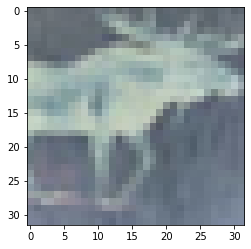

In [145]:
from torchvision.utils import save_image
# fig,axs = plt.subplots(16,2,figsize=(16,128))
# row = 0
# col = 0
for step,(x1,x2) in enumerate(dml):  
#     print(x1[0].shape)
    a=x1[1].permute(1, 2, 0).numpy()
    plt.imshow((a*255).astype(np.uint8))
#     print(x1[1].permute(1, 2, 0).shape)



In [122]:
for epoch in range(20):
    mlp.train()
#     optimizer_2.zero_grad()
    
    for x,y in dml:
        x = x.squeeze().to(device, dtype = torch.float)
        y = y.to(device)
        z = mlp(x)
        optimizer_2.zero_grad()
        
        loss = criterion_2(z,y)
        loss.backward()
        optimizer.step()
        
print('done')

done


## Evaluation of downstream task - classification

In [160]:
test_dg = CustomDataset2('test', testimages, testlabels, num_classes=10)
test_dl = DataLoader(test_dg, batch_size =20, drop_last = True)

correct = 0.0
total = 0.0

def compareTo(p,lab):
    return (p.argmax(dim=1).eq(lab).sum().item())
# # evaluate model:
# model.eval()

# with torch.no_grad():
#     ...
#     out_data = model(data)
#     ...
mlp.eval()
with torch.no_grad():
    for x,y in test_dl:
        x = x.squeeze().to(device, dtype = torch.float)
#         print(x.size())
        y = y.to(device)
#         print(y.size())
        z = mlp(x)
#         print(z.size())
        
#         print(z)
#         print(y)
        
        preds = torch.exp(z.cpu().data)/torch.sum(torch.exp(z.cpu().data)) 
        print(preds.argmax(dim=1))
        print(y)
        print("=============================================")
#         print(y.data)
#         actual = y.data
#         correct += (actual == (preds.argmax(dim=1)).sum().item()
#         total += len(y)

# test_accuracy = correct/total 
# print(test_accuracy)
        
        

tensor([0, 0, 0, 0, 0, 6, 0, 6, 4, 6, 0, 6, 0, 0, 2, 0, 0, 6, 6, 0])
tensor([3, 8, 8, 0, 6, 6, 1, 6, 3, 1, 0, 9, 5, 7, 9, 8, 5, 7, 8, 6],
       device='cuda:0')
tensor([0, 4, 6, 2, 6, 6, 0, 0, 3, 9, 6, 7, 9, 6, 5, 4, 6, 4, 2, 5])
tensor([7, 0, 4, 9, 5, 2, 4, 0, 9, 6, 6, 5, 4, 5, 9, 2, 4, 1, 9, 5],
       device='cuda:0')
tensor([0, 0, 1, 0, 9, 2, 4, 6, 6, 6, 6, 6, 0, 6, 0, 5, 0, 0, 6, 1])
tensor([4, 6, 5, 6, 0, 9, 3, 9, 7, 6, 9, 8, 0, 3, 8, 8, 7, 7, 4, 6],
       device='cuda:0')
tensor([6, 4, 0, 6, 6, 6, 6, 0, 6, 6, 7, 9, 6, 0, 6, 6, 5, 0, 1, 6])
tensor([7, 3, 6, 3, 6, 2, 1, 2, 3, 7, 2, 6, 8, 8, 0, 2, 9, 3, 3, 8],
       device='cuda:0')
tensor([5, 0, 6, 6, 6, 0, 1, 5, 6, 0, 9, 0, 5, 6, 6, 0, 2, 6, 0, 6])
tensor([8, 1, 1, 7, 2, 5, 2, 7, 8, 9, 0, 3, 8, 6, 4, 6, 6, 0, 0, 7],
       device='cuda:0')
tensor([7, 0, 0, 6, 6, 6, 0, 6, 0, 0, 6, 0, 0, 6, 0, 0, 4, 6, 0, 0])
tensor([4, 5, 6, 3, 1, 1, 3, 6, 8, 7, 4, 0, 6, 2, 1, 3, 0, 4, 2, 7],
       device='cuda:0')
tensor([0, 3, 6, 4, 6, 0, 6,

tensor([3, 3, 1, 0, 6, 1, 4, 1, 0, 0, 1, 1, 6, 5, 4, 6, 2, 0, 7, 9],
       device='cuda:0')
tensor([0, 6, 0, 0, 6, 9, 0, 0, 5, 6, 0, 2, 0, 0, 5, 0, 0, 4, 0, 4])
tensor([8, 7, 2, 0, 6, 8, 1, 4, 3, 7, 0, 6, 1, 8, 5, 7, 8, 4, 8, 3],
       device='cuda:0')
tensor([2, 6, 2, 0, 6, 6, 6, 6, 0, 0, 4, 3, 0, 4, 6, 5, 0, 0, 6, 5])
tensor([9, 9, 9, 8, 7, 6, 6, 3, 5, 1, 5, 9, 1, 4, 1, 5, 7, 0, 1, 5],
       device='cuda:0')
tensor([0, 5, 6, 6, 4, 0, 4, 0, 9, 6, 0, 0, 5, 0, 0, 6, 6, 1, 6, 6])
tensor([2, 0, 8, 8, 5, 6, 7, 3, 2, 4, 7, 2, 5, 8, 2, 4, 9, 2, 1, 8],
       device='cuda:0')
tensor([6, 0, 0, 5, 0, 6, 0, 6, 6, 4, 3, 6, 6, 0, 0, 6, 6, 0, 0, 9])
tensor([1, 9, 8, 8, 8, 9, 0, 4, 3, 3, 1, 8, 4, 6, 3, 3, 5, 2, 2, 8],
       device='cuda:0')
tensor([4, 0, 6, 5, 0, 6, 0, 5, 0, 6, 1, 5, 6, 6, 0, 0, 5, 4, 6, 0])
tensor([3, 8, 9, 5, 8, 9, 8, 9, 1, 6, 5, 9, 4, 4, 8, 0, 7, 2, 9, 7],
       device='cuda:0')
tensor([6, 6, 6, 6, 8, 6, 0, 4, 6, 9, 0, 0, 6, 0, 2, 5, 5, 5, 4, 4])
tensor([4, 1, 6, 4, 4, 9, 1,

tensor([2, 9, 6, 5, 0, 6, 0, 5, 9, 9, 6, 0, 6, 4, 6, 0, 4, 6, 0, 0])
tensor([9, 8, 5, 5, 6, 4, 5, 9, 7, 3, 4, 1, 4, 2, 3, 6, 5, 5, 2, 8],
       device='cuda:0')
tensor([0, 5, 0, 9, 5, 3, 0, 6, 0, 4, 0, 1, 6, 6, 4, 5, 5, 0, 6, 0])
tensor([0, 0, 1, 8, 3, 1, 3, 5, 8, 3, 8, 5, 8, 6, 3, 5, 5, 5, 0, 9],
       device='cuda:0')
tensor([5, 0, 6, 0, 6, 6, 0, 2, 2, 0, 0, 2, 0, 6, 6, 6, 9, 0, 0, 4])
tensor([5, 5, 7, 1, 8, 2, 2, 7, 3, 4, 2, 9, 6, 2, 2, 4, 3, 0, 2, 0],
       device='cuda:0')
tensor([3, 0, 5, 0, 6, 0, 6, 7, 6, 4, 5, 0, 0, 6, 4, 5, 6, 6, 0, 0])
tensor([1, 3, 2, 2, 7, 0, 1, 0, 7, 7, 2, 0, 1, 6, 5, 0, 2, 2, 0, 1],
       device='cuda:0')
tensor([0, 6, 5, 6, 4, 6, 0, 0, 0, 0, 0, 3, 6, 0, 4, 1, 2, 6, 9, 0])
tensor([2, 6, 0, 1, 6, 6, 5, 3, 4, 0, 0, 9, 1, 0, 2, 5, 9, 7, 8, 6],
       device='cuda:0')
tensor([0, 5, 4, 6, 0, 6, 2, 6, 0, 6, 0, 6, 0, 0, 0, 0, 2, 7, 0, 0])
tensor([4, 6, 0, 2, 0, 1, 9, 2, 4, 9, 0, 7, 2, 3, 4, 8, 0, 2, 6, 8],
       device='cuda:0')
tensor([2, 0, 0, 6, 0, 6, 0,

tensor([6, 1, 6, 6, 5, 0, 2, 6, 6, 5, 9, 0, 3, 6, 0, 0, 6, 6, 6, 3])
tensor([5, 5, 6, 6, 5, 6, 9, 7, 9, 4, 8, 3, 1, 9, 8, 1, 9, 0, 3, 0],
       device='cuda:0')
tensor([9, 9, 0, 0, 2, 0, 6, 6, 0, 0, 0, 4, 5, 6, 0, 5, 0, 0, 0, 2])
tensor([4, 7, 7, 2, 6, 5, 6, 9, 7, 7, 5, 7, 0, 8, 6, 7, 8, 3, 8, 9],
       device='cuda:0')
tensor([0, 0, 6, 0, 6, 6, 6, 5, 0, 0, 0, 5, 0, 0, 0, 1, 0, 0, 5, 5])
tensor([3, 2, 9, 2, 7, 4, 1, 9, 7, 0, 8, 1, 2, 0, 6, 5, 1, 4, 2, 8],
       device='cuda:0')
tensor([6, 6, 0, 0, 0, 6, 6, 9, 3, 4, 4, 2, 3, 6, 0, 0, 6, 0, 5, 0])
tensor([2, 8, 3, 3, 1, 4, 9, 8, 1, 1, 7, 9, 9, 4, 6, 8, 5, 3, 2, 2],
       device='cuda:0')
tensor([0, 5, 4, 6, 2, 6, 2, 0, 0, 0, 6, 5, 4, 6, 3, 0, 5, 5, 0, 5])
tensor([3, 8, 5, 1, 9, 7, 9, 1, 5, 3, 1, 0, 3, 8, 9, 2, 0, 8, 0, 7],
       device='cuda:0')
tensor([6, 6, 6, 4, 0, 0, 0, 0, 6, 5, 0, 6, 6, 5, 6, 6, 2, 0, 6, 0])
tensor([9, 4, 8, 3, 0, 7, 0, 7, 0, 5, 5, 4, 3, 0, 9, 9, 0, 2, 2, 0],
       device='cuda:0')
tensor([9, 1, 0, 0, 6, 0, 6,

tensor([0, 6, 0, 4, 2, 5, 6, 6, 0, 5, 6, 6, 4, 6, 4, 0, 6, 1, 9, 2])
tensor([0, 2, 3, 8, 9, 2, 8, 9, 5, 7, 9, 1, 4, 6, 2, 8, 4, 4, 8, 9],
       device='cuda:0')
tensor([4, 0, 0, 0, 0, 9, 6, 0, 6, 5, 5, 0, 6, 0, 0, 3, 0, 2, 0, 5])
tensor([3, 1, 1, 6, 5, 8, 4, 6, 4, 5, 2, 6, 4, 2, 3, 1, 3, 6, 8, 5],
       device='cuda:0')
tensor([0, 0, 6, 6, 0, 6, 6, 5, 0, 6, 0, 0, 6, 1, 1, 6, 0, 6, 5, 6])
tensor([2, 2, 7, 1, 6, 2, 5, 9, 2, 8, 1, 6, 9, 2, 7, 5, 3, 2, 9, 7],
       device='cuda:0')
tensor([0, 0, 6, 4, 6, 4, 0, 6, 7, 0, 0, 6, 0, 0, 0, 0, 6, 7, 0, 6])
tensor([0, 2, 9, 3, 4, 1, 7, 9, 5, 8, 9, 7, 3, 4, 0, 9, 7, 4, 2, 4],
       device='cuda:0')
tensor([0, 0, 0, 0, 5, 0, 6, 0, 0, 2, 2, 0, 9, 1, 4, 0, 6, 6, 7, 5])
tensor([7, 0, 1, 8, 1, 0, 4, 6, 1, 9, 9, 2, 1, 2, 5, 6, 9, 7, 7, 3],
       device='cuda:0')
tensor([6, 6, 0, 5, 5, 6, 2, 0, 0, 0, 6, 6, 5, 0, 0, 6, 4, 6, 0, 6])
tensor([4, 2, 0, 2, 5, 6, 7, 3, 7, 9, 4, 2, 0, 6, 1, 7, 5, 6, 5, 3],
       device='cuda:0')
tensor([2, 4, 6, 9, 6, 2, 0,

tensor([6, 0, 6, 6, 0, 5, 4, 0, 0, 6, 5, 6, 4, 6, 6, 6, 6, 0, 0, 6])
tensor([3, 9, 2, 4, 4, 0, 3, 3, 5, 4, 5, 1, 1, 8, 2, 2, 9, 3, 7, 8],
       device='cuda:0')
tensor([6, 0, 0, 6, 7, 4, 6, 6, 0, 6, 0, 4, 0, 6, 6, 0, 6, 0, 6, 6])
tensor([9, 2, 3, 1, 7, 3, 2, 3, 0, 1, 9, 5, 5, 3, 4, 5, 2, 0, 0, 3],
       device='cuda:0')
tensor([0, 4, 0, 4, 6, 8, 5, 6, 0, 5, 6, 6, 4, 0, 6, 2, 6, 6, 9, 0])
tensor([1, 3, 4, 7, 4, 2, 8, 4, 8, 9, 9, 4, 2, 4, 3, 6, 4, 6, 4, 6],
       device='cuda:0')
tensor([0, 0, 9, 0, 5, 0, 4, 5, 0, 4, 1, 5, 6, 0, 0, 2, 6, 2, 6, 6])
tensor([6, 3, 8, 7, 4, 8, 0, 5, 9, 3, 9, 0, 7, 5, 1, 9, 7, 9, 1, 8],
       device='cuda:0')
tensor([0, 1, 6, 6, 6, 0, 4, 6, 0, 6, 6, 6, 8, 4, 5, 6, 0, 6, 6, 5])
tensor([4, 2, 1, 6, 4, 3, 0, 1, 4, 8, 6, 1, 7, 1, 3, 5, 4, 3, 3, 9],
       device='cuda:0')
tensor([4, 0, 0, 5, 4, 6, 4, 6, 0, 6, 6, 4, 6, 6, 0, 0, 0, 1, 0, 0])
tensor([7, 8, 2, 5, 5, 4, 5, 4, 5, 7, 2, 5, 5, 1, 7, 7, 8, 3, 6, 0],
       device='cuda:0')
tensor([0, 7, 6, 0, 2, 6, 5,

tensor([4, 3, 6, 3, 6, 9, 0, 9, 0, 5, 4, 7, 2, 0, 6, 3, 0, 7, 9, 5])
tensor([7, 1, 4, 1, 2, 8, 7, 0, 0, 4, 7, 2, 9, 7, 6, 9, 3, 5, 8, 0],
       device='cuda:0')
tensor([0, 0, 6, 0, 6, 0, 4, 6, 3, 6, 4, 0, 0, 6, 0, 0, 6, 0, 6, 6])
tensor([3, 6, 8, 3, 2, 4, 7, 1, 1, 3, 9, 7, 5, 1, 0, 8, 7, 0, 1, 6],
       device='cuda:0')
tensor([0, 6, 6, 6, 6, 3, 2, 0, 0, 6, 0, 0, 0, 0, 0, 6, 0, 2, 0, 0])
tensor([9, 3, 2, 7, 7, 8, 1, 0, 3, 4, 6, 7, 5, 2, 0, 1, 5, 5, 1, 4],
       device='cuda:0')
tensor([6, 0, 0, 0, 6, 0, 9, 0, 1, 6, 0, 3, 0, 6, 5, 6, 6, 6, 0, 4])
tensor([1, 3, 0, 8, 6, 2, 1, 3, 6, 4, 1, 9, 0, 4, 1, 0, 1, 9, 8, 6],
       device='cuda:0')
tensor([5, 0, 6, 0, 6, 7, 4, 0, 5, 0, 0, 9, 0, 4, 6, 6, 4, 6, 6, 0])
tensor([9, 2, 4, 7, 2, 2, 7, 4, 9, 1, 3, 2, 6, 3, 4, 4, 9, 4, 8, 2],
       device='cuda:0')
tensor([0, 0, 0, 2, 0, 6, 4, 0, 0, 2, 0, 6, 2, 0, 0, 6, 6, 6, 6, 6])
tensor([6, 6, 1, 6, 3, 6, 5, 8, 4, 6, 7, 1, 9, 3, 6, 7, 6, 0, 7, 1],
       device='cuda:0')
tensor([6, 4, 6, 6, 8, 0, 0,

tensor([6, 0, 0, 6, 6, 6, 0, 0, 7, 6, 0, 6, 0, 0, 6, 0, 2, 0, 6, 0])
tensor([2, 4, 0, 3, 7, 5, 1, 9, 3, 5, 2, 4, 1, 1, 3, 3, 9, 2, 5, 8],
       device='cuda:0')
tensor([5, 0, 3, 0, 3, 1, 2, 6, 2, 4, 0, 9, 6, 6, 6, 0, 0, 0, 2, 5])
tensor([0, 8, 1, 5, 1, 5, 9, 0, 9, 2, 4, 0, 6, 9, 1, 1, 3, 4, 9, 5],
       device='cuda:0')
tensor([6, 0, 5, 0, 6, 6, 4, 2, 0, 0, 1, 5, 6, 0, 6, 5, 5, 0, 6, 6])
tensor([3, 3, 3, 3, 4, 1, 5, 9, 8, 7, 4, 8, 7, 3, 5, 2, 5, 8, 9, 7],
       device='cuda:0')
tensor([0, 6, 0, 6, 5, 5, 1, 0, 6, 6, 0, 0, 0, 0, 0, 0, 6, 0, 0, 6])
tensor([2, 0, 0, 7, 5, 3, 5, 7, 4, 6, 2, 8, 2, 7, 7, 6, 1, 3, 8, 6],
       device='cuda:0')
tensor([9, 0, 9, 9, 9, 9, 0, 9, 0, 6, 0, 9, 6, 4, 6, 0, 2, 7, 4, 5])
tensor([2, 0, 4, 4, 8, 6, 4, 0, 2, 5, 4, 1, 2, 5, 4, 6, 9, 5, 0, 5],
       device='cuda:0')
tensor([0, 5, 6, 9, 4, 0, 6, 2, 5, 0, 0, 6, 4, 0, 3, 5, 6, 6, 6, 6])
tensor([2, 0, 8, 2, 6, 4, 7, 9, 5, 7, 2, 6, 2, 1, 9, 9, 7, 2, 5, 1],
       device='cuda:0')
tensor([2, 0, 0, 4, 6, 0, 6,

tensor([9, 8, 7, 9, 5, 6, 0, 4, 8, 2, 0, 9, 1, 3, 9, 8, 3, 7, 4, 5],
       device='cuda:0')
tensor([6, 6, 2, 0, 0, 0, 0, 5, 6, 4, 4, 6, 6, 0, 4, 6, 0, 6, 0, 5])
tensor([0, 2, 1, 9, 1, 0, 5, 8, 4, 7, 3, 1, 4, 5, 3, 1, 0, 8, 8, 8],
       device='cuda:0')
tensor([0, 3, 4, 0, 0, 4, 6, 3, 6, 1, 0, 6, 6, 3, 0, 0, 0, 3, 0, 4])
tensor([2, 1, 3, 7, 3, 1, 6, 9, 1, 6, 0, 7, 7, 1, 3, 3, 3, 1, 0, 2],
       device='cuda:0')
tensor([0, 5, 5, 4, 2, 0, 0, 6, 2, 6, 9, 9, 6, 0, 9, 6, 1, 0, 6, 6])
tensor([7, 1, 2, 2, 9, 6, 3, 5, 9, 4, 8, 0, 4, 8, 0, 1, 3, 7, 0, 4],
       device='cuda:0')
tensor([0, 3, 9, 0, 0, 0, 6, 0, 6, 0, 0, 4, 5, 5, 6, 0, 4, 2, 2, 0])
tensor([7, 4, 8, 6, 4, 3, 9, 8, 2, 2, 8, 3, 1, 1, 2, 8, 2, 6, 9, 4],
       device='cuda:0')
tensor([0, 6, 6, 0, 5, 4, 0, 2, 6, 0, 0, 0, 5, 2, 4, 2, 2, 5, 6, 6])
tensor([8, 4, 4, 1, 5, 2, 6, 9, 2, 0, 7, 1, 8, 9, 3, 9, 9, 0, 7, 7],
       device='cuda:0')
tensor([0, 6, 0, 4, 6, 4, 0, 0, 0, 0, 6, 2, 6, 7, 4, 6, 0, 4, 0, 4])
tensor([5, 4, 2, 6, 4, 5, 7,

tensor([0, 4, 6, 5, 6, 0, 5, 0, 6, 0, 0, 0, 3, 0, 0, 6, 6, 4, 0, 6])
tensor([3, 5, 8, 3, 7, 4, 9, 5, 6, 3, 8, 6, 9, 8, 5, 5, 8, 3, 5, 9],
       device='cuda:0')
tensor([6, 6, 6, 6, 5, 3, 6, 0, 6, 6, 0, 9, 6, 6, 3, 0, 0, 0, 2, 6])
tensor([0, 4, 2, 0, 5, 9, 9, 3, 8, 0, 6, 0, 2, 3, 7, 0, 0, 6, 9, 1],
       device='cuda:0')
tensor([5, 0, 6, 6, 3, 0, 5, 4, 5, 0, 0, 0, 9, 6, 6, 4, 0, 6, 0, 6])
tensor([5, 2, 2, 7, 9, 3, 9, 3, 5, 2, 2, 2, 8, 8, 5, 0, 0, 7, 0, 3],
       device='cuda:0')
tensor([0, 6, 6, 0, 2, 7, 0, 6, 6, 0, 0, 0, 6, 0, 4, 5, 6, 0, 1, 0])
tensor([1, 6, 5, 0, 9, 2, 6, 7, 4, 2, 0, 0, 5, 3, 3, 2, 6, 4, 2, 7],
       device='cuda:0')
tensor([0, 6, 0, 0, 3, 4, 2, 9, 0, 0, 0, 0, 5, 5, 6, 0, 0, 9, 6, 0])
tensor([8, 0, 1, 0, 1, 3, 6, 4, 8, 0, 6, 0, 9, 1, 6, 2, 1, 0, 1, 3],
       device='cuda:0')
tensor([5, 0, 0, 0, 0, 4, 6, 1, 6, 5, 2, 0, 3, 6, 6, 6, 6, 0, 6, 6])
tensor([0, 3, 7, 9, 9, 3, 7, 5, 7, 1, 6, 6, 1, 1, 1, 4, 4, 2, 1, 7],
       device='cuda:0')
tensor([5, 3, 1, 0, 6, 0, 6,

tensor([3, 3, 8, 1, 6, 6, 1, 8, 8, 6, 2, 7, 4, 6, 8, 9, 3, 3, 5, 5],
       device='cuda:0')
tensor([9, 6, 6, 4, 6, 1, 0, 6, 6, 6, 5, 0, 6, 0, 4, 0, 0, 6, 6, 5])
tensor([3, 1, 4, 1, 9, 5, 1, 7, 7, 7, 5, 2, 3, 3, 6, 6, 6, 4, 0, 7],
       device='cuda:0')
tensor([6, 7, 0, 9, 3, 0, 0, 6, 0, 6, 0, 5, 5, 0, 0, 0, 0, 0, 0, 0])
tensor([1, 7, 3, 0, 8, 1, 2, 4, 1, 2, 2, 4, 9, 8, 2, 8, 7, 6, 3, 4],
       device='cuda:0')
tensor([0, 1, 0, 3, 1, 4, 0, 6, 0, 6, 6, 6, 6, 2, 3, 6, 6, 0, 6, 0])
tensor([7, 2, 3, 1, 5, 3, 0, 4, 3, 4, 9, 4, 7, 9, 1, 7, 8, 3, 1, 8],
       device='cuda:0')
tensor([6, 6, 0, 0, 0, 6, 2, 6, 5, 7, 0, 6, 1, 2, 6, 6, 5, 5, 2, 9])
tensor([3, 2, 5, 7, 2, 7, 9, 6, 8, 6, 8, 6, 5, 9, 0, 4, 8, 5, 6, 4],
       device='cuda:0')
tensor([1, 6, 0, 6, 0, 2, 7, 6, 6, 6, 6, 6, 6, 6, 6, 4, 5, 2, 0, 0])
tensor([3, 8, 0, 4, 8, 6, 7, 2, 7, 1, 7, 4, 1, 2, 4, 2, 2, 8, 7, 2],
       device='cuda:0')
tensor([4, 0, 0, 6, 6, 9, 0, 0, 0, 1, 1, 6, 0, 6, 0, 0, 0, 0, 0, 0])
tensor([2, 6, 7, 5, 6, 8, 9,

tensor([6, 9, 6, 9, 3, 8, 5, 6, 6, 9, 5, 7, 8, 0, 5, 0, 7, 4, 8, 2],
       device='cuda:0')
tensor([9, 2, 4, 7, 4, 2, 6, 3, 0, 6, 0, 0, 3, 0, 0, 0, 0, 0, 0, 5])
tensor([5, 1, 3, 2, 2, 6, 2, 1, 7, 4, 6, 3, 1, 3, 7, 2, 1, 3, 7, 0],
       device='cuda:0')
tensor([0, 6, 6, 6, 5, 6, 0, 6, 6, 6, 0, 0, 0, 6, 1, 0, 4, 0, 0, 4])
tensor([8, 4, 4, 5, 7, 9, 5, 4, 3, 9, 6, 8, 2, 3, 3, 1, 6, 1, 7, 0],
       device='cuda:0')
tensor([6, 6, 0, 6, 6, 0, 9, 6, 0, 5, 6, 0, 5, 0, 6, 6, 0, 5, 0, 0])
tensor([3, 4, 2, 9, 4, 5, 8, 2, 7, 0, 9, 6, 8, 0, 8, 2, 8, 5, 7, 7],
       device='cuda:0')
tensor([0, 4, 4, 9, 5, 6, 7, 0, 0, 0, 6, 0, 3, 6, 6, 0, 4, 6, 4, 5])
tensor([2, 2, 0, 0, 0, 7, 4, 1, 6, 6, 8, 8, 9, 0, 9, 0, 1, 3, 3, 0],
       device='cuda:0')
tensor([0, 6, 2, 0, 2, 5, 6, 6, 6, 4, 6, 6, 6, 0, 0, 0, 6, 2, 0, 2])
tensor([9, 6, 6, 2, 6, 3, 4, 0, 8, 4, 1, 4, 0, 6, 5, 0, 9, 9, 9, 9],
       device='cuda:0')
tensor([6, 6, 6, 6, 0, 6, 6, 0, 9, 4, 0, 6, 5, 0, 6, 4, 6, 6, 6, 6])
tensor([1, 2, 3, 5, 4, 2, 9,